In [1]:
import numpy as np
import matplotlib.pyplot as plt
import imageio
from itertools import product

In [10]:
def rotY(theta):
    out = np.array([[np.cos(theta), 0, np.sin(theta)],[0,1,0],[-1*np.sin(theta), 0, np.cos(theta)]])
    return(out)

In [50]:
def generate_gif(R, file_name='cube.gif'):
    """
    Generate a gif of a rotating cube from a list of rotation matrices.

    Input:  R: A list of 3x3 rotation matrices.
            file_name: file_name to save files to.
    Output: None
    """
    with imageio.get_writer(file_name, mode='I') as writer:
        for rot in R:
            fig = renderCube(f=15, t=(0, 0, 3), R=rot)
            # Now we can save it to a numpy array.
            fig.canvas.draw()
            img = np.fromstring(fig.canvas.tostring_rgb(),
                                dtype=np.uint8,
                                sep='')
            img = img.reshape(fig.canvas.get_width_height()[::-1] + (3, ))
            writer.append_data(img)
            
def renderCube(f=15,
               scaleFToSize=None,
               t=np.array([0, 0, -3]),
               R=np.eye(3),
               file_name=None):
    """
    Renders a cube given camera instrinsics and extrinsics.

    Input:  f: focal length
            scaleFToSize: target size on the retrina (sqrt of area)
            t: camera translation (3x1 numpy array)
            R: camera rotation (3x3 numpy array)
            file_name: file path to save image (if provided)

    Output: Matplotlib figure handle
    """
    # Render the cube
    L = generateCube()
    t = np.array(t)
    pL = projectLines(f, R, t, L)

    if scaleFToSize is not None:
        # Then adjust f so that the image is the right size
        xRange, yRange = xyrange(pL)
        geoMean = (xRange * yRange)**0.5
        f = (f / geoMean) * scaleFToSize
        # re-render with the right focal length
        pL = projectLines(f, R, t, L)

    # Generate plot
    fig = plt.figure()
    plt.title("Cube @ [x=%.1f y=%.1f z=%.1f] f=%f" % (t[0], t[1], t[2], f))
    for i in range(pL.shape[0]):
        u1, v1, u2, v2 = pL[i, :]
        plt.plot((u1, u2), (v1, v2), lineWidth=2)

    # Format plot
    plt.axis('square')
    plt.xlim(-5, 5)
    plt.ylim(-5, 5)

    # Save to file if filename is provided
    if file_name:
        plt.savefig(file_name)

    return fig

def generateCube():
    """
    Generates the lines for a unit cube.
    Output: np array of lines.
    """
    lines = []
    for x, y, z in product([0, 1], [0, 1], [0, 1]):
        # all corners, check changing all the dirensions
        # if in the cube, keep, but then center at 0
        for dx, dy, dz in [(1, 0, 0), (-1, 0, 0), (0, 1, 0), (0, -1, 0),
                           (0, 0, 1), (0, 0, -1)]:
            xp, yp, zp = x + dx, y + dy, z + dz
            if min([xp, yp, zp]) >= 0 and max([xp, yp, zp]) <= 1:
                lines.append(
                    (x - 0.5, y - 0.5, z - 0.5, xp - 0.5, yp - 0.5, zp - 0.5))
    return np.vstack(lines)


def xyrange(pL):
    # Returns the X and Y ranges for a line
    X, Y = np.vstack([pL[:, 0], pL[:, 2]]), np.vstack([pL[:, 1], pL[:, 3]])
    return np.max(X) - np.min(X), np.max(Y) - np.min(Y)


def projectOthographicLines(R, t, L):
    """
    Projects lines using the camera intrinsic and extrinsic parameters.
    Input:  R: camera rotation (3x3 numpy array)
            t: camera translation (3x1 numpy array)
            L: Nx6 numpy array depicting N lines in 3D
    Output: 2D projection of lines (Nx4 numpy array)
    """
    # TODO: Rewrite this function to project lines with an orthographic camera
    # You may refer to projectLines() for parameter types
    #raise NotImplementedError
    pL = np.zeros((L.shape[0], 4))
    for i in range(L.shape[0]):
        # rotate and translate
        p = np.dot(R, L[i, :3]) + t
        pp = np.dot(R, L[i, 3:]) + t
        # apply projection u = x; v = y
        #print("p: {}    pp: {}".format(p[2], pp[2]))
        pL[i, :2] = p[0]  , p[1] 
        pL[i, 2:] = pp[0]  , pp[1]

    return np.vstack(pL)



def projectLines(f, R, t, L):
    """
    Projects lines using the camera intrinsic and extrinsic parameters.
    Input:  f: focal length
            R: camera rotation (3x3 numpy array)
            t: camera translation (3x1 numpy array)
            L: Nx6 numpy array depicting N lines in 3D
    Output: 2D projection of lines (Nx4 numpy array)
    """
    if f == np.inf:
        return projectOthographicLines(R, t, L)
    pL = np.zeros((L.shape[0], 4))
    for i in range(L.shape[0]):
        # rotate and translate
        p = np.dot(R, L[i, :3]) + t
        pp = np.dot(R, L[i, 3:]) + t
        # apply projection u = x*f/z; v = y*f/z
        print("p: {}    pp: {}".format(p[2], pp[2]))
        pL[i, :2] = p[0] * f / p[2], p[1] * f / p[2]
        pL[i, 2:] = pp[0] * f / pp[2], pp[1] * f / pp[2]

    return np.vstack(pL)


p: 2.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 2.5
p: 2.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 3.5
p: 3.5    pp: 2.5


C:\Users\wenji\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  app.launch_new_instance()


p: 2.5005002499166458    pp: 2.4995002500833126
p: 2.5005002499166458    pp: 2.5005002499166458
p: 2.5005002499166458    pp: 3.5004997499166874
p: 3.5004997499166874    pp: 3.4994997500833542
p: 3.5004997499166874    pp: 3.5004997499166874
p: 3.5004997499166874    pp: 2.5005002499166458
p: 2.5005002499166458    pp: 2.4995002500833126
p: 2.5005002499166458    pp: 2.5005002499166458
p: 2.5005002499166458    pp: 3.5004997499166874
p: 3.5004997499166874    pp: 3.4994997500833542
p: 3.5004997499166874    pp: 3.5004997499166874
p: 3.5004997499166874    pp: 2.5005002499166458
p: 2.4995002500833126    pp: 2.5005002499166458
p: 2.4995002500833126    pp: 2.4995002500833126
p: 2.4995002500833126    pp: 3.4994997500833542
p: 3.4994997500833542    pp: 3.5004997499166874
p: 3.4994997500833542    pp: 3.4994997500833542
p: 3.4994997500833542    pp: 2.4995002500833126
p: 2.4995002500833126    pp: 2.5005002499166458
p: 2.4995002500833126    pp: 2.4995002500833126
p: 2.4995002500833126    pp: 3.499499750

p: 3.504974916875416    pp: 2.505024916458751
p: 2.505024916458751    pp: 2.495025083124584
p: 2.505024916458751    pp: 2.505024916458751
p: 2.505024916458751    pp: 3.504974916875416
p: 3.504974916875416    pp: 3.494975083541249
p: 3.504974916875416    pp: 3.504974916875416
p: 3.504974916875416    pp: 2.505024916458751
p: 2.495025083124584    pp: 2.505024916458751
p: 2.495025083124584    pp: 2.495025083124584
p: 2.495025083124584    pp: 3.494975083541249
p: 3.494975083541249    pp: 3.504974916875416
p: 3.494975083541249    pp: 3.494975083541249
p: 3.494975083541249    pp: 2.495025083124584
p: 2.495025083124584    pp: 2.505024916458751
p: 2.495025083124584    pp: 2.495025083124584
p: 2.495025083124584    pp: 3.494975083541249
p: 3.494975083541249    pp: 3.504974916875416
p: 3.494975083541249    pp: 3.494975083541249
p: 3.494975083541249    pp: 2.495025083124584
p: 2.505530138778985    pp: 2.494530360610976
p: 2.505530138778985    pp: 2.505530138778985
p: 2.505530138778985    pp: 3.5054

p: 3.4909194881791032    pp: 3.5089185161948495
p: 3.4909194881791032    pp: 3.4909194881791032
p: 3.4909194881791032    pp: 2.4910814838051505
p: 2.5095896757119953    pp: 2.490590818858028
p: 2.5095896757119953    pp: 2.5095896757119953
p: 2.5095896757119953    pp: 3.509409181141972
p: 3.509409181141972    pp: 3.4904103242880047
p: 3.509409181141972    pp: 3.509409181141972
p: 3.509409181141972    pp: 2.5095896757119953
p: 2.5095896757119953    pp: 2.490590818858028
p: 2.5095896757119953    pp: 2.5095896757119953
p: 2.5095896757119953    pp: 3.509409181141972
p: 3.509409181141972    pp: 3.4904103242880047
p: 3.509409181141972    pp: 3.509409181141972
p: 3.509409181141972    pp: 2.5095896757119953
p: 2.490590818858028    pp: 2.5095896757119953
p: 2.490590818858028    pp: 2.490590818858028
p: 2.490590818858028    pp: 3.4904103242880047
p: 3.4904103242880047    pp: 3.509409181141972
p: 3.4904103242880047    pp: 3.4904103242880047
p: 3.4904103242880047    pp: 2.490590818858028
p: 2.49059

C:\Users\wenji\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


p: 2.511631230280233    pp: 2.488633258059931
p: 2.511631230280233    pp: 2.511631230280233
p: 2.511631230280233    pp: 3.511366741940069
p: 3.511366741940069    pp: 3.488368769719767
p: 3.511366741940069    pp: 3.511366741940069
p: 3.511366741940069    pp: 2.511631230280233
p: 2.511631230280233    pp: 2.488633258059931
p: 2.511631230280233    pp: 2.511631230280233
p: 2.511631230280233    pp: 3.511366741940069
p: 3.511366741940069    pp: 3.488368769719767
p: 3.511366741940069    pp: 3.511366741940069
p: 3.511366741940069    pp: 2.511631230280233
p: 2.488633258059931    pp: 2.511631230280233
p: 2.488633258059931    pp: 2.488633258059931
p: 2.488633258059931    pp: 3.488368769719767
p: 3.488368769719767    pp: 3.511366741940069
p: 3.488368769719767    pp: 3.488368769719767
p: 3.488368769719767    pp: 2.488633258059931
p: 2.488633258059931    pp: 2.511631230280233
p: 2.488633258059931    pp: 2.488633258059931
p: 2.488633258059931    pp: 3.488368769719767
p: 3.488368769719767    pp: 3.5113

p: 2.516253247628552    pp: 2.4842587086822725
p: 2.516253247628552    pp: 2.516253247628552
p: 2.516253247628552    pp: 3.5157412913177275
p: 3.5157412913177275    pp: 3.483746752371448
p: 3.5157412913177275    pp: 3.5157412913177275
p: 3.5157412913177275    pp: 2.516253247628552
p: 2.516253247628552    pp: 2.4842587086822725
p: 2.516253247628552    pp: 2.516253247628552
p: 2.516253247628552    pp: 3.5157412913177275
p: 3.5157412913177275    pp: 3.483746752371448
p: 3.5157412913177275    pp: 3.5157412913177275
p: 3.5157412913177275    pp: 2.516253247628552
p: 2.4842587086822725    pp: 2.516253247628552
p: 2.4842587086822725    pp: 2.4842587086822725
p: 2.4842587086822725    pp: 3.483746752371448
p: 3.483746752371448    pp: 3.5157412913177275
p: 3.483746752371448    pp: 3.483746752371448
p: 3.483746752371448    pp: 2.4842587086822725
p: 2.4842587086822725    pp: 2.516253247628552
p: 2.4842587086822725    pp: 2.4842587086822725
p: 2.4842587086822725    pp: 3.483746752371448
p: 3.4837467

p: 2.4799259340672295    pp: 3.479085551800674
p: 3.479085551800674    pp: 3.5200740659327705
p: 3.479085551800674    pp: 3.479085551800674
p: 3.479085551800674    pp: 2.4799259340672295
p: 2.4799259340672295    pp: 2.520914448199326
p: 2.4799259340672295    pp: 2.4799259340672295
p: 2.4799259340672295    pp: 3.479085551800674
p: 3.479085551800674    pp: 3.5200740659327705
p: 3.479085551800674    pp: 3.479085551800674
p: 3.479085551800674    pp: 2.4799259340672295
p: 2.5214347617213355    pp: 2.4794471086322876
p: 2.5214347617213355    pp: 2.5214347617213355
p: 2.5214347617213355    pp: 3.5205528913677124
p: 3.5205528913677124    pp: 3.4785652382786645
p: 3.5205528913677124    pp: 3.5205528913677124
p: 3.5205528913677124    pp: 2.5214347617213355
p: 2.5214347617213355    pp: 2.4794471086322876
p: 2.5214347617213355    pp: 2.5214347617213355
p: 2.5214347617213355    pp: 3.5205528913677124
p: 3.5205528913677124    pp: 3.4785652382786645
p: 3.5205528913677124    pp: 3.5205528913677124
p: 

p: 3.5243647148328225    pp: 2.5256144544378563
p: 2.4756352851671775    pp: 2.5256144544378563
p: 2.4756352851671775    pp: 2.4756352851671775
p: 2.4756352851671775    pp: 3.4743855455621437
p: 3.4743855455621437    pp: 3.5243647148328225
p: 3.4743855455621437    pp: 3.4743855455621437
p: 3.4743855455621437    pp: 2.4756352851671775
p: 2.4756352851671775    pp: 2.5256144544378563
p: 2.4756352851671775    pp: 2.4756352851671775
p: 2.4756352851671775    pp: 3.4743855455621437
p: 3.4743855455621437    pp: 3.5243647148328225
p: 3.4743855455621437    pp: 3.4743855455621437
p: 3.4743855455621437    pp: 2.4756352851671775
p: 2.5261390562580477    pp: 2.4751611618830154
p: 2.5261390562580477    pp: 2.5261390562580477
p: 2.5261390562580477    pp: 3.5248388381169846
p: 3.5248388381169846    pp: 3.4738609437419523
p: 3.5248388381169846    pp: 3.5248388381169846
p: 3.5248388381169846    pp: 2.5261390562580477
p: 2.5261390562580477    pp: 2.4751611618830154
p: 2.5261390562580477    pp: 2.526139056

p: 2.529824507667369    pp: 2.529824507667369
p: 2.529824507667369    pp: 3.5281429791351657
p: 3.5281429791351657    pp: 3.470175492332631
p: 3.5281429791351657    pp: 3.5281429791351657
p: 3.5281429791351657    pp: 2.529824507667369
p: 2.529824507667369    pp: 2.4718570208648343
p: 2.529824507667369    pp: 2.529824507667369
p: 2.529824507667369    pp: 3.5281429791351657
p: 3.5281429791351657    pp: 3.470175492332631
p: 3.5281429791351657    pp: 3.5281429791351657
p: 3.5281429791351657    pp: 2.529824507667369
p: 2.4718570208648343    pp: 2.529824507667369
p: 2.4718570208648343    pp: 2.4718570208648343
p: 2.4718570208648343    pp: 3.470175492332631
p: 3.470175492332631    pp: 3.5281429791351657
p: 3.470175492332631    pp: 3.470175492332631
p: 3.470175492332631    pp: 2.4718570208648343
p: 2.4718570208648343    pp: 2.529824507667369
p: 2.4718570208648343    pp: 2.4718570208648343
p: 2.4718570208648343    pp: 3.470175492332631
p: 3.470175492332631    pp: 3.5281429791351657
p: 3.4701754

p: 2.5340646519679053    pp: 2.4681125575328826
p: 2.5340646519679053    pp: 2.5340646519679053
p: 2.5340646519679053    pp: 3.5318874424671174
p: 3.5318874424671174    pp: 3.4659353480320947
p: 3.5318874424671174    pp: 3.5318874424671174
p: 3.5318874424671174    pp: 2.5340646519679053
p: 2.4681125575328826    pp: 2.5340646519679053
p: 2.4681125575328826    pp: 2.4681125575328826
p: 2.4681125575328826    pp: 3.4659353480320947
p: 3.4659353480320947    pp: 3.5318874424671174
p: 3.4659353480320947    pp: 3.4659353480320947
p: 3.4659353480320947    pp: 2.4681125575328826
p: 2.4681125575328826    pp: 2.5340646519679053
p: 2.4681125575328826    pp: 2.4681125575328826
p: 2.4681125575328826    pp: 3.4659353480320947
p: 3.4659353480320947    pp: 3.5318874424671174
p: 3.4659353480320947    pp: 3.4659353480320947
p: 3.4659353480320947    pp: 2.4681125575328826
p: 2.534596772289379    pp: 2.4676468882062057
p: 2.534596772289379    pp: 2.534596772289379
p: 2.534596772289379    pp: 3.5323531117937

p: 2.5388704445802674    pp: 2.4639407373075253
p: 2.5388704445802674    pp: 2.5388704445802674
p: 2.5388704445802674    pp: 3.5360592626924747
p: 3.5360592626924747    pp: 3.4611295554197326
p: 3.5360592626924747    pp: 3.5360592626924747
p: 3.5360592626924747    pp: 2.5388704445802674
p: 2.5388704445802674    pp: 2.4639407373075253
p: 2.5388704445802674    pp: 2.5388704445802674
p: 2.5388704445802674    pp: 3.5360592626924747
p: 3.5360592626924747    pp: 3.4611295554197326
p: 3.5360592626924747    pp: 3.5360592626924747
p: 3.5360592626924747    pp: 2.5388704445802674
p: 2.4639407373075253    pp: 2.5388704445802674
p: 2.4639407373075253    pp: 2.4639407373075253
p: 2.4639407373075253    pp: 3.4611295554197326
p: 3.4611295554197326    pp: 3.5360592626924747
p: 3.4611295554197326    pp: 3.4611295554197326
p: 3.4611295554197326    pp: 2.4639407373075253
p: 2.4639407373075253    pp: 2.5388704445802674
p: 2.4639407373075253    pp: 2.4639407373075253
p: 2.4639407373075253    pp: 3.461129555

p: 2.543173629005304    pp: 2.4602688940186823
p: 2.543173629005304    pp: 2.543173629005304
p: 2.543173629005304    pp: 3.5397311059813177
p: 3.5397311059813177    pp: 3.456826370994696
p: 3.5397311059813177    pp: 3.5397311059813177
p: 3.5397311059813177    pp: 2.543173629005304
p: 2.543173629005304    pp: 2.4602688940186823
p: 2.543173629005304    pp: 2.543173629005304
p: 2.543173629005304    pp: 3.5397311059813177
p: 3.5397311059813177    pp: 3.456826370994696
p: 3.5397311059813177    pp: 3.5397311059813177
p: 3.5397311059813177    pp: 2.543173629005304
p: 2.4602688940186823    pp: 2.543173629005304
p: 2.4602688940186823    pp: 2.4602688940186823
p: 2.4602688940186823    pp: 3.456826370994696
p: 3.456826370994696    pp: 3.5397311059813177
p: 3.456826370994696    pp: 3.456826370994696
p: 3.456826370994696    pp: 2.4602688940186823
p: 2.4602688940186823    pp: 2.543173629005304
p: 2.4602688940186823    pp: 2.4602688940186823
p: 2.4602688940186823    pp: 3.456826370994696
p: 3.4568263

p: 2.5475060501621547    pp: 2.4566315933363945
p: 2.5475060501621547    pp: 2.5475060501621547
p: 2.5475060501621547    pp: 3.5433684066636055
p: 3.5433684066636055    pp: 3.4524939498378453
p: 3.5433684066636055    pp: 3.5433684066636055
p: 3.5433684066636055    pp: 2.5475060501621547
p: 2.5475060501621547    pp: 2.4566315933363945
p: 2.5475060501621547    pp: 2.5475060501621547
p: 2.5475060501621547    pp: 3.5433684066636055
p: 3.5433684066636055    pp: 3.4524939498378453
p: 3.5433684066636055    pp: 3.5433684066636055
p: 3.5433684066636055    pp: 2.5475060501621547
p: 2.4566315933363945    pp: 2.5475060501621547
p: 2.4566315933363945    pp: 2.4566315933363945
p: 2.4566315933363945    pp: 3.4524939498378453
p: 3.4524939498378453    pp: 3.5433684066636055
p: 3.4524939498378453    pp: 3.4524939498378453
p: 3.4524939498378453    pp: 2.4566315933363945
p: 2.4566315933363945    pp: 2.5475060501621547
p: 2.4566315933363945    pp: 2.4566315933363945
p: 2.4566315933363945    pp: 3.452493949

p: 3.546522525973359    pp: 3.4486793159971816
p: 3.546522525973359    pp: 3.546522525973359
p: 3.546522525973359    pp: 2.5513206840028184
p: 2.453477474026641    pp: 2.5513206840028184
p: 2.453477474026641    pp: 2.453477474026641
p: 2.453477474026641    pp: 3.4486793159971816
p: 3.4486793159971816    pp: 3.546522525973359
p: 3.4486793159971816    pp: 3.4486793159971816
p: 3.4486793159971816    pp: 2.453477474026641
p: 2.453477474026641    pp: 2.5513206840028184
p: 2.453477474026641    pp: 2.453477474026641
p: 2.453477474026641    pp: 3.4486793159971816
p: 3.4486793159971816    pp: 3.546522525973359
p: 3.4486793159971816    pp: 3.4486793159971816
p: 3.4486793159971816    pp: 2.453477474026641
p: 2.5518674307773437    pp: 2.4530290680466638
p: 2.5518674307773437    pp: 2.5518674307773437
p: 2.5518674307773437    pp: 3.5469709319533362
p: 3.5469709319533362    pp: 3.4481325692226563
p: 3.5469709319533362    pp: 3.5469709319533362
p: 3.5469709319533362    pp: 2.5518674307773437
p: 2.551

p: 2.556257491724001    pp: 2.4494615487098788
p: 2.556257491724001    pp: 2.556257491724001
p: 2.556257491724001    pp: 3.5505384512901212
p: 3.5505384512901212    pp: 3.443742508275999
p: 3.5505384512901212    pp: 3.5505384512901212
p: 3.5505384512901212    pp: 2.556257491724001
p: 2.556257491724001    pp: 2.4494615487098788
p: 2.556257491724001    pp: 2.556257491724001
p: 2.556257491724001    pp: 3.5505384512901212
p: 3.5505384512901212    pp: 3.443742508275999
p: 3.5505384512901212    pp: 3.5505384512901212
p: 3.5505384512901212    pp: 2.556257491724001
p: 2.4494615487098788    pp: 2.556257491724001
p: 2.4494615487098788    pp: 2.4494615487098788
p: 2.4494615487098788    pp: 3.443742508275999
p: 3.443742508275999    pp: 3.5505384512901212
p: 3.443742508275999    pp: 3.443742508275999
p: 3.443742508275999    pp: 2.4494615487098788
p: 2.4494615487098788    pp: 2.556257491724001
p: 2.4494615487098788    pp: 2.4494615487098788
p: 2.4494615487098788    pp: 3.443742508275999
p: 3.4437425

p: 2.560675952039724    pp: 2.44592926364606
p: 2.560675952039724    pp: 2.560675952039724
p: 2.560675952039724    pp: 3.55407073635394
p: 3.55407073635394    pp: 3.439324047960276
p: 3.55407073635394    pp: 3.55407073635394
p: 3.55407073635394    pp: 2.560675952039724
p: 2.560675952039724    pp: 2.44592926364606
p: 2.560675952039724    pp: 2.560675952039724
p: 2.560675952039724    pp: 3.55407073635394
p: 3.55407073635394    pp: 3.439324047960276
p: 3.55407073635394    pp: 3.55407073635394
p: 3.55407073635394    pp: 2.560675952039724
p: 2.44592926364606    pp: 2.560675952039724
p: 2.44592926364606    pp: 2.44592926364606
p: 2.44592926364606    pp: 3.439324047960276
p: 3.439324047960276    pp: 3.55407073635394
p: 3.439324047960276    pp: 3.439324047960276
p: 3.439324047960276    pp: 2.44592926364606
p: 2.44592926364606    pp: 2.560675952039724
p: 2.44592926364606    pp: 2.44592926364606
p: 2.44592926364606    pp: 3.439324047960276
p: 3.439324047960276    pp: 3.55407073635394
p: 3.439324

p: 2.56568031385143    pp: 2.4419978403054268
p: 2.56568031385143    pp: 2.56568031385143
p: 2.56568031385143    pp: 3.5580021596945732
p: 3.5580021596945732    pp: 3.43431968614857
p: 3.5580021596945732    pp: 3.5580021596945732
p: 3.5580021596945732    pp: 2.56568031385143
p: 2.56568031385143    pp: 2.4419978403054268
p: 2.56568031385143    pp: 2.56568031385143
p: 2.56568031385143    pp: 3.5580021596945732
p: 3.5580021596945732    pp: 3.43431968614857
p: 3.5580021596945732    pp: 3.5580021596945732
p: 3.5580021596945732    pp: 2.56568031385143
p: 2.4419978403054268    pp: 2.56568031385143
p: 2.4419978403054268    pp: 2.4419978403054268
p: 2.4419978403054268    pp: 3.43431968614857
p: 3.43431968614857    pp: 3.5580021596945732
p: 3.43431968614857    pp: 3.43431968614857
p: 3.43431968614857    pp: 2.4419978403054268
p: 2.4419978403054268    pp: 2.56568031385143
p: 2.4419978403054268    pp: 2.4419978403054268
p: 2.4419978403054268    pp: 3.43431968614857
p: 3.43431968614857    pp: 3.558

p: 2.5707198553202506    pp: 2.438111614834642
p: 2.5707198553202506    pp: 2.5707198553202506
p: 2.5707198553202506    pp: 3.561888385165358
p: 3.561888385165358    pp: 3.4292801446797494
p: 3.561888385165358    pp: 3.561888385165358
p: 3.561888385165358    pp: 2.5707198553202506
p: 2.5707198553202506    pp: 2.438111614834642
p: 2.5707198553202506    pp: 2.5707198553202506
p: 2.5707198553202506    pp: 3.561888385165358
p: 3.561888385165358    pp: 3.4292801446797494
p: 3.561888385165358    pp: 3.561888385165358
p: 3.561888385165358    pp: 2.5707198553202506
p: 2.438111614834642    pp: 2.5707198553202506
p: 2.438111614834642    pp: 2.438111614834642
p: 2.438111614834642    pp: 3.4292801446797494
p: 3.4292801446797494    pp: 3.561888385165358
p: 3.4292801446797494    pp: 3.4292801446797494
p: 3.4292801446797494    pp: 2.438111614834642
p: 2.438111614834642    pp: 2.5707198553202506
p: 2.438111614834642    pp: 2.438111614834642
p: 2.438111614834642    pp: 3.4292801446797494
p: 3.429280144

p: 2.576360109352676    pp: 2.4338469791193167
p: 2.576360109352676    pp: 2.576360109352676
p: 2.576360109352676    pp: 3.5661530208806833
p: 3.5661530208806833    pp: 3.423639890647324
p: 3.5661530208806833    pp: 3.5661530208806833
p: 3.5661530208806833    pp: 2.576360109352676
p: 2.576360109352676    pp: 2.4338469791193167
p: 2.576360109352676    pp: 2.576360109352676
p: 2.576360109352676    pp: 3.5661530208806833
p: 3.5661530208806833    pp: 3.423639890647324
p: 3.5661530208806833    pp: 3.5661530208806833
p: 3.5661530208806833    pp: 2.576360109352676
p: 2.4338469791193167    pp: 2.576360109352676
p: 2.4338469791193167    pp: 2.4338469791193167
p: 2.4338469791193167    pp: 3.423639890647324
p: 3.423639890647324    pp: 3.5661530208806833
p: 3.423639890647324    pp: 3.423639890647324
p: 3.423639890647324    pp: 2.4338469791193167
p: 2.4338469791193167    pp: 2.576360109352676
p: 2.4338469791193167    pp: 2.4338469791193167
p: 2.4338469791193167    pp: 3.423639890647324
p: 3.4236398

p: 2.5809028416123514    pp: 2.430476012944671
p: 2.5809028416123514    pp: 2.5809028416123514
p: 2.5809028416123514    pp: 3.569523987055329
p: 3.569523987055329    pp: 3.4190971583876486
p: 3.569523987055329    pp: 3.569523987055329
p: 3.569523987055329    pp: 2.5809028416123514
p: 2.5809028416123514    pp: 2.430476012944671
p: 2.5809028416123514    pp: 2.5809028416123514
p: 2.5809028416123514    pp: 3.569523987055329
p: 3.569523987055329    pp: 3.4190971583876486
p: 3.569523987055329    pp: 3.569523987055329
p: 3.569523987055329    pp: 2.5809028416123514
p: 2.430476012944671    pp: 2.5809028416123514
p: 2.430476012944671    pp: 2.430476012944671
p: 2.430476012944671    pp: 3.4190971583876486
p: 3.4190971583876486    pp: 3.569523987055329
p: 3.4190971583876486    pp: 3.4190971583876486
p: 3.4190971583876486    pp: 2.430476012944671
p: 2.430476012944671    pp: 2.5809028416123514
p: 2.430476012944671    pp: 2.430476012944671
p: 2.430476012944671    pp: 3.4190971583876486
p: 3.419097158

p: 2.5854723959471118    pp: 2.4271414961108
p: 2.5854723959471118    pp: 2.5854723959471118
p: 2.5854723959471118    pp: 3.5728585038892
p: 3.5728585038892    pp: 3.4145276040528882
p: 3.5728585038892    pp: 3.5728585038892
p: 3.5728585038892    pp: 2.5854723959471118
p: 2.5854723959471118    pp: 2.4271414961108
p: 2.5854723959471118    pp: 2.5854723959471118
p: 2.5854723959471118    pp: 3.5728585038892
p: 3.5728585038892    pp: 3.4145276040528882
p: 3.5728585038892    pp: 3.5728585038892
p: 3.5728585038892    pp: 2.5854723959471118
p: 2.4271414961108    pp: 2.5854723959471118
p: 2.4271414961108    pp: 2.4271414961108
p: 2.4271414961108    pp: 3.4145276040528882
p: 3.4145276040528882    pp: 3.5728585038892
p: 3.4145276040528882    pp: 3.4145276040528882
p: 3.4145276040528882    pp: 2.4271414961108
p: 2.4271414961108    pp: 2.5854723959471118
p: 2.4271414961108    pp: 2.4271414961108
p: 2.4271414961108    pp: 3.4145276040528882
p: 3.4145276040528882    pp: 3.5728585038892
p: 3.41452760

p: 2.59006847990704    pp: 3.576156357974357
p: 3.576156357974357    pp: 3.40993152009296
p: 3.576156357974357    pp: 3.576156357974357
p: 3.576156357974357    pp: 2.59006847990704
p: 2.423843642025643    pp: 2.59006847990704
p: 2.423843642025643    pp: 2.423843642025643
p: 2.423843642025643    pp: 3.40993152009296
p: 3.40993152009296    pp: 3.576156357974357
p: 3.40993152009296    pp: 3.40993152009296
p: 3.40993152009296    pp: 2.423843642025643
p: 2.423843642025643    pp: 2.59006847990704
p: 2.423843642025643    pp: 2.423843642025643
p: 2.423843642025643    pp: 3.40993152009296
p: 3.40993152009296    pp: 3.576156357974357
p: 3.40993152009296    pp: 3.40993152009296
p: 3.40993152009296    pp: 2.423843642025643
p: 2.5906448411347314    pp: 2.423433998652027
p: 2.5906448411347314    pp: 2.5906448411347314
p: 2.5906448411347314    pp: 3.576566001347973
p: 3.576566001347973    pp: 3.4093551588652686
p: 3.576566001347973    pp: 3.576566001347973
p: 3.576566001347973    pp: 2.59064484113473

p: 2.594690799344331    pp: 2.4205826617507356
p: 2.594690799344331    pp: 2.594690799344331
p: 2.594690799344331    pp: 3.5794173382492644
p: 3.5794173382492644    pp: 3.405309200655669
p: 3.5794173382492644    pp: 3.5794173382492644
p: 3.5794173382492644    pp: 2.594690799344331
p: 2.594690799344331    pp: 2.4205826617507356
p: 2.594690799344331    pp: 2.594690799344331
p: 2.594690799344331    pp: 3.5794173382492644
p: 3.5794173382492644    pp: 3.405309200655669
p: 3.5794173382492644    pp: 3.5794173382492644
p: 3.5794173382492644    pp: 2.594690799344331
p: 2.4205826617507356    pp: 2.594690799344331
p: 2.4205826617507356    pp: 2.4205826617507356
p: 2.4205826617507356    pp: 3.405309200655669
p: 3.405309200655669    pp: 3.5794173382492644
p: 3.405309200655669    pp: 3.405309200655669
p: 3.405309200655669    pp: 2.4205826617507356
p: 2.4205826617507356    pp: 2.594690799344331
p: 2.4205826617507356    pp: 2.4205826617507356
p: 2.4205826617507356    pp: 3.405309200655669
p: 3.4053092

p: 2.599339058432119    pp: 2.417358763987701
p: 2.599339058432119    pp: 2.599339058432119
p: 2.599339058432119    pp: 3.582641236012299
p: 3.582641236012299    pp: 3.400660941567881
p: 3.582641236012299    pp: 3.582641236012299
p: 3.582641236012299    pp: 2.599339058432119
p: 2.599339058432119    pp: 2.417358763987701
p: 2.599339058432119    pp: 2.599339058432119
p: 2.599339058432119    pp: 3.582641236012299
p: 3.582641236012299    pp: 3.400660941567881
p: 3.582641236012299    pp: 3.582641236012299
p: 3.582641236012299    pp: 2.599339058432119
p: 2.417358763987701    pp: 2.599339058432119
p: 2.417358763987701    pp: 2.417358763987701
p: 2.417358763987701    pp: 3.400660941567881
p: 3.400660941567881    pp: 3.582641236012299
p: 3.400660941567881    pp: 3.400660941567881
p: 3.400660941567881    pp: 2.417358763987701
p: 2.417358763987701    pp: 2.599339058432119
p: 2.417358763987701    pp: 2.417358763987701
p: 2.417358763987701    pp: 3.400660941567881
p: 3.400660941567881    pp: 3.5826

p: 2.6040129596834087    pp: 2.4141721550648976
p: 2.6040129596834087    pp: 2.6040129596834087
p: 2.6040129596834087    pp: 3.5858278449351024
p: 3.5858278449351024    pp: 3.3959870403165913
p: 3.5858278449351024    pp: 3.5858278449351024
p: 3.5858278449351024    pp: 2.6040129596834087
p: 2.6040129596834087    pp: 2.4141721550648976
p: 2.6040129596834087    pp: 2.6040129596834087
p: 2.6040129596834087    pp: 3.5858278449351024
p: 3.5858278449351024    pp: 3.3959870403165913
p: 3.5858278449351024    pp: 3.5858278449351024
p: 3.5858278449351024    pp: 2.6040129596834087
p: 2.4141721550648976    pp: 2.6040129596834087
p: 2.4141721550648976    pp: 2.4141721550648976
p: 2.4141721550648976    pp: 3.3959870403165913
p: 3.3959870403165913    pp: 3.5858278449351024
p: 3.3959870403165913    pp: 3.3959870403165913
p: 3.3959870403165913    pp: 2.4141721550648976
p: 2.4141721550648976    pp: 2.6040129596834087
p: 2.4141721550648976    pp: 2.4141721550648976
p: 2.4141721550648976    pp: 3.395987040

p: 2.608712203970115    pp: 2.608712203970115
p: 2.608712203970115    pp: 3.588976961075792
p: 3.588976961075792    pp: 3.391287796029885
p: 3.588976961075792    pp: 3.588976961075792
p: 3.588976961075792    pp: 2.608712203970115
p: 2.608712203970115    pp: 2.411023038924208
p: 2.608712203970115    pp: 2.608712203970115
p: 2.608712203970115    pp: 3.588976961075792
p: 3.588976961075792    pp: 3.391287796029885
p: 3.588976961075792    pp: 3.588976961075792
p: 3.588976961075792    pp: 2.608712203970115
p: 2.411023038924208    pp: 2.608712203970115
p: 2.411023038924208    pp: 2.411023038924208
p: 2.411023038924208    pp: 3.391287796029885
p: 3.391287796029885    pp: 3.588976961075792
p: 3.391287796029885    pp: 3.391287796029885
p: 3.391287796029885    pp: 2.411023038924208
p: 2.411023038924208    pp: 2.608712203970115
p: 2.411023038924208    pp: 2.411023038924208
p: 2.411023038924208    pp: 3.391287796029885
p: 3.391287796029885    pp: 3.588976961075792
p: 3.391287796029885    pp: 3.3912

p: 2.6134364905422083    pp: 2.6134364905422083
p: 2.6134364905422083    pp: 3.59208838289201
p: 3.59208838289201    pp: 3.3865635094577917
p: 3.59208838289201    pp: 3.59208838289201
p: 3.59208838289201    pp: 2.6134364905422083
p: 2.40791161710799    pp: 2.6134364905422083
p: 2.40791161710799    pp: 2.40791161710799
p: 2.40791161710799    pp: 3.3865635094577917
p: 3.3865635094577917    pp: 3.59208838289201
p: 3.3865635094577917    pp: 3.3865635094577917
p: 3.3865635094577917    pp: 2.40791161710799
p: 2.40791161710799    pp: 2.6134364905422083
p: 2.40791161710799    pp: 2.40791161710799
p: 2.40791161710799    pp: 3.3865635094577917
p: 3.3865635094577917    pp: 3.59208838289201
p: 3.3865635094577917    pp: 3.3865635094577917
p: 3.3865635094577917    pp: 2.40791161710799
p: 2.6140287721081576    pp: 2.407525349707126
p: 2.6140287721081576    pp: 2.6140287721081576
p: 2.6140287721081576    pp: 3.592474650292874
p: 3.592474650292874    pp: 3.3859712278918424
p: 3.592474650292874    pp: 3

p: 3.5951619112538222    pp: 3.5951619112538222
p: 3.5951619112538222    pp: 2.61818551704696
p: 2.61818551704696    pp: 2.4048380887461778
p: 2.61818551704696    pp: 2.61818551704696
p: 2.61818551704696    pp: 3.5951619112538222
p: 3.5951619112538222    pp: 3.38181448295304
p: 3.5951619112538222    pp: 3.5951619112538222
p: 3.5951619112538222    pp: 2.61818551704696
p: 2.4048380887461778    pp: 2.61818551704696
p: 2.4048380887461778    pp: 2.4048380887461778
p: 2.4048380887461778    pp: 3.38181448295304
p: 3.38181448295304    pp: 3.5951619112538222
p: 3.38181448295304    pp: 3.38181448295304
p: 3.38181448295304    pp: 2.4048380887461778
p: 2.4048380887461778    pp: 2.61818551704696
p: 2.4048380887461778    pp: 2.4048380887461778
p: 2.4048380887461778    pp: 3.38181448295304
p: 3.38181448295304    pp: 3.5951619112538222
p: 3.38181448295304    pp: 3.38181448295304
p: 3.38181448295304    pp: 2.4048380887461778
p: 2.618780869766246    pp: 2.404456571907791
p: 2.618780869766246    pp: 2.61

p: 3.598574091315424    pp: 3.598574091315424
p: 3.598574091315424    pp: 2.6235573653185464
p: 2.6235573653185464    pp: 2.401425908684576
p: 2.6235573653185464    pp: 2.6235573653185464
p: 2.6235573653185464    pp: 3.598574091315424
p: 3.598574091315424    pp: 3.3764426346814536
p: 3.598574091315424    pp: 3.598574091315424
p: 3.598574091315424    pp: 2.6235573653185464
p: 2.401425908684576    pp: 2.6235573653185464
p: 2.401425908684576    pp: 2.401425908684576
p: 2.401425908684576    pp: 3.3764426346814536
p: 3.3764426346814536    pp: 3.598574091315424
p: 3.3764426346814536    pp: 3.3764426346814536
p: 3.3764426346814536    pp: 2.401425908684576
p: 2.401425908684576    pp: 2.6235573653185464
p: 2.401425908684576    pp: 2.401425908684576
p: 2.401425908684576    pp: 3.3764426346814536
p: 3.3764426346814536    pp: 3.598574091315424
p: 3.3764426346814536    pp: 3.3764426346814536
p: 3.3764426346814536    pp: 2.401425908684576
p: 2.624156127531401    pp: 2.4010497653996556
p: 2.624156127

p: 2.6283579530709744    pp: 2.398433553998892
p: 2.6283579530709744    pp: 2.6283579530709744
p: 2.6283579530709744    pp: 3.601566446001108
p: 3.601566446001108    pp: 3.3716420469290256
p: 3.601566446001108    pp: 3.601566446001108
p: 3.601566446001108    pp: 2.6283579530709744
p: 2.6283579530709744    pp: 2.398433553998892
p: 2.6283579530709744    pp: 2.6283579530709744
p: 2.6283579530709744    pp: 3.601566446001108
p: 3.601566446001108    pp: 3.3716420469290256
p: 3.601566446001108    pp: 3.601566446001108
p: 3.601566446001108    pp: 2.6283579530709744
p: 2.398433553998892    pp: 2.6283579530709744
p: 2.398433553998892    pp: 2.398433553998892
p: 2.398433553998892    pp: 3.3716420469290256
p: 3.3716420469290256    pp: 3.601566446001108
p: 3.3716420469290256    pp: 3.3716420469290256
p: 3.3716420469290256    pp: 2.398433553998892
p: 2.398433553998892    pp: 2.6283579530709744
p: 2.398433553998892    pp: 2.398433553998892
p: 2.398433553998892    pp: 3.3716420469290256
p: 3.371642046

p: 2.6331823257875526    pp: 2.395479699360418
p: 2.6331823257875526    pp: 2.6331823257875526
p: 2.6331823257875526    pp: 3.604520300639582
p: 3.604520300639582    pp: 3.3668176742124474
p: 3.604520300639582    pp: 3.604520300639582
p: 3.604520300639582    pp: 2.6331823257875526
p: 2.6331823257875526    pp: 2.395479699360418
p: 2.6331823257875526    pp: 2.6331823257875526
p: 2.6331823257875526    pp: 3.604520300639582
p: 3.604520300639582    pp: 3.3668176742124474
p: 3.604520300639582    pp: 3.604520300639582
p: 3.604520300639582    pp: 2.6331823257875526
p: 2.395479699360418    pp: 2.6331823257875526
p: 2.395479699360418    pp: 2.395479699360418
p: 2.395479699360418    pp: 3.3668176742124474
p: 3.3668176742124474    pp: 3.604520300639582
p: 3.3668176742124474    pp: 3.3668176742124474
p: 3.3668176742124474    pp: 2.395479699360418
p: 2.395479699360418    pp: 2.6331823257875526
p: 2.395479699360418    pp: 2.395479699360418
p: 2.395479699360418    pp: 3.3668176742124474
p: 3.366817674

p: 3.6074354661851578    pp: 3.361969825289927
p: 3.6074354661851578    pp: 3.6074354661851578
p: 3.6074354661851578    pp: 2.638030174710073
p: 2.638030174710073    pp: 2.3925645338148422
p: 2.638030174710073    pp: 2.638030174710073
p: 2.638030174710073    pp: 3.6074354661851578
p: 3.6074354661851578    pp: 3.361969825289927
p: 3.6074354661851578    pp: 3.6074354661851578
p: 3.6074354661851578    pp: 2.638030174710073
p: 2.3925645338148422    pp: 2.638030174710073
p: 2.3925645338148422    pp: 2.3925645338148422
p: 2.3925645338148422    pp: 3.361969825289927
p: 3.361969825289927    pp: 3.6074354661851578
p: 3.361969825289927    pp: 3.361969825289927
p: 3.361969825289927    pp: 2.3925645338148422
p: 2.3925645338148422    pp: 2.638030174710073
p: 2.3925645338148422    pp: 2.3925645338148422
p: 2.3925645338148422    pp: 3.361969825289927
p: 3.361969825289927    pp: 3.6074354661851578
p: 3.361969825289927    pp: 3.361969825289927
p: 3.361969825289927    pp: 2.3925645338148422
p: 2.6386377

p: 2.6429011895778607    pp: 2.389688243931765
p: 2.6429011895778607    pp: 2.6429011895778607
p: 2.6429011895778607    pp: 3.610311756068235
p: 3.610311756068235    pp: 3.3570988104221393
p: 3.610311756068235    pp: 3.610311756068235
p: 3.610311756068235    pp: 2.6429011895778607
p: 2.6429011895778607    pp: 2.389688243931765
p: 2.6429011895778607    pp: 2.6429011895778607
p: 2.6429011895778607    pp: 3.610311756068235
p: 3.610311756068235    pp: 3.3570988104221393
p: 3.610311756068235    pp: 3.610311756068235
p: 3.610311756068235    pp: 2.6429011895778607
p: 2.389688243931765    pp: 2.6429011895778607
p: 2.389688243931765    pp: 2.389688243931765
p: 2.389688243931765    pp: 3.3570988104221393
p: 3.3570988104221393    pp: 3.610311756068235
p: 3.3570988104221393    pp: 3.3570988104221393
p: 3.3570988104221393    pp: 2.389688243931765
p: 2.389688243931765    pp: 2.6429011895778607
p: 2.389688243931765    pp: 2.389688243931765
p: 2.389688243931765    pp: 3.3570988104221393
p: 3.357098810

p: 2.6484083836340973    pp: 2.3864991154845727
p: 2.6484083836340973    pp: 2.6484083836340973
p: 2.6484083836340973    pp: 3.6135008845154273
p: 3.6135008845154273    pp: 3.3515916163659027
p: 3.6135008845154273    pp: 3.6135008845154273
p: 3.6135008845154273    pp: 2.6484083836340973
p: 2.6484083836340973    pp: 2.3864991154845727
p: 2.6484083836340973    pp: 2.6484083836340973
p: 2.6484083836340973    pp: 3.6135008845154273
p: 3.6135008845154273    pp: 3.3515916163659027
p: 3.6135008845154273    pp: 3.6135008845154273
p: 3.6135008845154273    pp: 2.6484083836340973
p: 2.3864991154845727    pp: 2.6484083836340973
p: 2.3864991154845727    pp: 2.3864991154845727
p: 2.3864991154845727    pp: 3.3515916163659027
p: 3.3515916163659027    pp: 3.6135008845154273
p: 3.3515916163659027    pp: 3.3515916163659027
p: 3.3515916163659027    pp: 2.3864991154845727
p: 2.3864991154845727    pp: 2.6484083836340973
p: 2.3864991154845727    pp: 2.3864991154845727
p: 2.3864991154845727    pp: 3.351591616

p: 2.6533275892300314    pp: 2.3837060444796343
p: 2.6533275892300314    pp: 2.6533275892300314
p: 2.6533275892300314    pp: 3.6162939555203657
p: 3.6162939555203657    pp: 3.3466724107699686
p: 3.6162939555203657    pp: 3.6162939555203657
p: 3.6162939555203657    pp: 2.6533275892300314
p: 2.6533275892300314    pp: 2.3837060444796343
p: 2.6533275892300314    pp: 2.6533275892300314
p: 2.6533275892300314    pp: 3.6162939555203657
p: 3.6162939555203657    pp: 3.3466724107699686
p: 3.6162939555203657    pp: 3.6162939555203657
p: 3.6162939555203657    pp: 2.6533275892300314
p: 2.3837060444796343    pp: 2.6533275892300314
p: 2.3837060444796343    pp: 2.3837060444796343
p: 2.3837060444796343    pp: 3.3466724107699686
p: 3.3466724107699686    pp: 3.6162939555203657
p: 3.3466724107699686    pp: 3.3466724107699686
p: 3.3466724107699686    pp: 2.3837060444796343
p: 2.3837060444796343    pp: 2.6533275892300314
p: 2.3837060444796343    pp: 2.3837060444796343
p: 2.3837060444796343    pp: 3.346672410

p: 2.6582689817419243    pp: 2.3809524160774886
p: 2.6582689817419243    pp: 2.6582689817419243
p: 2.6582689817419243    pp: 3.6190475839225114
p: 3.6190475839225114    pp: 3.3417310182580757
p: 3.6190475839225114    pp: 3.6190475839225114
p: 3.6190475839225114    pp: 2.6582689817419243
p: 2.6582689817419243    pp: 2.3809524160774886
p: 2.6582689817419243    pp: 2.6582689817419243
p: 2.6582689817419243    pp: 3.6190475839225114
p: 3.6190475839225114    pp: 3.3417310182580757
p: 3.6190475839225114    pp: 3.6190475839225114
p: 3.6190475839225114    pp: 2.6582689817419243
p: 2.3809524160774886    pp: 2.6582689817419243
p: 2.3809524160774886    pp: 2.3809524160774886
p: 2.3809524160774886    pp: 3.3417310182580757
p: 3.3417310182580757    pp: 3.6190475839225114
p: 3.3417310182580757    pp: 3.3417310182580757
p: 3.3417310182580757    pp: 2.3809524160774886
p: 2.3809524160774886    pp: 2.6582689817419243
p: 2.3809524160774886    pp: 2.3809524160774886
p: 2.3809524160774886    pp: 3.341731018

p: 2.663232244922342    pp: 2.3782384065094124
p: 2.663232244922342    pp: 2.663232244922342
p: 2.663232244922342    pp: 3.6217615934905876
p: 3.6217615934905876    pp: 3.336767755077658
p: 3.6217615934905876    pp: 3.6217615934905876
p: 3.6217615934905876    pp: 2.663232244922342
p: 2.663232244922342    pp: 2.3782384065094124
p: 2.663232244922342    pp: 2.663232244922342
p: 2.663232244922342    pp: 3.6217615934905876
p: 3.6217615934905876    pp: 3.336767755077658
p: 3.6217615934905876    pp: 3.6217615934905876
p: 3.6217615934905876    pp: 2.663232244922342
p: 2.3782384065094124    pp: 2.663232244922342
p: 2.3782384065094124    pp: 2.3782384065094124
p: 2.3782384065094124    pp: 3.336767755077658
p: 3.336767755077658    pp: 3.6217615934905876
p: 3.336767755077658    pp: 3.336767755077658
p: 3.336767755077658    pp: 2.3782384065094124
p: 2.3782384065094124    pp: 2.663232244922342
p: 2.3782384065094124    pp: 2.3782384065094124
p: 2.3782384065094124    pp: 3.336767755077658
p: 3.3367677

p: 2.6688416627220466    pp: 3.624767281194607
p: 3.624767281194607    pp: 3.3311583372779534
p: 3.624767281194607    pp: 3.624767281194607
p: 3.624767281194607    pp: 2.6688416627220466
p: 2.6688416627220466    pp: 2.375232718805393
p: 2.6688416627220466    pp: 2.6688416627220466
p: 2.6688416627220466    pp: 3.624767281194607
p: 3.624767281194607    pp: 3.3311583372779534
p: 3.624767281194607    pp: 3.624767281194607
p: 3.624767281194607    pp: 2.6688416627220466
p: 2.375232718805393    pp: 2.6688416627220466
p: 2.375232718805393    pp: 2.375232718805393
p: 2.375232718805393    pp: 3.3311583372779534
p: 3.3311583372779534    pp: 3.624767281194607
p: 3.3311583372779534    pp: 3.3311583372779534
p: 3.3311583372779534    pp: 2.375232718805393
p: 2.375232718805393    pp: 2.6688416627220466
p: 2.375232718805393    pp: 2.375232718805393
p: 2.375232718805393    pp: 3.3311583372779534
p: 3.3311583372779534    pp: 3.624767281194607
p: 3.3311583372779534    pp: 3.3311583372779534
p: 3.331158337

p: 2.673850344668575    pp: 2.372603472812295
p: 2.673850344668575    pp: 2.673850344668575
p: 2.673850344668575    pp: 3.627396527187705
p: 3.627396527187705    pp: 3.326149655331425
p: 3.627396527187705    pp: 3.627396527187705
p: 3.627396527187705    pp: 2.673850344668575
p: 2.673850344668575    pp: 2.372603472812295
p: 2.673850344668575    pp: 2.673850344668575
p: 2.673850344668575    pp: 3.627396527187705
p: 3.627396527187705    pp: 3.326149655331425
p: 3.627396527187705    pp: 3.627396527187705
p: 3.627396527187705    pp: 2.673850344668575
p: 2.372603472812295    pp: 2.673850344668575
p: 2.372603472812295    pp: 2.372603472812295
p: 2.372603472812295    pp: 3.326149655331425
p: 3.326149655331425    pp: 3.627396527187705
p: 3.326149655331425    pp: 3.326149655331425
p: 3.326149655331425    pp: 2.372603472812295
p: 2.372603472812295    pp: 2.673850344668575
p: 2.372603472812295    pp: 2.372603472812295
p: 2.372603472812295    pp: 3.326149655331425
p: 3.326149655331425    pp: 3.6273

p: 2.6788799000817187    pp: 3.6299856200172136
p: 3.6299856200172136    pp: 3.3211200999182813
p: 3.6299856200172136    pp: 3.6299856200172136
p: 3.6299856200172136    pp: 2.6788799000817187
p: 2.6788799000817187    pp: 2.3700143799827864
p: 2.6788799000817187    pp: 2.6788799000817187
p: 2.6788799000817187    pp: 3.6299856200172136
p: 3.6299856200172136    pp: 3.3211200999182813
p: 3.6299856200172136    pp: 3.6299856200172136
p: 3.6299856200172136    pp: 2.6788799000817187
p: 2.3700143799827864    pp: 2.6788799000817187
p: 2.3700143799827864    pp: 2.3700143799827864
p: 2.3700143799827864    pp: 3.3211200999182813
p: 3.3211200999182813    pp: 3.6299856200172136
p: 3.3211200999182813    pp: 3.3211200999182813
p: 3.3211200999182813    pp: 2.3700143799827864
p: 2.3700143799827864    pp: 2.6788799000817187
p: 2.3700143799827864    pp: 2.3700143799827864
p: 2.3700143799827864    pp: 3.3211200999182813
p: 3.3211200999182813    pp: 3.6299856200172136
p: 3.3211200999182813    pp: 3.321120099

p: 2.684562699395191    pp: 2.367149852344845
p: 2.684562699395191    pp: 2.684562699395191
p: 2.684562699395191    pp: 3.632850147655155
p: 3.632850147655155    pp: 3.315437300604809
p: 3.632850147655155    pp: 3.632850147655155
p: 3.632850147655155    pp: 2.684562699395191
p: 2.684562699395191    pp: 2.367149852344845
p: 2.684562699395191    pp: 2.684562699395191
p: 2.684562699395191    pp: 3.632850147655155
p: 3.632850147655155    pp: 3.315437300604809
p: 3.632850147655155    pp: 3.632850147655155
p: 3.632850147655155    pp: 2.684562699395191
p: 2.367149852344845    pp: 2.684562699395191
p: 2.367149852344845    pp: 2.367149852344845
p: 2.367149852344845    pp: 3.315437300604809
p: 3.315437300604809    pp: 3.632850147655155
p: 3.315437300604809    pp: 3.315437300604809
p: 3.315437300604809    pp: 2.367149852344845
p: 2.367149852344845    pp: 2.684562699395191
p: 2.367149852344845    pp: 2.367149852344845
p: 2.367149852344845    pp: 3.315437300604809
p: 3.315437300604809    pp: 3.6328

p: 2.6896355405131778    pp: 2.3646466319539554
p: 2.6896355405131778    pp: 2.6896355405131778
p: 2.6896355405131778    pp: 3.6353533680460446
p: 3.6353533680460446    pp: 3.3103644594868222
p: 3.6353533680460446    pp: 3.6353533680460446
p: 3.6353533680460446    pp: 2.6896355405131778
p: 2.6896355405131778    pp: 2.3646466319539554
p: 2.6896355405131778    pp: 2.6896355405131778
p: 2.6896355405131778    pp: 3.6353533680460446
p: 3.6353533680460446    pp: 3.3103644594868222
p: 3.6353533680460446    pp: 3.6353533680460446
p: 3.6353533680460446    pp: 2.6896355405131778
p: 2.3646466319539554    pp: 2.6896355405131778
p: 2.3646466319539554    pp: 2.3646466319539554
p: 2.3646466319539554    pp: 3.3103644594868222
p: 3.3103644594868222    pp: 3.6353533680460446
p: 3.3103644594868222    pp: 3.3103644594868222
p: 3.3103644594868222    pp: 2.3646466319539554
p: 2.3646466319539554    pp: 2.6896355405131778
p: 2.3646466319539554    pp: 2.3646466319539554
p: 2.3646466319539554    pp: 3.310364459

p: 2.6947282448506336    pp: 2.6947282448506336
p: 2.6947282448506336    pp: 3.637815926038246
p: 3.637815926038246    pp: 3.3052717551493664
p: 3.637815926038246    pp: 3.637815926038246
p: 3.637815926038246    pp: 2.6947282448506336
p: 2.6947282448506336    pp: 2.362184073961754
p: 2.6947282448506336    pp: 2.6947282448506336
p: 2.6947282448506336    pp: 3.637815926038246
p: 3.637815926038246    pp: 3.3052717551493664
p: 3.637815926038246    pp: 3.637815926038246
p: 3.637815926038246    pp: 2.6947282448506336
p: 2.362184073961754    pp: 2.6947282448506336
p: 2.362184073961754    pp: 2.362184073961754
p: 2.362184073961754    pp: 3.3052717551493664
p: 3.3052717551493664    pp: 3.637815926038246
p: 3.3052717551493664    pp: 3.3052717551493664
p: 3.3052717551493664    pp: 2.362184073961754
p: 2.362184073961754    pp: 2.6947282448506336
p: 2.362184073961754    pp: 2.362184073961754
p: 2.362184073961754    pp: 3.3052717551493664
p: 3.3052717551493664    pp: 3.637815926038246
p: 3.305271755

p: 2.6998404864762198    pp: 2.3597623359711117
p: 2.6998404864762198    pp: 2.6998404864762198
p: 2.6998404864762198    pp: 3.6402376640288883
p: 3.6402376640288883    pp: 3.3001595135237802
p: 3.6402376640288883    pp: 3.6402376640288883
p: 3.6402376640288883    pp: 2.6998404864762198
p: 2.6998404864762198    pp: 2.3597623359711117
p: 2.6998404864762198    pp: 2.6998404864762198
p: 2.6998404864762198    pp: 3.6402376640288883
p: 3.6402376640288883    pp: 3.3001595135237802
p: 3.6402376640288883    pp: 3.6402376640288883
p: 3.6402376640288883    pp: 2.6998404864762198
p: 2.3597623359711117    pp: 2.6998404864762198
p: 2.3597623359711117    pp: 2.3597623359711117
p: 2.3597623359711117    pp: 3.3001595135237802
p: 3.3001595135237802    pp: 3.6402376640288883
p: 3.3001595135237802    pp: 3.3001595135237802
p: 3.3001595135237802    pp: 2.3597623359711117
p: 2.3597623359711117    pp: 2.6998404864762198
p: 2.3597623359711117    pp: 2.3597623359711117
p: 2.3597623359711117    pp: 3.300159513

p: 2.7049719382082174    pp: 2.3573815729724332
p: 2.7049719382082174    pp: 2.7049719382082174
p: 2.7049719382082174    pp: 3.6426184270275668
p: 3.6426184270275668    pp: 3.2950280617917826
p: 3.6426184270275668    pp: 3.6426184270275668
p: 3.6426184270275668    pp: 2.7049719382082174
p: 2.7049719382082174    pp: 2.3573815729724332
p: 2.7049719382082174    pp: 2.7049719382082174
p: 2.7049719382082174    pp: 3.6426184270275668
p: 3.6426184270275668    pp: 3.2950280617917826
p: 3.6426184270275668    pp: 3.6426184270275668
p: 3.6426184270275668    pp: 2.7049719382082174
p: 2.3573815729724332    pp: 2.7049719382082174
p: 2.3573815729724332    pp: 2.3573815729724332
p: 2.3573815729724332    pp: 3.2950280617917826
p: 3.2950280617917826    pp: 3.6426184270275668
p: 3.2950280617917826    pp: 3.2950280617917826
p: 3.2950280617917826    pp: 2.3573815729724332
p: 2.3573815729724332    pp: 2.7049719382082174
p: 2.3573815729724332    pp: 2.3573815729724332
p: 2.3573815729724332    pp: 3.295028061

p: 2.7107673745294925    pp: 2.354752382132691
p: 2.7107673745294925    pp: 2.7107673745294925
p: 2.7107673745294925    pp: 3.645247617867309
p: 3.645247617867309    pp: 3.2892326254705075
p: 3.645247617867309    pp: 3.645247617867309
p: 3.645247617867309    pp: 2.7107673745294925
p: 2.7107673745294925    pp: 2.354752382132691
p: 2.7107673745294925    pp: 2.7107673745294925
p: 2.7107673745294925    pp: 3.645247617867309
p: 3.645247617867309    pp: 3.2892326254705075
p: 3.645247617867309    pp: 3.645247617867309
p: 3.645247617867309    pp: 2.7107673745294925
p: 2.354752382132691    pp: 2.7107673745294925
p: 2.354752382132691    pp: 2.354752382132691
p: 2.354752382132691    pp: 3.2892326254705075
p: 3.2892326254705075    pp: 3.645247617867309
p: 3.2892326254705075    pp: 3.2892326254705075
p: 3.2892326254705075    pp: 2.354752382132691
p: 2.354752382132691    pp: 2.7107673745294925
p: 2.354752382132691    pp: 2.354752382132691
p: 2.354752382132691    pp: 3.2892326254705075
p: 3.289232625

p: 2.71593855580613    pp: 2.3524591936236816
p: 2.71593855580613    pp: 2.71593855580613
p: 2.71593855580613    pp: 3.6475408063763184
p: 3.6475408063763184    pp: 3.28406144419387
p: 3.6475408063763184    pp: 3.6475408063763184
p: 3.6475408063763184    pp: 2.71593855580613
p: 2.71593855580613    pp: 2.3524591936236816
p: 2.71593855580613    pp: 2.71593855580613
p: 2.71593855580613    pp: 3.6475408063763184
p: 3.6475408063763184    pp: 3.28406144419387
p: 3.6475408063763184    pp: 3.6475408063763184
p: 3.6475408063763184    pp: 2.71593855580613
p: 2.3524591936236816    pp: 2.71593855580613
p: 2.3524591936236816    pp: 2.3524591936236816
p: 2.3524591936236816    pp: 3.28406144419387
p: 3.28406144419387    pp: 3.6475408063763184
p: 3.28406144419387    pp: 3.28406144419387
p: 3.28406144419387    pp: 2.3524591936236816
p: 2.3524591936236816    pp: 2.71593855580613
p: 2.3524591936236816    pp: 2.3524591936236816
p: 2.3524591936236816    pp: 3.28406144419387
p: 3.28406144419387    pp: 3.647

p: 2.721127916918236    pp: 2.3502074475052535
p: 2.721127916918236    pp: 2.721127916918236
p: 2.721127916918236    pp: 3.6497925524947465
p: 3.6497925524947465    pp: 3.278872083081764
p: 3.6497925524947465    pp: 3.6497925524947465
p: 3.6497925524947465    pp: 2.721127916918236
p: 2.721127916918236    pp: 2.3502074475052535
p: 2.721127916918236    pp: 2.721127916918236
p: 2.721127916918236    pp: 3.6497925524947465
p: 3.6497925524947465    pp: 3.278872083081764
p: 3.6497925524947465    pp: 3.6497925524947465
p: 3.6497925524947465    pp: 2.721127916918236
p: 2.3502074475052535    pp: 2.721127916918236
p: 2.3502074475052535    pp: 2.3502074475052535
p: 2.3502074475052535    pp: 3.278872083081764
p: 3.278872083081764    pp: 3.6497925524947465
p: 3.278872083081764    pp: 3.278872083081764
p: 3.278872083081764    pp: 2.3502074475052535
p: 2.3502074475052535    pp: 2.721127916918236
p: 2.3502074475052535    pp: 2.3502074475052535
p: 2.3502074475052535    pp: 3.278872083081764
p: 3.2788720

p: 2.726987265184342    pp: 2.347723949061078
p: 2.726987265184342    pp: 2.726987265184342
p: 2.726987265184342    pp: 3.652276050938922
p: 3.652276050938922    pp: 3.273012734815658
p: 3.652276050938922    pp: 3.652276050938922
p: 3.652276050938922    pp: 2.726987265184342
p: 2.726987265184342    pp: 2.347723949061078
p: 2.726987265184342    pp: 2.726987265184342
p: 2.726987265184342    pp: 3.652276050938922
p: 3.652276050938922    pp: 3.273012734815658
p: 3.652276050938922    pp: 3.652276050938922
p: 3.652276050938922    pp: 2.726987265184342
p: 2.347723949061078    pp: 2.726987265184342
p: 2.347723949061078    pp: 2.347723949061078
p: 2.347723949061078    pp: 3.273012734815658
p: 3.273012734815658    pp: 3.652276050938922
p: 3.273012734815658    pp: 3.273012734815658
p: 3.273012734815658    pp: 2.347723949061078
p: 2.347723949061078    pp: 2.726987265184342
p: 2.347723949061078    pp: 2.347723949061078
p: 2.347723949061078    pp: 3.273012734815658
p: 3.273012734815658    pp: 3.6522

p: 2.7322141542920617    pp: 2.3455607432018732
p: 2.7322141542920617    pp: 2.7322141542920617
p: 2.7322141542920617    pp: 3.6544392567981268
p: 3.6544392567981268    pp: 3.2677858457079383
p: 3.6544392567981268    pp: 3.6544392567981268
p: 3.6544392567981268    pp: 2.7322141542920617
p: 2.7322141542920617    pp: 2.3455607432018732
p: 2.7322141542920617    pp: 2.7322141542920617
p: 2.7322141542920617    pp: 3.6544392567981268
p: 3.6544392567981268    pp: 3.2677858457079383
p: 3.6544392567981268    pp: 3.6544392567981268
p: 3.6544392567981268    pp: 2.7322141542920617
p: 2.3455607432018732    pp: 2.7322141542920617
p: 2.3455607432018732    pp: 2.3455607432018732
p: 2.3455607432018732    pp: 3.2677858457079383
p: 3.2677858457079383    pp: 3.6544392567981268
p: 3.2677858457079383    pp: 3.2677858457079383
p: 3.2677858457079383    pp: 2.3455607432018732
p: 2.3455607432018732    pp: 2.7322141542920617
p: 2.3455607432018732    pp: 2.3455607432018732
p: 2.3455607432018732    pp: 3.267785845

p: 2.7381148733427425    pp: 2.343177207737344
p: 2.7381148733427425    pp: 2.7381148733427425
p: 2.7381148733427425    pp: 3.656822792262656
p: 3.656822792262656    pp: 3.2618851266572575
p: 3.656822792262656    pp: 3.656822792262656
p: 3.656822792262656    pp: 2.7381148733427425
p: 2.7381148733427425    pp: 2.343177207737344
p: 2.7381148733427425    pp: 2.7381148733427425
p: 2.7381148733427425    pp: 3.656822792262656
p: 3.656822792262656    pp: 3.2618851266572575
p: 3.656822792262656    pp: 3.656822792262656
p: 3.656822792262656    pp: 2.7381148733427425
p: 2.343177207737344    pp: 2.7381148733427425
p: 2.343177207737344    pp: 2.343177207737344
p: 2.343177207737344    pp: 3.2618851266572575
p: 3.2618851266572575    pp: 3.656822792262656
p: 3.2618851266572575    pp: 3.2618851266572575
p: 3.2618851266572575    pp: 2.343177207737344
p: 2.343177207737344    pp: 2.7381148733427425
p: 2.343177207737344    pp: 2.343177207737344
p: 2.343177207737344    pp: 3.2618851266572575
p: 3.261885126

p: 2.743377779911503    pp: 2.3411031672888
p: 2.743377779911503    pp: 2.743377779911503
p: 2.743377779911503    pp: 3.6588968327112
p: 3.6588968327112    pp: 3.256622220088497
p: 3.6588968327112    pp: 3.6588968327112
p: 3.6588968327112    pp: 2.743377779911503
p: 2.743377779911503    pp: 2.3411031672888
p: 2.743377779911503    pp: 2.743377779911503
p: 2.743377779911503    pp: 3.6588968327112
p: 3.6588968327112    pp: 3.256622220088497
p: 3.6588968327112    pp: 3.6588968327112
p: 3.6588968327112    pp: 2.743377779911503
p: 2.3411031672888    pp: 2.743377779911503
p: 2.3411031672888    pp: 2.3411031672888
p: 2.3411031672888    pp: 3.256622220088497
p: 3.256622220088497    pp: 3.6588968327112
p: 3.256622220088497    pp: 3.256622220088497
p: 3.256622220088497    pp: 2.3411031672888
p: 2.3411031672888    pp: 2.743377779911503
p: 2.3411031672888    pp: 2.3411031672888
p: 2.3411031672888    pp: 3.256622220088497
p: 3.256622220088497    pp: 3.6588968327112
p: 3.256622220088497    pp: 3.2566

p: 2.7486571102147557    pp: 2.339071296012647
p: 2.7486571102147557    pp: 2.7486571102147557
p: 2.7486571102147557    pp: 3.660928703987353
p: 3.660928703987353    pp: 3.2513428897852443
p: 3.660928703987353    pp: 3.660928703987353
p: 3.660928703987353    pp: 2.7486571102147557
p: 2.7486571102147557    pp: 2.339071296012647
p: 2.7486571102147557    pp: 2.7486571102147557
p: 2.7486571102147557    pp: 3.660928703987353
p: 3.660928703987353    pp: 3.2513428897852443
p: 3.660928703987353    pp: 3.660928703987353
p: 3.660928703987353    pp: 2.7486571102147557
p: 2.339071296012647    pp: 2.7486571102147557
p: 2.339071296012647    pp: 2.339071296012647
p: 2.339071296012647    pp: 3.2513428897852443
p: 3.2513428897852443    pp: 3.660928703987353
p: 3.2513428897852443    pp: 3.2513428897852443
p: 3.2513428897852443    pp: 2.339071296012647
p: 2.339071296012647    pp: 2.7486571102147557
p: 2.339071296012647    pp: 2.339071296012647
p: 2.339071296012647    pp: 3.2513428897852443
p: 3.251342889

p: 2.7539525263771627    pp: 2.7539525263771627
p: 2.7539525263771627    pp: 3.662918276052048
p: 3.662918276052048    pp: 3.2460474736228373
p: 3.662918276052048    pp: 3.662918276052048
p: 3.662918276052048    pp: 2.7539525263771627
p: 2.7539525263771627    pp: 2.337081723947952
p: 2.7539525263771627    pp: 2.7539525263771627
p: 2.7539525263771627    pp: 3.662918276052048
p: 3.662918276052048    pp: 3.2460474736228373
p: 3.662918276052048    pp: 3.662918276052048
p: 3.662918276052048    pp: 2.7539525263771627
p: 2.337081723947952    pp: 2.7539525263771627
p: 2.337081723947952    pp: 2.337081723947952
p: 2.337081723947952    pp: 3.2460474736228373
p: 3.2460474736228373    pp: 3.662918276052048
p: 3.2460474736228373    pp: 3.2460474736228373
p: 3.2460474736228373    pp: 2.337081723947952
p: 2.337081723947952    pp: 2.7539525263771627
p: 2.337081723947952    pp: 2.337081723947952
p: 2.337081723947952    pp: 3.2460474736228373
p: 3.2460474736228373    pp: 3.662918276052048
p: 3.246047473

p: 2.7592636894938978    pp: 2.335134578426649
p: 2.7592636894938978    pp: 2.7592636894938978
p: 2.7592636894938978    pp: 3.664865421573351
p: 3.664865421573351    pp: 3.2407363105061022
p: 3.664865421573351    pp: 3.664865421573351
p: 3.664865421573351    pp: 2.7592636894938978
p: 2.7592636894938978    pp: 2.335134578426649
p: 2.7592636894938978    pp: 2.7592636894938978
p: 2.7592636894938978    pp: 3.664865421573351
p: 3.664865421573351    pp: 3.2407363105061022
p: 3.664865421573351    pp: 3.664865421573351
p: 3.664865421573351    pp: 2.7592636894938978
p: 2.335134578426649    pp: 2.7592636894938978
p: 2.335134578426649    pp: 2.335134578426649
p: 2.335134578426649    pp: 3.2407363105061022
p: 3.2407363105061022    pp: 3.664865421573351
p: 3.2407363105061022    pp: 3.2407363105061022
p: 3.2407363105061022    pp: 2.335134578426649
p: 2.335134578426649    pp: 2.7592636894938978
p: 2.335134578426649    pp: 2.335134578426649
p: 2.335134578426649    pp: 3.2407363105061022
p: 3.240736310

p: 2.7645902596523344    pp: 2.3332299840653867
p: 2.7645902596523344    pp: 2.7645902596523344
p: 2.7645902596523344    pp: 3.6667700159346133
p: 3.6667700159346133    pp: 3.2354097403476656
p: 3.6667700159346133    pp: 3.6667700159346133
p: 3.6667700159346133    pp: 2.7645902596523344
p: 2.3332299840653867    pp: 2.7645902596523344
p: 2.3332299840653867    pp: 2.3332299840653867
p: 2.3332299840653867    pp: 3.2354097403476656
p: 3.2354097403476656    pp: 3.6667700159346133
p: 3.2354097403476656    pp: 3.2354097403476656
p: 3.2354097403476656    pp: 2.3332299840653867
p: 2.3332299840653867    pp: 2.7645902596523344
p: 2.3332299840653867    pp: 2.3332299840653867
p: 2.3332299840653867    pp: 3.2354097403476656
p: 3.2354097403476656    pp: 3.6667700159346133
p: 3.2354097403476656    pp: 3.2354097403476656
p: 3.2354097403476656    pp: 2.3332299840653867
p: 2.765257147262001    pp: 2.332994907749254
p: 2.765257147262001    pp: 2.765257147262001
p: 2.765257147262001    pp: 3.66700509225074

p: 2.7699318959537997    pp: 2.3313680627575537
p: 2.7699318959537997    pp: 2.7699318959537997
p: 2.7699318959537997    pp: 3.6686319372424463
p: 3.6686319372424463    pp: 3.2300681040462003
p: 3.6686319372424463    pp: 3.6686319372424463
p: 3.6686319372424463    pp: 2.7699318959537997
p: 2.7699318959537997    pp: 2.3313680627575537
p: 2.7699318959537997    pp: 2.7699318959537997
p: 2.7699318959537997    pp: 3.6686319372424463
p: 3.6686319372424463    pp: 3.2300681040462003
p: 3.6686319372424463    pp: 3.6686319372424463
p: 3.6686319372424463    pp: 2.7699318959537997
p: 2.3313680627575537    pp: 2.7699318959537997
p: 2.3313680627575537    pp: 2.3313680627575537
p: 2.3313680627575537    pp: 3.2300681040462003
p: 3.2300681040462003    pp: 3.6686319372424463
p: 3.2300681040462003    pp: 3.2300681040462003
p: 3.2300681040462003    pp: 2.3313680627575537
p: 2.3313680627575537    pp: 2.7699318959537997
p: 2.3313680627575537    pp: 2.3313680627575537
p: 2.3313680627575537    pp: 3.230068104

p: 2.7752882565353945    pp: 2.329548933665478
p: 2.7752882565353945    pp: 2.7752882565353945
p: 2.7752882565353945    pp: 3.670451066334522
p: 3.670451066334522    pp: 3.2247117434646055
p: 3.670451066334522    pp: 3.670451066334522
p: 3.670451066334522    pp: 2.7752882565353945
p: 2.7752882565353945    pp: 2.329548933665478
p: 2.7752882565353945    pp: 2.7752882565353945
p: 2.7752882565353945    pp: 3.670451066334522
p: 3.670451066334522    pp: 3.2247117434646055
p: 3.670451066334522    pp: 3.670451066334522
p: 3.670451066334522    pp: 2.7752882565353945
p: 2.329548933665478    pp: 2.7752882565353945
p: 2.329548933665478    pp: 2.329548933665478
p: 2.329548933665478    pp: 3.2247117434646055
p: 3.2247117434646055    pp: 3.670451066334522
p: 3.2247117434646055    pp: 3.2247117434646055
p: 3.2247117434646055    pp: 2.329548933665478
p: 2.329548933665478    pp: 2.7752882565353945
p: 2.329548933665478    pp: 2.329548933665478
p: 2.329548933665478    pp: 3.2247117434646055
p: 3.224711743

p: 2.7813313354371108    pp: 2.3275537083615654
p: 2.7813313354371108    pp: 2.7813313354371108
p: 2.7813313354371108    pp: 3.6724462916384346
p: 3.6724462916384346    pp: 3.2186686645628892
p: 3.6724462916384346    pp: 3.6724462916384346
p: 3.6724462916384346    pp: 2.7813313354371108
p: 2.7813313354371108    pp: 2.3275537083615654
p: 2.7813313354371108    pp: 2.7813313354371108
p: 2.7813313354371108    pp: 3.6724462916384346
p: 3.6724462916384346    pp: 3.2186686645628892
p: 3.6724462916384346    pp: 3.6724462916384346
p: 3.6724462916384346    pp: 2.7813313354371108
p: 2.3275537083615654    pp: 2.7813313354371108
p: 2.3275537083615654    pp: 2.3275537083615654
p: 2.3275537083615654    pp: 3.2186686645628892
p: 3.2186686645628892    pp: 3.6724462916384346
p: 3.2186686645628892    pp: 3.2186686645628892
p: 3.2186686645628892    pp: 2.3275537083615654
p: 2.3275537083615654    pp: 2.7813313354371108
p: 2.3275537083615654    pp: 2.3275537083615654
p: 2.3275537083615654    pp: 3.218668664

p: 2.3256129508396164    pp: 2.7873921263810995
p: 2.3256129508396164    pp: 2.3256129508396164
p: 2.3256129508396164    pp: 3.2126078736189005
p: 3.2126078736189005    pp: 3.6743870491603836
p: 3.2126078736189005    pp: 3.2126078736189005
p: 3.2126078736189005    pp: 2.3256129508396164
p: 2.78806661962179    pp: 2.325400680194929
p: 2.78806661962179    pp: 2.78806661962179
p: 2.78806661962179    pp: 3.674599319805071
p: 3.674599319805071    pp: 3.21193338037821
p: 3.674599319805071    pp: 3.674599319805071
p: 3.674599319805071    pp: 2.78806661962179
p: 2.78806661962179    pp: 2.325400680194929
p: 2.78806661962179    pp: 2.78806661962179
p: 2.78806661962179    pp: 3.674599319805071
p: 3.674599319805071    pp: 3.21193338037821
p: 3.674599319805071    pp: 3.674599319805071
p: 3.674599319805071    pp: 2.78806661962179
p: 2.325400680194929    pp: 2.78806661962179
p: 2.325400680194929    pp: 2.325400680194929
p: 2.325400680194929    pp: 3.21193338037821
p: 3.21193338037821    pp: 3.6745993

p: 2.7941465147805182    pp: 2.32352062660936
p: 2.7941465147805182    pp: 2.7941465147805182
p: 2.7941465147805182    pp: 3.67647937339064
p: 3.67647937339064    pp: 3.2058534852194818
p: 3.67647937339064    pp: 3.67647937339064
p: 3.67647937339064    pp: 2.7941465147805182
p: 2.7941465147805182    pp: 2.32352062660936
p: 2.7941465147805182    pp: 2.7941465147805182
p: 2.7941465147805182    pp: 3.67647937339064
p: 3.67647937339064    pp: 3.2058534852194818
p: 3.67647937339064    pp: 3.67647937339064
p: 3.67647937339064    pp: 2.7941465147805182
p: 2.32352062660936    pp: 2.7941465147805182
p: 2.32352062660936    pp: 2.32352062660936
p: 2.32352062660936    pp: 3.2058534852194818
p: 3.2058534852194818    pp: 3.67647937339064
p: 3.2058534852194818    pp: 3.2058534852194818
p: 3.2058534852194818    pp: 2.32352062660936
p: 2.32352062660936    pp: 2.7941465147805182
p: 2.32352062660936    pp: 2.32352062660936
p: 2.32352062660936    pp: 3.2058534852194818
p: 3.2058534852194818    pp: 3.67647

p: 2.799564879317983    pp: 2.3218954635182083
p: 2.799564879317983    pp: 2.799564879317983
p: 2.799564879317983    pp: 3.6781045364817917
p: 3.6781045364817917    pp: 3.200435120682017
p: 3.6781045364817917    pp: 3.6781045364817917
p: 3.6781045364817917    pp: 2.799564879317983
p: 2.799564879317983    pp: 2.3218954635182083
p: 2.799564879317983    pp: 2.799564879317983
p: 2.799564879317983    pp: 3.6781045364817917
p: 3.6781045364817917    pp: 3.200435120682017
p: 3.6781045364817917    pp: 3.6781045364817917
p: 3.6781045364817917    pp: 2.799564879317983
p: 2.3218954635182083    pp: 2.799564879317983
p: 2.3218954635182083    pp: 2.3218954635182083
p: 2.3218954635182083    pp: 3.200435120682017
p: 3.200435120682017    pp: 3.6781045364817917
p: 3.200435120682017    pp: 3.200435120682017
p: 3.200435120682017    pp: 2.3218954635182083
p: 2.3218954635182083    pp: 2.799564879317983
p: 2.3218954635182083    pp: 2.3218954635182083
p: 2.3218954635182083    pp: 3.200435120682017
p: 3.2004351

p: 2.8056758553245453    pp: 2.32011903483319
p: 2.8056758553245453    pp: 2.8056758553245453
p: 2.8056758553245453    pp: 3.67988096516681
p: 3.67988096516681    pp: 3.1943241446754547
p: 3.67988096516681    pp: 3.67988096516681
p: 3.67988096516681    pp: 2.8056758553245453
p: 2.8056758553245453    pp: 2.32011903483319
p: 2.8056758553245453    pp: 2.8056758553245453
p: 2.8056758553245453    pp: 3.67988096516681
p: 3.67988096516681    pp: 3.1943241446754547
p: 3.67988096516681    pp: 3.67988096516681
p: 3.67988096516681    pp: 2.8056758553245453
p: 2.32011903483319    pp: 2.8056758553245453
p: 2.32011903483319    pp: 2.32011903483319
p: 2.32011903483319    pp: 3.1943241446754547
p: 3.1943241446754547    pp: 3.67988096516681
p: 3.1943241446754547    pp: 3.1943241446754547
p: 3.1943241446754547    pp: 2.32011903483319
p: 2.32011903483319    pp: 2.8056758553245453
p: 2.32011903483319    pp: 2.32011903483319
p: 2.32011903483319    pp: 3.1943241446754547
p: 3.1943241446754547    pp: 3.67988

p: 2.8111210633690216    pp: 2.318586214332913
p: 2.8111210633690216    pp: 2.8111210633690216
p: 2.8111210633690216    pp: 3.681413785667087
p: 3.681413785667087    pp: 3.1888789366309784
p: 3.681413785667087    pp: 3.681413785667087
p: 3.681413785667087    pp: 2.8111210633690216
p: 2.8111210633690216    pp: 2.318586214332913
p: 2.8111210633690216    pp: 2.8111210633690216
p: 2.8111210633690216    pp: 3.681413785667087
p: 3.681413785667087    pp: 3.1888789366309784
p: 3.681413785667087    pp: 3.681413785667087
p: 3.681413785667087    pp: 2.8111210633690216
p: 2.318586214332913    pp: 2.8111210633690216
p: 2.318586214332913    pp: 2.318586214332913
p: 2.318586214332913    pp: 3.1888789366309784
p: 3.1888789366309784    pp: 3.681413785667087
p: 3.1888789366309784    pp: 3.1888789366309784
p: 3.1888789366309784    pp: 2.318586214332913
p: 2.318586214332913    pp: 2.8111210633690216
p: 2.318586214332913    pp: 2.318586214332913
p: 2.318586214332913    pp: 3.1888789366309784
p: 3.188878936

p: 2.8165783596009715    pp: 2.3170970040823295
p: 2.8165783596009715    pp: 2.8165783596009715
p: 2.8165783596009715    pp: 3.6829029959176705
p: 3.6829029959176705    pp: 3.1834216403990285
p: 3.6829029959176705    pp: 3.6829029959176705
p: 3.6829029959176705    pp: 2.8165783596009715
p: 2.8165783596009715    pp: 2.3170970040823295
p: 2.8165783596009715    pp: 2.8165783596009715
p: 2.8165783596009715    pp: 3.6829029959176705
p: 3.6829029959176705    pp: 3.1834216403990285
p: 3.6829029959176705    pp: 3.6829029959176705
p: 3.6829029959176705    pp: 2.8165783596009715
p: 2.3170970040823295    pp: 2.8165783596009715
p: 2.3170970040823295    pp: 2.3170970040823295
p: 2.3170970040823295    pp: 3.1834216403990285
p: 3.1834216403990285    pp: 3.6829029959176705
p: 3.1834216403990285    pp: 3.1834216403990285
p: 3.1834216403990285    pp: 2.3170970040823295
p: 2.3170970040823295    pp: 2.8165783596009715
p: 2.3170970040823295    pp: 2.3170970040823295
p: 2.3170970040823295    pp: 3.183421640

p: 2.822047394755299    pp: 2.3156514993903885
p: 2.822047394755299    pp: 2.822047394755299
p: 2.822047394755299    pp: 3.6843485006096115
p: 3.6843485006096115    pp: 3.177952605244701
p: 3.6843485006096115    pp: 3.6843485006096115
p: 3.6843485006096115    pp: 2.822047394755299
p: 2.822047394755299    pp: 2.3156514993903885
p: 2.822047394755299    pp: 2.822047394755299
p: 2.822047394755299    pp: 3.6843485006096115
p: 3.6843485006096115    pp: 3.177952605244701
p: 3.6843485006096115    pp: 3.6843485006096115
p: 3.6843485006096115    pp: 2.822047394755299
p: 2.3156514993903885    pp: 2.822047394755299
p: 2.3156514993903885    pp: 2.3156514993903885
p: 2.3156514993903885    pp: 3.177952605244701
p: 3.177952605244701    pp: 3.6843485006096115
p: 3.177952605244701    pp: 3.177952605244701
p: 3.177952605244701    pp: 2.3156514993903885
p: 2.3156514993903885    pp: 2.822047394755299
p: 2.3156514993903885    pp: 2.3156514993903885
p: 2.3156514993903885    pp: 3.177952605244701
p: 3.1779526

p: 2.827527818815622    pp: 2.314249792768895
p: 2.827527818815622    pp: 2.827527818815622
p: 2.827527818815622    pp: 3.685750207231105
p: 3.685750207231105    pp: 3.172472181184378
p: 3.685750207231105    pp: 3.685750207231105
p: 3.685750207231105    pp: 2.827527818815622
p: 2.827527818815622    pp: 2.314249792768895
p: 2.827527818815622    pp: 2.827527818815622
p: 2.827527818815622    pp: 3.685750207231105
p: 3.685750207231105    pp: 3.172472181184378
p: 3.685750207231105    pp: 3.685750207231105
p: 3.685750207231105    pp: 2.827527818815622
p: 2.314249792768895    pp: 2.827527818815622
p: 2.314249792768895    pp: 2.314249792768895
p: 2.314249792768895    pp: 3.172472181184378
p: 3.172472181184378    pp: 3.685750207231105
p: 3.172472181184378    pp: 3.172472181184378
p: 3.172472181184378    pp: 2.314249792768895
p: 2.314249792768895    pp: 2.827527818815622
p: 2.314249792768895    pp: 2.314249792768895
p: 2.314249792768895    pp: 3.172472181184378
p: 3.172472181184378    pp: 3.6857

p: 2.8330192810366697    pp: 2.3128919739265963
p: 2.8330192810366697    pp: 2.8330192810366697
p: 2.8330192810366697    pp: 3.6871080260734037
p: 3.6871080260734037    pp: 3.1669807189633303
p: 3.6871080260734037    pp: 3.6871080260734037
p: 3.6871080260734037    pp: 2.8330192810366697
p: 2.8330192810366697    pp: 2.3128919739265963
p: 2.8330192810366697    pp: 2.8330192810366697
p: 2.8330192810366697    pp: 3.6871080260734037
p: 3.6871080260734037    pp: 3.1669807189633303
p: 3.6871080260734037    pp: 3.6871080260734037
p: 3.6871080260734037    pp: 2.8330192810366697
p: 2.3128919739265963    pp: 2.8330192810366697
p: 2.3128919739265963    pp: 2.3128919739265963
p: 2.3128919739265963    pp: 3.1669807189633303
p: 3.1669807189633303    pp: 3.6871080260734037
p: 3.1669807189633303    pp: 3.1669807189633303
p: 3.1669807189633303    pp: 2.3128919739265963
p: 2.3128919739265963    pp: 2.8330192810366697
p: 2.3128919739265963    pp: 2.3128919739265963
p: 2.3128919739265963    pp: 3.166980718

p: 3.6884218702365663    pp: 2.838521429966735
p: 2.3115781297634337    pp: 2.838521429966735
p: 2.3115781297634337    pp: 2.3115781297634337
p: 2.3115781297634337    pp: 3.161478570033265
p: 3.161478570033265    pp: 3.6884218702365663
p: 3.161478570033265    pp: 3.161478570033265
p: 3.161478570033265    pp: 2.3115781297634337
p: 2.3115781297634337    pp: 2.838521429966735
p: 2.3115781297634337    pp: 2.3115781297634337
p: 2.3115781297634337    pp: 3.161478570033265
p: 3.161478570033265    pp: 3.6884218702365663
p: 3.161478570033265    pp: 3.161478570033265
p: 3.161478570033265    pp: 2.3115781297634337
p: 2.8392099324615128    pp: 2.3114169954312196
p: 2.8392099324615128    pp: 2.8392099324615128
p: 2.8392099324615128    pp: 3.6885830045687804
p: 3.6885830045687804    pp: 3.1607900675384872
p: 3.6885830045687804    pp: 3.6885830045687804
p: 3.6885830045687804    pp: 2.8392099324615128
p: 2.8392099324615128    pp: 2.3114169954312196
p: 2.8392099324615128    pp: 2.8392099324615128
p: 2.

p: 2.844033913470165    pp: 2.310308344364985
p: 2.844033913470165    pp: 2.844033913470165
p: 2.844033913470165    pp: 3.689691655635015
p: 3.689691655635015    pp: 3.155966086529835
p: 3.689691655635015    pp: 3.689691655635015
p: 3.689691655635015    pp: 2.844033913470165
p: 2.844033913470165    pp: 2.310308344364985
p: 2.844033913470165    pp: 2.844033913470165
p: 2.844033913470165    pp: 3.689691655635015
p: 3.689691655635015    pp: 3.155966086529835
p: 3.689691655635015    pp: 3.689691655635015
p: 3.689691655635015    pp: 2.844033913470165
p: 2.310308344364985    pp: 2.844033913470165
p: 2.310308344364985    pp: 2.310308344364985
p: 2.310308344364985    pp: 3.155966086529835
p: 3.155966086529835    pp: 3.689691655635015
p: 3.155966086529835    pp: 3.155966086529835
p: 3.155966086529835    pp: 2.310308344364985
p: 2.310308344364985    pp: 2.844033913470165
p: 2.310308344364985    pp: 2.310308344364985
p: 2.310308344364985    pp: 3.155966086529835
p: 3.155966086529835    pp: 3.6896

p: 2.849556378749896    pp: 2.3090826989970834
p: 2.849556378749896    pp: 2.849556378749896
p: 2.849556378749896    pp: 3.6909173010029166
p: 3.6909173010029166    pp: 3.150443621250104
p: 3.6909173010029166    pp: 3.6909173010029166
p: 3.6909173010029166    pp: 2.849556378749896
p: 2.849556378749896    pp: 2.3090826989970834
p: 2.849556378749896    pp: 2.849556378749896
p: 2.849556378749896    pp: 3.6909173010029166
p: 3.6909173010029166    pp: 3.150443621250104
p: 3.6909173010029166    pp: 3.6909173010029166
p: 3.6909173010029166    pp: 2.849556378749896
p: 2.3090826989970834    pp: 2.849556378749896
p: 2.3090826989970834    pp: 2.3090826989970834
p: 2.3090826989970834    pp: 3.150443621250104
p: 3.150443621250104    pp: 3.6909173010029166
p: 3.150443621250104    pp: 3.150443621250104
p: 3.150443621250104    pp: 2.3090826989970834
p: 2.3090826989970834    pp: 2.849556378749896
p: 2.3090826989970834    pp: 2.3090826989970834
p: 2.3090826989970834    pp: 3.150443621250104
p: 3.1504436

p: 2.8557806434383433    pp: 2.3077567066464697
p: 2.8557806434383433    pp: 2.8557806434383433
p: 2.8557806434383433    pp: 3.6922432933535303
p: 3.6922432933535303    pp: 3.1442193565616567
p: 3.6922432933535303    pp: 3.6922432933535303
p: 3.6922432933535303    pp: 2.8557806434383433
p: 2.8557806434383433    pp: 2.3077567066464697
p: 2.8557806434383433    pp: 2.8557806434383433
p: 2.8557806434383433    pp: 3.6922432933535303
p: 3.6922432933535303    pp: 3.1442193565616567
p: 3.6922432933535303    pp: 3.6922432933535303
p: 3.6922432933535303    pp: 2.8557806434383433
p: 2.3077567066464697    pp: 2.8557806434383433
p: 2.3077567066464697    pp: 2.3077567066464697
p: 2.3077567066464697    pp: 3.1442193565616567
p: 3.1442193565616567    pp: 3.6922432933535303
p: 3.1442193565616567    pp: 3.1442193565616567
p: 3.1442193565616567    pp: 2.3077567066464697
p: 2.3077567066464697    pp: 2.8557806434383433
p: 2.3077567066464697    pp: 2.3077567066464697
p: 2.3077567066464697    pp: 3.144219356

p: 2.8613231457087296    pp: 2.3066251157679005
p: 2.8613231457087296    pp: 2.8613231457087296
p: 2.8613231457087296    pp: 3.6933748842320995
p: 3.6933748842320995    pp: 3.1386768542912704
p: 3.6933748842320995    pp: 3.6933748842320995
p: 3.6933748842320995    pp: 2.8613231457087296
p: 2.8613231457087296    pp: 2.3066251157679005
p: 2.8613231457087296    pp: 2.8613231457087296
p: 2.8613231457087296    pp: 3.6933748842320995
p: 3.6933748842320995    pp: 3.1386768542912704
p: 3.6933748842320995    pp: 3.6933748842320995
p: 3.6933748842320995    pp: 2.8613231457087296
p: 2.3066251157679005    pp: 2.8613231457087296
p: 2.3066251157679005    pp: 2.3066251157679005
p: 2.3066251157679005    pp: 3.1386768542912704
p: 3.1386768542912704    pp: 3.6933748842320995
p: 3.1386768542912704    pp: 3.1386768542912704
p: 3.1386768542912704    pp: 2.3066251157679005
p: 2.3066251157679005    pp: 2.8613231457087296
p: 2.3066251157679005    pp: 2.3066251157679005
p: 2.3066251157679005    pp: 3.138676854

p: 2.866874523250455    pp: 2.30553790064525
p: 2.866874523250455    pp: 2.866874523250455
p: 2.866874523250455    pp: 3.69446209935475
p: 3.69446209935475    pp: 3.133125476749545
p: 3.69446209935475    pp: 3.69446209935475
p: 3.69446209935475    pp: 2.866874523250455
p: 2.866874523250455    pp: 2.30553790064525
p: 2.866874523250455    pp: 2.866874523250455
p: 2.866874523250455    pp: 3.69446209935475
p: 3.69446209935475    pp: 3.133125476749545
p: 3.69446209935475    pp: 3.69446209935475
p: 3.69446209935475    pp: 2.866874523250455
p: 2.30553790064525    pp: 2.866874523250455
p: 2.30553790064525    pp: 2.30553790064525
p: 2.30553790064525    pp: 3.133125476749545
p: 3.133125476749545    pp: 3.69446209935475
p: 3.133125476749545    pp: 3.133125476749545
p: 3.133125476749545    pp: 2.30553790064525
p: 2.30553790064525    pp: 2.866874523250455
p: 2.30553790064525    pp: 2.30553790064525
p: 2.30553790064525    pp: 3.133125476749545
p: 3.133125476749545    pp: 3.69446209935475
p: 3.133125

p: 2.872434420777253    pp: 2.304495130859916
p: 2.872434420777253    pp: 2.872434420777253
p: 2.872434420777253    pp: 3.695504869140084
p: 3.695504869140084    pp: 3.127565579222747
p: 3.695504869140084    pp: 3.695504869140084
p: 3.695504869140084    pp: 2.872434420777253
p: 2.872434420777253    pp: 2.304495130859916
p: 2.872434420777253    pp: 2.872434420777253
p: 2.872434420777253    pp: 3.695504869140084
p: 3.695504869140084    pp: 3.127565579222747
p: 3.695504869140084    pp: 3.695504869140084
p: 3.695504869140084    pp: 2.872434420777253
p: 2.304495130859916    pp: 2.872434420777253
p: 2.304495130859916    pp: 2.304495130859916
p: 2.304495130859916    pp: 3.127565579222747
p: 3.127565579222747    pp: 3.695504869140084
p: 3.127565579222747    pp: 3.127565579222747
p: 3.127565579222747    pp: 2.304495130859916
p: 2.304495130859916    pp: 2.872434420777253
p: 2.304495130859916    pp: 2.304495130859916
p: 2.304495130859916    pp: 3.127565579222747
p: 3.127565579222747    pp: 3.6955

p: 2.8786990464670996    pp: 2.3033752239031338
p: 2.8786990464670996    pp: 2.8786990464670996
p: 2.8786990464670996    pp: 3.6966247760968662
p: 3.6966247760968662    pp: 3.1213009535329004
p: 3.6966247760968662    pp: 3.6966247760968662
p: 3.6966247760968662    pp: 2.8786990464670996
p: 2.8786990464670996    pp: 2.3033752239031338
p: 2.8786990464670996    pp: 2.8786990464670996
p: 2.8786990464670996    pp: 3.6966247760968662
p: 3.6966247760968662    pp: 3.1213009535329004
p: 3.6966247760968662    pp: 3.6966247760968662
p: 3.6966247760968662    pp: 2.8786990464670996
p: 2.3033752239031338    pp: 2.8786990464670996
p: 2.3033752239031338    pp: 2.3033752239031338
p: 2.3033752239031338    pp: 3.1213009535329004
p: 3.1213009535329004    pp: 3.6966247760968662
p: 3.1213009535329004    pp: 3.1213009535329004
p: 3.1213009535329004    pp: 2.3033752239031338
p: 2.3033752239031338    pp: 2.8786990464670996
p: 2.3033752239031338    pp: 2.3033752239031338
p: 2.3033752239031338    pp: 3.121300953

p: 2.8842758668405617    pp: 2.3024271184997964
p: 2.8842758668405617    pp: 2.8842758668405617
p: 2.8842758668405617    pp: 3.6975728815002036
p: 3.6975728815002036    pp: 3.1157241331594383
p: 3.6975728815002036    pp: 3.6975728815002036
p: 3.6975728815002036    pp: 2.8842758668405617
p: 2.8842758668405617    pp: 2.3024271184997964
p: 2.8842758668405617    pp: 2.8842758668405617
p: 2.8842758668405617    pp: 3.6975728815002036
p: 3.6975728815002036    pp: 3.1157241331594383
p: 3.6975728815002036    pp: 3.6975728815002036
p: 3.6975728815002036    pp: 2.8842758668405617
p: 2.3024271184997964    pp: 2.8842758668405617
p: 2.3024271184997964    pp: 2.3024271184997964
p: 2.3024271184997964    pp: 3.1157241331594383
p: 3.1157241331594383    pp: 3.6975728815002036
p: 3.1157241331594383    pp: 3.1157241331594383
p: 3.1157241331594383    pp: 2.3024271184997964
p: 2.3024271184997964    pp: 2.8842758668405617
p: 2.3024271184997964    pp: 2.3024271184997964
p: 2.3024271184997964    pp: 3.115724133

p: 2.8898600935190455    pp: 2.3015236575227718
p: 2.8898600935190455    pp: 2.8898600935190455
p: 2.8898600935190455    pp: 3.6984763424772282
p: 3.6984763424772282    pp: 3.1101399064809545
p: 3.6984763424772282    pp: 3.6984763424772282
p: 3.6984763424772282    pp: 2.8898600935190455
p: 2.8898600935190455    pp: 2.3015236575227718
p: 2.8898600935190455    pp: 2.8898600935190455
p: 2.8898600935190455    pp: 3.6984763424772282
p: 3.6984763424772282    pp: 3.1101399064809545
p: 3.6984763424772282    pp: 3.6984763424772282
p: 3.6984763424772282    pp: 2.8898600935190455
p: 2.3015236575227718    pp: 2.8898600935190455
p: 2.3015236575227718    pp: 2.3015236575227718
p: 2.3015236575227718    pp: 3.1101399064809545
p: 3.1101399064809545    pp: 3.6984763424772282
p: 3.1101399064809545    pp: 3.1101399064809545
p: 3.1101399064809545    pp: 2.3015236575227718
p: 2.3015236575227718    pp: 2.8898600935190455
p: 2.3015236575227718    pp: 2.3015236575227718
p: 2.3015236575227718    pp: 3.110139906

p: 2.89545136911395    pp: 2.300664898793252
p: 2.89545136911395    pp: 2.89545136911395
p: 2.89545136911395    pp: 3.699335101206748
p: 3.699335101206748    pp: 3.10454863088605
p: 3.699335101206748    pp: 3.699335101206748
p: 3.699335101206748    pp: 2.89545136911395
p: 2.89545136911395    pp: 2.300664898793252
p: 2.89545136911395    pp: 2.89545136911395
p: 2.89545136911395    pp: 3.699335101206748
p: 3.699335101206748    pp: 3.10454863088605
p: 3.699335101206748    pp: 3.699335101206748
p: 3.699335101206748    pp: 2.89545136911395
p: 2.300664898793252    pp: 2.89545136911395
p: 2.300664898793252    pp: 2.300664898793252
p: 2.300664898793252    pp: 3.10454863088605
p: 3.10454863088605    pp: 3.699335101206748
p: 3.10454863088605    pp: 3.10454863088605
p: 3.10454863088605    pp: 2.300664898793252
p: 2.300664898793252    pp: 2.89545136911395
p: 2.300664898793252    pp: 2.300664898793252
p: 2.300664898793252    pp: 3.10454863088605
p: 3.10454863088605    pp: 3.699335101206748
p: 3.1045

p: 2.901049335785545    pp: 2.299850897271504
p: 2.901049335785545    pp: 2.901049335785545
p: 2.901049335785545    pp: 3.700149102728496
p: 3.700149102728496    pp: 3.098950664214455
p: 3.700149102728496    pp: 3.700149102728496
p: 3.700149102728496    pp: 2.901049335785545
p: 2.901049335785545    pp: 2.299850897271504
p: 2.901049335785545    pp: 2.901049335785545
p: 2.901049335785545    pp: 3.700149102728496
p: 3.700149102728496    pp: 3.098950664214455
p: 3.700149102728496    pp: 3.700149102728496
p: 3.700149102728496    pp: 2.901049335785545
p: 2.299850897271504    pp: 2.901049335785545
p: 2.299850897271504    pp: 2.299850897271504
p: 2.299850897271504    pp: 3.098950664214455
p: 3.098950664214455    pp: 3.700149102728496
p: 3.098950664214455    pp: 3.098950664214455
p: 3.098950664214455    pp: 2.299850897271504
p: 2.299850897271504    pp: 2.901049335785545
p: 2.299850897271504    pp: 2.299850897271504
p: 2.299850897271504    pp: 3.098950664214455
p: 3.098950664214455    pp: 3.7001

p: 2.9066536352658745    pp: 2.2990817050533465
p: 2.9066536352658745    pp: 2.9066536352658745
p: 2.9066536352658745    pp: 3.7009182949466535
p: 3.7009182949466535    pp: 3.0933463647341255
p: 3.7009182949466535    pp: 3.7009182949466535
p: 3.7009182949466535    pp: 2.9066536352658745
p: 2.9066536352658745    pp: 2.2990817050533465
p: 2.9066536352658745    pp: 2.9066536352658745
p: 2.9066536352658745    pp: 3.7009182949466535
p: 3.7009182949466535    pp: 3.0933463647341255
p: 3.7009182949466535    pp: 3.7009182949466535
p: 3.7009182949466535    pp: 2.9066536352658745
p: 2.2990817050533465    pp: 2.9066536352658745
p: 2.2990817050533465    pp: 2.2990817050533465
p: 2.2990817050533465    pp: 3.0933463647341255
p: 3.0933463647341255    pp: 3.7009182949466535
p: 3.0933463647341255    pp: 3.0933463647341255
p: 3.0933463647341255    pp: 2.2990817050533465
p: 2.2990817050533465    pp: 2.9066536352658745
p: 2.2990817050533465    pp: 2.2990817050533465
p: 2.2990817050533465    pp: 3.093346364

p: 2.91296559526142    pp: 2.298269986111609
p: 2.91296559526142    pp: 2.91296559526142
p: 2.91296559526142    pp: 3.701730013888391
p: 3.701730013888391    pp: 3.08703440473858
p: 3.701730013888391    pp: 3.701730013888391
p: 3.701730013888391    pp: 2.91296559526142
p: 2.91296559526142    pp: 2.298269986111609
p: 2.91296559526142    pp: 2.91296559526142
p: 2.91296559526142    pp: 3.701730013888391
p: 3.701730013888391    pp: 3.08703440473858
p: 3.701730013888391    pp: 3.701730013888391
p: 3.701730013888391    pp: 2.91296559526142
p: 2.298269986111609    pp: 2.91296559526142
p: 2.298269986111609    pp: 2.298269986111609
p: 2.298269986111609    pp: 3.08703440473858
p: 3.08703440473858    pp: 3.701730013888391
p: 3.08703440473858    pp: 3.08703440473858
p: 3.08703440473858    pp: 2.298269986111609
p: 2.298269986111609    pp: 2.91296559526142
p: 2.298269986111609    pp: 2.298269986111609
p: 2.298269986111609    pp: 3.08703440473858
p: 3.08703440473858    pp: 3.701730013888391
p: 3.0870

p: 2.9185821605778552    pp: 2.2975961735412955
p: 2.9185821605778552    pp: 2.9185821605778552
p: 2.9185821605778552    pp: 3.7024038264587045
p: 3.7024038264587045    pp: 3.0814178394221448
p: 3.7024038264587045    pp: 3.7024038264587045
p: 3.7024038264587045    pp: 2.9185821605778552
p: 2.9185821605778552    pp: 2.2975961735412955
p: 2.9185821605778552    pp: 2.9185821605778552
p: 2.9185821605778552    pp: 3.7024038264587045
p: 3.7024038264587045    pp: 3.0814178394221448
p: 3.7024038264587045    pp: 3.7024038264587045
p: 3.7024038264587045    pp: 2.9185821605778552
p: 2.2975961735412955    pp: 2.9185821605778552
p: 2.2975961735412955    pp: 2.2975961735412955
p: 2.2975961735412955    pp: 3.0814178394221448
p: 3.0814178394221448    pp: 3.7024038264587045
p: 3.0814178394221448    pp: 3.0814178394221448
p: 3.0814178394221448    pp: 2.2975961735412955
p: 2.2975961735412955    pp: 2.9185821605778552
p: 2.2975961735412955    pp: 2.2975961735412955
p: 2.2975961735412955    pp: 3.081417839

p: 2.924203936608223    pp: 2.296967314576122
p: 2.924203936608223    pp: 2.924203936608223
p: 2.924203936608223    pp: 3.703032685423878
p: 3.703032685423878    pp: 3.075796063391777
p: 3.703032685423878    pp: 3.703032685423878
p: 3.703032685423878    pp: 2.924203936608223
p: 2.924203936608223    pp: 2.296967314576122
p: 2.924203936608223    pp: 2.924203936608223
p: 2.924203936608223    pp: 3.703032685423878
p: 3.703032685423878    pp: 3.075796063391777
p: 3.703032685423878    pp: 3.703032685423878
p: 3.703032685423878    pp: 2.924203936608223
p: 2.296967314576122    pp: 2.924203936608223
p: 2.296967314576122    pp: 2.296967314576122
p: 2.296967314576122    pp: 3.075796063391777
p: 3.075796063391777    pp: 3.703032685423878
p: 3.075796063391777    pp: 3.075796063391777
p: 3.075796063391777    pp: 2.296967314576122
p: 2.296967314576122    pp: 2.924203936608223
p: 2.296967314576122    pp: 2.296967314576122
p: 2.296967314576122    pp: 3.075796063391777
p: 3.075796063391777    pp: 3.7030

p: 2.929830563560776    pp: 2.296383449462847
p: 2.929830563560776    pp: 2.929830563560776
p: 2.929830563560776    pp: 3.703616550537153
p: 3.703616550537153    pp: 3.070169436439224
p: 3.703616550537153    pp: 3.703616550537153
p: 3.703616550537153    pp: 2.929830563560776
p: 2.929830563560776    pp: 2.296383449462847
p: 2.929830563560776    pp: 2.929830563560776
p: 2.929830563560776    pp: 3.703616550537153
p: 3.703616550537153    pp: 3.070169436439224
p: 3.703616550537153    pp: 3.703616550537153
p: 3.703616550537153    pp: 2.929830563560776
p: 2.296383449462847    pp: 2.929830563560776
p: 2.296383449462847    pp: 2.296383449462847
p: 2.296383449462847    pp: 3.070169436439224
p: 3.070169436439224    pp: 3.703616550537153
p: 3.070169436439224    pp: 3.070169436439224
p: 3.070169436439224    pp: 2.296383449462847
p: 2.296383449462847    pp: 2.929830563560776
p: 2.296383449462847    pp: 2.296383449462847
p: 2.296383449462847    pp: 3.070169436439224
p: 3.070169436439224    pp: 3.7036

p: 2.9354616813333103    pp: 2.2958446155686394
p: 2.9354616813333103    pp: 2.9354616813333103
p: 2.9354616813333103    pp: 3.7041553844313606
p: 3.7041553844313606    pp: 3.0645383186666897
p: 3.7041553844313606    pp: 3.7041553844313606
p: 3.7041553844313606    pp: 2.9354616813333103
p: 2.9354616813333103    pp: 2.2958446155686394
p: 2.9354616813333103    pp: 2.9354616813333103
p: 2.9354616813333103    pp: 3.7041553844313606
p: 3.7041553844313606    pp: 3.0645383186666897
p: 3.7041553844313606    pp: 3.7041553844313606
p: 3.7041553844313606    pp: 2.9354616813333103
p: 2.2958446155686394    pp: 2.9354616813333103
p: 2.2958446155686394    pp: 2.2958446155686394
p: 2.2958446155686394    pp: 3.0645383186666897
p: 3.0645383186666897    pp: 3.7041553844313606
p: 3.0645383186666897    pp: 3.0645383186666897
p: 3.0645383186666897    pp: 2.2958446155686394
p: 2.2958446155686394    pp: 2.9354616813333103
p: 2.2958446155686394    pp: 2.2958446155686394
p: 2.2958446155686394    pp: 3.064538318

p: 2.94109692953621    pp: 2.2953508473786846
p: 2.94109692953621    pp: 2.94109692953621
p: 2.94109692953621    pp: 3.7046491526213154
p: 3.7046491526213154    pp: 3.05890307046379
p: 3.7046491526213154    pp: 3.7046491526213154
p: 3.7046491526213154    pp: 2.94109692953621
p: 2.94109692953621    pp: 2.2953508473786846
p: 2.94109692953621    pp: 2.94109692953621
p: 2.94109692953621    pp: 3.7046491526213154
p: 3.7046491526213154    pp: 3.05890307046379
p: 3.7046491526213154    pp: 3.7046491526213154
p: 3.7046491526213154    pp: 2.94109692953621
p: 2.2953508473786846    pp: 2.94109692953621
p: 2.2953508473786846    pp: 2.2953508473786846
p: 2.2953508473786846    pp: 3.05890307046379
p: 3.05890307046379    pp: 3.7046491526213154
p: 3.05890307046379    pp: 3.05890307046379
p: 3.05890307046379    pp: 2.2953508473786846
p: 2.2953508473786846    pp: 2.94109692953621
p: 2.2953508473786846    pp: 2.2953508473786846
p: 2.2953508473786846    pp: 3.05890307046379
p: 3.05890307046379    pp: 3.704

p: 2.9467359475155144    pp: 2.2949021764939777
p: 2.9467359475155144    pp: 2.9467359475155144
p: 2.9467359475155144    pp: 3.7050978235060223
p: 3.7050978235060223    pp: 3.0532640524844856
p: 3.7050978235060223    pp: 3.7050978235060223
p: 3.7050978235060223    pp: 2.9467359475155144
p: 2.9467359475155144    pp: 2.2949021764939777
p: 2.9467359475155144    pp: 2.9467359475155144
p: 2.9467359475155144    pp: 3.7050978235060223
p: 3.7050978235060223    pp: 3.0532640524844856
p: 3.7050978235060223    pp: 3.7050978235060223
p: 3.7050978235060223    pp: 2.9467359475155144
p: 2.2949021764939777    pp: 2.9467359475155144
p: 2.2949021764939777    pp: 2.2949021764939777
p: 2.2949021764939777    pp: 3.0532640524844856
p: 3.0532640524844856    pp: 3.7050978235060223
p: 3.0532640524844856    pp: 3.0532640524844856
p: 3.0532640524844856    pp: 2.2949021764939777
p: 2.2949021764939777    pp: 2.9467359475155144
p: 2.2949021764939777    pp: 2.2949021764939777
p: 2.2949021764939777    pp: 3.053264052

p: 2.9530838994375945    pp: 2.2944513627622696
p: 2.9530838994375945    pp: 2.9530838994375945
p: 2.9530838994375945    pp: 3.7055486372377304
p: 3.7055486372377304    pp: 3.0469161005624055
p: 3.7055486372377304    pp: 3.7055486372377304
p: 3.7055486372377304    pp: 2.9530838994375945
p: 2.9530838994375945    pp: 2.2944513627622696
p: 2.9530838994375945    pp: 2.9530838994375945
p: 2.9530838994375945    pp: 3.7055486372377304
p: 3.7055486372377304    pp: 3.0469161005624055
p: 3.7055486372377304    pp: 3.7055486372377304
p: 3.7055486372377304    pp: 2.9530838994375945
p: 2.2944513627622696    pp: 2.9530838994375945
p: 2.2944513627622696    pp: 2.2944513627622696
p: 2.2944513627622696    pp: 3.0469161005624055
p: 3.0469161005624055    pp: 3.7055486372377304
p: 3.0469161005624055    pp: 3.0469161005624055
p: 3.0469161005624055    pp: 2.2944513627622696
p: 2.2944513627622696    pp: 2.9530838994375945
p: 2.2944513627622696    pp: 2.2944513627622696
p: 2.2944513627622696    pp: 3.046916100

p: 2.959435651538169    pp: 2.2940576980844205
p: 2.959435651538169    pp: 2.959435651538169
p: 2.959435651538169    pp: 3.7059423019155795
p: 3.7059423019155795    pp: 3.040564348461831
p: 3.7059423019155795    pp: 3.7059423019155795
p: 3.7059423019155795    pp: 2.959435651538169
p: 2.959435651538169    pp: 2.2940576980844205
p: 2.959435651538169    pp: 2.959435651538169
p: 2.959435651538169    pp: 3.7059423019155795
p: 3.7059423019155795    pp: 3.040564348461831
p: 3.7059423019155795    pp: 3.7059423019155795
p: 3.7059423019155795    pp: 2.959435651538169
p: 2.2940576980844205    pp: 2.959435651538169
p: 2.2940576980844205    pp: 2.2940576980844205
p: 2.2940576980844205    pp: 3.040564348461831
p: 3.040564348461831    pp: 3.7059423019155795
p: 3.040564348461831    pp: 3.040564348461831
p: 3.040564348461831    pp: 2.2940576980844205
p: 2.2940576980844205    pp: 2.959435651538169
p: 2.2940576980844205    pp: 2.2940576980844205
p: 2.2940576980844205    pp: 3.040564348461831
p: 3.0405643

p: 2.9650844277655044    pp: 2.2937557767913868
p: 2.9650844277655044    pp: 2.9650844277655044
p: 2.9650844277655044    pp: 3.7062442232086132
p: 3.7062442232086132    pp: 3.0349155722344956
p: 3.7062442232086132    pp: 3.7062442232086132
p: 3.7062442232086132    pp: 2.9650844277655044
p: 2.9650844277655044    pp: 2.2937557767913868
p: 2.9650844277655044    pp: 2.9650844277655044
p: 2.9650844277655044    pp: 3.7062442232086132
p: 3.7062442232086132    pp: 3.0349155722344956
p: 3.7062442232086132    pp: 3.7062442232086132
p: 3.7062442232086132    pp: 2.9650844277655044
p: 2.2937557767913868    pp: 2.9650844277655044
p: 2.2937557767913868    pp: 2.2937557767913868
p: 2.2937557767913868    pp: 3.0349155722344956
p: 3.0349155722344956    pp: 3.7062442232086132
p: 3.0349155722344956    pp: 3.0349155722344956
p: 3.0349155722344956    pp: 2.2937557767913868
p: 2.2937557767913868    pp: 2.9650844277655044
p: 2.2937557767913868    pp: 2.2937557767913868
p: 2.2937557767913868    pp: 3.034915572

p: 2.970735438577545    pp: 2.293499054887574
p: 2.970735438577545    pp: 2.970735438577545
p: 2.970735438577545    pp: 3.706500945112426
p: 3.706500945112426    pp: 3.029264561422455
p: 3.706500945112426    pp: 3.706500945112426
p: 3.706500945112426    pp: 2.970735438577545
p: 2.970735438577545    pp: 2.293499054887574
p: 2.970735438577545    pp: 2.970735438577545
p: 2.970735438577545    pp: 3.706500945112426
p: 3.706500945112426    pp: 3.029264561422455
p: 3.706500945112426    pp: 3.706500945112426
p: 3.706500945112426    pp: 2.970735438577545
p: 2.293499054887574    pp: 2.970735438577545
p: 2.293499054887574    pp: 2.293499054887574
p: 2.293499054887574    pp: 3.029264561422455
p: 3.029264561422455    pp: 3.706500945112426
p: 3.029264561422455    pp: 3.029264561422455
p: 3.029264561422455    pp: 2.293499054887574
p: 2.293499054887574    pp: 2.970735438577545
p: 2.293499054887574    pp: 2.293499054887574
p: 2.293499054887574    pp: 3.029264561422455
p: 3.029264561422455    pp: 3.7065

p: 2.9763883223115277    pp: 2.2932875488030966
p: 2.9763883223115277    pp: 2.9763883223115277
p: 2.9763883223115277    pp: 3.7067124511969034
p: 3.7067124511969034    pp: 3.0236116776884723
p: 3.7067124511969034    pp: 3.7067124511969034
p: 3.7067124511969034    pp: 2.9763883223115277
p: 2.9763883223115277    pp: 2.2932875488030966
p: 2.9763883223115277    pp: 2.9763883223115277
p: 2.9763883223115277    pp: 3.7067124511969034
p: 3.7067124511969034    pp: 3.0236116776884723
p: 3.7067124511969034    pp: 3.7067124511969034
p: 3.7067124511969034    pp: 2.9763883223115277
p: 2.2932875488030966    pp: 2.9763883223115277
p: 2.2932875488030966    pp: 2.2932875488030966
p: 2.2932875488030966    pp: 3.0236116776884723
p: 3.0236116776884723    pp: 3.7067124511969034
p: 3.0236116776884723    pp: 3.0236116776884723
p: 3.0236116776884723    pp: 2.2932875488030966
p: 2.2932875488030966    pp: 2.9763883223115277
p: 2.2932875488030966    pp: 2.2932875488030966
p: 2.2932875488030966    pp: 3.023611677

p: 2.982042717184823    pp: 2.2931212720742717
p: 2.982042717184823    pp: 2.982042717184823
p: 2.982042717184823    pp: 3.7068787279257283
p: 3.7068787279257283    pp: 3.017957282815177
p: 3.7068787279257283    pp: 3.7068787279257283
p: 3.7068787279257283    pp: 2.982042717184823
p: 2.982042717184823    pp: 2.2931212720742717
p: 2.982042717184823    pp: 2.982042717184823
p: 2.982042717184823    pp: 3.7068787279257283
p: 3.7068787279257283    pp: 3.017957282815177
p: 3.7068787279257283    pp: 3.7068787279257283
p: 3.7068787279257283    pp: 2.982042717184823
p: 2.2931212720742717    pp: 2.982042717184823
p: 2.2931212720742717    pp: 2.2931212720742717
p: 2.2931212720742717    pp: 3.017957282815177
p: 3.017957282815177    pp: 3.7068787279257283
p: 3.017957282815177    pp: 3.017957282815177
p: 3.017957282815177    pp: 2.2931212720742717
p: 2.2931212720742717    pp: 2.982042717184823
p: 2.2931212720742717    pp: 2.2931212720742717
p: 2.2931212720742717    pp: 3.017957282815177
p: 3.0179572

p: 2.9876982613180894    pp: 2.2930002353427534
p: 2.9876982613180894    pp: 2.9876982613180894
p: 2.9876982613180894    pp: 3.7069997646572466
p: 3.7069997646572466    pp: 3.0123017386819106
p: 3.7069997646572466    pp: 3.7069997646572466
p: 3.7069997646572466    pp: 2.9876982613180894
p: 2.9876982613180894    pp: 2.2930002353427534
p: 2.9876982613180894    pp: 2.9876982613180894
p: 2.9876982613180894    pp: 3.7069997646572466
p: 3.7069997646572466    pp: 3.0123017386819106
p: 3.7069997646572466    pp: 3.7069997646572466
p: 3.7069997646572466    pp: 2.9876982613180894
p: 2.2930002353427534    pp: 2.9876982613180894
p: 2.2930002353427534    pp: 2.2930002353427534
p: 2.2930002353427534    pp: 3.0123017386819106
p: 3.0123017386819106    pp: 3.7069997646572466
p: 3.0123017386819106    pp: 3.0123017386819106
p: 3.0123017386819106    pp: 2.2930002353427534
p: 2.2930002353427534    pp: 2.9876982613180894
p: 2.2930002353427534    pp: 2.2930002353427534
p: 2.2930002353427534    pp: 3.012301738

p: 2.994061671516935    pp: 2.2929181544864647
p: 2.994061671516935    pp: 2.994061671516935
p: 2.994061671516935    pp: 3.7070818455135353
p: 3.7070818455135353    pp: 3.005938328483065
p: 3.7070818455135353    pp: 3.7070818455135353
p: 3.7070818455135353    pp: 2.994061671516935
p: 2.994061671516935    pp: 2.2929181544864647
p: 2.994061671516935    pp: 2.994061671516935
p: 2.994061671516935    pp: 3.7070818455135353
p: 3.7070818455135353    pp: 3.005938328483065
p: 3.7070818455135353    pp: 3.7070818455135353
p: 3.7070818455135353    pp: 2.994061671516935
p: 2.2929181544864647    pp: 2.994061671516935
p: 2.2929181544864647    pp: 2.2929181544864647
p: 2.2929181544864647    pp: 3.005938328483065
p: 3.005938328483065    pp: 3.7070818455135353
p: 3.005938328483065    pp: 3.005938328483065
p: 3.005938328483065    pp: 2.2929181544864647
p: 2.2929181544864647    pp: 2.994061671516935
p: 2.2929181544864647    pp: 2.2929181544864647
p: 2.2929181544864647    pp: 3.005938328483065
p: 3.0059383

p: 2.999718455969083    pp: 2.292893274863717
p: 2.999718455969083    pp: 2.999718455969083
p: 2.999718455969083    pp: 3.707106725136283
p: 3.707106725136283    pp: 3.000281544030917
p: 3.707106725136283    pp: 3.707106725136283
p: 3.707106725136283    pp: 2.999718455969083
p: 2.999718455969083    pp: 2.292893274863717
p: 2.999718455969083    pp: 2.999718455969083
p: 2.999718455969083    pp: 3.707106725136283
p: 3.707106725136283    pp: 3.000281544030917
p: 3.707106725136283    pp: 3.707106725136283
p: 3.707106725136283    pp: 2.999718455969083
p: 2.292893274863717    pp: 2.999718455969083
p: 2.292893274863717    pp: 2.292893274863717
p: 2.292893274863717    pp: 3.000281544030917
p: 3.000281544030917    pp: 3.707106725136283
p: 3.000281544030917    pp: 3.000281544030917
p: 3.000281544030917    pp: 2.292893274863717
p: 2.292893274863717    pp: 2.999718455969083
p: 2.292893274863717    pp: 2.292893274863717
p: 2.292893274863717    pp: 3.000281544030917
p: 3.000281544030917    pp: 3.7071

p: 3.0053752584399533    pp: 2.29291364983002
p: 3.0053752584399533    pp: 3.0053752584399533
p: 3.0053752584399533    pp: 3.70708635016998
p: 3.70708635016998    pp: 2.9946247415600467
p: 3.70708635016998    pp: 3.70708635016998
p: 3.70708635016998    pp: 3.0053752584399533
p: 3.0053752584399533    pp: 2.29291364983002
p: 3.0053752584399533    pp: 3.0053752584399533
p: 3.0053752584399533    pp: 3.70708635016998
p: 3.70708635016998    pp: 2.9946247415600467
p: 3.70708635016998    pp: 3.70708635016998
p: 3.70708635016998    pp: 3.0053752584399533
p: 2.29291364983002    pp: 3.0053752584399533
p: 2.29291364983002    pp: 2.29291364983002
p: 2.29291364983002    pp: 2.9946247415600467
p: 2.9946247415600467    pp: 3.70708635016998
p: 2.9946247415600467    pp: 2.9946247415600467
p: 2.9946247415600467    pp: 2.29291364983002
p: 2.29291364983002    pp: 3.0053752584399533
p: 2.29291364983002    pp: 2.29291364983002
p: 2.29291364983002    pp: 2.9946247415600467
p: 2.9946247415600467    pp: 3.70708

p: 3.0110317168961185    pp: 2.292979278081382
p: 3.0110317168961185    pp: 3.0110317168961185
p: 3.0110317168961185    pp: 3.707020721918618
p: 3.707020721918618    pp: 2.9889682831038815
p: 3.707020721918618    pp: 3.707020721918618
p: 3.707020721918618    pp: 3.0110317168961185
p: 3.0110317168961185    pp: 2.292979278081382
p: 3.0110317168961185    pp: 3.0110317168961185
p: 3.0110317168961185    pp: 3.707020721918618
p: 3.707020721918618    pp: 2.9889682831038815
p: 3.707020721918618    pp: 3.707020721918618
p: 3.707020721918618    pp: 3.0110317168961185
p: 2.292979278081382    pp: 3.0110317168961185
p: 2.292979278081382    pp: 2.292979278081382
p: 2.292979278081382    pp: 2.9889682831038815
p: 2.9889682831038815    pp: 3.707020721918618
p: 2.9889682831038815    pp: 2.9889682831038815
p: 2.9889682831038815    pp: 2.292979278081382
p: 2.292979278081382    pp: 3.0110317168961185
p: 2.292979278081382    pp: 2.292979278081382
p: 2.292979278081382    pp: 2.9889682831038815
p: 2.988968283

p: 3.016687469326168    pp: 2.2930901554176177
p: 3.016687469326168    pp: 3.016687469326168
p: 3.016687469326168    pp: 3.7069098445823823
p: 3.7069098445823823    pp: 2.983312530673832
p: 3.7069098445823823    pp: 3.7069098445823823
p: 3.7069098445823823    pp: 3.016687469326168
p: 3.016687469326168    pp: 2.2930901554176177
p: 3.016687469326168    pp: 3.016687469326168
p: 3.016687469326168    pp: 3.7069098445823823
p: 3.7069098445823823    pp: 2.983312530673832
p: 3.7069098445823823    pp: 3.7069098445823823
p: 3.7069098445823823    pp: 3.016687469326168
p: 2.2930901554176177    pp: 3.016687469326168
p: 2.2930901554176177    pp: 2.2930901554176177
p: 2.2930901554176177    pp: 2.983312530673832
p: 2.983312530673832    pp: 3.7069098445823823
p: 2.983312530673832    pp: 2.983312530673832
p: 2.983312530673832    pp: 2.2930901554176177
p: 2.2930901554176177    pp: 3.016687469326168
p: 2.2930901554176177    pp: 2.2930901554176177
p: 2.2930901554176177    pp: 2.983312530673832
p: 2.9833125

p: 3.7067537252573852    pp: 3.7067537252573852
p: 3.7067537252573852    pp: 3.022342153763876
p: 2.2932462747426148    pp: 3.022342153763876
p: 2.2932462747426148    pp: 2.2932462747426148
p: 2.2932462747426148    pp: 2.977657846236124
p: 2.977657846236124    pp: 3.7067537252573852
p: 2.977657846236124    pp: 2.977657846236124
p: 2.977657846236124    pp: 2.2932462747426148
p: 2.2932462747426148    pp: 3.022342153763876
p: 2.2932462747426148    pp: 2.2932462747426148
p: 2.2932462747426148    pp: 2.977657846236124
p: 2.977657846236124    pp: 3.7067537252573852
p: 2.977657846236124    pp: 2.977657846236124
p: 2.977657846236124    pp: 2.2932462747426148
p: 3.0230488962002653    pp: 2.293268970269488
p: 3.0230488962002653    pp: 3.0230488962002653
p: 3.0230488962002653    pp: 3.706731029730512
p: 3.706731029730512    pp: 2.9769511037997347
p: 3.706731029730512    pp: 3.706731029730512
p: 3.706731029730512    pp: 3.0230488962002653
p: 3.0230488962002653    pp: 2.293268970269488
p: 3.0230488

p: 3.0279954083113694    pp: 2.2934476260647907
p: 3.0279954083113694    pp: 3.0279954083113694
p: 3.0279954083113694    pp: 3.7065523739352093
p: 3.7065523739352093    pp: 2.9720045916886306
p: 3.7065523739352093    pp: 3.7065523739352093
p: 3.7065523739352093    pp: 3.0279954083113694
p: 3.0279954083113694    pp: 2.2934476260647907
p: 3.0279954083113694    pp: 3.0279954083113694
p: 3.0279954083113694    pp: 3.7065523739352093
p: 3.7065523739352093    pp: 2.9720045916886306
p: 3.7065523739352093    pp: 3.7065523739352093
p: 3.7065523739352093    pp: 3.0279954083113694
p: 2.2934476260647907    pp: 3.0279954083113694
p: 2.2934476260647907    pp: 2.2934476260647907
p: 2.2934476260647907    pp: 2.9720045916886306
p: 2.9720045916886306    pp: 3.7065523739352093
p: 2.9720045916886306    pp: 2.9720045916886306
p: 2.9720045916886306    pp: 2.2934476260647907
p: 2.2934476260647907    pp: 3.0279954083113694
p: 2.2934476260647907    pp: 2.2934476260647907
p: 2.2934476260647907    pp: 2.972004591

p: 3.0336468711622864    pp: 2.293694196497729
p: 3.0336468711622864    pp: 3.0336468711622864
p: 3.0336468711622864    pp: 3.706305803502271
p: 3.706305803502271    pp: 2.9663531288377136
p: 3.706305803502271    pp: 3.706305803502271
p: 3.706305803502271    pp: 3.0336468711622864
p: 3.0336468711622864    pp: 2.293694196497729
p: 3.0336468711622864    pp: 3.0336468711622864
p: 3.0336468711622864    pp: 3.706305803502271
p: 3.706305803502271    pp: 2.9663531288377136
p: 3.706305803502271    pp: 3.706305803502271
p: 3.706305803502271    pp: 3.0336468711622864
p: 2.293694196497729    pp: 3.0336468711622864
p: 2.293694196497729    pp: 2.293694196497729
p: 2.293694196497729    pp: 2.9663531288377136
p: 2.9663531288377136    pp: 3.706305803502271
p: 2.9663531288377136    pp: 2.9663531288377136
p: 2.9663531288377136    pp: 2.293694196497729
p: 2.293694196497729    pp: 3.0336468711622864
p: 2.293694196497729    pp: 2.293694196497729
p: 2.293694196497729    pp: 2.9663531288377136
p: 2.966353128

p: 3.0392961806249343    pp: 2.2939859702610064
p: 3.0392961806249343    pp: 3.0392961806249343
p: 3.0392961806249343    pp: 3.7060140297389936
p: 3.7060140297389936    pp: 2.9607038193750657
p: 3.7060140297389936    pp: 3.7060140297389936
p: 3.7060140297389936    pp: 3.0392961806249343
p: 3.0392961806249343    pp: 2.2939859702610064
p: 3.0392961806249343    pp: 3.0392961806249343
p: 3.0392961806249343    pp: 3.7060140297389936
p: 3.7060140297389936    pp: 2.9607038193750657
p: 3.7060140297389936    pp: 3.7060140297389936
p: 3.7060140297389936    pp: 3.0392961806249343
p: 2.2939859702610064    pp: 3.0392961806249343
p: 2.2939859702610064    pp: 2.2939859702610064
p: 2.2939859702610064    pp: 2.9607038193750657
p: 2.9607038193750657    pp: 3.7060140297389936
p: 2.9607038193750657    pp: 2.9607038193750657
p: 2.9607038193750657    pp: 2.2939859702610064
p: 2.2939859702610064    pp: 3.0392961806249343
p: 2.2939859702610064    pp: 2.2939859702610064
p: 2.2939859702610064    pp: 2.960703819

p: 3.044942975145435    pp: 2.2943229286812015
p: 3.044942975145435    pp: 3.044942975145435
p: 3.044942975145435    pp: 3.7056770713187985
p: 3.7056770713187985    pp: 2.955057024854565
p: 3.7056770713187985    pp: 3.7056770713187985
p: 3.7056770713187985    pp: 3.044942975145435
p: 3.044942975145435    pp: 2.2943229286812015
p: 3.044942975145435    pp: 3.044942975145435
p: 3.044942975145435    pp: 3.7056770713187985
p: 3.7056770713187985    pp: 2.955057024854565
p: 3.7056770713187985    pp: 3.7056770713187985
p: 3.7056770713187985    pp: 3.044942975145435
p: 2.2943229286812015    pp: 3.044942975145435
p: 2.2943229286812015    pp: 2.2943229286812015
p: 2.2943229286812015    pp: 2.955057024854565
p: 2.955057024854565    pp: 3.7056770713187985
p: 2.955057024854565    pp: 2.955057024854565
p: 2.955057024854565    pp: 2.2943229286812015
p: 2.2943229286812015    pp: 3.044942975145435
p: 2.2943229286812015    pp: 2.2943229286812015
p: 2.2943229286812015    pp: 2.955057024854565
p: 2.9550570

p: 3.050586893330867    pp: 2.29470505019309
p: 3.050586893330867    pp: 3.050586893330867
p: 3.050586893330867    pp: 3.70529494980691
p: 3.70529494980691    pp: 2.949413106669133
p: 3.70529494980691    pp: 3.70529494980691
p: 3.70529494980691    pp: 3.050586893330867
p: 3.050586893330867    pp: 2.29470505019309
p: 3.050586893330867    pp: 3.050586893330867
p: 3.050586893330867    pp: 3.70529494980691
p: 3.70529494980691    pp: 2.949413106669133
p: 3.70529494980691    pp: 3.70529494980691
p: 3.70529494980691    pp: 3.050586893330867
p: 2.29470505019309    pp: 3.050586893330867
p: 2.29470505019309    pp: 2.29470505019309
p: 2.29470505019309    pp: 2.949413106669133
p: 2.949413106669133    pp: 3.70529494980691
p: 2.949413106669133    pp: 2.949413106669133
p: 2.949413106669133    pp: 2.29470505019309
p: 2.29470505019309    pp: 3.050586893330867
p: 2.29470505019309    pp: 2.29470505019309
p: 2.29470505019309    pp: 2.949413106669133
p: 2.949413106669133    pp: 3.70529494980691
p: 2.949413

p: 3.0562275739723925    pp: 2.2951323103410264
p: 3.0562275739723925    pp: 3.0562275739723925
p: 3.0562275739723925    pp: 3.7048676896589736
p: 3.7048676896589736    pp: 2.9437724260276075
p: 3.7048676896589736    pp: 3.7048676896589736
p: 3.7048676896589736    pp: 3.0562275739723925
p: 3.0562275739723925    pp: 2.2951323103410264
p: 3.0562275739723925    pp: 3.0562275739723925
p: 3.0562275739723925    pp: 3.7048676896589736
p: 3.7048676896589736    pp: 2.9437724260276075
p: 3.7048676896589736    pp: 3.7048676896589736
p: 3.7048676896589736    pp: 3.0562275739723925
p: 2.2951323103410264    pp: 3.0562275739723925
p: 2.2951323103410264    pp: 2.2951323103410264
p: 2.2951323103410264    pp: 2.9437724260276075
p: 2.9437724260276075    pp: 3.7048676896589736
p: 2.9437724260276075    pp: 2.9437724260276075
p: 2.9437724260276075    pp: 2.2951323103410264
p: 2.2951323103410264    pp: 3.0562275739723925
p: 2.2951323103410264    pp: 2.2951323103410264
p: 2.2951323103410264    pp: 2.943772426

p: 3.0618646560683764    pp: 2.2956046817805067
p: 3.0618646560683764    pp: 3.0618646560683764
p: 3.0618646560683764    pp: 3.7043953182194933
p: 3.7043953182194933    pp: 2.9381353439316236
p: 3.7043953182194933    pp: 3.7043953182194933
p: 3.7043953182194933    pp: 3.0618646560683764
p: 3.0618646560683764    pp: 2.2956046817805067
p: 3.0618646560683764    pp: 3.0618646560683764
p: 3.0618646560683764    pp: 3.7043953182194933
p: 3.7043953182194933    pp: 2.9381353439316236
p: 3.7043953182194933    pp: 3.7043953182194933
p: 3.7043953182194933    pp: 3.0618646560683764
p: 2.2956046817805067    pp: 3.0618646560683764
p: 2.2956046817805067    pp: 2.2956046817805067
p: 2.2956046817805067    pp: 2.9381353439316236
p: 2.9381353439316236    pp: 3.7043953182194933
p: 2.9381353439316236    pp: 2.9381353439316236
p: 2.9381353439316236    pp: 2.2956046817805067
p: 2.2956046817805067    pp: 3.0618646560683764
p: 2.2956046817805067    pp: 2.2956046817805067
p: 2.2956046817805067    pp: 2.938135343

p: 3.067497778847488    pp: 2.2961221342799196
p: 3.067497778847488    pp: 3.067497778847488
p: 3.067497778847488    pp: 3.7038778657200804
p: 3.7038778657200804    pp: 2.932502221152512
p: 3.7038778657200804    pp: 3.7038778657200804
p: 3.7038778657200804    pp: 3.067497778847488
p: 3.067497778847488    pp: 2.2961221342799196
p: 3.067497778847488    pp: 3.067497778847488
p: 3.067497778847488    pp: 3.7038778657200804
p: 3.7038778657200804    pp: 2.932502221152512
p: 3.7038778657200804    pp: 3.7038778657200804
p: 3.7038778657200804    pp: 3.067497778847488
p: 2.2961221342799196    pp: 3.067497778847488
p: 2.2961221342799196    pp: 2.2961221342799196
p: 2.2961221342799196    pp: 2.932502221152512
p: 2.932502221152512    pp: 3.7038778657200804
p: 2.932502221152512    pp: 2.932502221152512
p: 2.932502221152512    pp: 2.2961221342799196
p: 2.2961221342799196    pp: 3.067497778847488
p: 2.2961221342799196    pp: 2.2961221342799196
p: 2.2961221342799196    pp: 2.932502221152512
p: 2.9325022

p: 3.073126581791793    pp: 2.2966846347224825
p: 3.073126581791793    pp: 3.073126581791793
p: 3.073126581791793    pp: 3.7033153652775175
p: 3.7033153652775175    pp: 2.926873418208207
p: 3.7033153652775175    pp: 3.7033153652775175
p: 3.7033153652775175    pp: 3.073126581791793
p: 3.073126581791793    pp: 2.2966846347224825
p: 3.073126581791793    pp: 3.073126581791793
p: 3.073126581791793    pp: 3.7033153652775175
p: 3.7033153652775175    pp: 2.926873418208207
p: 3.7033153652775175    pp: 3.7033153652775175
p: 3.7033153652775175    pp: 3.073126581791793
p: 2.2966846347224825    pp: 3.073126581791793
p: 2.2966846347224825    pp: 2.2966846347224825
p: 2.2966846347224825    pp: 2.926873418208207
p: 2.926873418208207    pp: 3.7033153652775175
p: 2.926873418208207    pp: 2.926873418208207
p: 2.926873418208207    pp: 2.2966846347224825
p: 2.2966846347224825    pp: 3.073126581791793
p: 2.2966846347224825    pp: 2.2966846347224825
p: 2.2966846347224825    pp: 2.926873418208207
p: 2.9268734

p: 3.0787507046598237    pp: 2.297292147108358
p: 3.0787507046598237    pp: 3.0787507046598237
p: 3.0787507046598237    pp: 3.702707852891642
p: 3.702707852891642    pp: 2.9212492953401763
p: 3.702707852891642    pp: 3.702707852891642
p: 3.702707852891642    pp: 3.0787507046598237
p: 3.0787507046598237    pp: 2.297292147108358
p: 3.0787507046598237    pp: 3.0787507046598237
p: 3.0787507046598237    pp: 3.702707852891642
p: 3.702707852891642    pp: 2.9212492953401763
p: 3.702707852891642    pp: 3.702707852891642
p: 3.702707852891642    pp: 3.0787507046598237
p: 2.297292147108358    pp: 3.0787507046598237
p: 2.297292147108358    pp: 2.297292147108358
p: 2.297292147108358    pp: 2.9212492953401763
p: 2.9212492953401763    pp: 3.702707852891642
p: 2.9212492953401763    pp: 2.9212492953401763
p: 2.9212492953401763    pp: 2.297292147108358
p: 2.297292147108358    pp: 3.0787507046598237
p: 2.297292147108358    pp: 2.297292147108358
p: 2.297292147108358    pp: 2.9212492953401763
p: 2.921249295

p: 3.0843697875096363    pp: 2.297944632556962
p: 3.0843697875096363    pp: 3.0843697875096363
p: 3.0843697875096363    pp: 3.702055367443038
p: 3.702055367443038    pp: 2.9156302124903637
p: 3.702055367443038    pp: 3.702055367443038
p: 3.702055367443038    pp: 3.0843697875096363
p: 3.0843697875096363    pp: 2.297944632556962
p: 3.0843697875096363    pp: 3.0843697875096363
p: 3.0843697875096363    pp: 3.702055367443038
p: 3.702055367443038    pp: 2.9156302124903637
p: 3.702055367443038    pp: 3.702055367443038
p: 3.702055367443038    pp: 3.0843697875096363
p: 2.297944632556962    pp: 3.0843697875096363
p: 2.297944632556962    pp: 2.297944632556962
p: 2.297944632556962    pp: 2.9156302124903637
p: 2.9156302124903637    pp: 3.702055367443038
p: 2.9156302124903637    pp: 2.9156302124903637
p: 2.9156302124903637    pp: 2.297944632556962
p: 2.297944632556962    pp: 3.0843697875096363
p: 2.297944632556962    pp: 2.297944632556962
p: 2.297944632556962    pp: 2.9156302124903637
p: 2.915630212

p: 3.0899834707218465    pp: 2.298642049309448
p: 3.0899834707218465    pp: 3.0899834707218465
p: 3.0899834707218465    pp: 3.701357950690552
p: 3.701357950690552    pp: 2.9100165292781535
p: 3.701357950690552    pp: 3.701357950690552
p: 3.701357950690552    pp: 3.0899834707218465
p: 3.0899834707218465    pp: 2.298642049309448
p: 3.0899834707218465    pp: 3.0899834707218465
p: 3.0899834707218465    pp: 3.701357950690552
p: 3.701357950690552    pp: 2.9100165292781535
p: 3.701357950690552    pp: 3.701357950690552
p: 3.701357950690552    pp: 3.0899834707218465
p: 2.298642049309448    pp: 3.0899834707218465
p: 2.298642049309448    pp: 2.298642049309448
p: 2.298642049309448    pp: 2.9100165292781535
p: 2.9100165292781535    pp: 3.701357950690552
p: 2.9100165292781535    pp: 2.9100165292781535
p: 2.9100165292781535    pp: 2.298642049309448
p: 2.298642049309448    pp: 3.0899834707218465
p: 2.298642049309448    pp: 2.298642049309448
p: 2.298642049309448    pp: 2.9100165292781535
p: 2.910016529

p: 3.0955913950226446    pp: 2.2993843527313818
p: 3.0955913950226446    pp: 3.0955913950226446
p: 3.0955913950226446    pp: 3.7006156472686182
p: 3.7006156472686182    pp: 2.9044086049773554
p: 3.7006156472686182    pp: 3.7006156472686182
p: 3.7006156472686182    pp: 3.0955913950226446
p: 3.0955913950226446    pp: 2.2993843527313818
p: 3.0955913950226446    pp: 3.0955913950226446
p: 3.0955913950226446    pp: 3.7006156472686182
p: 3.7006156472686182    pp: 2.9044086049773554
p: 3.7006156472686182    pp: 3.7006156472686182
p: 3.7006156472686182    pp: 3.0955913950226446
p: 2.2993843527313818    pp: 3.0955913950226446
p: 2.2993843527313818    pp: 2.2993843527313818
p: 2.2993843527313818    pp: 2.9044086049773554
p: 2.9044086049773554    pp: 3.7006156472686182
p: 2.9044086049773554    pp: 2.9044086049773554
p: 2.9044086049773554    pp: 2.2993843527313818
p: 2.2993843527313818    pp: 3.0955913950226446
p: 2.2993843527313818    pp: 2.2993843527313818
p: 2.2993843527313818    pp: 2.904408604

p: 3.10119320150679    pp: 2.300171495315598
p: 3.10119320150679    pp: 3.10119320150679
p: 3.10119320150679    pp: 3.699828504684402
p: 3.699828504684402    pp: 2.89880679849321
p: 3.699828504684402    pp: 3.699828504684402
p: 3.699828504684402    pp: 3.10119320150679
p: 3.10119320150679    pp: 2.300171495315598
p: 3.10119320150679    pp: 3.10119320150679
p: 3.10119320150679    pp: 3.699828504684402
p: 3.699828504684402    pp: 2.89880679849321
p: 3.699828504684402    pp: 3.699828504684402
p: 3.699828504684402    pp: 3.10119320150679
p: 2.300171495315598    pp: 3.10119320150679
p: 2.300171495315598    pp: 2.300171495315598
p: 2.300171495315598    pp: 2.89880679849321
p: 2.89880679849321    pp: 3.699828504684402
p: 2.89880679849321    pp: 2.89880679849321
p: 2.89880679849321    pp: 2.300171495315598
p: 2.300171495315598    pp: 3.10119320150679
p: 2.300171495315598    pp: 2.300171495315598
p: 2.300171495315598    pp: 2.89880679849321
p: 2.89880679849321    pp: 3.699828504684402
p: 2.8988

p: 3.106788531660579    pp: 2.3010034266852393
p: 3.106788531660579    pp: 3.106788531660579
p: 3.106788531660579    pp: 3.6989965733147607
p: 3.6989965733147607    pp: 2.893211468339421
p: 3.6989965733147607    pp: 3.6989965733147607
p: 3.6989965733147607    pp: 3.106788531660579
p: 3.106788531660579    pp: 2.3010034266852393
p: 3.106788531660579    pp: 3.106788531660579
p: 3.106788531660579    pp: 3.6989965733147607
p: 3.6989965733147607    pp: 2.893211468339421
p: 3.6989965733147607    pp: 3.6989965733147607
p: 3.6989965733147607    pp: 3.106788531660579
p: 2.3010034266852393    pp: 3.106788531660579
p: 2.3010034266852393    pp: 2.3010034266852393
p: 2.3010034266852393    pp: 2.893211468339421
p: 2.893211468339421    pp: 3.6989965733147607
p: 2.893211468339421    pp: 2.893211468339421
p: 2.893211468339421    pp: 2.3010034266852393
p: 2.3010034266852393    pp: 3.106788531660579
p: 2.3010034266852393    pp: 2.3010034266852393
p: 2.3010034266852393    pp: 2.893211468339421
p: 2.8932114

p: 3.1123770273847926    pp: 2.3018800935969828
p: 3.1123770273847926    pp: 3.1123770273847926
p: 3.1123770273847926    pp: 3.6981199064030172
p: 3.6981199064030172    pp: 2.8876229726152074
p: 3.6981199064030172    pp: 3.6981199064030172
p: 3.6981199064030172    pp: 3.1123770273847926
p: 3.1123770273847926    pp: 2.3018800935969828
p: 3.1123770273847926    pp: 3.1123770273847926
p: 3.1123770273847926    pp: 3.6981199064030172
p: 3.6981199064030172    pp: 2.8876229726152074
p: 3.6981199064030172    pp: 3.6981199064030172
p: 3.6981199064030172    pp: 3.1123770273847926
p: 2.3018800935969828    pp: 3.1123770273847926
p: 2.3018800935969828    pp: 2.3018800935969828
p: 2.3018800935969828    pp: 2.8876229726152074
p: 2.8876229726152074    pp: 3.6981199064030172
p: 2.8876229726152074    pp: 2.8876229726152074
p: 2.8876229726152074    pp: 2.3018800935969828
p: 2.3018800935969828    pp: 3.1123770273847926
p: 2.3018800935969828    pp: 2.3018800935969828
p: 2.3018800935969828    pp: 2.887622972

p: 3.1179583310176113    pp: 2.302801439944445
p: 3.1179583310176113    pp: 3.1179583310176113
p: 3.1179583310176113    pp: 3.697198560055555
p: 3.697198560055555    pp: 2.8820416689823887
p: 3.697198560055555    pp: 3.697198560055555
p: 3.697198560055555    pp: 3.1179583310176113
p: 3.1179583310176113    pp: 2.302801439944445
p: 3.1179583310176113    pp: 3.1179583310176113
p: 3.1179583310176113    pp: 3.697198560055555
p: 3.697198560055555    pp: 2.8820416689823887
p: 3.697198560055555    pp: 3.697198560055555
p: 3.697198560055555    pp: 3.1179583310176113
p: 2.302801439944445    pp: 3.1179583310176113
p: 2.302801439944445    pp: 2.302801439944445
p: 2.302801439944445    pp: 2.8820416689823887
p: 2.8820416689823887    pp: 3.697198560055555
p: 2.8820416689823887    pp: 2.8820416689823887
p: 2.8820416689823887    pp: 2.302801439944445
p: 2.302801439944445    pp: 3.1179583310176113
p: 2.302801439944445    pp: 2.302801439944445
p: 2.302801439944445    pp: 2.8820416689823887
p: 2.882041668

p: 3.1235320853575077    pp: 2.3037674067617737
p: 3.1235320853575077    pp: 3.1235320853575077
p: 3.1235320853575077    pp: 3.6962325932382263
p: 3.6962325932382263    pp: 2.8764679146424923
p: 3.6962325932382263    pp: 3.6962325932382263
p: 3.6962325932382263    pp: 3.1235320853575077
p: 3.1235320853575077    pp: 2.3037674067617737
p: 3.1235320853575077    pp: 3.1235320853575077
p: 3.1235320853575077    pp: 3.6962325932382263
p: 3.6962325932382263    pp: 2.8764679146424923
p: 3.6962325932382263    pp: 3.6962325932382263
p: 3.6962325932382263    pp: 3.1235320853575077
p: 2.3037674067617737    pp: 3.1235320853575077
p: 2.3037674067617737    pp: 2.3037674067617737
p: 2.3037674067617737    pp: 2.8764679146424923
p: 2.8764679146424923    pp: 3.6962325932382263
p: 2.8764679146424923    pp: 2.8764679146424923
p: 2.8764679146424923    pp: 2.3037674067617737
p: 2.3037674067617737    pp: 3.1235320853575077
p: 2.3037674067617737    pp: 2.3037674067617737
p: 2.3037674067617737    pp: 2.876467914

p: 3.129097933686107    pp: 2.304777932227423
p: 3.129097933686107    pp: 3.129097933686107
p: 3.129097933686107    pp: 3.695222067772577
p: 3.695222067772577    pp: 2.870902066313893
p: 3.695222067772577    pp: 3.695222067772577
p: 3.695222067772577    pp: 3.129097933686107
p: 3.129097933686107    pp: 2.304777932227423
p: 3.129097933686107    pp: 3.129097933686107
p: 3.129097933686107    pp: 3.695222067772577
p: 3.695222067772577    pp: 2.870902066313893
p: 3.695222067772577    pp: 3.695222067772577
p: 3.695222067772577    pp: 3.129097933686107
p: 2.304777932227423    pp: 3.129097933686107
p: 2.304777932227423    pp: 2.304777932227423
p: 2.304777932227423    pp: 2.870902066313893
p: 2.870902066313893    pp: 3.695222067772577
p: 2.870902066313893    pp: 2.870902066313893
p: 2.870902066313893    pp: 2.304777932227423
p: 2.304777932227423    pp: 3.129097933686107
p: 2.304777932227423    pp: 2.304777932227423
p: 2.304777932227423    pp: 2.870902066313893
p: 2.870902066313893    pp: 3.6952

p: 3.134655519791016    pp: 2.305832951668108
p: 3.134655519791016    pp: 3.134655519791016
p: 3.134655519791016    pp: 3.694167048331892
p: 3.694167048331892    pp: 2.865344480208984
p: 3.694167048331892    pp: 3.694167048331892
p: 3.694167048331892    pp: 3.134655519791016
p: 3.134655519791016    pp: 2.305832951668108
p: 3.134655519791016    pp: 3.134655519791016
p: 3.134655519791016    pp: 3.694167048331892
p: 3.694167048331892    pp: 2.865344480208984
p: 3.694167048331892    pp: 3.694167048331892
p: 3.694167048331892    pp: 3.134655519791016
p: 2.305832951668108    pp: 3.134655519791016
p: 2.305832951668108    pp: 2.305832951668108
p: 2.305832951668108    pp: 2.865344480208984
p: 2.865344480208984    pp: 3.694167048331892
p: 2.865344480208984    pp: 2.865344480208984
p: 2.865344480208984    pp: 2.305832951668108
p: 2.305832951668108    pp: 3.134655519791016
p: 2.305832951668108    pp: 2.305832951668108
p: 2.305832951668108    pp: 2.865344480208984
p: 2.865344480208984    pp: 3.6941

p: 3.1402044879886204    pp: 2.306932397562944
p: 3.1402044879886204    pp: 3.1402044879886204
p: 3.1402044879886204    pp: 3.693067602437056
p: 3.693067602437056    pp: 2.8597955120113796
p: 3.693067602437056    pp: 3.693067602437056
p: 3.693067602437056    pp: 3.1402044879886204
p: 3.1402044879886204    pp: 2.306932397562944
p: 3.1402044879886204    pp: 3.1402044879886204
p: 3.1402044879886204    pp: 3.693067602437056
p: 3.693067602437056    pp: 2.8597955120113796
p: 3.693067602437056    pp: 3.693067602437056
p: 3.693067602437056    pp: 3.1402044879886204
p: 2.306932397562944    pp: 3.1402044879886204
p: 2.306932397562944    pp: 2.306932397562944
p: 2.306932397562944    pp: 2.8597955120113796
p: 2.8597955120113796    pp: 3.693067602437056
p: 2.8597955120113796    pp: 2.8597955120113796
p: 2.8597955120113796    pp: 2.306932397562944
p: 2.306932397562944    pp: 3.1402044879886204
p: 2.306932397562944    pp: 2.306932397562944
p: 2.306932397562944    pp: 2.8597955120113796
p: 2.859795512

p: 3.1457444831468497    pp: 2.30807619954777
p: 3.1457444831468497    pp: 3.1457444831468497
p: 3.1457444831468497    pp: 3.69192380045223
p: 3.69192380045223    pp: 2.8542555168531503
p: 3.69192380045223    pp: 3.69192380045223
p: 3.69192380045223    pp: 3.1457444831468497
p: 3.1457444831468497    pp: 2.30807619954777
p: 3.1457444831468497    pp: 3.1457444831468497
p: 3.1457444831468497    pp: 3.69192380045223
p: 3.69192380045223    pp: 2.8542555168531503
p: 3.69192380045223    pp: 3.69192380045223
p: 3.69192380045223    pp: 3.1457444831468497
p: 2.30807619954777    pp: 3.1457444831468497
p: 2.30807619954777    pp: 2.30807619954777
p: 2.30807619954777    pp: 2.8542555168531503
p: 2.8542555168531503    pp: 3.69192380045223
p: 2.8542555168531503    pp: 2.8542555168531503
p: 2.8542555168531503    pp: 2.30807619954777
p: 2.30807619954777    pp: 3.1457444831468497
p: 2.30807619954777    pp: 2.30807619954777
p: 2.30807619954777    pp: 2.8542555168531503
p: 2.8542555168531503    pp: 3.69192

p: 3.1512751507079053    pp: 2.3092642844196485
p: 3.1512751507079053    pp: 3.1512751507079053
p: 3.1512751507079053    pp: 3.6907357155803515
p: 3.6907357155803515    pp: 2.8487248492920947
p: 3.6907357155803515    pp: 3.6907357155803515
p: 3.6907357155803515    pp: 3.1512751507079053
p: 3.1512751507079053    pp: 2.3092642844196485
p: 3.1512751507079053    pp: 3.1512751507079053
p: 3.1512751507079053    pp: 3.6907357155803515
p: 3.6907357155803515    pp: 2.8487248492920947
p: 3.6907357155803515    pp: 3.6907357155803515
p: 3.6907357155803515    pp: 3.1512751507079053
p: 2.3092642844196485    pp: 3.1512751507079053
p: 2.3092642844196485    pp: 2.3092642844196485
p: 2.3092642844196485    pp: 2.8487248492920947
p: 2.8487248492920947    pp: 3.6907357155803515
p: 2.8487248492920947    pp: 2.8487248492920947
p: 2.8487248492920947    pp: 2.3092642844196485
p: 2.3092642844196485    pp: 3.1512751507079053
p: 2.3092642844196485    pp: 2.3092642844196485
p: 2.3092642844196485    pp: 2.848724849

p: 3.1567961367109505    pp: 2.3104965761415532
p: 3.1567961367109505    pp: 3.1567961367109505
p: 3.1567961367109505    pp: 3.6895034238584468
p: 3.6895034238584468    pp: 2.8432038632890495
p: 3.6895034238584468    pp: 3.6895034238584468
p: 3.6895034238584468    pp: 3.1567961367109505
p: 3.1567961367109505    pp: 2.3104965761415532
p: 3.1567961367109505    pp: 3.1567961367109505
p: 3.1567961367109505    pp: 3.6895034238584468
p: 3.6895034238584468    pp: 2.8432038632890495
p: 3.6895034238584468    pp: 3.6895034238584468
p: 3.6895034238584468    pp: 3.1567961367109505
p: 2.3104965761415532    pp: 3.1567961367109505
p: 2.3104965761415532    pp: 2.3104965761415532
p: 2.3104965761415532    pp: 2.8432038632890495
p: 2.8432038632890495    pp: 3.6895034238584468
p: 2.8432038632890495    pp: 2.8432038632890495
p: 2.8432038632890495    pp: 2.3104965761415532
p: 2.3104965761415532    pp: 3.1567961367109505
p: 2.3104965761415532    pp: 2.3104965761415532
p: 2.3104965761415532    pp: 2.843203863

p: 3.162307087814766    pp: 2.3117729958472353
p: 3.162307087814766    pp: 3.162307087814766
p: 3.162307087814766    pp: 3.6882270041527647
p: 3.6882270041527647    pp: 2.837692912185234
p: 3.6882270041527647    pp: 3.6882270041527647
p: 3.6882270041527647    pp: 3.162307087814766
p: 3.162307087814766    pp: 2.3117729958472353
p: 3.162307087814766    pp: 3.162307087814766
p: 3.162307087814766    pp: 3.6882270041527647
p: 3.6882270041527647    pp: 2.837692912185234
p: 3.6882270041527647    pp: 3.6882270041527647
p: 3.6882270041527647    pp: 3.162307087814766
p: 2.3117729958472353    pp: 3.162307087814766
p: 2.3117729958472353    pp: 2.3117729958472353
p: 2.3117729958472353    pp: 2.837692912185234
p: 2.837692912185234    pp: 3.6882270041527647
p: 2.837692912185234    pp: 2.837692912185234
p: 2.837692912185234    pp: 2.3117729958472353
p: 2.3117729958472353    pp: 3.162307087814766
p: 2.3117729958472353    pp: 2.3117729958472353
p: 2.3117729958472353    pp: 2.837692912185234
p: 2.8376929

p: 3.1684944738402123    pp: 2.3132616129228616
p: 3.1684944738402123    pp: 3.1684944738402123
p: 3.1684944738402123    pp: 3.6867383870771384
p: 3.6867383870771384    pp: 2.8315055261597877
p: 3.6867383870771384    pp: 3.6867383870771384
p: 3.6867383870771384    pp: 3.1684944738402123
p: 3.1684944738402123    pp: 2.3132616129228616
p: 3.1684944738402123    pp: 3.1684944738402123
p: 3.1684944738402123    pp: 3.6867383870771384
p: 3.6867383870771384    pp: 2.8315055261597877
p: 3.6867383870771384    pp: 3.6867383870771384
p: 3.6867383870771384    pp: 3.1684944738402123
p: 2.3132616129228616    pp: 3.1684944738402123
p: 2.3132616129228616    pp: 2.3132616129228616
p: 2.3132616129228616    pp: 2.8315055261597877
p: 2.8315055261597877    pp: 3.6867383870771384
p: 2.8315055261597877    pp: 2.8315055261597877
p: 2.8315055261597877    pp: 2.3132616129228616
p: 2.3132616129228616    pp: 3.1684944738402123
p: 2.3132616129228616    pp: 2.3132616129228616
p: 2.3132616129228616    pp: 2.831505526

p: 3.173982930540935    pp: 2.3146315298466176
p: 3.173982930540935    pp: 3.173982930540935
p: 3.173982930540935    pp: 3.6853684701533824
p: 3.6853684701533824    pp: 2.826017069459065
p: 3.6853684701533824    pp: 3.6853684701533824
p: 3.6853684701533824    pp: 3.173982930540935
p: 3.173982930540935    pp: 2.3146315298466176
p: 3.173982930540935    pp: 3.173982930540935
p: 3.173982930540935    pp: 3.6853684701533824
p: 3.6853684701533824    pp: 2.826017069459065
p: 3.6853684701533824    pp: 3.6853684701533824
p: 3.6853684701533824    pp: 3.173982930540935
p: 2.3146315298466176    pp: 3.173982930540935
p: 2.3146315298466176    pp: 2.3146315298466176
p: 2.3146315298466176    pp: 2.826017069459065
p: 2.826017069459065    pp: 3.6853684701533824
p: 2.826017069459065    pp: 2.826017069459065
p: 2.826017069459065    pp: 2.3146315298466176
p: 2.3146315298466176    pp: 3.173982930540935
p: 2.3146315298466176    pp: 2.3146315298466176
p: 2.3146315298466176    pp: 2.826017069459065
p: 2.8260170

p: 3.179460252393489    pp: 2.3160453101185245
p: 3.179460252393489    pp: 3.179460252393489
p: 3.179460252393489    pp: 3.6839546898814755
p: 3.6839546898814755    pp: 2.820539747606511
p: 3.6839546898814755    pp: 3.6839546898814755
p: 3.6839546898814755    pp: 3.179460252393489
p: 3.179460252393489    pp: 2.3160453101185245
p: 3.179460252393489    pp: 3.179460252393489
p: 3.179460252393489    pp: 3.6839546898814755
p: 3.6839546898814755    pp: 2.820539747606511
p: 3.6839546898814755    pp: 3.6839546898814755
p: 3.6839546898814755    pp: 3.179460252393489
p: 2.3160453101185245    pp: 3.179460252393489
p: 2.3160453101185245    pp: 2.3160453101185245
p: 2.3160453101185245    pp: 2.820539747606511
p: 2.820539747606511    pp: 3.6839546898814755
p: 2.820539747606511    pp: 2.820539747606511
p: 2.820539747606511    pp: 2.3160453101185245
p: 2.3160453101185245    pp: 3.179460252393489
p: 2.3160453101185245    pp: 2.3160453101185245
p: 2.3160453101185245    pp: 2.820539747606511
p: 2.8205397

p: 3.184926088851145    pp: 2.317502863257128
p: 3.184926088851145    pp: 3.184926088851145
p: 3.184926088851145    pp: 3.682497136742872
p: 3.682497136742872    pp: 2.815073911148855
p: 3.682497136742872    pp: 3.682497136742872
p: 3.682497136742872    pp: 3.184926088851145
p: 3.184926088851145    pp: 2.317502863257128
p: 3.184926088851145    pp: 3.184926088851145
p: 3.184926088851145    pp: 3.682497136742872
p: 3.682497136742872    pp: 2.815073911148855
p: 3.682497136742872    pp: 3.682497136742872
p: 3.682497136742872    pp: 3.184926088851145
p: 2.317502863257128    pp: 3.184926088851145
p: 2.317502863257128    pp: 2.317502863257128
p: 2.317502863257128    pp: 2.815073911148855
p: 2.815073911148855    pp: 3.682497136742872
p: 2.815073911148855    pp: 2.815073911148855
p: 2.815073911148855    pp: 2.317502863257128
p: 2.317502863257128    pp: 3.184926088851145
p: 2.317502863257128    pp: 2.317502863257128
p: 2.317502863257128    pp: 2.815073911148855
p: 2.815073911148855    pp: 3.6824

p: 3.190380090102236    pp: 2.3190040959795244
p: 3.190380090102236    pp: 3.190380090102236
p: 3.190380090102236    pp: 3.6809959040204756
p: 3.6809959040204756    pp: 2.809619909897764
p: 3.6809959040204756    pp: 3.6809959040204756
p: 3.6809959040204756    pp: 3.190380090102236
p: 3.190380090102236    pp: 2.3190040959795244
p: 3.190380090102236    pp: 3.190380090102236
p: 3.190380090102236    pp: 3.6809959040204756
p: 3.6809959040204756    pp: 2.809619909897764
p: 3.6809959040204756    pp: 3.6809959040204756
p: 3.6809959040204756    pp: 3.190380090102236
p: 2.3190040959795244    pp: 3.190380090102236
p: 2.3190040959795244    pp: 2.3190040959795244
p: 2.3190040959795244    pp: 2.809619909897764
p: 2.809619909897764    pp: 3.6809959040204756
p: 2.809619909897764    pp: 2.809619909897764
p: 2.809619909897764    pp: 2.3190040959795244
p: 2.3190040959795244    pp: 3.190380090102236
p: 2.3190040959795244    pp: 2.3190040959795244
p: 2.3190040959795244    pp: 2.809619909897764
p: 2.8096199

p: 3.1958219070925438    pp: 2.3205489122073324
p: 3.1958219070925438    pp: 3.1958219070925438
p: 3.1958219070925438    pp: 3.6794510877926676
p: 3.6794510877926676    pp: 2.8041780929074562
p: 3.6794510877926676    pp: 3.6794510877926676
p: 3.6794510877926676    pp: 3.1958219070925438
p: 3.1958219070925438    pp: 2.3205489122073324
p: 3.1958219070925438    pp: 3.1958219070925438
p: 3.1958219070925438    pp: 3.6794510877926676
p: 3.6794510877926676    pp: 2.8041780929074562
p: 3.6794510877926676    pp: 3.6794510877926676
p: 3.6794510877926676    pp: 3.1958219070925438
p: 2.3205489122073324    pp: 3.1958219070925438
p: 2.3205489122073324    pp: 2.3205489122073324
p: 2.3205489122073324    pp: 2.8041780929074562
p: 2.8041780929074562    pp: 3.6794510877926676
p: 2.8041780929074562    pp: 2.8041780929074562
p: 2.8041780929074562    pp: 2.3205489122073324
p: 2.3205489122073324    pp: 3.1958219070925438
p: 2.3205489122073324    pp: 2.3205489122073324
p: 2.3205489122073324    pp: 2.804178092

p: 3.2012511915476374    pp: 2.32213721307284
p: 3.2012511915476374    pp: 3.2012511915476374
p: 3.2012511915476374    pp: 3.67786278692716
p: 3.67786278692716    pp: 2.7987488084523626
p: 3.67786278692716    pp: 3.67786278692716
p: 3.67786278692716    pp: 3.2012511915476374
p: 3.2012511915476374    pp: 2.32213721307284
p: 3.2012511915476374    pp: 3.2012511915476374
p: 3.2012511915476374    pp: 3.67786278692716
p: 3.67786278692716    pp: 2.7987488084523626
p: 3.67786278692716    pp: 3.67786278692716
p: 3.67786278692716    pp: 3.2012511915476374
p: 2.32213721307284    pp: 3.2012511915476374
p: 2.32213721307284    pp: 2.32213721307284
p: 2.32213721307284    pp: 2.7987488084523626
p: 2.7987488084523626    pp: 3.67786278692716
p: 2.7987488084523626    pp: 2.7987488084523626
p: 2.7987488084523626    pp: 2.32213721307284
p: 2.32213721307284    pp: 3.2012511915476374
p: 2.32213721307284    pp: 2.32213721307284
p: 2.32213721307284    pp: 2.7987488084523626
p: 2.7987488084523626    pp: 3.67786

p: 3.206667595995166    pp: 2.3237688969253343
p: 3.206667595995166    pp: 3.206667595995166
p: 3.206667595995166    pp: 3.6762311030746657
p: 3.6762311030746657    pp: 2.793332404004834
p: 3.6762311030746657    pp: 3.6762311030746657
p: 3.6762311030746657    pp: 3.206667595995166
p: 3.206667595995166    pp: 2.3237688969253343
p: 3.206667595995166    pp: 3.206667595995166
p: 3.206667595995166    pp: 3.6762311030746657
p: 3.6762311030746657    pp: 2.793332404004834
p: 3.6762311030746657    pp: 3.6762311030746657
p: 3.6762311030746657    pp: 3.206667595995166
p: 2.3237688969253343    pp: 3.206667595995166
p: 2.3237688969253343    pp: 2.3237688969253343
p: 2.3237688969253343    pp: 2.793332404004834
p: 2.793332404004834    pp: 3.6762311030746657
p: 2.793332404004834    pp: 2.793332404004834
p: 2.793332404004834    pp: 2.3237688969253343
p: 2.3237688969253343    pp: 3.206667595995166
p: 2.3237688969253343    pp: 2.3237688969253343
p: 2.3237688969253343    pp: 2.793332404004834
p: 2.7933324

p: 3.2120707737870933    pp: 2.325443859337606
p: 3.2120707737870933    pp: 3.2120707737870933
p: 3.2120707737870933    pp: 3.674556140662394
p: 3.674556140662394    pp: 2.7879292262129067
p: 3.674556140662394    pp: 3.674556140662394
p: 3.674556140662394    pp: 3.2120707737870933
p: 3.2120707737870933    pp: 2.325443859337606
p: 3.2120707737870933    pp: 3.2120707737870933
p: 3.2120707737870933    pp: 3.674556140662394
p: 3.674556140662394    pp: 2.7879292262129067
p: 3.674556140662394    pp: 3.674556140662394
p: 3.674556140662394    pp: 3.2120707737870933
p: 2.325443859337606    pp: 3.2120707737870933
p: 2.325443859337606    pp: 2.325443859337606
p: 2.325443859337606    pp: 2.7879292262129067
p: 2.7879292262129067    pp: 3.674556140662394
p: 2.7879292262129067    pp: 2.7879292262129067
p: 2.7879292262129067    pp: 2.325443859337606
p: 2.325443859337606    pp: 3.2120707737870933
p: 2.325443859337606    pp: 2.325443859337606
p: 2.325443859337606    pp: 2.7879292262129067
p: 2.787929226

p: 3.2174603791218845    pp: 2.327161993112632
p: 3.2174603791218845    pp: 3.2174603791218845
p: 3.2174603791218845    pp: 3.672838006887368
p: 3.672838006887368    pp: 2.7825396208781155
p: 3.672838006887368    pp: 3.672838006887368
p: 3.672838006887368    pp: 3.2174603791218845
p: 3.2174603791218845    pp: 2.327161993112632
p: 3.2174603791218845    pp: 3.2174603791218845
p: 3.2174603791218845    pp: 3.672838006887368
p: 3.672838006887368    pp: 2.7825396208781155
p: 3.672838006887368    pp: 3.672838006887368
p: 3.672838006887368    pp: 3.2174603791218845
p: 2.327161993112632    pp: 3.2174603791218845
p: 2.327161993112632    pp: 2.327161993112632
p: 2.327161993112632    pp: 2.7825396208781155
p: 2.7825396208781155    pp: 3.672838006887368
p: 2.7825396208781155    pp: 2.7825396208781155
p: 2.7825396208781155    pp: 2.327161993112632
p: 2.327161993112632    pp: 3.2174603791218845
p: 2.327161993112632    pp: 2.327161993112632
p: 2.327161993112632    pp: 2.7825396208781155
p: 2.782539620

p: 3.223507032348478    pp: 2.329146359858742
p: 3.223507032348478    pp: 3.223507032348478
p: 3.223507032348478    pp: 3.670853640141258
p: 3.670853640141258    pp: 2.776492967651522
p: 3.670853640141258    pp: 3.670853640141258
p: 3.670853640141258    pp: 3.223507032348478
p: 3.223507032348478    pp: 2.329146359858742
p: 3.223507032348478    pp: 3.223507032348478
p: 3.223507032348478    pp: 3.670853640141258
p: 3.670853640141258    pp: 2.776492967651522
p: 3.670853640141258    pp: 3.670853640141258
p: 3.670853640141258    pp: 3.223507032348478
p: 2.329146359858742    pp: 3.223507032348478
p: 2.329146359858742    pp: 2.329146359858742
p: 2.329146359858742    pp: 2.776492967651522
p: 2.776492967651522    pp: 3.670853640141258
p: 2.776492967651522    pp: 2.776492967651522
p: 2.776492967651522    pp: 2.329146359858742
p: 2.329146359858742    pp: 3.223507032348478
p: 2.329146359858742    pp: 2.329146359858742
p: 2.329146359858742    pp: 2.776492967651522
p: 2.776492967651522    pp: 3.6708

p: 3.2288666520367237    pp: 2.330955864246983
p: 3.2288666520367237    pp: 3.2288666520367237
p: 3.2288666520367237    pp: 3.669044135753017
p: 3.669044135753017    pp: 2.7711333479632763
p: 3.669044135753017    pp: 3.669044135753017
p: 3.669044135753017    pp: 3.2288666520367237
p: 3.2288666520367237    pp: 2.330955864246983
p: 3.2288666520367237    pp: 3.2288666520367237
p: 3.2288666520367237    pp: 3.669044135753017
p: 3.669044135753017    pp: 2.7711333479632763
p: 3.669044135753017    pp: 3.669044135753017
p: 3.669044135753017    pp: 3.2288666520367237
p: 2.330955864246983    pp: 3.2288666520367237
p: 2.330955864246983    pp: 2.330955864246983
p: 2.330955864246983    pp: 2.7711333479632763
p: 2.7711333479632763    pp: 3.669044135753017
p: 2.7711333479632763    pp: 2.7711333479632763
p: 2.7711333479632763    pp: 2.330955864246983
p: 2.330955864246983    pp: 3.2288666520367237
p: 2.330955864246983    pp: 2.330955864246983
p: 2.330955864246983    pp: 2.7711333479632763
p: 2.771133347

p: 3.2348786989331266    pp: 2.3330427324127267
p: 3.2348786989331266    pp: 3.2348786989331266
p: 3.2348786989331266    pp: 3.6669572675872733
p: 3.6669572675872733    pp: 2.7651213010668734
p: 3.6669572675872733    pp: 3.6669572675872733
p: 3.6669572675872733    pp: 3.2348786989331266
p: 3.2348786989331266    pp: 2.3330427324127267
p: 3.2348786989331266    pp: 3.2348786989331266
p: 3.2348786989331266    pp: 3.6669572675872733
p: 3.6669572675872733    pp: 2.7651213010668734
p: 3.6669572675872733    pp: 3.6669572675872733
p: 3.6669572675872733    pp: 3.2348786989331266
p: 2.3330427324127267    pp: 3.2348786989331266
p: 2.3330427324127267    pp: 2.3330427324127267
p: 2.3330427324127267    pp: 2.7651213010668734
p: 2.7651213010668734    pp: 3.6669572675872733
p: 2.7651213010668734    pp: 2.7651213010668734
p: 2.7651213010668734    pp: 2.3330427324127267
p: 2.3330427324127267    pp: 3.2348786989331266
p: 2.3330427324127267    pp: 2.3330427324127267
p: 2.3330427324127267    pp: 2.765121301

p: 3.24020678408204    pp: 2.334943084480009
p: 3.24020678408204    pp: 3.24020678408204
p: 3.24020678408204    pp: 3.665056915519991
p: 3.665056915519991    pp: 2.75979321591796
p: 3.665056915519991    pp: 3.665056915519991
p: 3.665056915519991    pp: 3.24020678408204
p: 3.24020678408204    pp: 2.334943084480009
p: 3.24020678408204    pp: 3.24020678408204
p: 3.24020678408204    pp: 3.665056915519991
p: 3.665056915519991    pp: 2.75979321591796
p: 3.665056915519991    pp: 3.665056915519991
p: 3.665056915519991    pp: 3.24020678408204
p: 2.334943084480009    pp: 3.24020678408204
p: 2.334943084480009    pp: 2.334943084480009
p: 2.334943084480009    pp: 2.75979321591796
p: 2.75979321591796    pp: 3.665056915519991
p: 2.75979321591796    pp: 2.75979321591796
p: 2.75979321591796    pp: 2.334943084480009
p: 2.334943084480009    pp: 3.24020678408204
p: 2.334943084480009    pp: 2.334943084480009
p: 2.334943084480009    pp: 2.75979321591796
p: 2.75979321591796    pp: 3.665056915519991
p: 2.7597

p: 3.2455194960787628    pp: 2.3368859999628793
p: 3.2455194960787628    pp: 3.2455194960787628
p: 3.2455194960787628    pp: 3.6631140000371207
p: 3.6631140000371207    pp: 2.7544805039212372
p: 3.6631140000371207    pp: 3.6631140000371207
p: 3.6631140000371207    pp: 3.2455194960787628
p: 3.2455194960787628    pp: 2.3368859999628793
p: 3.2455194960787628    pp: 3.2455194960787628
p: 3.2455194960787628    pp: 3.6631140000371207
p: 3.6631140000371207    pp: 2.7544805039212372
p: 3.6631140000371207    pp: 3.6631140000371207
p: 3.6631140000371207    pp: 3.2455194960787628
p: 2.3368859999628793    pp: 3.2455194960787628
p: 2.3368859999628793    pp: 2.3368859999628793
p: 2.3368859999628793    pp: 2.7544805039212372
p: 2.7544805039212372    pp: 3.6631140000371207
p: 2.7544805039212372    pp: 2.7544805039212372
p: 2.7544805039212372    pp: 2.3368859999628793
p: 2.3368859999628793    pp: 3.2455194960787628
p: 2.3368859999628793    pp: 2.3368859999628793
p: 2.3368859999628793    pp: 2.754480503

p: 3.2514774980385996    pp: 2.339122501532813
p: 3.2514774980385996    pp: 3.2514774980385996
p: 3.2514774980385996    pp: 3.660877498467187
p: 3.660877498467187    pp: 2.7485225019614004
p: 3.660877498467187    pp: 3.660877498467187
p: 3.660877498467187    pp: 3.2514774980385996
p: 3.2514774980385996    pp: 2.339122501532813
p: 3.2514774980385996    pp: 3.2514774980385996
p: 3.2514774980385996    pp: 3.660877498467187
p: 3.660877498467187    pp: 2.7485225019614004
p: 3.660877498467187    pp: 3.660877498467187
p: 3.660877498467187    pp: 3.2514774980385996
p: 2.339122501532813    pp: 3.2514774980385996
p: 2.339122501532813    pp: 2.339122501532813
p: 2.339122501532813    pp: 2.7485225019614004
p: 2.7485225019614004    pp: 3.660877498467187
p: 2.7485225019614004    pp: 2.7485225019614004
p: 2.7485225019614004    pp: 2.339122501532813
p: 2.339122501532813    pp: 3.2514774980385996
p: 2.339122501532813    pp: 2.339122501532813
p: 2.339122501532813    pp: 2.7485225019614004
p: 2.748522501

p: 3.2567564143946193    pp: 2.341155448024939
p: 3.2567564143946193    pp: 3.2567564143946193
p: 3.2567564143946193    pp: 3.658844551975061
p: 3.658844551975061    pp: 2.7432435856053807
p: 3.658844551975061    pp: 3.658844551975061
p: 3.658844551975061    pp: 3.2567564143946193
p: 3.2567564143946193    pp: 2.341155448024939
p: 3.2567564143946193    pp: 3.2567564143946193
p: 3.2567564143946193    pp: 3.658844551975061
p: 3.658844551975061    pp: 2.7432435856053807
p: 3.658844551975061    pp: 3.658844551975061
p: 3.658844551975061    pp: 3.2567564143946193
p: 2.341155448024939    pp: 3.2567564143946193
p: 2.341155448024939    pp: 2.341155448024939
p: 2.341155448024939    pp: 2.7432435856053807
p: 2.7432435856053807    pp: 3.658844551975061
p: 2.7432435856053807    pp: 2.7432435856053807
p: 2.7432435856053807    pp: 2.341155448024939
p: 2.341155448024939    pp: 3.2567564143946193
p: 2.341155448024939    pp: 2.341155448024939
p: 2.341155448024939    pp: 2.7432435856053807
p: 2.743243585

p: 3.262018898427757    pp: 2.343230560343506
p: 3.262018898427757    pp: 3.262018898427757
p: 3.262018898427757    pp: 3.656769439656494
p: 3.656769439656494    pp: 2.737981101572243
p: 3.656769439656494    pp: 3.656769439656494
p: 3.656769439656494    pp: 3.262018898427757
p: 3.262018898427757    pp: 2.343230560343506
p: 3.262018898427757    pp: 3.262018898427757
p: 3.262018898427757    pp: 3.656769439656494
p: 3.656769439656494    pp: 2.737981101572243
p: 3.656769439656494    pp: 3.656769439656494
p: 3.656769439656494    pp: 3.262018898427757
p: 2.343230560343506    pp: 3.262018898427757
p: 2.343230560343506    pp: 2.343230560343506
p: 2.343230560343506    pp: 2.737981101572243
p: 2.737981101572243    pp: 3.656769439656494
p: 2.737981101572243    pp: 2.737981101572243
p: 2.737981101572243    pp: 2.343230560343506
p: 2.343230560343506    pp: 3.262018898427757
p: 2.343230560343506    pp: 2.343230560343506
p: 2.343230560343506    pp: 2.737981101572243
p: 2.737981101572243    pp: 3.6567

p: 3.2672646133408305    pp: 2.3453477056820344
p: 3.2672646133408305    pp: 3.2672646133408305
p: 3.2672646133408305    pp: 3.6546522943179656
p: 3.6546522943179656    pp: 2.7327353866591695
p: 3.6546522943179656    pp: 3.6546522943179656
p: 3.6546522943179656    pp: 3.2672646133408305
p: 3.2672646133408305    pp: 2.3453477056820344
p: 3.2672646133408305    pp: 3.2672646133408305
p: 3.2672646133408305    pp: 3.6546522943179656
p: 3.6546522943179656    pp: 2.7327353866591695
p: 3.6546522943179656    pp: 3.6546522943179656
p: 3.6546522943179656    pp: 3.2672646133408305
p: 2.3453477056820344    pp: 3.2672646133408305
p: 2.3453477056820344    pp: 2.3453477056820344
p: 2.3453477056820344    pp: 2.7327353866591695
p: 2.7327353866591695    pp: 3.6546522943179656
p: 2.7327353866591695    pp: 2.7327353866591695
p: 2.7327353866591695    pp: 2.3453477056820344
p: 2.3453477056820344    pp: 3.2672646133408305
p: 2.3453477056820344    pp: 2.3453477056820344
p: 2.3453477056820344    pp: 2.732735386

p: 3.2724932234098767    pp: 2.3475067485439447
p: 3.2724932234098767    pp: 3.2724932234098767
p: 3.2724932234098767    pp: 3.6524932514560553
p: 3.6524932514560553    pp: 2.7275067765901233
p: 3.6524932514560553    pp: 3.6524932514560553
p: 3.6524932514560553    pp: 3.2724932234098767
p: 3.2724932234098767    pp: 2.3475067485439447
p: 3.2724932234098767    pp: 3.2724932234098767
p: 3.2724932234098767    pp: 3.6524932514560553
p: 3.6524932514560553    pp: 2.7275067765901233
p: 3.6524932514560553    pp: 3.6524932514560553
p: 3.6524932514560553    pp: 3.2724932234098767
p: 2.3475067485439447    pp: 3.2724932234098767
p: 2.3475067485439447    pp: 2.3475067485439447
p: 2.3475067485439447    pp: 2.7275067765901233
p: 2.7275067765901233    pp: 3.6524932514560553
p: 2.7275067765901233    pp: 2.7275067765901233
p: 2.7275067765901233    pp: 2.3475067485439447
p: 2.3475067485439447    pp: 3.2724932234098767
p: 2.3475067485439447    pp: 2.3475067485439447
p: 2.3475067485439447    pp: 2.727506776

p: 3.2777043940056356    pp: 2.349707550751231
p: 3.2777043940056356    pp: 3.2777043940056356
p: 3.2777043940056356    pp: 3.650292449248769
p: 3.650292449248769    pp: 2.7222956059943644
p: 3.650292449248769    pp: 3.650292449248769
p: 3.650292449248769    pp: 3.2777043940056356
p: 3.2777043940056356    pp: 2.349707550751231
p: 3.2777043940056356    pp: 3.2777043940056356
p: 3.2777043940056356    pp: 3.650292449248769
p: 3.650292449248769    pp: 2.7222956059943644
p: 3.650292449248769    pp: 3.650292449248769
p: 3.650292449248769    pp: 3.2777043940056356
p: 2.349707550751231    pp: 3.2777043940056356
p: 2.349707550751231    pp: 2.349707550751231
p: 2.349707550751231    pp: 2.7222956059943644
p: 2.7222956059943644    pp: 3.650292449248769
p: 2.7222956059943644    pp: 2.7222956059943644
p: 2.7222956059943644    pp: 2.349707550751231
p: 2.349707550751231    pp: 3.2777043940056356
p: 2.349707550751231    pp: 2.349707550751231
p: 2.349707550751231    pp: 2.7222956059943644
p: 2.722295605

p: 3.2828977916149675    pp: 2.3519499714533034
p: 3.2828977916149675    pp: 3.2828977916149675
p: 3.2828977916149675    pp: 3.6480500285466966
p: 3.6480500285466966    pp: 2.7171022083850325
p: 3.6480500285466966    pp: 3.6480500285466966
p: 3.6480500285466966    pp: 3.2828977916149675
p: 3.2828977916149675    pp: 2.3519499714533034
p: 3.2828977916149675    pp: 3.2828977916149675
p: 3.2828977916149675    pp: 3.6480500285466966
p: 3.6480500285466966    pp: 2.7171022083850325
p: 3.6480500285466966    pp: 3.6480500285466966
p: 3.6480500285466966    pp: 3.2828977916149675
p: 2.3519499714533034    pp: 3.2828977916149675
p: 2.3519499714533034    pp: 2.3519499714533034
p: 2.3519499714533034    pp: 2.7171022083850325
p: 2.7171022083850325    pp: 3.6480500285466966
p: 2.7171022083850325    pp: 2.7171022083850325
p: 2.7171022083850325    pp: 2.3519499714533034
p: 2.3519499714533034    pp: 3.2828977916149675
p: 2.3519499714533034    pp: 2.3519499714533034
p: 2.3519499714533034    pp: 2.717102208

p: 3.288718705850905    pp: 2.3545222630548914
p: 3.288718705850905    pp: 3.288718705850905
p: 3.288718705850905    pp: 3.6454777369451086
p: 3.6454777369451086    pp: 2.711281294149095
p: 3.6454777369451086    pp: 3.6454777369451086
p: 3.6454777369451086    pp: 3.288718705850905
p: 3.288718705850905    pp: 2.3545222630548914
p: 3.288718705850905    pp: 3.288718705850905
p: 3.288718705850905    pp: 3.6454777369451086
p: 3.6454777369451086    pp: 2.711281294149095
p: 3.6454777369451086    pp: 3.6454777369451086
p: 3.6454777369451086    pp: 3.288718705850905
p: 2.3545222630548914    pp: 3.288718705850905
p: 2.3545222630548914    pp: 2.3545222630548914
p: 2.3545222630548914    pp: 2.711281294149095
p: 2.711281294149095    pp: 3.6454777369451086
p: 2.711281294149095    pp: 2.711281294149095
p: 2.711281294149095    pp: 2.3545222630548914
p: 2.3545222630548914    pp: 3.288718705850905
p: 2.3545222630548914    pp: 2.3545222630548914
p: 2.3545222630548914    pp: 2.711281294149095
p: 2.7112812

p: 3.293873233716562    pp: 2.356852643241869
p: 3.293873233716562    pp: 3.293873233716562
p: 3.293873233716562    pp: 3.643147356758131
p: 3.643147356758131    pp: 2.706126766283438
p: 3.643147356758131    pp: 3.643147356758131
p: 3.643147356758131    pp: 3.293873233716562
p: 3.293873233716562    pp: 2.356852643241869
p: 3.293873233716562    pp: 3.293873233716562
p: 3.293873233716562    pp: 3.643147356758131
p: 3.643147356758131    pp: 2.706126766283438
p: 3.643147356758131    pp: 3.643147356758131
p: 3.643147356758131    pp: 3.293873233716562
p: 2.356852643241869    pp: 3.293873233716562
p: 2.356852643241869    pp: 2.356852643241869
p: 2.356852643241869    pp: 2.706126766283438
p: 2.706126766283438    pp: 3.643147356758131
p: 2.706126766283438    pp: 2.706126766283438
p: 2.706126766283438    pp: 2.356852643241869
p: 2.356852643241869    pp: 3.293873233716562
p: 2.356852643241869    pp: 2.356852643241869
p: 2.356852643241869    pp: 2.706126766283438
p: 2.706126766283438    pp: 3.6431

p: 3.2990089537955707    pp: 2.359224184640152
p: 3.2990089537955707    pp: 3.2990089537955707
p: 3.2990089537955707    pp: 3.640775815359848
p: 3.640775815359848    pp: 2.7009910462044293
p: 3.640775815359848    pp: 3.640775815359848
p: 3.640775815359848    pp: 3.2990089537955707
p: 3.2990089537955707    pp: 2.359224184640152
p: 3.2990089537955707    pp: 3.2990089537955707
p: 3.2990089537955707    pp: 3.640775815359848
p: 3.640775815359848    pp: 2.7009910462044293
p: 3.640775815359848    pp: 3.640775815359848
p: 3.640775815359848    pp: 3.2990089537955707
p: 2.359224184640152    pp: 3.2990089537955707
p: 2.359224184640152    pp: 2.359224184640152
p: 2.359224184640152    pp: 2.7009910462044293
p: 2.7009910462044293    pp: 3.640775815359848
p: 2.7009910462044293    pp: 2.7009910462044293
p: 2.7009910462044293    pp: 2.359224184640152
p: 2.359224184640152    pp: 3.2990089537955707
p: 2.359224184640152    pp: 2.359224184640152
p: 2.359224184640152    pp: 2.7009910462044293
p: 2.700991046

p: 3.3041255374035976    pp: 2.3616367354719
p: 3.3041255374035976    pp: 3.3041255374035976
p: 3.3041255374035976    pp: 3.6383632645281
p: 3.6383632645281    pp: 2.6958744625964024
p: 3.6383632645281    pp: 3.6383632645281
p: 3.6383632645281    pp: 3.3041255374035976
p: 3.3041255374035976    pp: 2.3616367354719
p: 3.3041255374035976    pp: 3.3041255374035976
p: 3.3041255374035976    pp: 3.6383632645281
p: 3.6383632645281    pp: 2.6958744625964024
p: 3.6383632645281    pp: 3.6383632645281
p: 3.6383632645281    pp: 3.3041255374035976
p: 2.3616367354719    pp: 3.3041255374035976
p: 2.3616367354719    pp: 2.3616367354719
p: 2.3616367354719    pp: 2.6958744625964024
p: 2.6958744625964024    pp: 3.6383632645281
p: 2.6958744625964024    pp: 2.6958744625964024
p: 2.6958744625964024    pp: 2.3616367354719
p: 2.3616367354719    pp: 3.3041255374035976
p: 2.3616367354719    pp: 2.3616367354719
p: 2.3616367354719    pp: 2.6958744625964024
p: 2.6958744625964024    pp: 3.6383632645281
p: 2.69587446

p: 3.3092226570810386    pp: 2.3640901413346835
p: 3.3092226570810386    pp: 3.3092226570810386
p: 3.3092226570810386    pp: 3.6359098586653165
p: 3.6359098586653165    pp: 2.6907773429189614
p: 3.6359098586653165    pp: 3.6359098586653165
p: 3.6359098586653165    pp: 3.3092226570810386
p: 3.3092226570810386    pp: 2.3640901413346835
p: 3.3092226570810386    pp: 3.3092226570810386
p: 3.3092226570810386    pp: 3.6359098586653165
p: 3.6359098586653165    pp: 2.6907773429189614
p: 3.6359098586653165    pp: 3.6359098586653165
p: 3.6359098586653165    pp: 3.3092226570810386
p: 2.3640901413346835    pp: 3.3092226570810386
p: 2.3640901413346835    pp: 2.3640901413346835
p: 2.3640901413346835    pp: 2.6907773429189614
p: 2.6907773429189614    pp: 3.6359098586653165
p: 2.6907773429189614    pp: 2.6907773429189614
p: 2.6907773429189614    pp: 2.3640901413346835
p: 2.3640901413346835    pp: 3.3092226570810386
p: 2.3640901413346835    pp: 2.3640901413346835
p: 2.3640901413346835    pp: 2.690777342

p: 3.3142999866139737    pp: 2.3665842452113655
p: 3.3142999866139737    pp: 3.3142999866139737
p: 3.3142999866139737    pp: 3.6334157547886345
p: 3.6334157547886345    pp: 2.6857000133860263
p: 3.6334157547886345    pp: 3.6334157547886345
p: 3.6334157547886345    pp: 3.3142999866139737
p: 3.3142999866139737    pp: 2.3665842452113655
p: 3.3142999866139737    pp: 3.3142999866139737
p: 3.3142999866139737    pp: 3.6334157547886345
p: 3.6334157547886345    pp: 2.6857000133860263
p: 3.6334157547886345    pp: 3.6334157547886345
p: 3.6334157547886345    pp: 3.3142999866139737
p: 2.3665842452113655    pp: 3.3142999866139737
p: 2.3665842452113655    pp: 2.3665842452113655
p: 2.3665842452113655    pp: 2.6857000133860263
p: 2.6857000133860263    pp: 3.6334157547886345
p: 2.6857000133860263    pp: 2.6857000133860263
p: 2.6857000133860263    pp: 2.3665842452113655
p: 2.3665842452113655    pp: 3.3142999866139737
p: 2.3665842452113655    pp: 2.3665842452113655
p: 2.3665842452113655    pp: 2.685700013

p: 3.319357201055047    pp: 2.369118887480148
p: 3.319357201055047    pp: 3.319357201055047
p: 3.319357201055047    pp: 3.630881112519852
p: 3.630881112519852    pp: 2.680642798944953
p: 3.630881112519852    pp: 3.630881112519852
p: 3.630881112519852    pp: 3.319357201055047
p: 3.319357201055047    pp: 2.369118887480148
p: 3.319357201055047    pp: 3.319357201055047
p: 3.319357201055047    pp: 3.630881112519852
p: 3.630881112519852    pp: 2.680642798944953
p: 3.630881112519852    pp: 3.630881112519852
p: 3.630881112519852    pp: 3.319357201055047
p: 2.369118887480148    pp: 3.319357201055047
p: 2.369118887480148    pp: 2.369118887480148
p: 2.369118887480148    pp: 2.680642798944953
p: 2.680642798944953    pp: 3.630881112519852
p: 2.680642798944953    pp: 2.680642798944953
p: 2.680642798944953    pp: 2.369118887480148
p: 2.369118887480148    pp: 3.319357201055047
p: 2.369118887480148    pp: 2.369118887480148
p: 2.369118887480148    pp: 2.680642798944953
p: 2.680642798944953    pp: 3.6308

p: 3.3243939767442594    pp: 2.3716939059247917
p: 3.3243939767442594    pp: 3.3243939767442594
p: 3.3243939767442594    pp: 3.6283060940752083
p: 3.6283060940752083    pp: 2.6756060232557406
p: 3.6283060940752083    pp: 3.6283060940752083
p: 3.6283060940752083    pp: 3.3243939767442594
p: 3.3243939767442594    pp: 2.3716939059247917
p: 3.3243939767442594    pp: 3.3243939767442594
p: 3.3243939767442594    pp: 3.6283060940752083
p: 3.6283060940752083    pp: 2.6756060232557406
p: 3.6283060940752083    pp: 3.6283060940752083
p: 3.6283060940752083    pp: 3.3243939767442594
p: 2.3716939059247917    pp: 3.3243939767442594
p: 2.3716939059247917    pp: 2.3716939059247917
p: 2.3716939059247917    pp: 2.6756060232557406
p: 2.6756060232557406    pp: 3.6283060940752083
p: 2.6756060232557406    pp: 2.6756060232557406
p: 2.6756060232557406    pp: 2.3716939059247917
p: 2.3716939059247917    pp: 3.3243939767442594
p: 2.3716939059247917    pp: 2.3716939059247917
p: 2.3716939059247917    pp: 2.675606023

p: 3.329409991329687    pp: 2.3743091357449946
p: 3.329409991329687    pp: 3.329409991329687
p: 3.329409991329687    pp: 3.6256908642550054
p: 3.6256908642550054    pp: 2.670590008670313
p: 3.6256908642550054    pp: 3.6256908642550054
p: 3.6256908642550054    pp: 3.329409991329687
p: 3.329409991329687    pp: 2.3743091357449946
p: 3.329409991329687    pp: 3.329409991329687
p: 3.329409991329687    pp: 3.6256908642550054
p: 3.6256908642550054    pp: 2.670590008670313
p: 3.6256908642550054    pp: 3.6256908642550054
p: 3.6256908642550054    pp: 3.329409991329687
p: 2.3743091357449946    pp: 3.329409991329687
p: 2.3743091357449946    pp: 2.3743091357449946
p: 2.3743091357449946    pp: 2.670590008670313
p: 2.670590008670313    pp: 3.6256908642550054
p: 2.670590008670313    pp: 2.670590008670313
p: 2.670590008670313    pp: 2.3743091357449946
p: 2.3743091357449946    pp: 3.329409991329687
p: 2.3743091357449946    pp: 2.3743091357449946
p: 2.3743091357449946    pp: 2.670590008670313
p: 2.6705900

p: 3.3344049237881075    pp: 2.3769644095669413
p: 3.3344049237881075    pp: 3.3344049237881075
p: 3.3344049237881075    pp: 3.6230355904330587
p: 3.6230355904330587    pp: 2.6655950762118925
p: 3.6230355904330587    pp: 3.6230355904330587
p: 3.6230355904330587    pp: 3.3344049237881075
p: 3.3344049237881075    pp: 2.3769644095669413
p: 3.3344049237881075    pp: 3.3344049237881075
p: 3.3344049237881075    pp: 3.6230355904330587
p: 3.6230355904330587    pp: 2.6655950762118925
p: 3.6230355904330587    pp: 3.6230355904330587
p: 3.6230355904330587    pp: 3.3344049237881075
p: 2.3769644095669413    pp: 3.3344049237881075
p: 2.3769644095669413    pp: 2.3769644095669413
p: 2.3769644095669413    pp: 2.6655950762118925
p: 2.6655950762118925    pp: 3.6230355904330587
p: 2.6655950762118925    pp: 2.6655950762118925
p: 2.6655950762118925    pp: 2.3769644095669413
p: 2.3769644095669413    pp: 3.3344049237881075
p: 2.3769644095669413    pp: 2.3769644095669413
p: 2.3769644095669413    pp: 2.665595076

p: 3.3393784544455487    pp: 2.379659557454013
p: 3.3393784544455487    pp: 3.3393784544455487
p: 3.3393784544455487    pp: 3.620340442545987
p: 3.620340442545987    pp: 2.6606215455544513
p: 3.620340442545987    pp: 3.620340442545987
p: 3.620340442545987    pp: 3.3393784544455487
p: 3.3393784544455487    pp: 2.379659557454013
p: 3.3393784544455487    pp: 3.3393784544455487
p: 3.3393784544455487    pp: 3.620340442545987
p: 3.620340442545987    pp: 2.6606215455544513
p: 3.620340442545987    pp: 3.620340442545987
p: 3.620340442545987    pp: 3.3393784544455487
p: 2.379659557454013    pp: 3.3393784544455487
p: 2.379659557454013    pp: 2.379659557454013
p: 2.379659557454013    pp: 2.6606215455544513
p: 2.6606215455544513    pp: 3.620340442545987
p: 2.6606215455544513    pp: 2.6606215455544513
p: 2.6606215455544513    pp: 2.379659557454013
p: 2.379659557454013    pp: 3.3393784544455487
p: 2.379659557454013    pp: 2.379659557454013
p: 2.379659557454013    pp: 2.6606215455544513
p: 2.660621545

p: 3.344947698322776    pp: 2.382739045928046
p: 3.344947698322776    pp: 3.344947698322776
p: 3.344947698322776    pp: 3.617260954071954
p: 3.617260954071954    pp: 2.655052301677224
p: 3.617260954071954    pp: 3.617260954071954
p: 3.617260954071954    pp: 3.344947698322776
p: 3.344947698322776    pp: 2.382739045928046
p: 3.344947698322776    pp: 3.344947698322776
p: 3.344947698322776    pp: 3.617260954071954
p: 3.617260954071954    pp: 2.655052301677224
p: 3.617260954071954    pp: 3.617260954071954
p: 3.617260954071954    pp: 3.344947698322776
p: 2.382739045928046    pp: 3.344947698322776
p: 2.382739045928046    pp: 2.382739045928046
p: 2.382739045928046    pp: 2.655052301677224
p: 2.655052301677224    pp: 3.617260954071954
p: 2.655052301677224    pp: 2.655052301677224
p: 2.655052301677224    pp: 2.382739045928046
p: 2.382739045928046    pp: 3.344947698322776
p: 2.382739045928046    pp: 2.382739045928046
p: 2.382739045928046    pp: 2.655052301677224
p: 2.655052301677224    pp: 3.6172

p: 3.34987469501511    pp: 2.3855183503243698
p: 3.34987469501511    pp: 3.34987469501511
p: 3.34987469501511    pp: 3.6144816496756302
p: 3.6144816496756302    pp: 2.65012530498489
p: 3.6144816496756302    pp: 3.6144816496756302
p: 3.6144816496756302    pp: 3.34987469501511
p: 3.34987469501511    pp: 2.3855183503243698
p: 3.34987469501511    pp: 3.34987469501511
p: 3.34987469501511    pp: 3.6144816496756302
p: 3.6144816496756302    pp: 2.65012530498489
p: 3.6144816496756302    pp: 3.6144816496756302
p: 3.6144816496756302    pp: 3.34987469501511
p: 2.3855183503243698    pp: 3.34987469501511
p: 2.3855183503243698    pp: 2.3855183503243698
p: 2.3855183503243698    pp: 2.65012530498489
p: 2.65012530498489    pp: 3.6144816496756302
p: 2.65012530498489    pp: 2.65012530498489
p: 2.65012530498489    pp: 2.3855183503243698
p: 2.3855183503243698    pp: 3.34987469501511
p: 2.3855183503243698    pp: 2.3855183503243698
p: 2.3855183503243698    pp: 2.65012530498489
p: 2.65012530498489    pp: 3.614

p: 3.354779299846387    pp: 2.388336981336531
p: 3.354779299846387    pp: 3.354779299846387
p: 3.354779299846387    pp: 3.611663018663469
p: 3.611663018663469    pp: 2.645220700153613
p: 3.611663018663469    pp: 3.611663018663469
p: 3.611663018663469    pp: 3.354779299846387
p: 3.354779299846387    pp: 2.388336981336531
p: 3.354779299846387    pp: 3.354779299846387
p: 3.354779299846387    pp: 3.611663018663469
p: 3.611663018663469    pp: 2.645220700153613
p: 3.611663018663469    pp: 3.611663018663469
p: 3.611663018663469    pp: 3.354779299846387
p: 2.388336981336531    pp: 3.354779299846387
p: 2.388336981336531    pp: 2.388336981336531
p: 2.388336981336531    pp: 2.645220700153613
p: 2.645220700153613    pp: 3.611663018663469
p: 2.645220700153613    pp: 2.645220700153613
p: 2.645220700153613    pp: 2.388336981336531
p: 2.388336981336531    pp: 3.354779299846387
p: 2.388336981336531    pp: 2.388336981336531
p: 2.388336981336531    pp: 2.645220700153613
p: 2.645220700153613    pp: 3.6116

p: 3.6088052414268947    pp: 3.6088052414268947
p: 3.6088052414268947    pp: 3.3596611989235714
p: 3.3596611989235714    pp: 2.3911947585731053
p: 3.3596611989235714    pp: 3.3596611989235714
p: 3.3596611989235714    pp: 3.6088052414268947
p: 3.6088052414268947    pp: 2.6403388010764286
p: 3.6088052414268947    pp: 3.6088052414268947
p: 3.6088052414268947    pp: 3.3596611989235714
p: 2.3911947585731053    pp: 3.3596611989235714
p: 2.3911947585731053    pp: 2.3911947585731053
p: 2.3911947585731053    pp: 2.6403388010764286
p: 2.6403388010764286    pp: 3.6088052414268947
p: 2.6403388010764286    pp: 2.6403388010764286
p: 2.6403388010764286    pp: 2.3911947585731053
p: 2.3911947585731053    pp: 3.3596611989235714
p: 2.3911947585731053    pp: 2.3911947585731053
p: 2.3911947585731053    pp: 2.6403388010764286
p: 2.6403388010764286    pp: 3.6088052414268947
p: 2.6403388010764286    pp: 2.6403388010764286
p: 2.6403388010764286    pp: 2.3911947585731053
p: 3.360269824232946    pp: 2.3915547241

p: 3.3645200798067885    pp: 2.3940914991373266
p: 3.3645200798067885    pp: 3.3645200798067885
p: 3.3645200798067885    pp: 3.6059085008626734
p: 3.6059085008626734    pp: 2.6354799201932115
p: 3.6059085008626734    pp: 3.6059085008626734
p: 3.6059085008626734    pp: 3.3645200798067885
p: 3.3645200798067885    pp: 2.3940914991373266
p: 3.3645200798067885    pp: 3.3645200798067885
p: 3.3645200798067885    pp: 3.6059085008626734
p: 3.6059085008626734    pp: 2.6354799201932115
p: 3.6059085008626734    pp: 3.6059085008626734
p: 3.6059085008626734    pp: 3.3645200798067885
p: 2.3940914991373266    pp: 3.3645200798067885
p: 2.3940914991373266    pp: 2.3940914991373266
p: 2.3940914991373266    pp: 2.6354799201932115
p: 2.6354799201932115    pp: 3.6059085008626734
p: 2.6354799201932115    pp: 2.6354799201932115
p: 2.6354799201932115    pp: 2.3940914991373266
p: 2.3940914991373266    pp: 3.3645200798067885
p: 2.3940914991373266    pp: 2.3940914991373266
p: 2.3940914991373266    pp: 2.635479920

p: 3.369355631529321    pp: 2.397027017638786
p: 3.369355631529321    pp: 3.369355631529321
p: 3.369355631529321    pp: 3.602972982361214
p: 3.602972982361214    pp: 2.630644368470679
p: 3.602972982361214    pp: 3.602972982361214
p: 3.602972982361214    pp: 3.369355631529321
p: 3.369355631529321    pp: 2.397027017638786
p: 3.369355631529321    pp: 3.369355631529321
p: 3.369355631529321    pp: 3.602972982361214
p: 3.602972982361214    pp: 2.630644368470679
p: 3.602972982361214    pp: 3.602972982361214
p: 3.602972982361214    pp: 3.369355631529321
p: 2.397027017638786    pp: 3.369355631529321
p: 2.397027017638786    pp: 2.397027017638786
p: 2.397027017638786    pp: 2.630644368470679
p: 2.630644368470679    pp: 3.602972982361214
p: 2.630644368470679    pp: 2.630644368470679
p: 2.630644368470679    pp: 2.397027017638786
p: 2.397027017638786    pp: 3.369355631529321
p: 2.397027017638786    pp: 2.397027017638786
p: 2.397027017638786    pp: 2.630644368470679
p: 2.630644368470679    pp: 3.6029

p: 3.3741675446175083    pp: 2.4000011262053027
p: 3.3741675446175083    pp: 3.3741675446175083
p: 3.3741675446175083    pp: 3.5999988737946973
p: 3.5999988737946973    pp: 2.6258324553824917
p: 3.5999988737946973    pp: 3.5999988737946973
p: 3.5999988737946973    pp: 3.3741675446175083
p: 3.3741675446175083    pp: 2.4000011262053027
p: 3.3741675446175083    pp: 3.3741675446175083
p: 3.3741675446175083    pp: 3.5999988737946973
p: 3.5999988737946973    pp: 2.6258324553824917
p: 3.5999988737946973    pp: 3.5999988737946973
p: 3.5999988737946973    pp: 3.3741675446175083
p: 2.4000011262053027    pp: 3.3741675446175083
p: 2.4000011262053027    pp: 2.4000011262053027
p: 2.4000011262053027    pp: 2.6258324553824917
p: 2.6258324553824917    pp: 3.5999988737946973
p: 2.6258324553824917    pp: 2.6258324553824917
p: 2.6258324553824917    pp: 2.4000011262053027
p: 2.4000011262053027    pp: 3.3741675446175083
p: 2.4000011262053027    pp: 2.4000011262053027
p: 2.4000011262053027    pp: 2.625832455

p: 2.4030136344949433    pp: 3.378955511110556
p: 2.4030136344949433    pp: 2.4030136344949433
p: 2.4030136344949433    pp: 2.621044488889444
p: 2.621044488889444    pp: 3.5969863655050567
p: 2.621044488889444    pp: 2.621044488889444
p: 2.621044488889444    pp: 2.4030136344949433
p: 2.4030136344949433    pp: 3.378955511110556
p: 2.4030136344949433    pp: 2.4030136344949433
p: 2.4030136344949433    pp: 2.621044488889444
p: 2.621044488889444    pp: 3.5969863655050567
p: 2.621044488889444    pp: 2.621044488889444
p: 2.621044488889444    pp: 2.4030136344949433
p: 3.3795523078988237    pp: 2.403392888436052
p: 3.3795523078988237    pp: 3.3795523078988237
p: 3.3795523078988237    pp: 3.596607111563948
p: 3.596607111563948    pp: 2.6204476921011763
p: 3.596607111563948    pp: 3.596607111563948
p: 3.596607111563948    pp: 3.3795523078988237
p: 3.3795523078988237    pp: 2.403392888436052
p: 3.3795523078988237    pp: 3.3795523078988237
p: 3.3795523078988237    pp: 3.596607111563948
p: 3.5966071

p: 3.383719224580242    pp: 2.406064349708205
p: 3.383719224580242    pp: 3.383719224580242
p: 3.383719224580242    pp: 3.593935650291795
p: 3.593935650291795    pp: 2.616280775419758
p: 3.593935650291795    pp: 3.593935650291795
p: 3.593935650291795    pp: 3.383719224580242
p: 3.383719224580242    pp: 2.406064349708205
p: 3.383719224580242    pp: 3.383719224580242
p: 3.383719224580242    pp: 3.593935650291795
p: 3.593935650291795    pp: 2.616280775419758
p: 3.593935650291795    pp: 3.593935650291795
p: 3.593935650291795    pp: 3.383719224580242
p: 2.406064349708205    pp: 3.383719224580242
p: 2.406064349708205    pp: 2.406064349708205
p: 2.406064349708205    pp: 2.616280775419758
p: 2.616280775419758    pp: 3.593935650291795
p: 2.616280775419758    pp: 2.616280775419758
p: 2.616280775419758    pp: 2.406064349708205
p: 2.406064349708205    pp: 3.383719224580242
p: 2.406064349708205    pp: 2.406064349708205
p: 2.406064349708205    pp: 2.616280775419758
p: 2.616280775419758    pp: 3.5939

p: 3.3884583801505315    pp: 2.4091530766003553
p: 3.3884583801505315    pp: 3.3884583801505315
p: 3.3884583801505315    pp: 3.5908469233996447
p: 3.5908469233996447    pp: 2.6115416198494685
p: 3.5908469233996447    pp: 3.5908469233996447
p: 3.5908469233996447    pp: 3.3884583801505315
p: 3.3884583801505315    pp: 2.4091530766003553
p: 3.3884583801505315    pp: 3.3884583801505315
p: 3.3884583801505315    pp: 3.5908469233996447
p: 3.5908469233996447    pp: 2.6115416198494685
p: 3.5908469233996447    pp: 3.5908469233996447
p: 3.5908469233996447    pp: 3.3884583801505315
p: 2.4091530766003553    pp: 3.3884583801505315
p: 2.4091530766003553    pp: 2.4091530766003553
p: 2.4091530766003553    pp: 2.6115416198494685
p: 2.6115416198494685    pp: 3.5908469233996447
p: 2.6115416198494685    pp: 2.6115416198494685
p: 2.6115416198494685    pp: 2.4091530766003553
p: 2.4091530766003553    pp: 3.3884583801505315
p: 2.4091530766003553    pp: 2.4091530766003553
p: 2.4091530766003553    pp: 2.611541619

p: 3.3931726745170843    pp: 2.4122796174939287
p: 3.3931726745170843    pp: 3.3931726745170843
p: 3.3931726745170843    pp: 3.5877203825060713
p: 3.5877203825060713    pp: 2.6068273254829157
p: 3.5877203825060713    pp: 3.5877203825060713
p: 3.5877203825060713    pp: 3.3931726745170843
p: 3.3931726745170843    pp: 2.4122796174939287
p: 3.3931726745170843    pp: 3.3931726745170843
p: 3.3931726745170843    pp: 3.5877203825060713
p: 3.5877203825060713    pp: 2.6068273254829157
p: 3.5877203825060713    pp: 3.5877203825060713
p: 3.5877203825060713    pp: 3.3931726745170843
p: 2.4122796174939287    pp: 3.3931726745170843
p: 2.4122796174939287    pp: 2.4122796174939287
p: 2.4122796174939287    pp: 2.6068273254829157
p: 2.6068273254829157    pp: 3.5877203825060713
p: 2.6068273254829157    pp: 2.6068273254829157
p: 2.6068273254829157    pp: 2.4122796174939287
p: 2.4122796174939287    pp: 3.3931726745170843
p: 2.4122796174939287    pp: 2.4122796174939287
p: 2.4122796174939287    pp: 2.606827325

p: 3.397861805966671    pp: 2.4154437722913737
p: 3.397861805966671    pp: 3.397861805966671
p: 3.397861805966671    pp: 3.5845562277086263
p: 3.5845562277086263    pp: 2.602138194033329
p: 3.5845562277086263    pp: 3.5845562277086263
p: 3.5845562277086263    pp: 3.397861805966671
p: 3.397861805966671    pp: 2.4154437722913737
p: 3.397861805966671    pp: 3.397861805966671
p: 3.397861805966671    pp: 3.5845562277086263
p: 3.5845562277086263    pp: 2.602138194033329
p: 3.5845562277086263    pp: 3.5845562277086263
p: 3.5845562277086263    pp: 3.397861805966671
p: 2.4154437722913737    pp: 3.397861805966671
p: 2.4154437722913737    pp: 2.4154437722913737
p: 2.4154437722913737    pp: 2.602138194033329
p: 2.602138194033329    pp: 3.5845562277086263
p: 2.602138194033329    pp: 2.602138194033329
p: 2.602138194033329    pp: 2.4154437722913737
p: 2.4154437722913737    pp: 3.397861805966671
p: 2.4154437722913737    pp: 2.4154437722913737
p: 2.4154437722913737    pp: 2.602138194033329
p: 2.6021381

p: 3.402525474396479    pp: 2.418645338487864
p: 3.402525474396479    pp: 3.402525474396479
p: 3.402525474396479    pp: 3.581354661512136
p: 3.581354661512136    pp: 2.597474525603521
p: 3.581354661512136    pp: 3.581354661512136
p: 3.581354661512136    pp: 3.402525474396479
p: 3.402525474396479    pp: 2.418645338487864
p: 3.402525474396479    pp: 3.402525474396479
p: 3.402525474396479    pp: 3.581354661512136
p: 3.581354661512136    pp: 2.597474525603521
p: 3.581354661512136    pp: 3.581354661512136
p: 3.581354661512136    pp: 3.402525474396479
p: 2.418645338487864    pp: 3.402525474396479
p: 2.418645338487864    pp: 2.418645338487864
p: 2.418645338487864    pp: 2.597474525603521
p: 2.597474525603521    pp: 3.581354661512136
p: 2.597474525603521    pp: 2.597474525603521
p: 2.597474525603521    pp: 2.418645338487864
p: 2.418645338487864    pp: 3.402525474396479
p: 2.418645338487864    pp: 2.418645338487864
p: 2.418645338487864    pp: 2.597474525603521
p: 2.597474525603521    pp: 3.5813

p: 3.40716338133332    pp: 2.4218841111842564
p: 3.40716338133332    pp: 3.40716338133332
p: 3.40716338133332    pp: 3.5781158888157436
p: 3.5781158888157436    pp: 2.59283661866668
p: 3.5781158888157436    pp: 3.5781158888157436
p: 3.5781158888157436    pp: 3.40716338133332
p: 3.40716338133332    pp: 2.4218841111842564
p: 3.40716338133332    pp: 3.40716338133332
p: 3.40716338133332    pp: 3.5781158888157436
p: 3.5781158888157436    pp: 2.59283661866668
p: 3.5781158888157436    pp: 3.5781158888157436
p: 3.5781158888157436    pp: 3.40716338133332
p: 2.4218841111842564    pp: 3.40716338133332
p: 2.4218841111842564    pp: 2.4218841111842564
p: 2.4218841111842564    pp: 2.59283661866668
p: 2.59283661866668    pp: 3.5781158888157436
p: 2.59283661866668    pp: 2.59283661866668
p: 2.59283661866668    pp: 2.4218841111842564
p: 2.4218841111842564    pp: 3.40716338133332
p: 2.4218841111842564    pp: 2.4218841111842564
p: 2.4218841111842564    pp: 2.59283661866668
p: 2.59283661866668    pp: 3.578

p: 3.4117752299527346    pp: 2.4251598831002026
p: 3.4117752299527346    pp: 3.4117752299527346
p: 3.4117752299527346    pp: 3.5748401168997974
p: 3.5748401168997974    pp: 2.5882247700472654
p: 3.5748401168997974    pp: 3.5748401168997974
p: 3.5748401168997974    pp: 3.4117752299527346
p: 3.4117752299527346    pp: 2.4251598831002026
p: 3.4117752299527346    pp: 3.4117752299527346
p: 3.4117752299527346    pp: 3.5748401168997974
p: 3.5748401168997974    pp: 2.5882247700472654
p: 3.5748401168997974    pp: 3.5748401168997974
p: 3.5748401168997974    pp: 3.4117752299527346
p: 2.4251598831002026    pp: 3.4117752299527346
p: 2.4251598831002026    pp: 2.4251598831002026
p: 2.4251598831002026    pp: 2.5882247700472654
p: 2.5882247700472654    pp: 3.5748401168997974
p: 2.5882247700472654    pp: 2.5882247700472654
p: 2.5882247700472654    pp: 2.4251598831002026
p: 2.4251598831002026    pp: 3.4117752299527346
p: 2.4251598831002026    pp: 2.4251598831002026
p: 2.4251598831002026    pp: 2.588224770

p: 3.4163607250979844    pp: 2.428472444587419
p: 3.4163607250979844    pp: 3.4163607250979844
p: 3.4163607250979844    pp: 3.571527555412581
p: 3.571527555412581    pp: 2.5836392749020156
p: 3.571527555412581    pp: 3.571527555412581
p: 3.571527555412581    pp: 3.4163607250979844
p: 3.4163607250979844    pp: 2.428472444587419
p: 3.4163607250979844    pp: 3.4163607250979844
p: 3.4163607250979844    pp: 3.571527555412581
p: 3.571527555412581    pp: 2.5836392749020156
p: 3.571527555412581    pp: 3.571527555412581
p: 3.571527555412581    pp: 3.4163607250979844
p: 2.428472444587419    pp: 3.4163607250979844
p: 2.428472444587419    pp: 2.428472444587419
p: 2.428472444587419    pp: 2.5836392749020156
p: 2.5836392749020156    pp: 3.571527555412581
p: 2.5836392749020156    pp: 2.5836392749020156
p: 2.5836392749020156    pp: 2.428472444587419
p: 2.428472444587419    pp: 3.4163607250979844
p: 2.428472444587419    pp: 2.428472444587419
p: 2.428472444587419    pp: 2.5836392749020156
p: 2.583639274

p: 3.4209195732989452    pp: 2.4318215836431007
p: 3.4209195732989452    pp: 3.4209195732989452
p: 3.4209195732989452    pp: 3.5681784163568993
p: 3.5681784163568993    pp: 2.5790804267010548
p: 3.5681784163568993    pp: 3.5681784163568993
p: 3.5681784163568993    pp: 3.4209195732989452
p: 3.4209195732989452    pp: 2.4318215836431007
p: 3.4209195732989452    pp: 3.4209195732989452
p: 3.4209195732989452    pp: 3.5681784163568993
p: 3.5681784163568993    pp: 2.5790804267010548
p: 3.5681784163568993    pp: 3.5681784163568993
p: 3.5681784163568993    pp: 3.4209195732989452
p: 2.4318215836431007    pp: 3.4209195732989452
p: 2.4318215836431007    pp: 2.4318215836431007
p: 2.4318215836431007    pp: 2.5790804267010548
p: 2.5790804267010548    pp: 3.5681784163568993
p: 2.5790804267010548    pp: 2.5790804267010548
p: 2.5790804267010548    pp: 2.4318215836431007
p: 2.4318215836431007    pp: 3.4209195732989452
p: 2.4318215836431007    pp: 2.4318215836431007
p: 2.4318215836431007    pp: 2.579080426

p: 3.425451482790889    pp: 2.4352070859234916
p: 3.425451482790889    pp: 3.425451482790889
p: 3.425451482790889    pp: 3.5647929140765084
p: 3.5647929140765084    pp: 2.574548517209111
p: 3.5647929140765084    pp: 3.5647929140765084
p: 3.5647929140765084    pp: 3.425451482790889
p: 3.425451482790889    pp: 2.4352070859234916
p: 3.425451482790889    pp: 3.425451482790889
p: 3.425451482790889    pp: 3.5647929140765084
p: 3.5647929140765084    pp: 2.574548517209111
p: 3.5647929140765084    pp: 3.5647929140765084
p: 3.5647929140765084    pp: 3.425451482790889
p: 2.4352070859234916    pp: 3.425451482790889
p: 2.4352070859234916    pp: 2.4352070859234916
p: 2.4352070859234916    pp: 2.574548517209111
p: 2.574548517209111    pp: 3.5647929140765084
p: 2.574548517209111    pp: 2.574548517209111
p: 2.574548517209111    pp: 2.4352070859234916
p: 2.4352070859234916    pp: 3.425451482790889
p: 2.4352070859234916    pp: 2.4352070859234916
p: 2.4352070859234916    pp: 2.574548517209111
p: 2.5745485

p: 3.429956163533154    pp: 2.438628734757601
p: 3.429956163533154    pp: 3.429956163533154
p: 3.429956163533154    pp: 3.561371265242399
p: 3.561371265242399    pp: 2.570043836466846
p: 3.561371265242399    pp: 3.561371265242399
p: 3.561371265242399    pp: 3.429956163533154
p: 3.429956163533154    pp: 2.438628734757601
p: 3.429956163533154    pp: 3.429956163533154
p: 3.429956163533154    pp: 3.561371265242399
p: 3.561371265242399    pp: 2.570043836466846
p: 3.561371265242399    pp: 3.561371265242399
p: 3.561371265242399    pp: 3.429956163533154
p: 2.438628734757601    pp: 3.429956163533154
p: 2.438628734757601    pp: 2.438628734757601
p: 2.438628734757601    pp: 2.570043836466846
p: 2.570043836466846    pp: 3.561371265242399
p: 2.570043836466846    pp: 2.570043836466846
p: 2.570043836466846    pp: 2.438628734757601
p: 2.438628734757601    pp: 3.429956163533154
p: 2.438628734757601    pp: 2.438628734757601
p: 2.438628734757601    pp: 2.570043836466846
p: 2.570043836466846    pp: 3.5613

p: 3.434433327227711    pp: 2.4420863111610718
p: 3.434433327227711    pp: 3.434433327227711
p: 3.434433327227711    pp: 3.5579136888389282
p: 3.5579136888389282    pp: 2.565566672772289
p: 3.5579136888389282    pp: 3.5579136888389282
p: 3.5579136888389282    pp: 3.434433327227711
p: 3.434433327227711    pp: 2.4420863111610718
p: 3.434433327227711    pp: 3.434433327227711
p: 3.434433327227711    pp: 3.5579136888389282
p: 3.5579136888389282    pp: 2.565566672772289
p: 3.5579136888389282    pp: 3.5579136888389282
p: 3.5579136888389282    pp: 3.434433327227711
p: 2.4420863111610718    pp: 3.434433327227711
p: 2.4420863111610718    pp: 2.4420863111610718
p: 2.4420863111610718    pp: 2.565566672772289
p: 2.565566672772289    pp: 3.5579136888389282
p: 2.565566672772289    pp: 2.565566672772289
p: 2.565566672772289    pp: 2.4420863111610718
p: 2.4420863111610718    pp: 3.434433327227711
p: 2.4420863111610718    pp: 2.4420863111610718
p: 2.4420863111610718    pp: 2.565566672772289
p: 2.5655666

p: 3.4388826873376117    pp: 2.445579593850194
p: 3.4388826873376117    pp: 3.4388826873376117
p: 3.4388826873376117    pp: 3.554420406149806
p: 3.554420406149806    pp: 2.5611173126623883
p: 3.554420406149806    pp: 3.554420406149806
p: 3.554420406149806    pp: 3.4388826873376117
p: 3.4388826873376117    pp: 2.445579593850194
p: 3.4388826873376117    pp: 3.4388826873376117
p: 3.4388826873376117    pp: 3.554420406149806
p: 3.554420406149806    pp: 2.5611173126623883
p: 3.554420406149806    pp: 3.554420406149806
p: 3.554420406149806    pp: 3.4388826873376117
p: 2.445579593850194    pp: 3.4388826873376117
p: 2.445579593850194    pp: 2.445579593850194
p: 2.445579593850194    pp: 2.5611173126623883
p: 2.5611173126623883    pp: 3.554420406149806
p: 2.5611173126623883    pp: 2.5611173126623883
p: 2.5611173126623883    pp: 2.445579593850194
p: 2.445579593850194    pp: 3.4388826873376117
p: 2.445579593850194    pp: 2.445579593850194
p: 2.445579593850194    pp: 2.5611173126623883
p: 2.561117312

p: 3.4438546290022956    pp: 2.4495519385870868
p: 3.4438546290022956    pp: 3.4438546290022956
p: 3.4438546290022956    pp: 3.5504480614129132
p: 3.5504480614129132    pp: 2.5561453709977044
p: 3.5504480614129132    pp: 3.5504480614129132
p: 3.5504480614129132    pp: 3.4438546290022956
p: 3.4438546290022956    pp: 2.4495519385870868
p: 3.4438546290022956    pp: 3.4438546290022956
p: 3.4438546290022956    pp: 3.5504480614129132
p: 3.5504480614129132    pp: 2.5561453709977044
p: 3.5504480614129132    pp: 3.5504480614129132
p: 3.5504480614129132    pp: 3.4438546290022956
p: 2.4495519385870868    pp: 3.4438546290022956
p: 2.4495519385870868    pp: 2.4495519385870868
p: 2.4495519385870868    pp: 2.5561453709977044
p: 2.5561453709977044    pp: 3.5504480614129132
p: 2.5561453709977044    pp: 2.5561453709977044
p: 2.5561453709977044    pp: 2.4495519385870868
p: 2.4495519385870868    pp: 3.4438546290022956
p: 2.4495519385870868    pp: 2.4495519385870868
p: 2.4495519385870868    pp: 2.556145370

p: 3.448243963249804    pp: 2.4531203519876534
p: 3.448243963249804    pp: 3.448243963249804
p: 3.448243963249804    pp: 3.5468796480123466
p: 3.5468796480123466    pp: 2.551756036750196
p: 3.5468796480123466    pp: 3.5468796480123466
p: 3.5468796480123466    pp: 3.448243963249804
p: 3.448243963249804    pp: 2.4531203519876534
p: 3.448243963249804    pp: 3.448243963249804
p: 3.448243963249804    pp: 3.5468796480123466
p: 3.5468796480123466    pp: 2.551756036750196
p: 3.5468796480123466    pp: 3.5468796480123466
p: 3.5468796480123466    pp: 3.448243963249804
p: 2.4531203519876534    pp: 3.448243963249804
p: 2.4531203519876534    pp: 2.4531203519876534
p: 2.4531203519876534    pp: 2.551756036750196
p: 2.551756036750196    pp: 3.5468796480123466
p: 2.551756036750196    pp: 2.551756036750196
p: 2.551756036750196    pp: 2.4531203519876534
p: 2.4531203519876534    pp: 3.448243963249804
p: 2.4531203519876534    pp: 2.4531203519876534
p: 2.4531203519876534    pp: 2.551756036750196
p: 2.5517560

p: 3.452604610036665    pp: 2.4567237654990253
p: 3.452604610036665    pp: 3.452604610036665
p: 3.452604610036665    pp: 3.5432762345009747
p: 3.5432762345009747    pp: 2.547395389963335
p: 3.5432762345009747    pp: 3.5432762345009747
p: 3.5432762345009747    pp: 3.452604610036665
p: 3.452604610036665    pp: 2.4567237654990253
p: 3.452604610036665    pp: 3.452604610036665
p: 3.452604610036665    pp: 3.5432762345009747
p: 3.5432762345009747    pp: 2.547395389963335
p: 3.5432762345009747    pp: 3.5432762345009747
p: 3.5432762345009747    pp: 3.452604610036665
p: 2.4567237654990253    pp: 3.452604610036665
p: 2.4567237654990253    pp: 2.4567237654990253
p: 2.4567237654990253    pp: 2.547395389963335
p: 2.547395389963335    pp: 3.5432762345009747
p: 2.547395389963335    pp: 2.547395389963335
p: 2.547395389963335    pp: 2.4567237654990253
p: 2.4567237654990253    pp: 3.452604610036665
p: 2.4567237654990253    pp: 2.4567237654990253
p: 2.4567237654990253    pp: 2.547395389963335
p: 2.5473953

p: 3.4569362902829726    pp: 2.460361948503967
p: 3.4569362902829726    pp: 3.4569362902829726
p: 3.4569362902829726    pp: 3.539638051496033
p: 3.539638051496033    pp: 2.5430637097170274
p: 3.539638051496033    pp: 3.539638051496033
p: 3.539638051496033    pp: 3.4569362902829726
p: 3.4569362902829726    pp: 2.460361948503967
p: 3.4569362902829726    pp: 3.4569362902829726
p: 3.4569362902829726    pp: 3.539638051496033
p: 3.539638051496033    pp: 2.5430637097170274
p: 3.539638051496033    pp: 3.539638051496033
p: 3.539638051496033    pp: 3.4569362902829726
p: 2.460361948503967    pp: 3.4569362902829726
p: 2.460361948503967    pp: 2.460361948503967
p: 2.460361948503967    pp: 2.5430637097170274
p: 2.5430637097170274    pp: 3.539638051496033
p: 2.5430637097170274    pp: 2.5430637097170274
p: 2.5430637097170274    pp: 2.460361948503967
p: 2.460361948503967    pp: 3.4569362902829726
p: 2.460361948503967    pp: 2.460361948503967
p: 2.460361948503967    pp: 2.5430637097170274
p: 2.543063709

p: 3.461238726762669    pp: 2.464034668160009
p: 3.461238726762669    pp: 3.461238726762669
p: 3.461238726762669    pp: 3.535965331839991
p: 3.535965331839991    pp: 2.538761273237331
p: 3.535965331839991    pp: 3.535965331839991
p: 3.535965331839991    pp: 3.461238726762669
p: 3.461238726762669    pp: 2.464034668160009
p: 3.461238726762669    pp: 3.461238726762669
p: 3.461238726762669    pp: 3.535965331839991
p: 3.535965331839991    pp: 2.538761273237331
p: 3.535965331839991    pp: 3.535965331839991
p: 3.535965331839991    pp: 3.461238726762669
p: 2.464034668160009    pp: 3.461238726762669
p: 2.464034668160009    pp: 2.464034668160009
p: 2.464034668160009    pp: 2.538761273237331
p: 2.538761273237331    pp: 3.535965331839991
p: 2.538761273237331    pp: 2.538761273237331
p: 2.538761273237331    pp: 2.464034668160009
p: 2.464034668160009    pp: 3.461238726762669
p: 2.464034668160009    pp: 2.464034668160009
p: 2.464034668160009    pp: 2.538761273237331
p: 2.538761273237331    pp: 3.5359

p: 3.4655116441212885    pp: 2.4677416894143454
p: 3.4655116441212885    pp: 3.4655116441212885
p: 3.4655116441212885    pp: 3.5322583105856546
p: 3.5322583105856546    pp: 2.5344883558787115
p: 3.5322583105856546    pp: 3.5322583105856546
p: 3.5322583105856546    pp: 3.4655116441212885
p: 3.4655116441212885    pp: 2.4677416894143454
p: 3.4655116441212885    pp: 3.4655116441212885
p: 3.4655116441212885    pp: 3.5322583105856546
p: 3.5322583105856546    pp: 2.5344883558787115
p: 3.5322583105856546    pp: 3.5322583105856546
p: 3.5322583105856546    pp: 3.4655116441212885
p: 2.4677416894143454    pp: 3.4655116441212885
p: 2.4677416894143454    pp: 2.4677416894143454
p: 2.4677416894143454    pp: 2.5344883558787115
p: 2.5344883558787115    pp: 3.5322583105856546
p: 2.5344883558787115    pp: 2.5344883558787115
p: 2.5344883558787115    pp: 2.4677416894143454
p: 2.4677416894143454    pp: 3.4655116441212885
p: 2.4677416894143454    pp: 2.4677416894143454
p: 2.4677416894143454    pp: 2.534488355

p: 3.4697547688935786    pp: 2.471482775018883
p: 3.4697547688935786    pp: 3.4697547688935786
p: 3.4697547688935786    pp: 3.528517224981117
p: 3.528517224981117    pp: 2.5302452311064214
p: 3.528517224981117    pp: 3.528517224981117
p: 3.528517224981117    pp: 3.4697547688935786
p: 3.4697547688935786    pp: 2.471482775018883
p: 3.4697547688935786    pp: 3.4697547688935786
p: 3.4697547688935786    pp: 3.528517224981117
p: 3.528517224981117    pp: 2.5302452311064214
p: 3.528517224981117    pp: 3.528517224981117
p: 3.528517224981117    pp: 3.4697547688935786
p: 2.471482775018883    pp: 3.4697547688935786
p: 2.471482775018883    pp: 2.471482775018883
p: 2.471482775018883    pp: 2.5302452311064214
p: 2.5302452311064214    pp: 3.528517224981117
p: 2.5302452311064214    pp: 2.5302452311064214
p: 2.5302452311064214    pp: 2.471482775018883
p: 2.471482775018883    pp: 3.4697547688935786
p: 2.471482775018883    pp: 2.471482775018883
p: 2.471482775018883    pp: 2.5302452311064214
p: 2.530245231

p: 3.473967829521002    pp: 2.4752576855454187
p: 3.473967829521002    pp: 3.473967829521002
p: 3.473967829521002    pp: 3.5247423144545813
p: 3.5247423144545813    pp: 2.526032170478998
p: 3.5247423144545813    pp: 3.5247423144545813
p: 3.5247423144545813    pp: 3.473967829521002
p: 3.473967829521002    pp: 2.4752576855454187
p: 3.473967829521002    pp: 3.473967829521002
p: 3.473967829521002    pp: 3.5247423144545813
p: 3.5247423144545813    pp: 2.526032170478998
p: 3.5247423144545813    pp: 3.5247423144545813
p: 3.5247423144545813    pp: 3.473967829521002
p: 2.4752576855454187    pp: 3.473967829521002
p: 2.4752576855454187    pp: 2.4752576855454187
p: 2.4752576855454187    pp: 2.526032170478998
p: 2.526032170478998    pp: 3.5247423144545813
p: 2.526032170478998    pp: 2.526032170478998
p: 2.526032170478998    pp: 2.4752576855454187
p: 2.4752576855454187    pp: 3.473967829521002
p: 2.4752576855454187    pp: 2.4752576855454187
p: 2.4752576855454187    pp: 2.526032170478998
p: 2.5260321

p: 3.478150556369117    pp: 2.4790661794009683
p: 3.478150556369117    pp: 3.478150556369117
p: 3.478150556369117    pp: 3.5209338205990317
p: 3.5209338205990317    pp: 2.521849443630883
p: 3.5209338205990317    pp: 3.5209338205990317
p: 3.5209338205990317    pp: 3.478150556369117
p: 3.478150556369117    pp: 2.4790661794009683
p: 3.478150556369117    pp: 3.478150556369117
p: 3.478150556369117    pp: 3.5209338205990317
p: 3.5209338205990317    pp: 2.521849443630883
p: 3.5209338205990317    pp: 3.5209338205990317
p: 3.5209338205990317    pp: 3.478150556369117
p: 2.4790661794009683    pp: 3.478150556369117
p: 2.4790661794009683    pp: 2.4790661794009683
p: 2.4790661794009683    pp: 2.521849443630883
p: 2.521849443630883    pp: 3.5209338205990317
p: 2.521849443630883    pp: 2.521849443630883
p: 2.521849443630883    pp: 2.4790661794009683
p: 2.4790661794009683    pp: 3.478150556369117
p: 2.4790661794009683    pp: 2.4790661794009683
p: 2.4790661794009683    pp: 2.521849443630883
p: 2.5218494

p: 3.482819532494486    pp: 2.4833905739905573
p: 3.482819532494486    pp: 3.482819532494486
p: 3.482819532494486    pp: 3.5166094260094427
p: 3.5166094260094427    pp: 2.517180467505514
p: 3.5166094260094427    pp: 3.5166094260094427
p: 3.5166094260094427    pp: 3.482819532494486
p: 3.482819532494486    pp: 2.4833905739905573
p: 3.482819532494486    pp: 3.482819532494486
p: 3.482819532494486    pp: 3.5166094260094427
p: 3.5166094260094427    pp: 2.517180467505514
p: 3.5166094260094427    pp: 3.5166094260094427
p: 3.5166094260094427    pp: 3.482819532494486
p: 2.4833905739905573    pp: 3.482819532494486
p: 2.4833905739905573    pp: 2.4833905739905573
p: 2.4833905739905573    pp: 2.517180467505514
p: 2.517180467505514    pp: 3.5166094260094427
p: 2.517180467505514    pp: 2.517180467505514
p: 2.517180467505514    pp: 2.4833905739905573
p: 2.4833905739905573    pp: 3.482819532494486
p: 2.4833905739905573    pp: 2.4833905739905573
p: 2.4833905739905573    pp: 2.517180467505514
p: 2.5171804

p: 3.4869369136760597    pp: 2.4872696204635094
p: 3.4869369136760597    pp: 3.4869369136760597
p: 3.4869369136760597    pp: 3.5127303795364906
p: 3.5127303795364906    pp: 2.5130630863239403
p: 3.5127303795364906    pp: 3.5127303795364906
p: 3.5127303795364906    pp: 3.4869369136760597
p: 3.4869369136760597    pp: 2.4872696204635094
p: 3.4869369136760597    pp: 3.4869369136760597
p: 3.4869369136760597    pp: 3.5127303795364906
p: 3.5127303795364906    pp: 2.5130630863239403
p: 3.5127303795364906    pp: 3.5127303795364906
p: 3.5127303795364906    pp: 3.4869369136760597
p: 2.4872696204635094    pp: 3.4869369136760597
p: 2.4872696204635094    pp: 2.4872696204635094
p: 2.4872696204635094    pp: 2.5130630863239403
p: 2.5130630863239403    pp: 3.5127303795364906
p: 2.5130630863239403    pp: 2.5130630863239403
p: 2.5130630863239403    pp: 2.4872696204635094
p: 2.4872696204635094    pp: 3.4869369136760597
p: 2.4872696204635094    pp: 2.4872696204635094
p: 2.4872696204635094    pp: 2.513063086

p: 3.491023131061365    pp: 2.4911814815057403
p: 3.491023131061365    pp: 3.491023131061365
p: 3.491023131061365    pp: 3.5088185184942597
p: 3.5088185184942597    pp: 2.508976868938635
p: 3.5088185184942597    pp: 3.5088185184942597
p: 3.5088185184942597    pp: 3.491023131061365
p: 3.491023131061365    pp: 2.4911814815057403
p: 3.491023131061365    pp: 3.491023131061365
p: 3.491023131061365    pp: 3.5088185184942597
p: 3.5088185184942597    pp: 2.508976868938635
p: 3.5088185184942597    pp: 3.5088185184942597
p: 3.5088185184942597    pp: 3.491023131061365
p: 2.4911814815057403    pp: 3.491023131061365
p: 2.4911814815057403    pp: 2.4911814815057403
p: 2.4911814815057403    pp: 2.508976868938635
p: 2.508976868938635    pp: 3.5088185184942597
p: 2.508976868938635    pp: 2.508976868938635
p: 2.508976868938635    pp: 2.4911814815057403
p: 2.4911814815057403    pp: 3.491023131061365
p: 2.4911814815057403    pp: 2.4911814815057403
p: 2.4911814815057403    pp: 2.508976868938635
p: 2.5089768

p: 3.495077923133885    pp: 2.4951259067594784
p: 3.495077923133885    pp: 3.495077923133885
p: 3.495077923133885    pp: 3.5048740932405216
p: 3.5048740932405216    pp: 2.504922076866115
p: 3.5048740932405216    pp: 3.5048740932405216
p: 3.5048740932405216    pp: 3.495077923133885
p: 3.495077923133885    pp: 2.4951259067594784
p: 3.495077923133885    pp: 3.495077923133885
p: 3.495077923133885    pp: 3.5048740932405216
p: 3.5048740932405216    pp: 2.504922076866115
p: 3.5048740932405216    pp: 3.5048740932405216
p: 3.5048740932405216    pp: 3.495077923133885
p: 2.4951259067594784    pp: 3.495077923133885
p: 2.4951259067594784    pp: 2.4951259067594784
p: 2.4951259067594784    pp: 2.504922076866115
p: 2.504922076866115    pp: 3.5048740932405216
p: 2.504922076866115    pp: 2.504922076866115
p: 2.504922076866115    pp: 2.4951259067594784
p: 2.4951259067594784    pp: 3.495077923133885
p: 2.4951259067594784    pp: 2.4951259067594784
p: 2.4951259067594784    pp: 2.504922076866115
p: 2.5049220

p: 3.499101030388311    pp: 2.499102643782854
p: 3.499101030388311    pp: 3.499101030388311
p: 3.499101030388311    pp: 3.500897356217146
p: 3.500897356217146    pp: 2.500898969611689
p: 3.500897356217146    pp: 3.500897356217146
p: 3.500897356217146    pp: 3.499101030388311
p: 3.499101030388311    pp: 2.499102643782854
p: 3.499101030388311    pp: 3.499101030388311
p: 3.499101030388311    pp: 3.500897356217146
p: 3.500897356217146    pp: 2.500898969611689
p: 3.500897356217146    pp: 3.500897356217146
p: 3.500897356217146    pp: 3.499101030388311
p: 2.499102643782854    pp: 3.499101030388311
p: 2.499102643782854    pp: 2.499102643782854
p: 2.499102643782854    pp: 2.500898969611689
p: 2.500898969611689    pp: 3.500897356217146
p: 2.500898969611689    pp: 2.500898969611689
p: 2.500898969611689    pp: 2.499102643782854
p: 2.499102643782854    pp: 3.499101030388311
p: 2.499102643782854    pp: 2.499102643782854
p: 2.499102643782854    pp: 2.500898969611689
p: 2.500898969611689    pp: 3.5008

p: 3.503092195347151    pp: 2.5031114380660546
p: 3.503092195347151    pp: 3.503092195347151
p: 3.503092195347151    pp: 3.4968885619339454
p: 3.4968885619339454    pp: 2.496907804652849
p: 3.4968885619339454    pp: 3.4968885619339454
p: 3.4968885619339454    pp: 3.503092195347151
p: 3.503092195347151    pp: 2.5031114380660546
p: 3.503092195347151    pp: 3.503092195347151
p: 3.503092195347151    pp: 3.4968885619339454
p: 3.4968885619339454    pp: 2.496907804652849
p: 3.4968885619339454    pp: 3.4968885619339454
p: 3.4968885619339454    pp: 3.503092195347151
p: 2.5031114380660546    pp: 3.503092195347151
p: 2.5031114380660546    pp: 2.5031114380660546
p: 2.5031114380660546    pp: 2.496907804652849
p: 2.496907804652849    pp: 3.4968885619339454
p: 2.496907804652849    pp: 2.496907804652849
p: 2.496907804652849    pp: 2.5031114380660546
p: 2.5031114380660546    pp: 3.503092195347151
p: 2.5031114380660546    pp: 2.5031114380660546
p: 2.5031114380660546    pp: 2.496907804652849
p: 2.4969078

p: 3.507051162577211    pp: 2.507152033047615
p: 3.507051162577211    pp: 3.507051162577211
p: 3.507051162577211    pp: 3.492847966952385
p: 3.492847966952385    pp: 2.492948837422789
p: 3.492847966952385    pp: 3.492847966952385
p: 3.492847966952385    pp: 3.507051162577211
p: 3.507051162577211    pp: 2.507152033047615
p: 3.507051162577211    pp: 3.507051162577211
p: 3.507051162577211    pp: 3.492847966952385
p: 3.492847966952385    pp: 2.492948837422789
p: 3.492847966952385    pp: 3.492847966952385
p: 3.492847966952385    pp: 3.507051162577211
p: 2.507152033047615    pp: 3.507051162577211
p: 2.507152033047615    pp: 2.507152033047615
p: 2.507152033047615    pp: 2.492948837422789
p: 2.492948837422789    pp: 3.492847966952385
p: 2.492948837422789    pp: 2.492948837422789
p: 2.492948837422789    pp: 2.507152033047615
p: 2.507152033047615    pp: 3.507051162577211
p: 2.507152033047615    pp: 2.507152033047615
p: 2.507152033047615    pp: 2.492948837422789
p: 2.492948837422789    pp: 3.4928

p: 3.5109776787059386    pp: 2.511224170130835
p: 3.5109776787059386    pp: 3.5109776787059386
p: 3.5109776787059386    pp: 3.488775829869165
p: 3.488775829869165    pp: 2.4890223212940614
p: 3.488775829869165    pp: 3.488775829869165
p: 3.488775829869165    pp: 3.5109776787059386
p: 3.5109776787059386    pp: 2.511224170130835
p: 3.5109776787059386    pp: 3.5109776787059386
p: 3.5109776787059386    pp: 3.488775829869165
p: 3.488775829869165    pp: 2.4890223212940614
p: 3.488775829869165    pp: 3.488775829869165
p: 3.488775829869165    pp: 3.5109776787059386
p: 2.511224170130835    pp: 3.5109776787059386
p: 2.511224170130835    pp: 2.511224170130835
p: 2.511224170130835    pp: 2.4890223212940614
p: 2.4890223212940614    pp: 3.488775829869165
p: 2.4890223212940614    pp: 2.4890223212940614
p: 2.4890223212940614    pp: 2.511224170130835
p: 2.511224170130835    pp: 3.5109776787059386
p: 2.511224170130835    pp: 2.511224170130835
p: 2.511224170130835    pp: 2.4890223212940614
p: 2.489022321

p: 3.5148714924376425    pp: 2.515327588700332
p: 3.5148714924376425    pp: 3.5148714924376425
p: 3.5148714924376425    pp: 3.484672411299668
p: 3.484672411299668    pp: 2.4851285075623575
p: 3.484672411299668    pp: 3.484672411299668
p: 3.484672411299668    pp: 3.5148714924376425
p: 3.5148714924376425    pp: 2.515327588700332
p: 3.5148714924376425    pp: 3.5148714924376425
p: 3.5148714924376425    pp: 3.484672411299668
p: 3.484672411299668    pp: 2.4851285075623575
p: 3.484672411299668    pp: 3.484672411299668
p: 3.484672411299668    pp: 3.5148714924376425
p: 2.515327588700332    pp: 3.5148714924376425
p: 2.515327588700332    pp: 2.515327588700332
p: 2.515327588700332    pp: 2.4851285075623575
p: 2.4851285075623575    pp: 3.484672411299668
p: 2.4851285075623575    pp: 2.4851285075623575
p: 2.4851285075623575    pp: 2.515327588700332
p: 2.515327588700332    pp: 3.5148714924376425
p: 2.515327588700332    pp: 2.515327588700332
p: 2.515327588700332    pp: 2.4851285075623575
p: 2.485128507

p: 3.5187323545695732    pp: 2.5194620261387173
p: 3.5187323545695732    pp: 3.5187323545695732
p: 3.5187323545695732    pp: 3.4805379738612827
p: 3.4805379738612827    pp: 2.4812676454304268
p: 3.4805379738612827    pp: 3.4805379738612827
p: 3.4805379738612827    pp: 3.5187323545695732
p: 3.5187323545695732    pp: 2.5194620261387173
p: 3.5187323545695732    pp: 3.5187323545695732
p: 3.5187323545695732    pp: 3.4805379738612827
p: 3.4805379738612827    pp: 2.4812676454304268
p: 3.4805379738612827    pp: 3.4805379738612827
p: 3.4805379738612827    pp: 3.5187323545695732
p: 2.5194620261387173    pp: 3.5187323545695732
p: 2.5194620261387173    pp: 2.5194620261387173
p: 2.5194620261387173    pp: 2.4812676454304268
p: 2.4812676454304268    pp: 3.4805379738612827
p: 2.4812676454304268    pp: 2.4812676454304268
p: 2.4812676454304268    pp: 2.5194620261387173
p: 2.5194620261387173    pp: 3.5187323545695732
p: 2.5194620261387173    pp: 2.5194620261387173
p: 2.5194620261387173    pp: 2.481267645

p: 3.5225600180078716    pp: 2.5236272178434067
p: 3.5225600180078716    pp: 3.5225600180078716
p: 3.5225600180078716    pp: 3.4763727821565933
p: 3.4763727821565933    pp: 2.4774399819921284
p: 3.4763727821565933    pp: 3.4763727821565933
p: 3.4763727821565933    pp: 3.5225600180078716
p: 3.5225600180078716    pp: 2.5236272178434067
p: 3.5225600180078716    pp: 3.5225600180078716
p: 3.5225600180078716    pp: 3.4763727821565933
p: 3.4763727821565933    pp: 2.4774399819921284
p: 3.4763727821565933    pp: 3.4763727821565933
p: 3.4763727821565933    pp: 3.5225600180078716
p: 2.5236272178434067    pp: 3.5225600180078716
p: 2.5236272178434067    pp: 2.5236272178434067
p: 2.5236272178434067    pp: 2.4774399819921284
p: 2.4774399819921284    pp: 3.4763727821565933
p: 2.4774399819921284    pp: 2.4774399819921284
p: 2.4774399819921284    pp: 2.5236272178434067
p: 2.5236272178434067    pp: 3.5225600180078716
p: 2.5236272178434067    pp: 2.5236272178434067
p: 2.5236272178434067    pp: 2.477439981

p: 3.526354237783384    pp: 3.526354237783384
p: 3.526354237783384    pp: 3.4721771027564476
p: 3.4721771027564476    pp: 2.473645762216616
p: 3.4721771027564476    pp: 3.4721771027564476
p: 3.4721771027564476    pp: 3.526354237783384
p: 3.526354237783384    pp: 2.5278228972435524
p: 3.526354237783384    pp: 3.526354237783384
p: 3.526354237783384    pp: 3.4721771027564476
p: 3.4721771027564476    pp: 2.473645762216616
p: 3.4721771027564476    pp: 3.4721771027564476
p: 3.4721771027564476    pp: 3.526354237783384
p: 2.5278228972435524    pp: 3.526354237783384
p: 2.5278228972435524    pp: 2.5278228972435524
p: 2.5278228972435524    pp: 2.473645762216616
p: 2.473645762216616    pp: 3.4721771027564476
p: 2.473645762216616    pp: 2.473645762216616
p: 2.473645762216616    pp: 2.5278228972435524
p: 2.5278228972435524    pp: 3.526354237783384
p: 2.5278228972435524    pp: 2.5278228972435524
p: 2.5278228972435524    pp: 2.473645762216616
p: 2.473645762216616    pp: 3.4721771027564476
p: 2.4736457

p: 3.5301147710673404    pp: 2.532048795817105
p: 3.5301147710673404    pp: 3.5301147710673404
p: 3.5301147710673404    pp: 3.467951204182895
p: 3.467951204182895    pp: 2.4698852289326596
p: 3.467951204182895    pp: 3.467951204182895
p: 3.467951204182895    pp: 3.5301147710673404
p: 3.5301147710673404    pp: 2.532048795817105
p: 3.5301147710673404    pp: 3.5301147710673404
p: 3.5301147710673404    pp: 3.467951204182895
p: 3.467951204182895    pp: 2.4698852289326596
p: 3.467951204182895    pp: 3.467951204182895
p: 3.467951204182895    pp: 3.5301147710673404
p: 2.532048795817105    pp: 3.5301147710673404
p: 2.532048795817105    pp: 2.532048795817105
p: 2.532048795817105    pp: 2.4698852289326596
p: 2.4698852289326596    pp: 3.467951204182895
p: 2.4698852289326596    pp: 2.4698852289326596
p: 2.4698852289326596    pp: 2.532048795817105
p: 2.532048795817105    pp: 3.5301147710673404
p: 2.532048795817105    pp: 2.532048795817105
p: 2.532048795817105    pp: 2.4698852289326596
p: 2.469885228

p: 3.5338413771868935    pp: 2.5363046431079983
p: 3.5338413771868935    pp: 3.5338413771868935
p: 3.5338413771868935    pp: 3.4636953568920017
p: 3.4636953568920017    pp: 2.4661586228131065
p: 3.4636953568920017    pp: 3.4636953568920017
p: 3.4636953568920017    pp: 3.5338413771868935
p: 3.5338413771868935    pp: 2.5363046431079983
p: 3.5338413771868935    pp: 3.5338413771868935
p: 3.5338413771868935    pp: 3.4636953568920017
p: 3.4636953568920017    pp: 2.4661586228131065
p: 3.4636953568920017    pp: 3.4636953568920017
p: 3.4636953568920017    pp: 3.5338413771868935
p: 2.5363046431079983    pp: 3.5338413771868935
p: 2.5363046431079983    pp: 2.5363046431079983
p: 2.5363046431079983    pp: 2.4661586228131065
p: 2.4661586228131065    pp: 3.4636953568920017
p: 2.4661586228131065    pp: 2.4661586228131065
p: 2.4661586228131065    pp: 2.5363046431079983
p: 2.5363046431079983    pp: 3.5338413771868935
p: 2.5363046431079983    pp: 2.5363046431079983
p: 2.5363046431079983    pp: 2.466158622

p: 3.5375338176405244    pp: 2.5405901667434585
p: 3.5375338176405244    pp: 3.5375338176405244
p: 3.5375338176405244    pp: 3.4594098332565415
p: 3.4594098332565415    pp: 2.4624661823594756
p: 3.4594098332565415    pp: 3.4594098332565415
p: 3.4594098332565415    pp: 3.5375338176405244
p: 3.5375338176405244    pp: 2.5405901667434585
p: 3.5375338176405244    pp: 3.5375338176405244
p: 3.5375338176405244    pp: 3.4594098332565415
p: 3.4594098332565415    pp: 2.4624661823594756
p: 3.4594098332565415    pp: 3.4594098332565415
p: 3.4594098332565415    pp: 3.5375338176405244
p: 2.5405901667434585    pp: 3.5375338176405244
p: 2.5405901667434585    pp: 2.5405901667434585
p: 2.5405901667434585    pp: 2.4624661823594756
p: 2.4624661823594756    pp: 3.4594098332565415
p: 2.4624661823594756    pp: 2.4624661823594756
p: 2.4624661823594756    pp: 2.5405901667434585
p: 2.5405901667434585    pp: 3.5375338176405244
p: 2.5405901667434585    pp: 2.5405901667434585
p: 2.5405901667434585    pp: 2.462466182

p: 3.5416466803490985    pp: 2.545446511764785
p: 3.5416466803490985    pp: 3.5416466803490985
p: 3.5416466803490985    pp: 3.454553488235215
p: 3.454553488235215    pp: 2.4583533196509015
p: 3.454553488235215    pp: 3.454553488235215
p: 3.454553488235215    pp: 3.5416466803490985
p: 3.5416466803490985    pp: 2.545446511764785
p: 3.5416466803490985    pp: 3.5416466803490985
p: 3.5416466803490985    pp: 3.454553488235215
p: 3.454553488235215    pp: 2.4583533196509015
p: 3.454553488235215    pp: 3.454553488235215
p: 3.454553488235215    pp: 3.5416466803490985
p: 2.545446511764785    pp: 3.5416466803490985
p: 2.545446511764785    pp: 2.545446511764785
p: 2.545446511764785    pp: 2.4583533196509015
p: 2.4583533196509015    pp: 3.454553488235215
p: 2.4583533196509015    pp: 2.4583533196509015
p: 2.4583533196509015    pp: 2.545446511764785
p: 2.545446511764785    pp: 3.5416466803490985
p: 2.545446511764785    pp: 2.545446511764785
p: 2.545446511764785    pp: 2.4583533196509015
p: 2.458353319

p: 3.5452657368652094    pp: 2.5497941846212555
p: 3.5452657368652094    pp: 3.5452657368652094
p: 3.5452657368652094    pp: 3.4502058153787445
p: 3.4502058153787445    pp: 2.4547342631347906
p: 3.4502058153787445    pp: 3.4502058153787445
p: 3.4502058153787445    pp: 3.5452657368652094
p: 3.5452657368652094    pp: 2.5497941846212555
p: 3.5452657368652094    pp: 3.5452657368652094
p: 3.5452657368652094    pp: 3.4502058153787445
p: 3.4502058153787445    pp: 2.4547342631347906
p: 3.4502058153787445    pp: 3.4502058153787445
p: 3.4502058153787445    pp: 3.5452657368652094
p: 2.5497941846212555    pp: 3.5452657368652094
p: 2.5497941846212555    pp: 2.5497941846212555
p: 2.5497941846212555    pp: 2.4547342631347906
p: 2.4547342631347906    pp: 3.4502058153787445
p: 2.4547342631347906    pp: 2.4547342631347906
p: 2.4547342631347906    pp: 2.5497941846212555
p: 2.5497941846212555    pp: 3.5452657368652094
p: 2.5497941846212555    pp: 2.5497941846212555
p: 2.5497941846212555    pp: 2.454734263

p: 3.548849896560278    pp: 2.5541706704962404
p: 3.548849896560278    pp: 3.548849896560278
p: 3.548849896560278    pp: 3.4458293295037596
p: 3.4458293295037596    pp: 2.451150103439722
p: 3.4458293295037596    pp: 3.4458293295037596
p: 3.4458293295037596    pp: 3.548849896560278
p: 3.548849896560278    pp: 2.5541706704962404
p: 3.548849896560278    pp: 3.548849896560278
p: 3.548849896560278    pp: 3.4458293295037596
p: 3.4458293295037596    pp: 2.451150103439722
p: 3.4458293295037596    pp: 3.4458293295037596
p: 3.4458293295037596    pp: 3.548849896560278
p: 2.5541706704962404    pp: 3.548849896560278
p: 2.5541706704962404    pp: 2.5541706704962404
p: 2.5541706704962404    pp: 2.451150103439722
p: 2.451150103439722    pp: 3.4458293295037596
p: 2.451150103439722    pp: 2.451150103439722
p: 2.451150103439722    pp: 2.5541706704962404
p: 2.5541706704962404    pp: 3.548849896560278
p: 2.5541706704962404    pp: 2.5541706704962404
p: 2.5541706704962404    pp: 2.451150103439722
p: 2.4511501

p: 3.5523989300493075    pp: 3.5523989300493075
p: 3.5523989300493075    pp: 3.4414243107038627
p: 3.4414243107038627    pp: 2.4476010699506925
p: 3.4414243107038627    pp: 3.4414243107038627
p: 3.4414243107038627    pp: 3.5523989300493075
p: 2.5585756892961373    pp: 3.5523989300493075
p: 2.5585756892961373    pp: 2.5585756892961373
p: 2.5585756892961373    pp: 2.4476010699506925
p: 2.4476010699506925    pp: 3.4414243107038627
p: 2.4476010699506925    pp: 2.4476010699506925
p: 2.4476010699506925    pp: 2.5585756892961373
p: 2.5585756892961373    pp: 3.5523989300493075
p: 2.5585756892961373    pp: 2.5585756892961373
p: 2.5585756892961373    pp: 2.4476010699506925
p: 2.4476010699506925    pp: 3.4414243107038627
p: 2.4476010699506925    pp: 2.4476010699506925
p: 2.4476010699506925    pp: 2.5585756892961373
p: 3.552840078086999    pp: 2.5591283088462573
p: 3.552840078086999    pp: 3.552840078086999
p: 3.552840078086999    pp: 3.4408716911537427
p: 3.4408716911537427    pp: 2.4471599219130

p: 3.5559126101953655    pp: 2.563008959101247
p: 3.5559126101953655    pp: 3.5559126101953655
p: 3.5559126101953655    pp: 3.436991040898753
p: 3.436991040898753    pp: 2.4440873898046345
p: 3.436991040898753    pp: 3.436991040898753
p: 3.436991040898753    pp: 3.5559126101953655
p: 3.5559126101953655    pp: 2.563008959101247
p: 3.5559126101953655    pp: 3.5559126101953655
p: 3.5559126101953655    pp: 3.436991040898753
p: 3.436991040898753    pp: 2.4440873898046345
p: 3.436991040898753    pp: 3.436991040898753
p: 3.436991040898753    pp: 3.5559126101953655
p: 2.563008959101247    pp: 3.5559126101953655
p: 2.563008959101247    pp: 2.563008959101247
p: 2.563008959101247    pp: 2.4440873898046345
p: 2.4440873898046345    pp: 3.436991040898753
p: 2.4440873898046345    pp: 2.4440873898046345
p: 2.4440873898046345    pp: 2.563008959101247
p: 2.563008959101247    pp: 3.5559126101953655
p: 2.563008959101247    pp: 2.563008959101247
p: 2.563008959101247    pp: 2.4440873898046345
p: 2.444087389

p: 3.559390712124122    pp: 2.5674701961838147
p: 3.559390712124122    pp: 3.559390712124122
p: 3.559390712124122    pp: 3.4325298038161853
p: 3.4325298038161853    pp: 2.440609287875878
p: 3.4325298038161853    pp: 3.4325298038161853
p: 3.4325298038161853    pp: 3.559390712124122
p: 3.559390712124122    pp: 2.5674701961838147
p: 3.559390712124122    pp: 3.559390712124122
p: 3.559390712124122    pp: 3.4325298038161853
p: 3.4325298038161853    pp: 2.440609287875878
p: 3.4325298038161853    pp: 3.4325298038161853
p: 3.4325298038161853    pp: 3.559390712124122
p: 2.5674701961838147    pp: 3.559390712124122
p: 2.5674701961838147    pp: 2.5674701961838147
p: 2.5674701961838147    pp: 2.440609287875878
p: 2.440609287875878    pp: 3.4325298038161853
p: 2.440609287875878    pp: 2.440609287875878
p: 2.440609287875878    pp: 2.5674701961838147
p: 2.5674701961838147    pp: 3.559390712124122
p: 2.5674701961838147    pp: 2.5674701961838147
p: 2.5674701961838147    pp: 2.440609287875878
p: 2.4406092

p: 3.5628330132382406    pp: 2.57195911502619
p: 3.5628330132382406    pp: 3.5628330132382406
p: 3.5628330132382406    pp: 3.42804088497381
p: 3.42804088497381    pp: 2.4371669867617594
p: 3.42804088497381    pp: 3.42804088497381
p: 3.42804088497381    pp: 3.5628330132382406
p: 3.5628330132382406    pp: 2.57195911502619
p: 3.5628330132382406    pp: 3.5628330132382406
p: 3.5628330132382406    pp: 3.42804088497381
p: 3.42804088497381    pp: 2.4371669867617594
p: 3.42804088497381    pp: 3.42804088497381
p: 3.42804088497381    pp: 3.5628330132382406
p: 2.57195911502619    pp: 3.5628330132382406
p: 2.57195911502619    pp: 2.57195911502619
p: 2.57195911502619    pp: 2.4371669867617594
p: 2.4371669867617594    pp: 3.42804088497381
p: 2.4371669867617594    pp: 2.4371669867617594
p: 2.4371669867617594    pp: 2.57195911502619
p: 2.57195911502619    pp: 3.5628330132382406
p: 2.57195911502619    pp: 2.57195911502619
p: 2.57195911502619    pp: 2.4371669867617594
p: 2.4371669867617594    pp: 3.42804

p: 3.5662392932316256    pp: 2.5764754283390996
p: 3.5662392932316256    pp: 3.5662392932316256
p: 3.5662392932316256    pp: 3.4235245716609004
p: 3.4235245716609004    pp: 2.4337607067683744
p: 3.4235245716609004    pp: 3.4235245716609004
p: 3.4235245716609004    pp: 3.5662392932316256
p: 3.5662392932316256    pp: 2.5764754283390996
p: 3.5662392932316256    pp: 3.5662392932316256
p: 3.5662392932316256    pp: 3.4235245716609004
p: 3.4235245716609004    pp: 2.4337607067683744
p: 3.4235245716609004    pp: 3.4235245716609004
p: 3.4235245716609004    pp: 3.5662392932316256
p: 2.5764754283390996    pp: 3.5662392932316256
p: 2.5764754283390996    pp: 2.5764754283390996
p: 2.5764754283390996    pp: 2.4337607067683744
p: 2.4337607067683744    pp: 3.4235245716609004
p: 2.4337607067683744    pp: 2.4337607067683744
p: 2.4337607067683744    pp: 2.5764754283390996
p: 2.5764754283390996    pp: 3.5662392932316256
p: 2.5764754283390996    pp: 2.5764754283390996
p: 2.5764754283390996    pp: 2.433760706

p: 3.5696093341035198    pp: 2.5810188470800326
p: 3.5696093341035198    pp: 3.5696093341035198
p: 3.5696093341035198    pp: 3.4189811529199674
p: 3.4189811529199674    pp: 2.4303906658964802
p: 3.4189811529199674    pp: 3.4189811529199674
p: 3.4189811529199674    pp: 3.5696093341035198
p: 3.5696093341035198    pp: 2.5810188470800326
p: 3.5696093341035198    pp: 3.5696093341035198
p: 3.5696093341035198    pp: 3.4189811529199674
p: 3.4189811529199674    pp: 2.4303906658964802
p: 3.4189811529199674    pp: 3.4189811529199674
p: 3.4189811529199674    pp: 3.5696093341035198
p: 2.5810188470800326    pp: 3.5696093341035198
p: 2.5810188470800326    pp: 2.5810188470800326
p: 2.5810188470800326    pp: 2.4303906658964802
p: 2.4303906658964802    pp: 3.4189811529199674
p: 2.4303906658964802    pp: 2.4303906658964802
p: 2.4303906658964802    pp: 2.5810188470800326
p: 2.5810188470800326    pp: 3.5696093341035198
p: 2.5810188470800326    pp: 2.5810188470800326
p: 2.5810188470800326    pp: 2.430390665

p: 3.572942920172457    pp: 2.5855890804717405
p: 3.572942920172457    pp: 3.572942920172457
p: 3.572942920172457    pp: 3.4144109195282595
p: 3.4144109195282595    pp: 2.427057079827543
p: 3.4144109195282595    pp: 3.4144109195282595
p: 3.4144109195282595    pp: 3.572942920172457
p: 3.572942920172457    pp: 2.5855890804717405
p: 3.572942920172457    pp: 3.572942920172457
p: 3.572942920172457    pp: 3.4144109195282595
p: 3.4144109195282595    pp: 2.427057079827543
p: 3.4144109195282595    pp: 3.4144109195282595
p: 3.4144109195282595    pp: 3.572942920172457
p: 2.5855890804717405    pp: 3.572942920172457
p: 2.5855890804717405    pp: 2.5855890804717405
p: 2.5855890804717405    pp: 2.427057079827543
p: 2.427057079827543    pp: 3.4144109195282595
p: 2.427057079827543    pp: 2.427057079827543
p: 2.427057079827543    pp: 2.5855890804717405
p: 2.5855890804717405    pp: 3.572942920172457
p: 2.5855890804717405    pp: 2.5855890804717405
p: 2.5855890804717405    pp: 2.427057079827543
p: 2.4270570

p: 3.5762398380900677    pp: 2.5901858360208463
p: 3.5762398380900677    pp: 3.5762398380900677
p: 3.5762398380900677    pp: 3.4098141639791537
p: 3.4098141639791537    pp: 2.4237601619099323
p: 3.4098141639791537    pp: 3.4098141639791537
p: 3.4098141639791537    pp: 3.5762398380900677
p: 3.5762398380900677    pp: 2.5901858360208463
p: 3.5762398380900677    pp: 3.5762398380900677
p: 3.5762398380900677    pp: 3.4098141639791537
p: 3.4098141639791537    pp: 2.4237601619099323
p: 3.4098141639791537    pp: 3.4098141639791537
p: 3.4098141639791537    pp: 3.5762398380900677
p: 2.5901858360208463    pp: 3.5762398380900677
p: 2.5901858360208463    pp: 2.5901858360208463
p: 2.5901858360208463    pp: 2.4237601619099323
p: 2.4237601619099323    pp: 3.4098141639791537
p: 2.4237601619099323    pp: 2.4237601619099323
p: 2.4237601619099323    pp: 2.5901858360208463
p: 2.5901858360208463    pp: 3.5762398380900677
p: 2.5901858360208463    pp: 2.5901858360208463
p: 2.5901858360208463    pp: 2.423760161

p: 3.579904778217747    pp: 2.595388521912409
p: 3.579904778217747    pp: 3.579904778217747
p: 3.579904778217747    pp: 3.404611478087591
p: 3.404611478087591    pp: 2.420095221782253
p: 3.404611478087591    pp: 3.404611478087591
p: 3.404611478087591    pp: 3.579904778217747
p: 3.579904778217747    pp: 2.595388521912409
p: 3.579904778217747    pp: 3.579904778217747
p: 3.579904778217747    pp: 3.404611478087591
p: 3.404611478087591    pp: 2.420095221782253
p: 3.404611478087591    pp: 3.404611478087591
p: 3.404611478087591    pp: 3.579904778217747
p: 2.595388521912409    pp: 3.579904778217747
p: 2.595388521912409    pp: 2.595388521912409
p: 2.595388521912409    pp: 2.420095221782253
p: 2.420095221782253    pp: 3.404611478087591
p: 2.420095221782253    pp: 2.420095221782253
p: 2.420095221782253    pp: 2.595388521912409
p: 2.595388521912409    pp: 3.579904778217747
p: 2.595388521912409    pp: 2.595388521912409
p: 2.595388521912409    pp: 2.420095221782253
p: 2.420095221782253    pp: 3.4046

p: 3.5835227463754533    pp: 2.6006239811124754
p: 3.5835227463754533    pp: 3.5835227463754533
p: 3.5835227463754533    pp: 3.3993760188875246
p: 3.3993760188875246    pp: 2.4164772536245467
p: 3.3993760188875246    pp: 3.3993760188875246
p: 3.3993760188875246    pp: 3.5835227463754533
p: 3.5835227463754533    pp: 2.6006239811124754
p: 3.5835227463754533    pp: 3.5835227463754533
p: 3.5835227463754533    pp: 3.3993760188875246
p: 3.3993760188875246    pp: 2.4164772536245467
p: 3.3993760188875246    pp: 3.3993760188875246
p: 3.3993760188875246    pp: 3.5835227463754533
p: 2.6006239811124754    pp: 3.5835227463754533
p: 2.6006239811124754    pp: 2.6006239811124754
p: 2.6006239811124754    pp: 2.4164772536245467
p: 2.4164772536245467    pp: 3.3993760188875246
p: 2.4164772536245467    pp: 2.4164772536245467
p: 2.4164772536245467    pp: 2.6006239811124754
p: 2.6006239811124754    pp: 3.5835227463754533
p: 2.6006239811124754    pp: 2.6006239811124754
p: 2.6006239811124754    pp: 2.416477253

p: 3.5866990478182794    pp: 2.605304893254142
p: 3.5866990478182794    pp: 3.5866990478182794
p: 3.5866990478182794    pp: 3.394695106745858
p: 3.394695106745858    pp: 2.4133009521817206
p: 3.394695106745858    pp: 3.394695106745858
p: 3.394695106745858    pp: 3.5866990478182794
p: 3.5866990478182794    pp: 2.605304893254142
p: 3.5866990478182794    pp: 3.5866990478182794
p: 3.5866990478182794    pp: 3.394695106745858
p: 3.394695106745858    pp: 2.4133009521817206
p: 3.394695106745858    pp: 3.394695106745858
p: 3.394695106745858    pp: 3.5866990478182794
p: 2.605304893254142    pp: 3.5866990478182794
p: 2.605304893254142    pp: 2.605304893254142
p: 2.605304893254142    pp: 2.4133009521817206
p: 2.4133009521817206    pp: 3.394695106745858
p: 2.4133009521817206    pp: 2.4133009521817206
p: 2.4133009521817206    pp: 2.605304893254142
p: 2.605304893254142    pp: 3.5866990478182794
p: 2.605304893254142    pp: 2.605304893254142
p: 2.605304893254142    pp: 2.4133009521817206
p: 2.413300952

p: 3.5898378007223046    pp: 2.6100110657479174
p: 3.5898378007223046    pp: 3.5898378007223046
p: 3.5898378007223046    pp: 3.3899889342520826
p: 3.3899889342520826    pp: 2.4101621992776954
p: 3.3899889342520826    pp: 3.3899889342520826
p: 3.3899889342520826    pp: 3.5898378007223046
p: 3.5898378007223046    pp: 2.6100110657479174
p: 3.5898378007223046    pp: 3.5898378007223046
p: 3.5898378007223046    pp: 3.3899889342520826
p: 3.3899889342520826    pp: 2.4101621992776954
p: 3.3899889342520826    pp: 3.3899889342520826
p: 3.3899889342520826    pp: 3.5898378007223046
p: 2.6100110657479174    pp: 3.5898378007223046
p: 2.6100110657479174    pp: 2.6100110657479174
p: 2.6100110657479174    pp: 2.4101621992776954
p: 2.4101621992776954    pp: 3.3899889342520826
p: 2.4101621992776954    pp: 2.4101621992776954
p: 2.4101621992776954    pp: 2.6100110657479174
p: 2.6100110657479174    pp: 3.5898378007223046
p: 2.6100110657479174    pp: 2.6100110657479174
p: 2.6100110657479174    pp: 2.410162199

p: 3.3852578025996305    pp: 2.4070611957915857
p: 3.3852578025996305    pp: 3.3852578025996305
p: 3.3852578025996305    pp: 3.5929388042084143
p: 3.5929388042084143    pp: 2.6147421974003695
p: 3.5929388042084143    pp: 3.5929388042084143
p: 3.5929388042084143    pp: 3.3852578025996305
p: 3.3852578025996305    pp: 2.4070611957915857
p: 3.3852578025996305    pp: 3.3852578025996305
p: 3.3852578025996305    pp: 3.5929388042084143
p: 2.6147421974003695    pp: 3.5929388042084143
p: 2.6147421974003695    pp: 2.6147421974003695
p: 2.6147421974003695    pp: 2.4070611957915857
p: 2.4070611957915857    pp: 3.3852578025996305
p: 2.4070611957915857    pp: 2.4070611957915857
p: 2.4070611957915857    pp: 2.6147421974003695
p: 2.6147421974003695    pp: 3.5929388042084143
p: 2.6147421974003695    pp: 2.6147421974003695
p: 2.6147421974003695    pp: 2.4070611957915857
p: 2.4070611957915857    pp: 3.3852578025996305
p: 2.4070611957915857    pp: 2.4070611957915857
p: 2.4070611957915857    pp: 2.614742197

p: 3.596001859813444    pp: 2.619497985420687
p: 3.596001859813444    pp: 3.596001859813444
p: 3.596001859813444    pp: 3.380502014579313
p: 3.380502014579313    pp: 2.403998140186556
p: 3.380502014579313    pp: 3.380502014579313
p: 3.380502014579313    pp: 3.596001859813444
p: 3.596001859813444    pp: 2.619497985420687
p: 3.596001859813444    pp: 3.596001859813444
p: 3.596001859813444    pp: 3.380502014579313
p: 3.380502014579313    pp: 2.403998140186556
p: 3.380502014579313    pp: 3.380502014579313
p: 3.380502014579313    pp: 3.596001859813444
p: 2.619497985420687    pp: 3.596001859813444
p: 2.619497985420687    pp: 2.619497985420687
p: 2.619497985420687    pp: 2.403998140186556
p: 2.403998140186556    pp: 3.380502014579313
p: 2.403998140186556    pp: 2.403998140186556
p: 2.403998140186556    pp: 2.619497985420687
p: 2.619497985420687    pp: 3.596001859813444
p: 2.619497985420687    pp: 2.619497985420687
p: 2.619497985420687    pp: 2.403998140186556
p: 2.403998140186556    pp: 3.3805

p: 3.5990267715028805    pp: 2.6242781254400596
p: 3.5990267715028805    pp: 3.5990267715028805
p: 3.5990267715028805    pp: 3.3757218745599404
p: 3.3757218745599404    pp: 2.4009732284971195
p: 3.3757218745599404    pp: 3.3757218745599404
p: 3.3757218745599404    pp: 3.5990267715028805
p: 3.5990267715028805    pp: 2.6242781254400596
p: 3.5990267715028805    pp: 3.5990267715028805
p: 3.5990267715028805    pp: 3.3757218745599404
p: 3.3757218745599404    pp: 2.4009732284971195
p: 3.3757218745599404    pp: 3.3757218745599404
p: 3.3757218745599404    pp: 3.5990267715028805
p: 2.6242781254400596    pp: 3.5990267715028805
p: 2.6242781254400596    pp: 2.6242781254400596
p: 2.6242781254400596    pp: 2.4009732284971195
p: 2.4009732284971195    pp: 3.3757218745599404
p: 2.4009732284971195    pp: 2.4009732284971195
p: 2.4009732284971195    pp: 2.6242781254400596
p: 2.6242781254400596    pp: 3.5990267715028805
p: 2.6242781254400596    pp: 2.6242781254400596
p: 2.6242781254400596    pp: 2.400973228

p: 3.6020133456834085    pp: 2.6290823115311577
p: 3.6020133456834085    pp: 3.6020133456834085
p: 3.6020133456834085    pp: 3.3709176884688423
p: 3.3709176884688423    pp: 2.3979866543165915
p: 3.3709176884688423    pp: 3.3709176884688423
p: 3.3709176884688423    pp: 3.6020133456834085
p: 3.6020133456834085    pp: 2.6290823115311577
p: 3.6020133456834085    pp: 3.6020133456834085
p: 3.6020133456834085    pp: 3.3709176884688423
p: 3.3709176884688423    pp: 2.3979866543165915
p: 3.3709176884688423    pp: 3.3709176884688423
p: 3.3709176884688423    pp: 3.6020133456834085
p: 2.6290823115311577    pp: 3.6020133456834085
p: 2.6290823115311577    pp: 2.6290823115311577
p: 2.6290823115311577    pp: 2.3979866543165915
p: 2.3979866543165915    pp: 3.3709176884688423
p: 2.3979866543165915    pp: 2.3979866543165915
p: 2.3979866543165915    pp: 2.6290823115311577
p: 2.6290823115311577    pp: 3.6020133456834085
p: 2.6290823115311577    pp: 2.6290823115311577
p: 2.6290823115311577    pp: 2.397986654

p: 2.633910236227712    pp: 3.604961391215299
p: 2.633910236227712    pp: 2.633910236227712
p: 2.633910236227712    pp: 2.395038608784701
p: 2.395038608784701    pp: 3.366089763772288
p: 2.395038608784701    pp: 2.395038608784701
p: 2.395038608784701    pp: 2.633910236227712
p: 2.633910236227712    pp: 3.604961391215299
p: 2.633910236227712    pp: 2.633910236227712
p: 2.633910236227712    pp: 2.395038608784701
p: 2.395038608784701    pp: 3.366089763772288
p: 2.395038608784701    pp: 2.395038608784701
p: 2.395038608784701    pp: 2.633910236227712
p: 3.605327178437386    pp: 2.634515380562967
p: 3.605327178437386    pp: 3.605327178437386
p: 3.605327178437386    pp: 3.365484619437033
p: 3.365484619437033    pp: 2.394672821562614
p: 3.365484619437033    pp: 3.365484619437033
p: 3.365484619437033    pp: 3.605327178437386
p: 3.605327178437386    pp: 2.634515380562967
p: 3.605327178437386    pp: 3.605327178437386
p: 3.605327178437386    pp: 3.365484619437033
p: 3.365484619437033    pp: 2.3946

p: 3.6078707194246453    pp: 2.638761590544189
p: 3.6078707194246453    pp: 3.6078707194246453
p: 3.6078707194246453    pp: 3.361238409455811
p: 3.361238409455811    pp: 2.3921292805753547
p: 3.361238409455811    pp: 3.361238409455811
p: 3.361238409455811    pp: 3.6078707194246453
p: 3.6078707194246453    pp: 2.638761590544189
p: 3.6078707194246453    pp: 3.6078707194246453
p: 3.6078707194246453    pp: 3.361238409455811
p: 3.361238409455811    pp: 2.3921292805753547
p: 3.361238409455811    pp: 3.361238409455811
p: 3.361238409455811    pp: 3.6078707194246453
p: 2.638761590544189    pp: 3.6078707194246453
p: 2.638761590544189    pp: 2.638761590544189
p: 2.638761590544189    pp: 2.3921292805753547
p: 2.3921292805753547    pp: 3.361238409455811
p: 2.3921292805753547    pp: 2.3921292805753547
p: 2.3921292805753547    pp: 2.638761590544189
p: 2.638761590544189    pp: 3.6078707194246453
p: 2.638761590544189    pp: 2.638761590544189
p: 2.638761590544189    pp: 2.3921292805753547
p: 2.392129280

p: 2.6436360639955687    pp: 3.6107411441154342
p: 2.6436360639955687    pp: 2.6436360639955687
p: 2.6436360639955687    pp: 2.3892588558845658
p: 2.3892588558845658    pp: 3.3563639360044313
p: 2.3892588558845658    pp: 2.3892588558845658
p: 2.3892588558845658    pp: 2.6436360639955687
p: 2.6436360639955687    pp: 3.6107411441154342
p: 2.6436360639955687    pp: 2.6436360639955687
p: 2.6436360639955687    pp: 2.3892588558845658
p: 2.3892588558845658    pp: 3.3563639360044313
p: 2.3892588558845658    pp: 2.3892588558845658
p: 2.3892588558845658    pp: 2.6436360639955687
p: 3.6110972026214982    pp: 2.6442469832198467
p: 3.6110972026214982    pp: 3.6110972026214982
p: 3.6110972026214982    pp: 3.3557530167801533
p: 3.3557530167801533    pp: 2.3889027973785018
p: 3.3557530167801533    pp: 3.3557530167801533
p: 3.3557530167801533    pp: 3.6110972026214982
p: 3.6110972026214982    pp: 2.6442469832198467
p: 3.6110972026214982    pp: 3.6110972026214982
p: 3.6110972026214982    pp: 3.355753016

p: 3.351466655382786    pp: 3.351466655382786
p: 3.351466655382786    pp: 3.613572481581466
p: 2.648533344617214    pp: 3.613572481581466
p: 2.648533344617214    pp: 2.648533344617214
p: 2.648533344617214    pp: 2.386427518418534
p: 2.386427518418534    pp: 3.351466655382786
p: 2.386427518418534    pp: 2.386427518418534
p: 2.386427518418534    pp: 2.648533344617214
p: 2.648533344617214    pp: 3.613572481581466
p: 2.648533344617214    pp: 2.648533344617214
p: 2.648533344617214    pp: 2.386427518418534
p: 2.386427518418534    pp: 3.351466655382786
p: 2.386427518418534    pp: 2.386427518418534
p: 2.386427518418534    pp: 2.648533344617214
p: 3.6139236413920557    pp: 2.6491470927298466
p: 3.6139236413920557    pp: 3.6139236413920557
p: 3.6139236413920557    pp: 3.3508529072701534
p: 3.3508529072701534    pp: 2.3860763586079443
p: 3.3508529072701534    pp: 3.3508529072701534
p: 3.3508529072701534    pp: 3.6139236413920557
p: 3.6139236413920557    pp: 2.6491470927298466
p: 3.613923641392055

p: 3.6163645506181084    pp: 2.653453118984837
p: 3.6163645506181084    pp: 3.6163645506181084
p: 3.6163645506181084    pp: 3.346546881015163
p: 3.346546881015163    pp: 2.3836354493818916
p: 3.346546881015163    pp: 3.346546881015163
p: 3.346546881015163    pp: 3.6163645506181084
p: 3.6163645506181084    pp: 2.653453118984837
p: 3.6163645506181084    pp: 3.6163645506181084
p: 3.6163645506181084    pp: 3.346546881015163
p: 3.346546881015163    pp: 2.3836354493818916
p: 3.346546881015163    pp: 3.346546881015163
p: 3.346546881015163    pp: 3.6163645506181084
p: 2.653453118984837    pp: 3.6163645506181084
p: 2.653453118984837    pp: 2.653453118984837
p: 2.653453118984837    pp: 2.3836354493818916
p: 2.3836354493818916    pp: 3.346546881015163
p: 2.3836354493818916    pp: 2.3836354493818916
p: 2.3836354493818916    pp: 2.653453118984837
p: 2.653453118984837    pp: 3.6163645506181084
p: 2.653453118984837    pp: 2.653453118984837
p: 2.653453118984837    pp: 2.3836354493818916
p: 2.383635449

p: 2.658395072234557    pp: 2.658395072234557
p: 2.658395072234557    pp: 2.3808828274661034
p: 2.3808828274661034    pp: 3.341604927765443
p: 2.3808828274661034    pp: 2.3808828274661034
p: 2.3808828274661034    pp: 2.658395072234557
p: 3.619458467846167    pp: 2.6590143601063545
p: 3.619458467846167    pp: 3.619458467846167
p: 3.619458467846167    pp: 3.3409856398936455
p: 3.3409856398936455    pp: 2.380541532153833
p: 3.3409856398936455    pp: 3.3409856398936455
p: 3.3409856398936455    pp: 3.619458467846167
p: 3.619458467846167    pp: 2.6590143601063545
p: 3.619458467846167    pp: 3.619458467846167
p: 3.619458467846167    pp: 3.3409856398936455
p: 3.3409856398936455    pp: 2.380541532153833
p: 3.3409856398936455    pp: 3.3409856398936455
p: 3.3409856398936455    pp: 3.619458467846167
p: 2.6590143601063545    pp: 3.619458467846167
p: 2.6590143601063545    pp: 2.6590143601063545
p: 2.6590143601063545    pp: 2.380541532153833
p: 2.380541532153833    pp: 3.3409856398936455
p: 2.3805415

p: 3.6218301711619674    pp: 2.6633588880830534
p: 3.6218301711619674    pp: 3.6218301711619674
p: 3.6218301711619674    pp: 3.3366411119169466
p: 3.3366411119169466    pp: 2.3781698288380326
p: 3.3366411119169466    pp: 3.3366411119169466
p: 3.3366411119169466    pp: 3.6218301711619674
p: 3.6218301711619674    pp: 2.6633588880830534
p: 3.6218301711619674    pp: 3.6218301711619674
p: 3.6218301711619674    pp: 3.3366411119169466
p: 3.3366411119169466    pp: 2.3781698288380326
p: 3.3366411119169466    pp: 3.3366411119169466
p: 3.3366411119169466    pp: 3.6218301711619674
p: 2.6633588880830534    pp: 3.6218301711619674
p: 2.6633588880830534    pp: 2.6633588880830534
p: 2.6633588880830534    pp: 2.3781698288380326
p: 2.3781698288380326    pp: 3.3366411119169466
p: 2.3781698288380326    pp: 2.3781698288380326
p: 2.3781698288380326    pp: 2.6633588880830534
p: 2.6633588880830534    pp: 3.6218301711619674
p: 2.6633588880830534    pp: 2.6633588880830534
p: 2.6633588880830534    pp: 2.378169828

p: 3.624503372871335    pp: 2.6683442488478057
p: 3.624503372871335    pp: 3.624503372871335
p: 3.624503372871335    pp: 3.3316557511521943
p: 3.3316557511521943    pp: 2.375496627128665
p: 3.3316557511521943    pp: 3.3316557511521943
p: 3.3316557511521943    pp: 3.624503372871335
p: 3.624503372871335    pp: 2.6683442488478057
p: 3.624503372871335    pp: 3.624503372871335
p: 3.624503372871335    pp: 3.3316557511521943
p: 3.3316557511521943    pp: 2.375496627128665
p: 3.3316557511521943    pp: 3.3316557511521943
p: 3.3316557511521943    pp: 3.624503372871335
p: 2.6683442488478057    pp: 3.624503372871335
p: 2.6683442488478057    pp: 2.6683442488478057
p: 2.6683442488478057    pp: 2.375496627128665
p: 2.375496627128665    pp: 3.3316557511521943
p: 2.375496627128665    pp: 2.375496627128665
p: 2.375496627128665    pp: 2.6683442488478057
p: 2.6683442488478057    pp: 3.624503372871335
p: 2.6683442488478057    pp: 2.6683442488478057
p: 2.6683442488478057    pp: 2.375496627128665
p: 2.3754966

p: 3.627136606578002    pp: 2.673350835467427
p: 3.627136606578002    pp: 3.627136606578002
p: 3.627136606578002    pp: 3.326649164532573
p: 3.326649164532573    pp: 2.372863393421998
p: 3.326649164532573    pp: 3.326649164532573
p: 3.326649164532573    pp: 3.627136606578002
p: 3.627136606578002    pp: 2.673350835467427
p: 3.627136606578002    pp: 3.627136606578002
p: 3.627136606578002    pp: 3.326649164532573
p: 3.326649164532573    pp: 2.372863393421998
p: 3.326649164532573    pp: 3.326649164532573
p: 3.326649164532573    pp: 3.627136606578002
p: 2.673350835467427    pp: 3.627136606578002
p: 2.673350835467427    pp: 2.673350835467427
p: 2.673350835467427    pp: 2.372863393421998
p: 2.372863393421998    pp: 3.326649164532573
p: 2.372863393421998    pp: 2.372863393421998
p: 2.372863393421998    pp: 2.673350835467427
p: 2.673350835467427    pp: 3.627136606578002
p: 2.673350835467427    pp: 2.673350835467427
p: 2.673350835467427    pp: 2.372863393421998
p: 2.372863393421998    pp: 3.3266

p: 3.6297297037559106    pp: 2.678378327522082
p: 3.6297297037559106    pp: 3.6297297037559106
p: 3.6297297037559106    pp: 3.321621672477918
p: 3.321621672477918    pp: 2.3702702962440894
p: 3.321621672477918    pp: 3.321621672477918
p: 3.321621672477918    pp: 3.6297297037559106
p: 3.6297297037559106    pp: 2.678378327522082
p: 3.6297297037559106    pp: 3.6297297037559106
p: 3.6297297037559106    pp: 3.321621672477918
p: 3.321621672477918    pp: 2.3702702962440894
p: 3.321621672477918    pp: 3.321621672477918
p: 3.321621672477918    pp: 3.6297297037559106
p: 2.678378327522082    pp: 3.6297297037559106
p: 2.678378327522082    pp: 2.678378327522082
p: 2.678378327522082    pp: 2.3702702962440894
p: 2.3702702962440894    pp: 3.321621672477918
p: 2.3702702962440894    pp: 2.3702702962440894
p: 2.3702702962440894    pp: 2.678378327522082
p: 2.678378327522082    pp: 3.6297297037559106
p: 2.678378327522082    pp: 2.678378327522082
p: 2.678378327522082    pp: 2.3702702962440894
p: 2.370270296

p: 3.6322824984477258    pp: 2.683426403253996
p: 3.6322824984477258    pp: 3.6322824984477258
p: 3.6322824984477258    pp: 3.316573596746004
p: 3.316573596746004    pp: 2.3677175015522742
p: 3.316573596746004    pp: 3.316573596746004
p: 3.316573596746004    pp: 3.6322824984477258
p: 3.6322824984477258    pp: 2.683426403253996
p: 3.6322824984477258    pp: 3.6322824984477258
p: 3.6322824984477258    pp: 3.316573596746004
p: 3.316573596746004    pp: 2.3677175015522742
p: 3.316573596746004    pp: 3.316573596746004
p: 3.316573596746004    pp: 3.6322824984477258
p: 2.683426403253996    pp: 3.6322824984477258
p: 2.683426403253996    pp: 2.683426403253996
p: 2.683426403253996    pp: 2.3677175015522742
p: 2.3677175015522742    pp: 3.316573596746004
p: 2.3677175015522742    pp: 2.3677175015522742
p: 2.3677175015522742    pp: 2.683426403253996
p: 2.683426403253996    pp: 3.6322824984477258
p: 2.683426403253996    pp: 2.683426403253996
p: 2.683426403253996    pp: 2.3677175015522742
p: 2.367717501

p: 3.634794827275459    pp: 2.6884947395880445
p: 3.634794827275459    pp: 3.634794827275459
p: 3.634794827275459    pp: 3.3115052604119555
p: 3.3115052604119555    pp: 2.365205172724541
p: 3.3115052604119555    pp: 3.3115052604119555
p: 3.3115052604119555    pp: 3.634794827275459
p: 3.634794827275459    pp: 2.6884947395880445
p: 3.634794827275459    pp: 3.634794827275459
p: 3.634794827275459    pp: 3.3115052604119555
p: 3.3115052604119555    pp: 2.365205172724541
p: 3.3115052604119555    pp: 3.3115052604119555
p: 3.3115052604119555    pp: 3.634794827275459
p: 2.6884947395880445    pp: 3.634794827275459
p: 2.6884947395880445    pp: 2.6884947395880445
p: 2.6884947395880445    pp: 2.365205172724541
p: 2.365205172724541    pp: 3.3115052604119555
p: 2.365205172724541    pp: 2.365205172724541
p: 2.365205172724541    pp: 2.6884947395880445
p: 2.6884947395880445    pp: 3.634794827275459
p: 2.6884947395880445    pp: 2.6884947395880445
p: 2.6884947395880445    pp: 2.365205172724541
p: 2.3652051

p: 3.6372665294509225    pp: 2.6935830121524327
p: 3.6372665294509225    pp: 3.6372665294509225
p: 3.6372665294509225    pp: 3.3064169878475673
p: 3.3064169878475673    pp: 2.3627334705490775
p: 3.3064169878475673    pp: 3.3064169878475673
p: 3.3064169878475673    pp: 3.6372665294509225
p: 3.6372665294509225    pp: 2.6935830121524327
p: 3.6372665294509225    pp: 3.6372665294509225
p: 3.6372665294509225    pp: 3.3064169878475673
p: 3.3064169878475673    pp: 2.3627334705490775
p: 3.3064169878475673    pp: 3.3064169878475673
p: 3.3064169878475673    pp: 3.6372665294509225
p: 2.6935830121524327    pp: 3.6372665294509225
p: 2.6935830121524327    pp: 2.6935830121524327
p: 2.6935830121524327    pp: 2.3627334705490775
p: 2.3627334705490775    pp: 3.3064169878475673
p: 2.3627334705490775    pp: 2.3627334705490775
p: 2.3627334705490775    pp: 2.6935830121524327
p: 2.6935830121524327    pp: 3.6372665294509225
p: 2.6935830121524327    pp: 2.6935830121524327
p: 2.6935830121524327    pp: 2.362733470

p: 3.6396974467860215    pp: 2.698690895299453
p: 3.6396974467860215    pp: 3.6396974467860215
p: 3.6396974467860215    pp: 3.301309104700547
p: 3.301309104700547    pp: 2.3603025532139785
p: 3.301309104700547    pp: 3.301309104700547
p: 3.301309104700547    pp: 3.6396974467860215
p: 3.6396974467860215    pp: 2.698690895299453
p: 3.6396974467860215    pp: 3.6396974467860215
p: 3.6396974467860215    pp: 3.301309104700547
p: 3.301309104700547    pp: 2.3603025532139785
p: 3.301309104700547    pp: 3.301309104700547
p: 3.301309104700547    pp: 3.6396974467860215
p: 2.698690895299453    pp: 3.6396974467860215
p: 2.698690895299453    pp: 2.698690895299453
p: 2.698690895299453    pp: 2.3603025532139785
p: 2.3603025532139785    pp: 3.301309104700547
p: 2.3603025532139785    pp: 2.3603025532139785
p: 2.3603025532139785    pp: 2.698690895299453
p: 2.698690895299453    pp: 3.6396974467860215
p: 2.698690895299453    pp: 2.698690895299453
p: 2.698690895299453    pp: 2.3603025532139785
p: 2.360302553

p: 3.6420874237028755    pp: 2.7038180621263272
p: 3.6420874237028755    pp: 3.6420874237028755
p: 3.6420874237028755    pp: 3.2961819378736728
p: 3.2961819378736728    pp: 2.3579125762971245
p: 3.2961819378736728    pp: 3.2961819378736728
p: 3.2961819378736728    pp: 3.6420874237028755
p: 3.6420874237028755    pp: 2.7038180621263272
p: 3.6420874237028755    pp: 3.6420874237028755
p: 3.6420874237028755    pp: 3.2961819378736728
p: 3.2961819378736728    pp: 2.3579125762971245
p: 3.2961819378736728    pp: 3.2961819378736728
p: 3.2961819378736728    pp: 3.6420874237028755
p: 2.7038180621263272    pp: 3.6420874237028755
p: 2.7038180621263272    pp: 2.7038180621263272
p: 2.7038180621263272    pp: 2.3579125762971245
p: 2.3579125762971245    pp: 3.2961819378736728
p: 2.3579125762971245    pp: 2.3579125762971245
p: 2.3579125762971245    pp: 2.7038180621263272
p: 2.7038180621263272    pp: 3.6420874237028755
p: 2.7038180621263272    pp: 2.7038180621263272
p: 2.7038180621263272    pp: 2.357912576

p: 3.6444363072437778    pp: 2.7089641844961294
p: 3.6444363072437778    pp: 3.6444363072437778
p: 3.6444363072437778    pp: 3.2910358155038706
p: 3.2910358155038706    pp: 2.3555636927562222
p: 3.2910358155038706    pp: 3.2910358155038706
p: 3.2910358155038706    pp: 3.6444363072437778
p: 3.6444363072437778    pp: 2.7089641844961294
p: 3.6444363072437778    pp: 3.6444363072437778
p: 3.6444363072437778    pp: 3.2910358155038706
p: 3.2910358155038706    pp: 2.3555636927562222
p: 3.2910358155038706    pp: 3.2910358155038706
p: 3.2910358155038706    pp: 3.6444363072437778
p: 2.7089641844961294    pp: 3.6444363072437778
p: 2.7089641844961294    pp: 2.7089641844961294
p: 2.7089641844961294    pp: 2.3555636927562222
p: 2.3555636927562222    pp: 3.2910358155038706
p: 2.3555636927562222    pp: 2.3555636927562222
p: 2.3555636927562222    pp: 2.7089641844961294
p: 2.7089641844961294    pp: 3.6444363072437778
p: 2.7089641844961294    pp: 2.7089641844961294
p: 2.7089641844961294    pp: 2.355563692

p: 3.6467439470809837    pp: 2.714128933058783
p: 3.6467439470809837    pp: 3.6467439470809837
p: 3.6467439470809837    pp: 3.285871066941217
p: 3.285871066941217    pp: 2.3532560529190163
p: 3.285871066941217    pp: 3.285871066941217
p: 3.285871066941217    pp: 3.6467439470809837
p: 3.6467439470809837    pp: 2.714128933058783
p: 3.6467439470809837    pp: 3.6467439470809837
p: 3.6467439470809837    pp: 3.285871066941217
p: 3.285871066941217    pp: 2.3532560529190163
p: 3.285871066941217    pp: 3.285871066941217
p: 3.285871066941217    pp: 3.6467439470809837
p: 2.714128933058783    pp: 3.6467439470809837
p: 2.714128933058783    pp: 2.714128933058783
p: 2.714128933058783    pp: 2.3532560529190163
p: 2.3532560529190163    pp: 3.285871066941217
p: 2.3532560529190163    pp: 2.3532560529190163
p: 2.3532560529190163    pp: 2.714128933058783
p: 2.714128933058783    pp: 3.6467439470809837
p: 2.714128933058783    pp: 2.714128933058783
p: 2.714128933058783    pp: 2.3532560529190163
p: 2.353256052

p: 3.6490101955263317    pp: 2.7193119772721444
p: 3.6490101955263317    pp: 3.6490101955263317
p: 3.6490101955263317    pp: 3.2806880227278556
p: 3.2806880227278556    pp: 2.3509898044736683
p: 3.2806880227278556    pp: 3.2806880227278556
p: 3.2806880227278556    pp: 3.6490101955263317
p: 3.6490101955263317    pp: 2.7193119772721444
p: 3.6490101955263317    pp: 3.6490101955263317
p: 3.6490101955263317    pp: 3.2806880227278556
p: 3.2806880227278556    pp: 2.3509898044736683
p: 3.2806880227278556    pp: 3.2806880227278556
p: 3.2806880227278556    pp: 3.6490101955263317
p: 2.7193119772721444    pp: 3.6490101955263317
p: 2.7193119772721444    pp: 2.7193119772721444
p: 2.7193119772721444    pp: 2.3509898044736683
p: 2.3509898044736683    pp: 3.2806880227278556
p: 2.3509898044736683    pp: 2.3509898044736683
p: 2.3509898044736683    pp: 2.7193119772721444
p: 2.7193119772721444    pp: 3.6490101955263317
p: 2.7193119772721444    pp: 2.7193119772721444
p: 2.7193119772721444    pp: 2.350989804

p: 3.651234907540694    pp: 2.7245129854231522
p: 3.651234907540694    pp: 3.651234907540694
p: 3.651234907540694    pp: 3.2754870145768478
p: 3.2754870145768478    pp: 2.348765092459306
p: 3.2754870145768478    pp: 3.2754870145768478
p: 3.2754870145768478    pp: 3.651234907540694
p: 3.651234907540694    pp: 2.7245129854231522
p: 3.651234907540694    pp: 3.651234907540694
p: 3.651234907540694    pp: 3.2754870145768478
p: 3.2754870145768478    pp: 2.348765092459306
p: 3.2754870145768478    pp: 3.2754870145768478
p: 3.2754870145768478    pp: 3.651234907540694
p: 2.7245129854231522    pp: 3.651234907540694
p: 2.7245129854231522    pp: 2.7245129854231522
p: 2.7245129854231522    pp: 2.348765092459306
p: 2.348765092459306    pp: 3.2754870145768478
p: 2.348765092459306    pp: 2.348765092459306
p: 2.348765092459306    pp: 2.7245129854231522
p: 2.7245129854231522    pp: 3.651234907540694
p: 2.7245129854231522    pp: 2.7245129854231522
p: 2.7245129854231522    pp: 2.348765092459306
p: 2.3487650

p: 3.653417940743261    pp: 2.7297316246490606
p: 3.653417940743261    pp: 3.653417940743261
p: 3.653417940743261    pp: 3.2702683753509394
p: 3.2702683753509394    pp: 2.346582059256739
p: 3.2702683753509394    pp: 3.2702683753509394
p: 3.2702683753509394    pp: 3.653417940743261
p: 3.653417940743261    pp: 2.7297316246490606
p: 3.653417940743261    pp: 3.653417940743261
p: 3.653417940743261    pp: 3.2702683753509394
p: 3.2702683753509394    pp: 2.346582059256739
p: 3.2702683753509394    pp: 3.2702683753509394
p: 3.2702683753509394    pp: 3.653417940743261
p: 2.7297316246490606    pp: 3.653417940743261
p: 2.7297316246490606    pp: 2.7297316246490606
p: 2.7297316246490606    pp: 2.346582059256739
p: 2.346582059256739    pp: 3.2702683753509394
p: 2.346582059256739    pp: 2.346582059256739
p: 2.346582059256739    pp: 2.7297316246490606
p: 2.7297316246490606    pp: 3.653417940743261
p: 2.7297316246490606    pp: 2.7297316246490606
p: 2.7297316246490606    pp: 2.346582059256739
p: 2.3465820

p: 3.6555591554206535    pp: 2.7349675609587396
p: 3.6555591554206535    pp: 3.6555591554206535
p: 3.6555591554206535    pp: 3.2650324390412604
p: 3.2650324390412604    pp: 2.3444408445793465
p: 3.2650324390412604    pp: 3.2650324390412604
p: 3.2650324390412604    pp: 3.6555591554206535
p: 3.6555591554206535    pp: 2.7349675609587396
p: 3.6555591554206535    pp: 3.6555591554206535
p: 3.6555591554206535    pp: 3.2650324390412604
p: 3.2650324390412604    pp: 2.3444408445793465
p: 3.2650324390412604    pp: 3.2650324390412604
p: 3.2650324390412604    pp: 3.6555591554206535
p: 2.7349675609587396    pp: 3.6555591554206535
p: 2.7349675609587396    pp: 2.7349675609587396
p: 2.7349675609587396    pp: 2.3444408445793465
p: 2.3444408445793465    pp: 3.2650324390412604
p: 2.3444408445793465    pp: 2.3444408445793465
p: 2.3444408445793465    pp: 2.7349675609587396
p: 2.7349675609587396    pp: 3.6555591554206535
p: 2.7349675609587396    pp: 2.7349675609587396
p: 2.7349675609587396    pp: 2.344440844

p: 3.657658414535863    pp: 2.7402204592540533
p: 3.657658414535863    pp: 3.657658414535863
p: 3.657658414535863    pp: 3.2597795407459467
p: 3.2597795407459467    pp: 2.342341585464137
p: 3.2597795407459467    pp: 3.2597795407459467
p: 3.2597795407459467    pp: 3.657658414535863
p: 3.657658414535863    pp: 2.7402204592540533
p: 3.657658414535863    pp: 3.657658414535863
p: 3.657658414535863    pp: 3.2597795407459467
p: 3.2597795407459467    pp: 2.342341585464137
p: 3.2597795407459467    pp: 3.2597795407459467
p: 3.2597795407459467    pp: 3.657658414535863
p: 2.7402204592540533    pp: 3.657658414535863
p: 2.7402204592540533    pp: 2.7402204592540533
p: 2.7402204592540533    pp: 2.342341585464137
p: 2.342341585464137    pp: 3.2597795407459467
p: 2.342341585464137    pp: 2.342341585464137
p: 2.342341585464137    pp: 2.7402204592540533
p: 2.7402204592540533    pp: 3.657658414535863
p: 2.7402204592540533    pp: 2.7402204592540533
p: 2.7402204592540533    pp: 2.342341585464137
p: 2.3423415

p: 3.6597155837370225    pp: 2.745489983351303
p: 3.6597155837370225    pp: 3.6597155837370225
p: 3.6597155837370225    pp: 3.254510016648697
p: 3.254510016648697    pp: 2.3402844162629775
p: 3.254510016648697    pp: 3.254510016648697
p: 3.254510016648697    pp: 3.6597155837370225
p: 3.6597155837370225    pp: 2.745489983351303
p: 3.6597155837370225    pp: 3.6597155837370225
p: 3.6597155837370225    pp: 3.254510016648697
p: 3.254510016648697    pp: 2.3402844162629775
p: 3.254510016648697    pp: 3.254510016648697
p: 3.254510016648697    pp: 3.6597155837370225
p: 2.745489983351303    pp: 3.6597155837370225
p: 2.745489983351303    pp: 2.745489983351303
p: 2.745489983351303    pp: 2.3402844162629775
p: 2.3402844162629775    pp: 3.254510016648697
p: 2.3402844162629775    pp: 2.3402844162629775
p: 2.3402844162629775    pp: 2.745489983351303
p: 2.745489983351303    pp: 3.6597155837370225
p: 2.745489983351303    pp: 2.745489983351303
p: 2.745489983351303    pp: 2.3402844162629775
p: 2.340284416

p: 3.661730531366005    pp: 2.750775796002746
p: 3.661730531366005    pp: 3.661730531366005
p: 3.661730531366005    pp: 3.249224203997254
p: 3.249224203997254    pp: 2.338269468633995
p: 3.249224203997254    pp: 3.249224203997254
p: 3.249224203997254    pp: 3.661730531366005
p: 3.661730531366005    pp: 2.750775796002746
p: 3.661730531366005    pp: 3.661730531366005
p: 3.661730531366005    pp: 3.249224203997254
p: 3.249224203997254    pp: 2.338269468633995
p: 3.249224203997254    pp: 3.249224203997254
p: 3.249224203997254    pp: 3.661730531366005
p: 2.750775796002746    pp: 3.661730531366005
p: 2.750775796002746    pp: 2.750775796002746
p: 2.750775796002746    pp: 2.338269468633995
p: 2.338269468633995    pp: 3.249224203997254
p: 2.338269468633995    pp: 2.338269468633995
p: 2.338269468633995    pp: 2.750775796002746
p: 2.750775796002746    pp: 3.661730531366005
p: 2.750775796002746    pp: 2.750775796002746
p: 2.750775796002746    pp: 2.338269468633995
p: 2.338269468633995    pp: 3.2492

p: 3.6637031284668504    pp: 2.7560775589181765
p: 3.6637031284668504    pp: 3.6637031284668504
p: 3.6637031284668504    pp: 3.2439224410818235
p: 3.2439224410818235    pp: 2.3362968715331496
p: 3.2439224410818235    pp: 3.2439224410818235
p: 3.2439224410818235    pp: 3.6637031284668504
p: 3.6637031284668504    pp: 2.7560775589181765
p: 3.6637031284668504    pp: 3.6637031284668504
p: 3.6637031284668504    pp: 3.2439224410818235
p: 3.2439224410818235    pp: 2.3362968715331496
p: 3.2439224410818235    pp: 3.2439224410818235
p: 3.2439224410818235    pp: 3.6637031284668504
p: 2.7560775589181765    pp: 3.6637031284668504
p: 2.7560775589181765    pp: 2.7560775589181765
p: 2.7560775589181765    pp: 2.3362968715331496
p: 2.3362968715331496    pp: 3.2439224410818235
p: 2.3362968715331496    pp: 2.3362968715331496
p: 2.3362968715331496    pp: 2.7560775589181765
p: 2.7560775589181765    pp: 3.6637031284668504
p: 2.7560775589181765    pp: 2.7560775589181765
p: 2.7560775589181765    pp: 2.336296871

p: 3.665633248794017    pp: 2.7613949327865774
p: 3.665633248794017    pp: 3.665633248794017
p: 3.665633248794017    pp: 3.2386050672134226
p: 3.2386050672134226    pp: 2.334366751205983
p: 3.2386050672134226    pp: 3.2386050672134226
p: 3.2386050672134226    pp: 3.665633248794017
p: 3.665633248794017    pp: 2.7613949327865774
p: 3.665633248794017    pp: 3.665633248794017
p: 3.665633248794017    pp: 3.2386050672134226
p: 3.2386050672134226    pp: 2.334366751205983
p: 3.2386050672134226    pp: 3.2386050672134226
p: 3.2386050672134226    pp: 3.665633248794017
p: 2.7613949327865774    pp: 3.665633248794017
p: 2.7613949327865774    pp: 2.7613949327865774
p: 2.7613949327865774    pp: 2.334366751205983
p: 2.334366751205983    pp: 3.2386050672134226
p: 2.334366751205983    pp: 2.334366751205983
p: 2.334366751205983    pp: 2.7613949327865774
p: 2.7613949327865774    pp: 3.665633248794017
p: 2.7613949327865774    pp: 2.7613949327865774
p: 2.7613949327865774    pp: 2.334366751205983
p: 2.3343667

p: 3.667520768820464    pp: 2.7667275772978366
p: 3.667520768820464    pp: 3.667520768820464
p: 3.667520768820464    pp: 3.2332724227021634
p: 3.2332724227021634    pp: 2.332479231179536
p: 3.2332724227021634    pp: 3.2332724227021634
p: 3.2332724227021634    pp: 3.667520768820464
p: 3.667520768820464    pp: 2.7667275772978366
p: 3.667520768820464    pp: 3.667520768820464
p: 3.667520768820464    pp: 3.2332724227021634
p: 3.2332724227021634    pp: 2.332479231179536
p: 3.2332724227021634    pp: 3.2332724227021634
p: 3.2332724227021634    pp: 3.667520768820464
p: 2.7667275772978366    pp: 3.667520768820464
p: 2.7667275772978366    pp: 2.7667275772978366
p: 2.7667275772978366    pp: 2.332479231179536
p: 2.332479231179536    pp: 3.2332724227021634
p: 2.332479231179536    pp: 2.332479231179536
p: 2.332479231179536    pp: 2.7667275772978366
p: 2.7667275772978366    pp: 3.667520768820464
p: 2.7667275772978366    pp: 2.7667275772978366
p: 2.7667275772978366    pp: 2.332479231179536
p: 2.3324792

p: 3.669365567745553    pp: 2.772075151164525
p: 3.669365567745553    pp: 3.669365567745553
p: 3.669365567745553    pp: 3.227924848835475
p: 3.227924848835475    pp: 2.330634432254447
p: 3.227924848835475    pp: 3.227924848835475
p: 3.227924848835475    pp: 3.669365567745553
p: 3.669365567745553    pp: 2.772075151164525
p: 3.669365567745553    pp: 3.669365567745553
p: 3.669365567745553    pp: 3.227924848835475
p: 3.227924848835475    pp: 2.330634432254447
p: 3.227924848835475    pp: 3.227924848835475
p: 3.227924848835475    pp: 3.669365567745553
p: 2.772075151164525    pp: 3.669365567745553
p: 2.772075151164525    pp: 2.772075151164525
p: 2.772075151164525    pp: 2.330634432254447
p: 2.330634432254447    pp: 3.227924848835475
p: 2.330634432254447    pp: 2.330634432254447
p: 2.330634432254447    pp: 2.772075151164525
p: 2.772075151164525    pp: 3.669365567745553
p: 2.772075151164525    pp: 2.772075151164525
p: 2.772075151164525    pp: 2.330634432254447
p: 2.330634432254447    pp: 3.2279

p: 3.6711675275027815    pp: 2.777437312143741
p: 3.6711675275027815    pp: 3.6711675275027815
p: 3.6711675275027815    pp: 3.222562687856259
p: 3.222562687856259    pp: 2.3288324724972185
p: 3.222562687856259    pp: 3.222562687856259
p: 3.222562687856259    pp: 3.6711675275027815
p: 3.6711675275027815    pp: 2.777437312143741
p: 3.6711675275027815    pp: 3.6711675275027815
p: 3.6711675275027815    pp: 3.222562687856259
p: 3.222562687856259    pp: 2.3288324724972185
p: 3.222562687856259    pp: 3.222562687856259
p: 3.222562687856259    pp: 3.6711675275027815
p: 2.777437312143741    pp: 3.6711675275027815
p: 2.777437312143741    pp: 2.777437312143741
p: 2.777437312143741    pp: 2.3288324724972185
p: 2.3288324724972185    pp: 3.222562687856259
p: 2.3288324724972185    pp: 2.3288324724972185
p: 2.3288324724972185    pp: 2.777437312143741
p: 2.777437312143741    pp: 3.6711675275027815
p: 2.777437312143741    pp: 2.777437312143741
p: 2.777437312143741    pp: 2.3288324724972185
p: 2.328832472

p: 3.672926532767342    pp: 2.7828137170590113
p: 3.672926532767342    pp: 3.672926532767342
p: 3.672926532767342    pp: 3.2171862829409887
p: 3.2171862829409887    pp: 2.327073467232658
p: 3.2171862829409887    pp: 3.2171862829409887
p: 3.2171862829409887    pp: 3.672926532767342
p: 3.672926532767342    pp: 2.7828137170590113
p: 3.672926532767342    pp: 3.672926532767342
p: 3.672926532767342    pp: 3.2171862829409887
p: 3.2171862829409887    pp: 2.327073467232658
p: 3.2171862829409887    pp: 3.2171862829409887
p: 3.2171862829409887    pp: 3.672926532767342
p: 2.7828137170590113    pp: 3.672926532767342
p: 2.7828137170590113    pp: 2.7828137170590113
p: 2.7828137170590113    pp: 2.327073467232658
p: 2.327073467232658    pp: 3.2171862829409887
p: 2.327073467232658    pp: 2.327073467232658
p: 2.327073467232658    pp: 2.7828137170590113
p: 2.7828137170590113    pp: 3.672926532767342
p: 2.7828137170590113    pp: 2.7828137170590113
p: 2.7828137170590113    pp: 2.327073467232658
p: 2.3270734

p: 3.674642470963497    pp: 2.7882040218222577
p: 3.674642470963497    pp: 3.674642470963497
p: 3.674642470963497    pp: 3.2117959781777423
p: 3.2117959781777423    pp: 2.325357529036503
p: 3.2117959781777423    pp: 3.2117959781777423
p: 3.2117959781777423    pp: 3.674642470963497
p: 3.674642470963497    pp: 2.7882040218222577
p: 3.674642470963497    pp: 3.674642470963497
p: 3.674642470963497    pp: 3.2117959781777423
p: 3.2117959781777423    pp: 2.325357529036503
p: 3.2117959781777423    pp: 3.2117959781777423
p: 3.2117959781777423    pp: 3.674642470963497
p: 2.7882040218222577    pp: 3.674642470963497
p: 2.7882040218222577    pp: 2.7882040218222577
p: 2.7882040218222577    pp: 2.325357529036503
p: 2.325357529036503    pp: 3.2117959781777423
p: 2.325357529036503    pp: 2.325357529036503
p: 2.325357529036503    pp: 2.7882040218222577
p: 2.7882040218222577    pp: 3.674642470963497
p: 2.7882040218222577    pp: 2.7882040218222577
p: 2.7882040218222577    pp: 2.325357529036503
p: 2.3253575

p: 3.6763152322717882    pp: 2.793607881455814
p: 3.6763152322717882    pp: 3.6763152322717882
p: 3.6763152322717882    pp: 3.206392118544186
p: 3.206392118544186    pp: 2.3236847677282118
p: 3.206392118544186    pp: 3.206392118544186
p: 3.206392118544186    pp: 3.6763152322717882
p: 3.6763152322717882    pp: 2.793607881455814
p: 3.6763152322717882    pp: 3.6763152322717882
p: 3.6763152322717882    pp: 3.206392118544186
p: 3.206392118544186    pp: 2.3236847677282118
p: 3.206392118544186    pp: 3.206392118544186
p: 3.206392118544186    pp: 3.6763152322717882
p: 2.793607881455814    pp: 3.6763152322717882
p: 2.793607881455814    pp: 2.793607881455814
p: 2.793607881455814    pp: 2.3236847677282118
p: 2.3236847677282118    pp: 3.206392118544186
p: 2.3236847677282118    pp: 2.3236847677282118
p: 2.3236847677282118    pp: 2.793607881455814
p: 2.793607881455814    pp: 3.6763152322717882
p: 2.793607881455814    pp: 2.793607881455814
p: 2.793607881455814    pp: 2.3236847677282118
p: 2.323684767

p: 3.677944709636062    pp: 2.799024950114509
p: 3.677944709636062    pp: 3.677944709636062
p: 3.677944709636062    pp: 3.200975049885491
p: 3.200975049885491    pp: 2.322055290363938
p: 3.200975049885491    pp: 3.200975049885491
p: 3.200975049885491    pp: 3.677944709636062
p: 3.677944709636062    pp: 2.799024950114509
p: 3.677944709636062    pp: 3.677944709636062
p: 3.677944709636062    pp: 3.200975049885491
p: 3.200975049885491    pp: 2.322055290363938
p: 3.200975049885491    pp: 3.200975049885491
p: 3.200975049885491    pp: 3.677944709636062
p: 2.799024950114509    pp: 3.677944709636062
p: 2.799024950114509    pp: 2.799024950114509
p: 2.799024950114509    pp: 2.322055290363938
p: 2.322055290363938    pp: 3.200975049885491
p: 2.322055290363938    pp: 2.322055290363938
p: 2.322055290363938    pp: 2.799024950114509
p: 2.799024950114509    pp: 3.677944709636062
p: 2.799024950114509    pp: 2.799024950114509
p: 2.799024950114509    pp: 2.322055290363938
p: 2.322055290363938    pp: 3.2009

p: 3.679530798770324    pp: 2.8044548811077976
p: 3.679530798770324    pp: 3.679530798770324
p: 3.679530798770324    pp: 3.1955451188922024
p: 3.1955451188922024    pp: 2.320469201229676
p: 3.1955451188922024    pp: 3.1955451188922024
p: 3.1955451188922024    pp: 3.679530798770324
p: 3.679530798770324    pp: 2.8044548811077976
p: 3.679530798770324    pp: 3.679530798770324
p: 3.679530798770324    pp: 3.1955451188922024
p: 3.1955451188922024    pp: 2.320469201229676
p: 3.1955451188922024    pp: 3.1955451188922024
p: 3.1955451188922024    pp: 3.679530798770324
p: 2.8044548811077976    pp: 3.679530798770324
p: 2.8044548811077976    pp: 2.8044548811077976
p: 2.8044548811077976    pp: 2.320469201229676
p: 2.320469201229676    pp: 3.1955451188922024
p: 2.320469201229676    pp: 2.320469201229676
p: 2.320469201229676    pp: 2.8044548811077976
p: 2.8044548811077976    pp: 3.679530798770324
p: 2.8044548811077976    pp: 2.8044548811077976
p: 2.8044548811077976    pp: 2.320469201229676
p: 2.3204692

p: 3.6810733981654105    pp: 2.8098973269219494
p: 3.6810733981654105    pp: 3.6810733981654105
p: 3.6810733981654105    pp: 3.1901026730780506
p: 3.1901026730780506    pp: 2.3189266018345895
p: 3.1901026730780506    pp: 3.1901026730780506
p: 3.1901026730780506    pp: 3.6810733981654105
p: 3.6810733981654105    pp: 2.8098973269219494
p: 3.6810733981654105    pp: 3.6810733981654105
p: 3.6810733981654105    pp: 3.1901026730780506
p: 3.1901026730780506    pp: 2.3189266018345895
p: 3.1901026730780506    pp: 3.1901026730780506
p: 3.1901026730780506    pp: 3.6810733981654105
p: 2.8098973269219494    pp: 3.6810733981654105
p: 2.8098973269219494    pp: 2.8098973269219494
p: 2.8098973269219494    pp: 2.3189266018345895
p: 2.3189266018345895    pp: 3.1901026730780506
p: 2.3189266018345895    pp: 2.3189266018345895
p: 2.3189266018345895    pp: 2.8098973269219494
p: 2.8098973269219494    pp: 3.6810733981654105
p: 2.8098973269219494    pp: 2.8098973269219494
p: 2.8098973269219494    pp: 2.318926601

p: 3.6825724090954868    pp: 2.8153519392422894
p: 3.6825724090954868    pp: 3.6825724090954868
p: 3.6825724090954868    pp: 3.1846480607577106
p: 3.1846480607577106    pp: 2.3174275909045132
p: 3.1846480607577106    pp: 3.1846480607577106
p: 3.1846480607577106    pp: 3.6825724090954868
p: 3.6825724090954868    pp: 2.8153519392422894
p: 3.6825724090954868    pp: 3.6825724090954868
p: 3.6825724090954868    pp: 3.1846480607577106
p: 3.1846480607577106    pp: 2.3174275909045132
p: 3.1846480607577106    pp: 3.1846480607577106
p: 3.1846480607577106    pp: 3.6825724090954868
p: 2.8153519392422894    pp: 3.6825724090954868
p: 2.8153519392422894    pp: 2.8153519392422894
p: 2.8153519392422894    pp: 2.3174275909045132
p: 2.3174275909045132    pp: 3.1846480607577106
p: 2.3174275909045132    pp: 2.3174275909045132
p: 2.3174275909045132    pp: 2.8153519392422894
p: 2.8153519392422894    pp: 3.6825724090954868
p: 2.8153519392422894    pp: 2.8153519392422894
p: 2.8153519392422894    pp: 2.317427590

p: 3.6840277356243654    pp: 2.820818368975492
p: 3.6840277356243654    pp: 3.6840277356243654
p: 3.6840277356243654    pp: 3.179181631024508
p: 3.179181631024508    pp: 2.3159722643756346
p: 3.179181631024508    pp: 3.179181631024508
p: 3.179181631024508    pp: 3.6840277356243654
p: 3.6840277356243654    pp: 2.820818368975492
p: 3.6840277356243654    pp: 3.6840277356243654
p: 3.6840277356243654    pp: 3.179181631024508
p: 3.179181631024508    pp: 2.3159722643756346
p: 3.179181631024508    pp: 3.179181631024508
p: 3.179181631024508    pp: 3.6840277356243654
p: 2.820818368975492    pp: 3.6840277356243654
p: 2.820818368975492    pp: 2.820818368975492
p: 2.820818368975492    pp: 2.3159722643756346
p: 2.3159722643756346    pp: 3.179181631024508
p: 2.3159722643756346    pp: 2.3159722643756346
p: 2.3159722643756346    pp: 2.820818368975492
p: 2.820818368975492    pp: 3.6840277356243654
p: 2.820818368975492    pp: 2.820818368975492
p: 2.820818368975492    pp: 2.3159722643756346
p: 2.315972264

p: 3.685439284611645    pp: 2.8262962662719193
p: 3.685439284611645    pp: 3.685439284611645
p: 3.685439284611645    pp: 3.1737037337280807
p: 3.1737037337280807    pp: 2.314560715388355
p: 3.1737037337280807    pp: 3.1737037337280807
p: 3.1737037337280807    pp: 3.685439284611645
p: 3.685439284611645    pp: 2.8262962662719193
p: 3.685439284611645    pp: 3.685439284611645
p: 3.685439284611645    pp: 3.1737037337280807
p: 3.1737037337280807    pp: 2.314560715388355
p: 3.1737037337280807    pp: 3.1737037337280807
p: 3.1737037337280807    pp: 3.685439284611645
p: 2.8262962662719193    pp: 3.685439284611645
p: 2.8262962662719193    pp: 2.8262962662719193
p: 2.8262962662719193    pp: 2.314560715388355
p: 2.314560715388355    pp: 3.1737037337280807
p: 2.314560715388355    pp: 2.314560715388355
p: 2.314560715388355    pp: 2.8262962662719193
p: 2.8262962662719193    pp: 3.685439284611645
p: 2.8262962662719193    pp: 2.8262962662719193
p: 2.8262962662719193    pp: 2.314560715388355
p: 2.3145607

p: 3.686806965718673    pp: 2.8317852805480146
p: 3.686806965718673    pp: 3.686806965718673
p: 3.686806965718673    pp: 3.1682147194519854
p: 3.1682147194519854    pp: 2.313193034281327
p: 3.1682147194519854    pp: 3.1682147194519854
p: 3.1682147194519854    pp: 3.686806965718673
p: 3.686806965718673    pp: 2.8317852805480146
p: 3.686806965718673    pp: 3.686806965718673
p: 3.686806965718673    pp: 3.1682147194519854
p: 3.1682147194519854    pp: 2.313193034281327
p: 3.1682147194519854    pp: 3.1682147194519854
p: 3.1682147194519854    pp: 3.686806965718673
p: 2.8317852805480146    pp: 3.686806965718673
p: 2.8317852805480146    pp: 2.8317852805480146
p: 2.8317852805480146    pp: 2.313193034281327
p: 2.313193034281327    pp: 3.1682147194519854
p: 2.313193034281327    pp: 2.313193034281327
p: 2.313193034281327    pp: 2.8317852805480146
p: 2.8317852805480146    pp: 3.686806965718673
p: 2.8317852805480146    pp: 2.8317852805480146
p: 2.8317852805480146    pp: 2.313193034281327
p: 2.3131930

p: 3.6881306914143233    pp: 2.8372850605087376
p: 3.6881306914143233    pp: 3.6881306914143233
p: 3.6881306914143233    pp: 3.1627149394912624
p: 3.1627149394912624    pp: 2.3118693085856767
p: 3.1627149394912624    pp: 3.1627149394912624
p: 3.1627149394912624    pp: 3.6881306914143233
p: 3.6881306914143233    pp: 2.8372850605087376
p: 3.6881306914143233    pp: 3.6881306914143233
p: 3.6881306914143233    pp: 3.1627149394912624
p: 3.1627149394912624    pp: 2.3118693085856767
p: 3.1627149394912624    pp: 3.1627149394912624
p: 3.1627149394912624    pp: 3.6881306914143233
p: 2.8372850605087376    pp: 3.6881306914143233
p: 2.8372850605087376    pp: 2.8372850605087376
p: 2.8372850605087376    pp: 2.3118693085856767
p: 2.3118693085856767    pp: 3.1627149394912624
p: 2.3118693085856767    pp: 2.3118693085856767
p: 2.3118693085856767    pp: 2.8372850605087376
p: 2.8372850605087376    pp: 3.6881306914143233
p: 2.8372850605087376    pp: 2.8372850605087376
p: 2.8372850605087376    pp: 2.311869308

p: 3.6894103769806055    pp: 2.8427952541700483
p: 3.6894103769806055    pp: 3.6894103769806055
p: 3.6894103769806055    pp: 3.1572047458299517
p: 3.1572047458299517    pp: 2.3105896230193945
p: 3.1572047458299517    pp: 3.1572047458299517
p: 3.1572047458299517    pp: 3.6894103769806055
p: 3.6894103769806055    pp: 2.8427952541700483
p: 3.6894103769806055    pp: 3.6894103769806055
p: 3.6894103769806055    pp: 3.1572047458299517
p: 3.1572047458299517    pp: 2.3105896230193945
p: 3.1572047458299517    pp: 3.1572047458299517
p: 3.1572047458299517    pp: 3.6894103769806055
p: 2.8427952541700483    pp: 3.6894103769806055
p: 2.8427952541700483    pp: 2.8427952541700483
p: 2.8427952541700483    pp: 2.3105896230193945
p: 2.3105896230193945    pp: 3.1572047458299517
p: 2.3105896230193945    pp: 2.3105896230193945
p: 2.3105896230193945    pp: 2.8427952541700483
p: 2.8427952541700483    pp: 3.6894103769806055
p: 2.8427952541700483    pp: 2.8427952541700483
p: 2.8427952541700483    pp: 2.310589623

p: 3.6906459405180785    pp: 2.848315508881433
p: 3.6906459405180785    pp: 3.6906459405180785
p: 3.6906459405180785    pp: 3.151684491118567
p: 3.151684491118567    pp: 2.3093540594819215
p: 3.151684491118567    pp: 3.151684491118567
p: 3.151684491118567    pp: 3.6906459405180785
p: 3.6906459405180785    pp: 2.848315508881433
p: 3.6906459405180785    pp: 3.6906459405180785
p: 3.6906459405180785    pp: 3.151684491118567
p: 3.151684491118567    pp: 2.3093540594819215
p: 3.151684491118567    pp: 3.151684491118567
p: 3.151684491118567    pp: 3.6906459405180785
p: 2.848315508881433    pp: 3.6906459405180785
p: 2.848315508881433    pp: 2.848315508881433
p: 2.848315508881433    pp: 2.3093540594819215
p: 2.3093540594819215    pp: 3.151684491118567
p: 2.3093540594819215    pp: 2.3093540594819215
p: 2.3093540594819215    pp: 2.848315508881433
p: 2.848315508881433    pp: 3.6906459405180785
p: 2.848315508881433    pp: 2.848315508881433
p: 2.848315508881433    pp: 2.3093540594819215
p: 2.309354059

p: 3.6918373029510985    pp: 2.853845471348474
p: 3.6918373029510985    pp: 3.6918373029510985
p: 3.6918373029510985    pp: 3.146154528651526
p: 3.146154528651526    pp: 2.3081626970489015
p: 3.146154528651526    pp: 3.146154528651526
p: 3.146154528651526    pp: 3.6918373029510985
p: 3.6918373029510985    pp: 2.853845471348474
p: 3.6918373029510985    pp: 3.6918373029510985
p: 3.6918373029510985    pp: 3.146154528651526
p: 3.146154528651526    pp: 2.3081626970489015
p: 3.146154528651526    pp: 3.146154528651526
p: 3.146154528651526    pp: 3.6918373029510985
p: 2.853845471348474    pp: 3.6918373029510985
p: 2.853845471348474    pp: 2.853845471348474
p: 2.853845471348474    pp: 2.3081626970489015
p: 2.3081626970489015    pp: 3.146154528651526
p: 2.3081626970489015    pp: 2.3081626970489015
p: 2.3081626970489015    pp: 2.853845471348474
p: 2.853845471348474    pp: 3.6918373029510985
p: 2.853845471348474    pp: 2.853845471348474
p: 2.853845471348474    pp: 2.3081626970489015
p: 2.308162697

p: 3.6929843880328765    pp: 2.859384787655462
p: 3.6929843880328765    pp: 3.6929843880328765
p: 3.6929843880328765    pp: 3.140615212344538
p: 3.140615212344538    pp: 2.3070156119671235
p: 3.140615212344538    pp: 3.140615212344538
p: 3.140615212344538    pp: 3.6929843880328765
p: 3.6929843880328765    pp: 2.859384787655462
p: 3.6929843880328765    pp: 3.6929843880328765
p: 3.6929843880328765    pp: 3.140615212344538
p: 3.140615212344538    pp: 2.3070156119671235
p: 3.140615212344538    pp: 3.140615212344538
p: 3.140615212344538    pp: 3.6929843880328765
p: 2.859384787655462    pp: 3.6929843880328765
p: 2.859384787655462    pp: 2.859384787655462
p: 2.859384787655462    pp: 2.3070156119671235
p: 2.3070156119671235    pp: 3.140615212344538
p: 2.3070156119671235    pp: 2.3070156119671235
p: 2.3070156119671235    pp: 2.859384787655462
p: 2.859384787655462    pp: 3.6929843880328765
p: 2.859384787655462    pp: 2.859384787655462
p: 2.859384787655462    pp: 2.3070156119671235
p: 2.307015611

p: 3.6940871223503584    pp: 2.864933103288043
p: 3.6940871223503584    pp: 3.6940871223503584
p: 3.6940871223503584    pp: 3.135066896711957
p: 3.135066896711957    pp: 2.3059128776496416
p: 3.135066896711957    pp: 3.135066896711957
p: 3.135066896711957    pp: 3.6940871223503584
p: 3.6940871223503584    pp: 2.864933103288043
p: 3.6940871223503584    pp: 3.6940871223503584
p: 3.6940871223503584    pp: 3.135066896711957
p: 3.135066896711957    pp: 2.3059128776496416
p: 3.135066896711957    pp: 3.135066896711957
p: 3.135066896711957    pp: 3.6940871223503584
p: 2.864933103288043    pp: 3.6940871223503584
p: 2.864933103288043    pp: 2.864933103288043
p: 2.864933103288043    pp: 2.3059128776496416
p: 2.3059128776496416    pp: 3.135066896711957
p: 2.3059128776496416    pp: 2.3059128776496416
p: 2.3059128776496416    pp: 2.864933103288043
p: 2.864933103288043    pp: 3.6940871223503584
p: 2.864933103288043    pp: 2.864933103288043
p: 2.864933103288043    pp: 2.3059128776496416
p: 2.305912877

p: 3.6951454353289246    pp: 2.8704900631559114
p: 3.6951454353289246    pp: 3.6951454353289246
p: 3.6951454353289246    pp: 3.1295099368440886
p: 3.1295099368440886    pp: 2.3048545646710754
p: 3.1295099368440886    pp: 3.1295099368440886
p: 3.1295099368440886    pp: 3.6951454353289246
p: 3.6951454353289246    pp: 2.8704900631559114
p: 3.6951454353289246    pp: 3.6951454353289246
p: 3.6951454353289246    pp: 3.1295099368440886
p: 3.1295099368440886    pp: 2.3048545646710754
p: 3.1295099368440886    pp: 3.1295099368440886
p: 3.1295099368440886    pp: 3.6951454353289246
p: 2.8704900631559114    pp: 3.6951454353289246
p: 2.8704900631559114    pp: 2.8704900631559114
p: 2.8704900631559114    pp: 2.3048545646710754
p: 2.3048545646710754    pp: 3.1295099368440886
p: 2.3048545646710754    pp: 2.3048545646710754
p: 2.3048545646710754    pp: 2.8704900631559114
p: 2.8704900631559114    pp: 3.6951454353289246
p: 2.8704900631559114    pp: 2.8704900631559114
p: 2.8704900631559114    pp: 2.304854564

p: 3.6961592592369055    pp: 2.8760553116155316
p: 3.6961592592369055    pp: 3.6961592592369055
p: 3.6961592592369055    pp: 3.1239446883844684
p: 3.1239446883844684    pp: 2.3038407407630945
p: 3.1239446883844684    pp: 3.1239446883844684
p: 3.1239446883844684    pp: 3.6961592592369055
p: 3.6961592592369055    pp: 2.8760553116155316
p: 3.6961592592369055    pp: 3.6961592592369055
p: 3.6961592592369055    pp: 3.1239446883844684
p: 3.1239446883844684    pp: 2.3038407407630945
p: 3.1239446883844684    pp: 3.1239446883844684
p: 3.1239446883844684    pp: 3.6961592592369055
p: 2.8760553116155316    pp: 3.6961592592369055
p: 2.8760553116155316    pp: 2.8760553116155316
p: 2.8760553116155316    pp: 2.3038407407630945
p: 2.3038407407630945    pp: 3.1239446883844684
p: 2.3038407407630945    pp: 2.3038407407630945
p: 2.3038407407630945    pp: 2.8760553116155316
p: 2.8760553116155316    pp: 3.6961592592369055
p: 2.8760553116155316    pp: 2.8760553116155316
p: 2.8760553116155316    pp: 2.303840740

p: 3.697128529189917    pp: 2.8816284924929016
p: 3.697128529189917    pp: 3.697128529189917
p: 3.697128529189917    pp: 3.1183715075070984
p: 3.1183715075070984    pp: 2.302871470810083
p: 3.1183715075070984    pp: 3.1183715075070984
p: 3.1183715075070984    pp: 3.697128529189917
p: 3.697128529189917    pp: 2.8816284924929016
p: 3.697128529189917    pp: 3.697128529189917
p: 3.697128529189917    pp: 3.1183715075070984
p: 3.1183715075070984    pp: 2.302871470810083
p: 3.1183715075070984    pp: 3.1183715075070984
p: 3.1183715075070984    pp: 3.697128529189917
p: 2.8816284924929016    pp: 3.697128529189917
p: 2.8816284924929016    pp: 2.8816284924929016
p: 2.8816284924929016    pp: 2.302871470810083
p: 2.302871470810083    pp: 3.1183715075070984
p: 2.302871470810083    pp: 2.302871470810083
p: 2.302871470810083    pp: 2.8816284924929016
p: 2.8816284924929016    pp: 3.697128529189917
p: 2.8816284924929016    pp: 2.8816284924929016
p: 2.8816284924929016    pp: 2.302871470810083
p: 2.3028714

p: 3.698165624860546    pp: 2.887907358568532
p: 3.698165624860546    pp: 3.698165624860546
p: 3.698165624860546    pp: 3.112092641431468
p: 3.112092641431468    pp: 2.301834375139454
p: 3.112092641431468    pp: 3.112092641431468
p: 3.112092641431468    pp: 3.698165624860546
p: 3.698165624860546    pp: 2.887907358568532
p: 3.698165624860546    pp: 3.698165624860546
p: 3.698165624860546    pp: 3.112092641431468
p: 3.112092641431468    pp: 2.301834375139454
p: 3.112092641431468    pp: 3.112092641431468
p: 3.112092641431468    pp: 3.698165624860546
p: 2.887907358568532    pp: 3.698165624860546
p: 2.887907358568532    pp: 2.887907358568532
p: 2.887907358568532    pp: 2.301834375139454
p: 2.301834375139454    pp: 3.112092641431468
p: 2.301834375139454    pp: 2.301834375139454
p: 2.301834375139454    pp: 2.887907358568532
p: 2.887907358568532    pp: 3.698165624860546
p: 2.887907358568532    pp: 2.887907358568532
p: 2.887907358568532    pp: 2.301834375139454
p: 2.301834375139454    pp: 3.1120

p: 3.1065037890637974    pp: 2.3009599847540527
p: 3.1065037890637974    pp: 3.1065037890637974
p: 3.1065037890637974    pp: 3.6990400152459473
p: 3.6990400152459473    pp: 2.8934962109362026
p: 3.6990400152459473    pp: 3.6990400152459473
p: 3.6990400152459473    pp: 3.1065037890637974
p: 3.1065037890637974    pp: 2.3009599847540527
p: 3.1065037890637974    pp: 3.1065037890637974
p: 3.1065037890637974    pp: 3.6990400152459473
p: 2.8934962109362026    pp: 3.6990400152459473
p: 2.8934962109362026    pp: 2.8934962109362026
p: 2.8934962109362026    pp: 2.3009599847540527
p: 2.3009599847540527    pp: 3.1065037890637974
p: 2.3009599847540527    pp: 2.3009599847540527
p: 2.3009599847540527    pp: 2.8934962109362026
p: 2.8934962109362026    pp: 3.6990400152459473
p: 2.8934962109362026    pp: 2.8934962109362026
p: 2.8934962109362026    pp: 2.3009599847540527
p: 2.3009599847540527    pp: 3.1065037890637974
p: 2.3009599847540527    pp: 2.3009599847540527
p: 2.3009599847540527    pp: 2.893496210

p: 3.699869667308978    pp: 2.89909187951002
p: 3.699869667308978    pp: 3.699869667308978
p: 3.699869667308978    pp: 3.10090812048998
p: 3.10090812048998    pp: 2.300130332691022
p: 3.10090812048998    pp: 3.10090812048998
p: 3.10090812048998    pp: 3.699869667308978
p: 3.699869667308978    pp: 2.89909187951002
p: 3.699869667308978    pp: 3.699869667308978
p: 3.699869667308978    pp: 3.10090812048998
p: 3.10090812048998    pp: 2.300130332691022
p: 3.10090812048998    pp: 3.10090812048998
p: 3.10090812048998    pp: 3.699869667308978
p: 2.89909187951002    pp: 3.699869667308978
p: 2.89909187951002    pp: 2.89909187951002
p: 2.89909187951002    pp: 2.300130332691022
p: 2.300130332691022    pp: 3.10090812048998
p: 2.300130332691022    pp: 2.300130332691022
p: 2.300130332691022    pp: 2.89909187951002
p: 2.89909187951002    pp: 3.699869667308978
p: 2.89909187951002    pp: 2.89909187951002
p: 2.89909187951002    pp: 2.300130332691022
p: 2.300130332691022    pp: 3.10090812048998
p: 2.300130

p: 3.7006545279521896    pp: 2.904694006169105
p: 3.7006545279521896    pp: 3.7006545279521896
p: 3.7006545279521896    pp: 3.095305993830895
p: 3.095305993830895    pp: 2.2993454720478104
p: 3.095305993830895    pp: 3.095305993830895
p: 3.095305993830895    pp: 3.7006545279521896
p: 3.7006545279521896    pp: 2.904694006169105
p: 3.7006545279521896    pp: 3.7006545279521896
p: 3.7006545279521896    pp: 3.095305993830895
p: 3.095305993830895    pp: 2.2993454720478104
p: 3.095305993830895    pp: 3.095305993830895
p: 3.095305993830895    pp: 3.7006545279521896
p: 2.904694006169105    pp: 3.7006545279521896
p: 2.904694006169105    pp: 2.904694006169105
p: 2.904694006169105    pp: 2.2993454720478104
p: 2.2993454720478104    pp: 3.095305993830895
p: 2.2993454720478104    pp: 2.2993454720478104
p: 2.2993454720478104    pp: 2.904694006169105
p: 2.904694006169105    pp: 3.7006545279521896
p: 2.904694006169105    pp: 2.904694006169105
p: 2.904694006169105    pp: 2.2993454720478104
p: 2.299345472

p: 3.701394546944768    pp: 2.9103022323792644
p: 3.701394546944768    pp: 3.701394546944768
p: 3.701394546944768    pp: 3.0896977676207356
p: 3.0896977676207356    pp: 2.298605453055232
p: 3.0896977676207356    pp: 3.0896977676207356
p: 3.0896977676207356    pp: 3.701394546944768
p: 3.701394546944768    pp: 2.9103022323792644
p: 3.701394546944768    pp: 3.701394546944768
p: 3.701394546944768    pp: 3.0896977676207356
p: 3.0896977676207356    pp: 2.298605453055232
p: 3.0896977676207356    pp: 3.0896977676207356
p: 3.0896977676207356    pp: 3.701394546944768
p: 2.9103022323792644    pp: 3.701394546944768
p: 2.9103022323792644    pp: 2.9103022323792644
p: 2.9103022323792644    pp: 2.298605453055232
p: 2.298605453055232    pp: 3.0896977676207356
p: 2.298605453055232    pp: 2.298605453055232
p: 2.298605453055232    pp: 2.9103022323792644
p: 2.9103022323792644    pp: 3.701394546944768
p: 2.9103022323792644    pp: 2.9103022323792644
p: 2.9103022323792644    pp: 2.298605453055232
p: 2.2986054

p: 3.702089676925751    pp: 2.915916199215935
p: 3.702089676925751    pp: 3.702089676925751
p: 3.702089676925751    pp: 3.084083800784065
p: 3.084083800784065    pp: 2.297910323074249
p: 3.084083800784065    pp: 3.084083800784065
p: 3.084083800784065    pp: 3.702089676925751
p: 3.702089676925751    pp: 2.915916199215935
p: 3.702089676925751    pp: 3.702089676925751
p: 3.702089676925751    pp: 3.084083800784065
p: 3.084083800784065    pp: 2.297910323074249
p: 3.084083800784065    pp: 3.084083800784065
p: 3.084083800784065    pp: 3.702089676925751
p: 2.915916199215935    pp: 3.702089676925751
p: 2.915916199215935    pp: 2.915916199215935
p: 2.915916199215935    pp: 2.297910323074249
p: 2.297910323074249    pp: 3.084083800784065
p: 2.297910323074249    pp: 2.297910323074249
p: 2.297910323074249    pp: 2.915916199215935
p: 2.915916199215935    pp: 3.702089676925751
p: 2.915916199215935    pp: 2.915916199215935
p: 2.915916199215935    pp: 2.297910323074249
p: 2.297910323074249    pp: 3.0840

p: 3.702739873407057    pp: 2.921535547387155
p: 3.702739873407057    pp: 3.702739873407057
p: 3.702739873407057    pp: 3.078464452612845
p: 3.078464452612845    pp: 2.297260126592943
p: 3.078464452612845    pp: 3.078464452612845
p: 3.078464452612845    pp: 3.702739873407057
p: 3.702739873407057    pp: 2.921535547387155
p: 3.702739873407057    pp: 3.702739873407057
p: 3.702739873407057    pp: 3.078464452612845
p: 3.078464452612845    pp: 2.297260126592943
p: 3.078464452612845    pp: 3.078464452612845
p: 3.078464452612845    pp: 3.702739873407057
p: 2.921535547387155    pp: 3.702739873407057
p: 2.921535547387155    pp: 2.921535547387155
p: 2.921535547387155    pp: 2.297260126592943
p: 2.297260126592943    pp: 3.078464452612845
p: 2.297260126592943    pp: 2.297260126592943
p: 2.297260126592943    pp: 2.921535547387155
p: 2.921535547387155    pp: 3.702739873407057
p: 2.921535547387155    pp: 2.921535547387155
p: 2.921535547387155    pp: 2.297260126592943
p: 2.297260126592943    pp: 3.0784

p: 3.703345094776333    pp: 2.92715991725656
p: 3.703345094776333    pp: 3.703345094776333
p: 3.703345094776333    pp: 3.07284008274344
p: 3.07284008274344    pp: 2.296654905223667
p: 3.07284008274344    pp: 3.07284008274344
p: 3.07284008274344    pp: 3.703345094776333
p: 3.703345094776333    pp: 2.92715991725656
p: 3.703345094776333    pp: 3.703345094776333
p: 3.703345094776333    pp: 3.07284008274344
p: 3.07284008274344    pp: 2.296654905223667
p: 3.07284008274344    pp: 3.07284008274344
p: 3.07284008274344    pp: 3.703345094776333
p: 2.92715991725656    pp: 3.703345094776333
p: 2.92715991725656    pp: 2.92715991725656
p: 2.92715991725656    pp: 2.296654905223667
p: 2.296654905223667    pp: 3.07284008274344
p: 2.296654905223667    pp: 2.296654905223667
p: 2.296654905223667    pp: 2.92715991725656
p: 2.92715991725656    pp: 3.703345094776333
p: 2.92715991725656    pp: 2.92715991725656
p: 2.92715991725656    pp: 2.296654905223667
p: 2.296654905223667    pp: 3.07284008274344
p: 2.296654

p: 3.703905302299618    pp: 2.932788948866398
p: 3.703905302299618    pp: 3.703905302299618
p: 3.703905302299618    pp: 3.067211051133602
p: 3.067211051133602    pp: 2.296094697700382
p: 3.067211051133602    pp: 3.067211051133602
p: 3.067211051133602    pp: 3.703905302299618
p: 3.703905302299618    pp: 2.932788948866398
p: 3.703905302299618    pp: 3.703905302299618
p: 3.703905302299618    pp: 3.067211051133602
p: 3.067211051133602    pp: 2.296094697700382
p: 3.067211051133602    pp: 3.067211051133602
p: 3.067211051133602    pp: 3.703905302299618
p: 2.932788948866398    pp: 3.703905302299618
p: 2.932788948866398    pp: 2.932788948866398
p: 2.932788948866398    pp: 2.296094697700382
p: 2.296094697700382    pp: 3.067211051133602
p: 2.296094697700382    pp: 2.296094697700382
p: 2.296094697700382    pp: 2.932788948866398
p: 2.932788948866398    pp: 3.703905302299618
p: 2.932788948866398    pp: 2.932788948866398
p: 2.932788948866398    pp: 2.296094697700382
p: 2.296094697700382    pp: 3.0672

p: 3.7044204601238215    pp: 2.9384222819605665
p: 3.7044204601238215    pp: 3.7044204601238215
p: 3.7044204601238215    pp: 3.0615777180394335
p: 3.0615777180394335    pp: 2.2955795398761785
p: 3.0615777180394335    pp: 3.0615777180394335
p: 3.0615777180394335    pp: 3.7044204601238215
p: 3.7044204601238215    pp: 2.9384222819605665
p: 3.7044204601238215    pp: 3.7044204601238215
p: 3.7044204601238215    pp: 3.0615777180394335
p: 3.0615777180394335    pp: 2.2955795398761785
p: 3.0615777180394335    pp: 3.0615777180394335
p: 3.0615777180394335    pp: 3.7044204601238215
p: 2.9384222819605665    pp: 3.7044204601238215
p: 2.9384222819605665    pp: 2.9384222819605665
p: 2.9384222819605665    pp: 2.2955795398761785
p: 2.2955795398761785    pp: 3.0615777180394335
p: 2.2955795398761785    pp: 2.2955795398761785
p: 2.2955795398761785    pp: 2.9384222819605665
p: 2.9384222819605665    pp: 3.7044204601238215
p: 2.9384222819605665    pp: 2.9384222819605665
p: 2.9384222819605665    pp: 2.295579539

p: 3.7048905352790182    pp: 2.9440595560076717
p: 3.7048905352790182    pp: 3.7048905352790182
p: 3.7048905352790182    pp: 3.0559404439923283
p: 3.0559404439923283    pp: 2.2951094647209818
p: 3.0559404439923283    pp: 3.0559404439923283
p: 3.0559404439923283    pp: 3.7048905352790182
p: 3.7048905352790182    pp: 2.9440595560076717
p: 3.7048905352790182    pp: 3.7048905352790182
p: 3.7048905352790182    pp: 3.0559404439923283
p: 3.0559404439923283    pp: 2.2951094647209818
p: 3.0559404439923283    pp: 3.0559404439923283
p: 3.0559404439923283    pp: 3.7048905352790182
p: 2.9440595560076717    pp: 3.7048905352790182
p: 2.9440595560076717    pp: 2.9440595560076717
p: 2.9440595560076717    pp: 2.2951094647209818
p: 2.2951094647209818    pp: 3.0559404439923283
p: 2.2951094647209818    pp: 2.2951094647209818
p: 2.2951094647209818    pp: 2.9440595560076717
p: 2.9440595560076717    pp: 3.7048905352790182
p: 2.9440595560076717    pp: 2.9440595560076717
p: 2.9440595560076717    pp: 2.295109464

p: 3.70531549768056    pp: 2.949700410224098
p: 3.70531549768056    pp: 3.70531549768056
p: 3.70531549768056    pp: 3.050299589775902
p: 3.050299589775902    pp: 2.29468450231944
p: 3.050299589775902    pp: 3.050299589775902
p: 3.050299589775902    pp: 3.70531549768056
p: 3.70531549768056    pp: 2.949700410224098
p: 3.70531549768056    pp: 3.70531549768056
p: 3.70531549768056    pp: 3.050299589775902
p: 3.050299589775902    pp: 2.29468450231944
p: 3.050299589775902    pp: 3.050299589775902
p: 3.050299589775902    pp: 3.70531549768056
p: 2.949700410224098    pp: 3.70531549768056
p: 2.949700410224098    pp: 2.949700410224098
p: 2.949700410224098    pp: 2.29468450231944
p: 2.29468450231944    pp: 3.050299589775902
p: 2.29468450231944    pp: 2.29468450231944
p: 2.29468450231944    pp: 2.949700410224098
p: 2.949700410224098    pp: 3.70531549768056
p: 2.949700410224098    pp: 2.949700410224098
p: 2.949700410224098    pp: 2.29468450231944
p: 2.29468450231944    pp: 3.050299589775902
p: 2.2946

p: 3.705695320130997    pp: 2.955344483597101
p: 3.705695320130997    pp: 3.705695320130997
p: 3.705695320130997    pp: 3.044655516402899
p: 3.044655516402899    pp: 2.294304679869003
p: 3.044655516402899    pp: 3.044655516402899
p: 3.044655516402899    pp: 3.705695320130997
p: 3.705695320130997    pp: 2.955344483597101
p: 3.705695320130997    pp: 3.705695320130997
p: 3.705695320130997    pp: 3.044655516402899
p: 3.044655516402899    pp: 2.294304679869003
p: 3.044655516402899    pp: 3.044655516402899
p: 3.044655516402899    pp: 3.705695320130997
p: 2.955344483597101    pp: 3.705695320130997
p: 2.955344483597101    pp: 2.955344483597101
p: 2.955344483597101    pp: 2.294304679869003
p: 2.294304679869003    pp: 3.044655516402899
p: 2.294304679869003    pp: 2.294304679869003
p: 2.294304679869003    pp: 2.955344483597101
p: 2.955344483597101    pp: 3.705695320130997
p: 2.955344483597101    pp: 2.955344483597101
p: 2.955344483597101    pp: 2.294304679869003
p: 2.294304679869003    pp: 3.0446

p: 3.7060299783218227    pp: 2.9609914149079115
p: 3.7060299783218227    pp: 3.7060299783218227
p: 3.7060299783218227    pp: 3.0390085850920885
p: 3.0390085850920885    pp: 2.2939700216781773
p: 3.0390085850920885    pp: 3.0390085850920885
p: 3.0390085850920885    pp: 3.7060299783218227
p: 3.7060299783218227    pp: 2.9609914149079115
p: 3.7060299783218227    pp: 3.7060299783218227
p: 3.7060299783218227    pp: 3.0390085850920885
p: 3.0390085850920885    pp: 2.2939700216781773
p: 3.0390085850920885    pp: 3.0390085850920885
p: 3.0390085850920885    pp: 3.7060299783218227
p: 2.9609914149079115    pp: 3.7060299783218227
p: 2.9609914149079115    pp: 2.9609914149079115
p: 2.9609914149079115    pp: 2.2939700216781773
p: 2.2939700216781773    pp: 3.0390085850920885
p: 2.2939700216781773    pp: 2.2939700216781773
p: 2.2939700216781773    pp: 2.9609914149079115
p: 2.9609914149079115    pp: 3.7060299783218227
p: 2.9609914149079115    pp: 2.9609914149079115
p: 2.9609914149079115    pp: 2.293970021

p: 3.706319450835027    pp: 2.9666408427548525
p: 3.706319450835027    pp: 3.706319450835027
p: 3.706319450835027    pp: 3.0333591572451475
p: 3.0333591572451475    pp: 2.293680549164973
p: 3.0333591572451475    pp: 3.0333591572451475
p: 3.0333591572451475    pp: 3.706319450835027
p: 3.706319450835027    pp: 2.9666408427548525
p: 3.706319450835027    pp: 3.706319450835027
p: 3.706319450835027    pp: 3.0333591572451475
p: 3.0333591572451475    pp: 2.293680549164973
p: 3.0333591572451475    pp: 3.0333591572451475
p: 3.0333591572451475    pp: 3.706319450835027
p: 2.9666408427548525    pp: 3.706319450835027
p: 2.9666408427548525    pp: 2.9666408427548525
p: 2.9666408427548525    pp: 2.293680549164973
p: 2.293680549164973    pp: 3.0333591572451475
p: 2.293680549164973    pp: 2.293680549164973
p: 2.293680549164973    pp: 2.9666408427548525
p: 2.9666408427548525    pp: 3.706319450835027
p: 2.9666408427548525    pp: 2.9666408427548525
p: 2.9666408427548525    pp: 2.293680549164973
p: 2.2936805

p: 3.7065637191444667    pp: 2.9722924055764715
p: 3.7065637191444667    pp: 3.7065637191444667
p: 3.7065637191444667    pp: 3.0277075944235285
p: 3.0277075944235285    pp: 2.2934362808555333
p: 3.0277075944235285    pp: 3.0277075944235285
p: 3.0277075944235285    pp: 3.7065637191444667
p: 3.7065637191444667    pp: 2.9722924055764715
p: 3.7065637191444667    pp: 3.7065637191444667
p: 3.7065637191444667    pp: 3.0277075944235285
p: 3.0277075944235285    pp: 2.2934362808555333
p: 3.0277075944235285    pp: 3.0277075944235285
p: 3.0277075944235285    pp: 3.7065637191444667
p: 2.9722924055764715    pp: 3.7065637191444667
p: 2.9722924055764715    pp: 2.9722924055764715
p: 2.9722924055764715    pp: 2.2934362808555333
p: 2.2934362808555333    pp: 3.0277075944235285
p: 2.2934362808555333    pp: 2.2934362808555333
p: 2.2934362808555333    pp: 2.9722924055764715
p: 2.9722924055764715    pp: 3.7065637191444667
p: 2.9722924055764715    pp: 2.9722924055764715
p: 2.9722924055764715    pp: 2.293436280

p: 3.7067844684903504    pp: 2.978652515351627
p: 3.7067844684903504    pp: 3.7067844684903504
p: 3.7067844684903504    pp: 3.021347484648373
p: 3.021347484648373    pp: 2.2932155315096496
p: 3.021347484648373    pp: 3.021347484648373
p: 3.021347484648373    pp: 3.7067844684903504
p: 3.7067844684903504    pp: 2.978652515351627
p: 3.7067844684903504    pp: 3.7067844684903504
p: 3.7067844684903504    pp: 3.021347484648373
p: 3.021347484648373    pp: 2.2932155315096496
p: 3.021347484648373    pp: 3.021347484648373
p: 3.021347484648373    pp: 3.7067844684903504
p: 2.978652515351627    pp: 3.7067844684903504
p: 2.978652515351627    pp: 2.978652515351627
p: 2.978652515351627    pp: 2.2932155315096496
p: 2.2932155315096496    pp: 3.021347484648373
p: 2.2932155315096496    pp: 2.2932155315096496
p: 2.2932155315096496    pp: 2.978652515351627
p: 2.978652515351627    pp: 3.7067844684903504
p: 2.978652515351627    pp: 2.978652515351627
p: 2.978652515351627    pp: 2.2932155315096496
p: 2.293215531

p: 3.706932629563524    pp: 2.984307413903333
p: 3.706932629563524    pp: 3.706932629563524
p: 3.706932629563524    pp: 3.015692586096667
p: 3.015692586096667    pp: 2.293067370436476
p: 3.015692586096667    pp: 3.015692586096667
p: 3.015692586096667    pp: 3.706932629563524
p: 3.706932629563524    pp: 2.984307413903333
p: 3.706932629563524    pp: 3.706932629563524
p: 3.706932629563524    pp: 3.015692586096667
p: 3.015692586096667    pp: 2.293067370436476
p: 3.015692586096667    pp: 3.015692586096667
p: 3.015692586096667    pp: 3.706932629563524
p: 2.984307413903333    pp: 3.706932629563524
p: 2.984307413903333    pp: 2.984307413903333
p: 2.984307413903333    pp: 2.293067370436476
p: 2.293067370436476    pp: 3.015692586096667
p: 2.293067370436476    pp: 2.293067370436476
p: 2.293067370436476    pp: 2.984307413903333
p: 2.984307413903333    pp: 3.706932629563524
p: 2.984307413903333    pp: 2.984307413903333
p: 2.984307413903333    pp: 2.293067370436476
p: 2.293067370436476    pp: 3.0156

p: 3.7070355471897045    pp: 2.989963316775194
p: 3.7070355471897045    pp: 3.7070355471897045
p: 3.7070355471897045    pp: 3.010036683224806
p: 3.010036683224806    pp: 2.2929644528102955
p: 3.010036683224806    pp: 3.010036683224806
p: 3.010036683224806    pp: 3.7070355471897045
p: 3.7070355471897045    pp: 2.989963316775194
p: 3.7070355471897045    pp: 3.7070355471897045
p: 3.7070355471897045    pp: 3.010036683224806
p: 3.010036683224806    pp: 2.2929644528102955
p: 3.010036683224806    pp: 3.010036683224806
p: 3.010036683224806    pp: 3.7070355471897045
p: 2.989963316775194    pp: 3.7070355471897045
p: 2.989963316775194    pp: 2.989963316775194
p: 2.989963316775194    pp: 2.2929644528102955
p: 2.2929644528102955    pp: 3.010036683224806
p: 2.2929644528102955    pp: 2.2929644528102955
p: 2.2929644528102955    pp: 2.989963316775194
p: 2.989963316775194    pp: 3.7070355471897045
p: 2.989963316775194    pp: 2.989963316775194
p: 2.989963316775194    pp: 2.2929644528102955
p: 2.292964452

p: 3.7070972413728995    pp: 3.003673042721643
p: 3.003673042721643    pp: 2.2929027586271005
p: 3.003673042721643    pp: 3.003673042721643
p: 3.003673042721643    pp: 3.7070972413728995
p: 3.7070972413728995    pp: 2.996326957278357
p: 3.7070972413728995    pp: 3.7070972413728995
p: 3.7070972413728995    pp: 3.003673042721643
p: 3.003673042721643    pp: 2.2929027586271005
p: 3.003673042721643    pp: 3.003673042721643
p: 3.003673042721643    pp: 3.7070972413728995
p: 2.996326957278357    pp: 3.7070972413728995
p: 2.996326957278357    pp: 2.996326957278357
p: 2.996326957278357    pp: 2.2929027586271005
p: 2.2929027586271005    pp: 3.003673042721643
p: 2.2929027586271005    pp: 2.2929027586271005
p: 2.2929027586271005    pp: 2.996326957278357
p: 2.996326957278357    pp: 3.7070972413728995
p: 2.996326957278357    pp: 2.996326957278357
p: 2.996326957278357    pp: 2.2929027586271005
p: 2.2929027586271005    pp: 3.003673042721643
p: 2.2929027586271005    pp: 2.2929027586271005
p: 2.292902758

p: 3.7071039984101946    pp: 3.0019837924073087
p: 3.7071039984101946    pp: 3.7071039984101946
p: 3.7071039984101946    pp: 2.9980162075926913
p: 2.9980162075926913    pp: 2.2928960015898054
p: 2.9980162075926913    pp: 2.9980162075926913
p: 2.9980162075926913    pp: 3.7071039984101946
p: 3.7071039984101946    pp: 3.0019837924073087
p: 3.7071039984101946    pp: 3.7071039984101946
p: 3.7071039984101946    pp: 2.9980162075926913
p: 2.9980162075926913    pp: 2.2928960015898054
p: 2.9980162075926913    pp: 2.9980162075926913
p: 2.9980162075926913    pp: 3.7071039984101946
p: 3.0019837924073087    pp: 3.7071039984101946
p: 3.0019837924073087    pp: 3.0019837924073087
p: 3.0019837924073087    pp: 2.2928960015898054
p: 2.2928960015898054    pp: 2.9980162075926913
p: 2.2928960015898054    pp: 2.2928960015898054
p: 2.2928960015898054    pp: 3.0019837924073087
p: 3.0019837924073087    pp: 3.7071039984101946
p: 3.0019837924073087    pp: 3.0019837924073087
p: 3.0019837924073087    pp: 2.292896001

p: 3.707065501032949    pp: 3.0076405005742237
p: 3.707065501032949    pp: 3.707065501032949
p: 3.707065501032949    pp: 2.9923594994257763
p: 2.9923594994257763    pp: 2.292934498967051
p: 2.9923594994257763    pp: 2.9923594994257763
p: 2.9923594994257763    pp: 3.707065501032949
p: 3.707065501032949    pp: 3.0076405005742237
p: 3.707065501032949    pp: 3.707065501032949
p: 3.707065501032949    pp: 2.9923594994257763
p: 2.9923594994257763    pp: 2.292934498967051
p: 2.9923594994257763    pp: 2.9923594994257763
p: 2.9923594994257763    pp: 3.707065501032949
p: 3.0076405005742237    pp: 3.707065501032949
p: 3.0076405005742237    pp: 3.0076405005742237
p: 3.0076405005742237    pp: 2.292934498967051
p: 2.292934498967051    pp: 2.9923594994257763
p: 2.292934498967051    pp: 2.292934498967051
p: 2.292934498967051    pp: 3.0076405005742237
p: 3.0076405005742237    pp: 3.707065501032949
p: 3.0076405005742237    pp: 3.0076405005742237
p: 3.0076405005742237    pp: 2.292934498967051
p: 2.2929344

p: 3.7069817517049817    pp: 3.01329671975171
p: 3.7069817517049817    pp: 3.7069817517049817
p: 3.7069817517049817    pp: 2.98670328024829
p: 2.98670328024829    pp: 2.2930182482950183
p: 2.98670328024829    pp: 2.98670328024829
p: 2.98670328024829    pp: 3.7069817517049817
p: 3.7069817517049817    pp: 3.01329671975171
p: 3.7069817517049817    pp: 3.7069817517049817
p: 3.7069817517049817    pp: 2.98670328024829
p: 2.98670328024829    pp: 2.2930182482950183
p: 2.98670328024829    pp: 2.98670328024829
p: 2.98670328024829    pp: 3.7069817517049817
p: 3.01329671975171    pp: 3.7069817517049817
p: 3.01329671975171    pp: 3.01329671975171
p: 3.01329671975171    pp: 2.2930182482950183
p: 2.2930182482950183    pp: 2.98670328024829
p: 2.2930182482950183    pp: 2.2930182482950183
p: 2.2930182482950183    pp: 3.01329671975171
p: 3.01329671975171    pp: 3.7069817517049817
p: 3.01329671975171    pp: 3.01329671975171
p: 3.01329671975171    pp: 2.2930182482950183
p: 2.2930182482950183    pp: 2.98670

p: 3.706852755786221    pp: 3.0189520879436706
p: 3.706852755786221    pp: 3.706852755786221
p: 3.706852755786221    pp: 2.9810479120563294
p: 2.9810479120563294    pp: 2.293147244213779
p: 2.9810479120563294    pp: 2.9810479120563294
p: 2.9810479120563294    pp: 3.706852755786221
p: 3.706852755786221    pp: 3.0189520879436706
p: 3.706852755786221    pp: 3.706852755786221
p: 3.706852755786221    pp: 2.9810479120563294
p: 2.9810479120563294    pp: 2.293147244213779
p: 2.9810479120563294    pp: 2.9810479120563294
p: 2.9810479120563294    pp: 3.706852755786221
p: 3.0189520879436706    pp: 3.706852755786221
p: 3.0189520879436706    pp: 3.0189520879436706
p: 3.0189520879436706    pp: 2.293147244213779
p: 2.293147244213779    pp: 2.9810479120563294
p: 2.293147244213779    pp: 2.293147244213779
p: 2.293147244213779    pp: 3.0189520879436706
p: 3.0189520879436706    pp: 3.706852755786221
p: 3.0189520879436706    pp: 3.0189520879436706
p: 3.0189520879436706    pp: 2.293147244213779
p: 2.2931472

p: 3.7066785215323623    pp: 3.024606243208472
p: 3.7066785215323623    pp: 3.7066785215323623
p: 3.7066785215323623    pp: 2.975393756791528
p: 2.975393756791528    pp: 2.2933214784676377
p: 2.975393756791528    pp: 2.975393756791528
p: 2.975393756791528    pp: 3.7066785215323623
p: 3.7066785215323623    pp: 3.024606243208472
p: 3.7066785215323623    pp: 3.7066785215323623
p: 3.7066785215323623    pp: 2.975393756791528
p: 2.975393756791528    pp: 2.2933214784676377
p: 2.975393756791528    pp: 2.975393756791528
p: 2.975393756791528    pp: 3.7066785215323623
p: 3.024606243208472    pp: 3.7066785215323623
p: 3.024606243208472    pp: 3.024606243208472
p: 3.024606243208472    pp: 2.2933214784676377
p: 2.2933214784676377    pp: 2.975393756791528
p: 2.2933214784676377    pp: 2.2933214784676377
p: 2.2933214784676377    pp: 3.024606243208472
p: 3.024606243208472    pp: 3.7066785215323623
p: 3.024606243208472    pp: 3.024606243208472
p: 3.024606243208472    pp: 2.2933214784676377
p: 2.293321478

p: 3.7064590600943377    pp: 3.030258823682107
p: 3.7064590600943377    pp: 3.7064590600943377
p: 3.7064590600943377    pp: 2.969741176317893
p: 2.969741176317893    pp: 2.2935409399056623
p: 2.969741176317893    pp: 2.969741176317893
p: 2.969741176317893    pp: 3.7064590600943377
p: 3.7064590600943377    pp: 3.030258823682107
p: 3.7064590600943377    pp: 3.7064590600943377
p: 3.7064590600943377    pp: 2.969741176317893
p: 2.969741176317893    pp: 2.2935409399056623
p: 2.969741176317893    pp: 2.969741176317893
p: 2.969741176317893    pp: 3.7064590600943377
p: 3.030258823682107    pp: 3.7064590600943377
p: 3.030258823682107    pp: 3.030258823682107
p: 3.030258823682107    pp: 2.2935409399056623
p: 2.2935409399056623    pp: 2.969741176317893
p: 2.2935409399056623    pp: 2.2935409399056623
p: 2.2935409399056623    pp: 3.030258823682107
p: 3.030258823682107    pp: 3.7064590600943377
p: 3.030258823682107    pp: 3.030258823682107
p: 3.030258823682107    pp: 2.2935409399056623
p: 2.293540939

p: 3.7061943855176045    pp: 3.0359094676013543
p: 3.7061943855176045    pp: 3.7061943855176045
p: 3.7061943855176045    pp: 2.9640905323986457
p: 2.9640905323986457    pp: 2.2938056144823955
p: 2.9640905323986457    pp: 2.9640905323986457
p: 2.9640905323986457    pp: 3.7061943855176045
p: 3.7061943855176045    pp: 3.0359094676013543
p: 3.7061943855176045    pp: 3.7061943855176045
p: 3.7061943855176045    pp: 2.9640905323986457
p: 2.9640905323986457    pp: 2.2938056144823955
p: 2.9640905323986457    pp: 2.9640905323986457
p: 2.9640905323986457    pp: 3.7061943855176045
p: 3.0359094676013543    pp: 3.7061943855176045
p: 3.0359094676013543    pp: 3.0359094676013543
p: 3.0359094676013543    pp: 2.2938056144823955
p: 2.2938056144823955    pp: 2.9640905323986457
p: 2.2938056144823955    pp: 2.2938056144823955
p: 2.2938056144823955    pp: 3.0359094676013543
p: 3.0359094676013543    pp: 3.7061943855176045
p: 3.0359094676013543    pp: 3.0359094676013543
p: 3.0359094676013543    pp: 2.293805614

p: 3.7058845147412454    pp: 3.041557813326932
p: 3.7058845147412454    pp: 3.7058845147412454
p: 3.7058845147412454    pp: 2.958442186673068
p: 2.958442186673068    pp: 2.2941154852587546
p: 2.958442186673068    pp: 2.958442186673068
p: 2.958442186673068    pp: 3.7058845147412454
p: 3.7058845147412454    pp: 3.041557813326932
p: 3.7058845147412454    pp: 3.7058845147412454
p: 3.7058845147412454    pp: 2.958442186673068
p: 2.958442186673068    pp: 2.2941154852587546
p: 2.958442186673068    pp: 2.958442186673068
p: 2.958442186673068    pp: 3.7058845147412454
p: 3.041557813326932    pp: 3.7058845147412454
p: 3.041557813326932    pp: 3.041557813326932
p: 3.041557813326932    pp: 2.2941154852587546
p: 2.2941154852587546    pp: 2.958442186673068
p: 2.2941154852587546    pp: 2.2941154852587546
p: 2.2941154852587546    pp: 3.041557813326932
p: 3.041557813326932    pp: 3.7058845147412454
p: 3.041557813326932    pp: 3.041557813326932
p: 3.041557813326932    pp: 2.2941154852587546
p: 2.294115485

p: 3.7055294675968846    pp: 3.0472034993666424
p: 3.7055294675968846    pp: 3.7055294675968846
p: 3.7055294675968846    pp: 2.9527965006333576
p: 2.9527965006333576    pp: 2.2944705324031154
p: 2.9527965006333576    pp: 2.9527965006333576
p: 2.9527965006333576    pp: 3.7055294675968846
p: 3.7055294675968846    pp: 3.0472034993666424
p: 3.7055294675968846    pp: 3.7055294675968846
p: 3.7055294675968846    pp: 2.9527965006333576
p: 2.9527965006333576    pp: 2.2944705324031154
p: 2.9527965006333576    pp: 2.9527965006333576
p: 2.9527965006333576    pp: 3.7055294675968846
p: 3.0472034993666424    pp: 3.7055294675968846
p: 3.0472034993666424    pp: 3.0472034993666424
p: 3.0472034993666424    pp: 2.2944705324031154
p: 2.2944705324031154    pp: 2.9527965006333576
p: 2.2944705324031154    pp: 2.2944705324031154
p: 2.2944705324031154    pp: 3.0472034993666424
p: 3.0472034993666424    pp: 3.7055294675968846
p: 3.0472034993666424    pp: 3.0472034993666424
p: 3.0472034993666424    pp: 2.294470532

p: 3.7051292668074174    pp: 3.052846164398505
p: 3.7051292668074174    pp: 3.7051292668074174
p: 3.7051292668074174    pp: 2.947153835601495
p: 2.947153835601495    pp: 2.2948707331925826
p: 2.947153835601495    pp: 2.947153835601495
p: 2.947153835601495    pp: 3.7051292668074174
p: 3.7051292668074174    pp: 3.052846164398505
p: 3.7051292668074174    pp: 3.7051292668074174
p: 3.7051292668074174    pp: 2.947153835601495
p: 2.947153835601495    pp: 2.2948707331925826
p: 2.947153835601495    pp: 2.947153835601495
p: 2.947153835601495    pp: 3.7051292668074174
p: 3.052846164398505    pp: 3.7051292668074174
p: 3.052846164398505    pp: 3.052846164398505
p: 3.052846164398505    pp: 2.2948707331925826
p: 2.2948707331925826    pp: 2.947153835601495
p: 2.2948707331925826    pp: 2.2948707331925826
p: 2.2948707331925826    pp: 3.052846164398505
p: 3.052846164398505    pp: 3.7051292668074174
p: 3.052846164398505    pp: 3.052846164398505
p: 3.052846164398505    pp: 2.2948707331925826
p: 2.294870733

p: 3.7046839379855583    pp: 3.0584854472938847
p: 3.7046839379855583    pp: 3.7046839379855583
p: 3.7046839379855583    pp: 2.9415145527061153
p: 2.9415145527061153    pp: 2.2953160620144417
p: 2.9415145527061153    pp: 2.9415145527061153
p: 2.9415145527061153    pp: 3.7046839379855583
p: 3.7046839379855583    pp: 3.0584854472938847
p: 3.7046839379855583    pp: 3.7046839379855583
p: 3.7046839379855583    pp: 2.9415145527061153
p: 2.9415145527061153    pp: 2.2953160620144417
p: 2.9415145527061153    pp: 2.9415145527061153
p: 2.9415145527061153    pp: 3.7046839379855583
p: 3.0584854472938847    pp: 3.7046839379855583
p: 3.0584854472938847    pp: 3.0584854472938847
p: 3.0584854472938847    pp: 2.2953160620144417
p: 2.2953160620144417    pp: 2.9415145527061153
p: 2.2953160620144417    pp: 2.2953160620144417
p: 2.2953160620144417    pp: 3.0584854472938847
p: 3.0584854472938847    pp: 3.7046839379855583
p: 3.0584854472938847    pp: 3.0584854472938847
p: 3.0584854472938847    pp: 2.295316062

p: 3.7041935096321996    pp: 3.0641209871406003
p: 3.7041935096321996    pp: 3.7041935096321996
p: 3.7041935096321996    pp: 2.9358790128593997
p: 2.9358790128593997    pp: 2.2958064903678004
p: 2.9358790128593997    pp: 2.9358790128593997
p: 2.9358790128593997    pp: 3.7041935096321996
p: 3.7041935096321996    pp: 3.0641209871406003
p: 3.7041935096321996    pp: 3.7041935096321996
p: 3.7041935096321996    pp: 2.9358790128593997
p: 2.9358790128593997    pp: 2.2958064903678004
p: 2.9358790128593997    pp: 2.9358790128593997
p: 2.9358790128593997    pp: 3.7041935096321996
p: 3.0641209871406003    pp: 3.7041935096321996
p: 3.0641209871406003    pp: 3.0641209871406003
p: 3.0641209871406003    pp: 2.2958064903678004
p: 2.2958064903678004    pp: 2.9358790128593997
p: 2.2958064903678004    pp: 2.2958064903678004
p: 2.2958064903678004    pp: 3.0641209871406003
p: 3.0641209871406003    pp: 3.7041935096321996
p: 3.0641209871406003    pp: 3.0641209871406003
p: 3.0641209871406003    pp: 2.295806490

p: 3.703658013134589    pp: 3.0697524232660256
p: 3.703658013134589    pp: 3.703658013134589
p: 3.703658013134589    pp: 2.9302475767339744
p: 2.9302475767339744    pp: 2.296341986865411
p: 2.9302475767339744    pp: 2.9302475767339744
p: 2.9302475767339744    pp: 3.703658013134589
p: 3.703658013134589    pp: 3.0697524232660256
p: 3.703658013134589    pp: 3.703658013134589
p: 3.703658013134589    pp: 2.9302475767339744
p: 2.9302475767339744    pp: 2.296341986865411
p: 2.9302475767339744    pp: 2.9302475767339744
p: 2.9302475767339744    pp: 3.703658013134589
p: 3.0697524232660256    pp: 3.703658013134589
p: 3.0697524232660256    pp: 3.0697524232660256
p: 3.0697524232660256    pp: 2.296341986865411
p: 2.296341986865411    pp: 2.9302475767339744
p: 2.296341986865411    pp: 2.296341986865411
p: 2.296341986865411    pp: 3.0697524232660256
p: 3.0697524232660256    pp: 3.703658013134589
p: 3.0697524232660256    pp: 3.0697524232660256
p: 3.0697524232660256    pp: 2.296341986865411
p: 2.2963419

p: 3.7030774827643187    pp: 3.0753793952601702
p: 3.7030774827643187    pp: 3.7030774827643187
p: 3.7030774827643187    pp: 2.9246206047398298
p: 2.9246206047398298    pp: 2.2969225172356813
p: 2.9246206047398298    pp: 2.9246206047398298
p: 2.9246206047398298    pp: 3.7030774827643187
p: 3.7030774827643187    pp: 3.0753793952601702
p: 3.7030774827643187    pp: 3.7030774827643187
p: 3.7030774827643187    pp: 2.9246206047398298
p: 2.9246206047398298    pp: 2.2969225172356813
p: 2.9246206047398298    pp: 2.9246206047398298
p: 2.9246206047398298    pp: 3.7030774827643187
p: 3.0753793952601702    pp: 3.7030774827643187
p: 3.0753793952601702    pp: 3.0753793952601702
p: 3.0753793952601702    pp: 2.2969225172356813
p: 2.2969225172356813    pp: 2.9246206047398298
p: 2.2969225172356813    pp: 2.2969225172356813
p: 2.2969225172356813    pp: 3.0753793952601702
p: 3.0753793952601702    pp: 3.7030774827643187
p: 3.0753793952601702    pp: 3.0753793952601702
p: 3.0753793952601702    pp: 2.296922517

p: 3.702451955675135    pp: 3.0810015429987483
p: 3.702451955675135    pp: 3.702451955675135
p: 3.702451955675135    pp: 2.9189984570012517
p: 2.9189984570012517    pp: 2.297548044324865
p: 2.9189984570012517    pp: 2.9189984570012517
p: 2.9189984570012517    pp: 3.702451955675135
p: 3.702451955675135    pp: 3.0810015429987483
p: 3.702451955675135    pp: 3.702451955675135
p: 3.702451955675135    pp: 2.9189984570012517
p: 2.9189984570012517    pp: 2.297548044324865
p: 2.9189984570012517    pp: 2.9189984570012517
p: 2.9189984570012517    pp: 3.702451955675135
p: 3.0810015429987483    pp: 3.702451955675135
p: 3.0810015429987483    pp: 3.0810015429987483
p: 3.0810015429987483    pp: 2.297548044324865
p: 2.297548044324865    pp: 2.9189984570012517
p: 2.297548044324865    pp: 2.297548044324865
p: 2.297548044324865    pp: 3.0810015429987483
p: 3.0810015429987483    pp: 3.702451955675135
p: 3.0810015429987483    pp: 3.0810015429987483
p: 3.0810015429987483    pp: 2.297548044324865
p: 2.2975480

p: 3.701781471900558    pp: 3.0866185066662224
p: 3.701781471900558    pp: 3.701781471900558
p: 3.701781471900558    pp: 2.9133814933337776
p: 2.9133814933337776    pp: 2.298218528099442
p: 2.9133814933337776    pp: 2.9133814933337776
p: 2.9133814933337776    pp: 3.701781471900558
p: 3.701781471900558    pp: 3.0866185066662224
p: 3.701781471900558    pp: 3.701781471900558
p: 3.701781471900558    pp: 2.9133814933337776
p: 2.9133814933337776    pp: 2.298218528099442
p: 2.9133814933337776    pp: 2.9133814933337776
p: 2.9133814933337776    pp: 3.701781471900558
p: 3.0866185066662224    pp: 3.701781471900558
p: 3.0866185066662224    pp: 3.0866185066662224
p: 3.0866185066662224    pp: 2.298218528099442
p: 2.298218528099442    pp: 2.9133814933337776
p: 2.298218528099442    pp: 2.298218528099442
p: 2.298218528099442    pp: 3.0866185066662224
p: 3.0866185066662224    pp: 3.701781471900558
p: 3.0866185066662224    pp: 3.0866185066662224
p: 3.0866185066662224    pp: 2.298218528099442
p: 2.2982185

p: 3.7010660743513197    pp: 3.092229926778836
p: 3.7010660743513197    pp: 3.7010660743513197
p: 3.7010660743513197    pp: 2.907770073221164
p: 2.907770073221164    pp: 2.2989339256486803
p: 2.907770073221164    pp: 2.907770073221164
p: 2.907770073221164    pp: 3.7010660743513197
p: 3.7010660743513197    pp: 3.092229926778836
p: 3.7010660743513197    pp: 3.7010660743513197
p: 3.7010660743513197    pp: 2.907770073221164
p: 2.907770073221164    pp: 2.2989339256486803
p: 2.907770073221164    pp: 2.907770073221164
p: 2.907770073221164    pp: 3.7010660743513197
p: 3.092229926778836    pp: 3.7010660743513197
p: 3.092229926778836    pp: 3.092229926778836
p: 3.092229926778836    pp: 2.2989339256486803
p: 2.2989339256486803    pp: 2.907770073221164
p: 2.2989339256486803    pp: 2.2989339256486803
p: 2.2989339256486803    pp: 3.092229926778836
p: 3.092229926778836    pp: 3.7010660743513197
p: 3.092229926778836    pp: 3.092229926778836
p: 3.092229926778836    pp: 2.2989339256486803
p: 2.298933925

p: 3.7003058088126206    pp: 3.0978354442076164
p: 3.7003058088126206    pp: 3.7003058088126206
p: 3.7003058088126206    pp: 2.9021645557923836
p: 2.9021645557923836    pp: 2.2996941911873794
p: 2.9021645557923836    pp: 2.9021645557923836
p: 2.9021645557923836    pp: 3.7003058088126206
p: 3.7003058088126206    pp: 3.0978354442076164
p: 3.7003058088126206    pp: 3.7003058088126206
p: 3.7003058088126206    pp: 2.9021645557923836
p: 2.9021645557923836    pp: 2.2996941911873794
p: 2.9021645557923836    pp: 2.9021645557923836
p: 2.9021645557923836    pp: 3.7003058088126206
p: 3.0978354442076164    pp: 3.7003058088126206
p: 3.0978354442076164    pp: 3.0978354442076164
p: 3.0978354442076164    pp: 2.2996941911873794
p: 2.2996941911873794    pp: 2.9021645557923836
p: 2.2996941911873794    pp: 2.2996941911873794
p: 2.2996941911873794    pp: 3.0978354442076164
p: 3.0978354442076164    pp: 3.7003058088126206
p: 3.0978354442076164    pp: 3.0978354442076164
p: 3.0978354442076164    pp: 2.299694191

p: 3.6993969395078987    pp: 3.104134149091374
p: 3.6993969395078987    pp: 3.6993969395078987
p: 3.6993969395078987    pp: 2.895865850908626
p: 2.895865850908626    pp: 2.3006030604921013
p: 2.895865850908626    pp: 2.895865850908626
p: 2.895865850908626    pp: 3.6993969395078987
p: 3.6993969395078987    pp: 3.104134149091374
p: 3.6993969395078987    pp: 3.6993969395078987
p: 3.6993969395078987    pp: 2.895865850908626
p: 2.895865850908626    pp: 2.3006030604921013
p: 2.895865850908626    pp: 2.895865850908626
p: 2.895865850908626    pp: 3.6993969395078987
p: 3.104134149091374    pp: 3.6993969395078987
p: 3.104134149091374    pp: 3.104134149091374
p: 3.104134149091374    pp: 2.3006030604921013
p: 2.3006030604921013    pp: 2.895865850908626
p: 2.3006030604921013    pp: 2.3006030604921013
p: 2.3006030604921013    pp: 3.104134149091374
p: 3.104134149091374    pp: 3.6993969395078987
p: 3.104134149091374    pp: 3.104134149091374
p: 3.104134149091374    pp: 2.3006030604921013
p: 2.300603060

p: 3.698541494618553    pp: 3.1097259326507576
p: 3.698541494618553    pp: 3.698541494618553
p: 3.698541494618553    pp: 2.8902740673492424
p: 2.8902740673492424    pp: 2.301458505381447
p: 2.8902740673492424    pp: 2.8902740673492424
p: 2.8902740673492424    pp: 3.698541494618553
p: 3.698541494618553    pp: 3.1097259326507576
p: 3.698541494618553    pp: 3.698541494618553
p: 3.698541494618553    pp: 2.8902740673492424
p: 2.8902740673492424    pp: 2.301458505381447
p: 2.8902740673492424    pp: 2.8902740673492424
p: 2.8902740673492424    pp: 3.698541494618553
p: 3.1097259326507576    pp: 3.698541494618553
p: 3.1097259326507576    pp: 3.1097259326507576
p: 3.1097259326507576    pp: 2.301458505381447
p: 2.301458505381447    pp: 2.8902740673492424
p: 2.301458505381447    pp: 2.301458505381447
p: 2.301458505381447    pp: 3.1097259326507576
p: 3.1097259326507576    pp: 3.698541494618553
p: 3.1097259326507576    pp: 3.1097259326507576
p: 3.1097259326507576    pp: 2.301458505381447
p: 2.3014585

p: 3.697641343311986    pp: 3.115310693787904
p: 3.697641343311986    pp: 3.697641343311986
p: 3.697641343311986    pp: 2.884689306212096
p: 2.884689306212096    pp: 2.302358656688014
p: 2.884689306212096    pp: 2.884689306212096
p: 2.884689306212096    pp: 3.697641343311986
p: 3.697641343311986    pp: 3.115310693787904
p: 3.697641343311986    pp: 3.697641343311986
p: 3.697641343311986    pp: 2.884689306212096
p: 2.884689306212096    pp: 2.302358656688014
p: 2.884689306212096    pp: 2.884689306212096
p: 2.884689306212096    pp: 3.697641343311986
p: 3.115310693787904    pp: 3.697641343311986
p: 3.115310693787904    pp: 3.115310693787904
p: 3.115310693787904    pp: 2.302358656688014
p: 2.302358656688014    pp: 2.884689306212096
p: 2.302358656688014    pp: 2.302358656688014
p: 2.302358656688014    pp: 3.115310693787904
p: 3.115310693787904    pp: 3.697641343311986
p: 3.115310693787904    pp: 3.115310693787904
p: 3.115310693787904    pp: 2.302358656688014
p: 2.302358656688014    pp: 2.8846

p: 3.696696543197575    pp: 3.1208880750800074
p: 3.696696543197575    pp: 3.696696543197575
p: 3.696696543197575    pp: 2.8791119249199926
p: 2.8791119249199926    pp: 2.303303456802425
p: 2.8791119249199926    pp: 2.8791119249199926
p: 2.8791119249199926    pp: 3.696696543197575
p: 3.696696543197575    pp: 3.1208880750800074
p: 3.696696543197575    pp: 3.696696543197575
p: 3.696696543197575    pp: 2.8791119249199926
p: 2.8791119249199926    pp: 2.303303456802425
p: 2.8791119249199926    pp: 2.8791119249199926
p: 2.8791119249199926    pp: 3.696696543197575
p: 3.1208880750800074    pp: 3.696696543197575
p: 3.1208880750800074    pp: 3.1208880750800074
p: 3.1208880750800074    pp: 2.303303456802425
p: 2.303303456802425    pp: 2.8791119249199926
p: 2.303303456802425    pp: 2.303303456802425
p: 2.303303456802425    pp: 3.1208880750800074
p: 3.1208880750800074    pp: 3.696696543197575
p: 3.1208880750800074    pp: 3.1208880750800074
p: 3.1208880750800074    pp: 2.303303456802425
p: 2.3033034

p: 3.6957071547422045    pp: 3.1264577195765693
p: 3.6957071547422045    pp: 3.6957071547422045
p: 3.6957071547422045    pp: 2.8735422804234307
p: 2.8735422804234307    pp: 2.3042928452577955
p: 2.8735422804234307    pp: 2.8735422804234307
p: 2.8735422804234307    pp: 3.6957071547422045
p: 3.6957071547422045    pp: 3.1264577195765693
p: 3.6957071547422045    pp: 3.6957071547422045
p: 3.6957071547422045    pp: 2.8735422804234307
p: 2.8735422804234307    pp: 2.3042928452577955
p: 2.8735422804234307    pp: 2.8735422804234307
p: 2.8735422804234307    pp: 3.6957071547422045
p: 3.1264577195765693    pp: 3.6957071547422045
p: 3.1264577195765693    pp: 3.1264577195765693
p: 3.1264577195765693    pp: 2.3042928452577955
p: 2.3042928452577955    pp: 2.8735422804234307
p: 2.3042928452577955    pp: 2.3042928452577955
p: 2.3042928452577955    pp: 3.1264577195765693
p: 3.1264577195765693    pp: 3.6957071547422045
p: 3.1264577195765693    pp: 3.1264577195765693
p: 3.1264577195765693    pp: 2.304292845

p: 3.6946732412663983    pp: 3.1320192708222416
p: 3.6946732412663983    pp: 3.6946732412663983
p: 3.6946732412663983    pp: 2.8679807291777584
p: 2.8679807291777584    pp: 2.3053267587336017
p: 2.8679807291777584    pp: 2.8679807291777584
p: 2.8679807291777584    pp: 3.6946732412663983
p: 3.6946732412663983    pp: 3.1320192708222416
p: 3.6946732412663983    pp: 3.6946732412663983
p: 3.6946732412663983    pp: 2.8679807291777584
p: 2.8679807291777584    pp: 2.3053267587336017
p: 2.8679807291777584    pp: 2.8679807291777584
p: 2.8679807291777584    pp: 3.6946732412663983
p: 3.1320192708222416    pp: 3.6946732412663983
p: 3.1320192708222416    pp: 3.1320192708222416
p: 3.1320192708222416    pp: 2.3053267587336017
p: 2.3053267587336017    pp: 2.8679807291777584
p: 2.3053267587336017    pp: 2.3053267587336017
p: 2.3053267587336017    pp: 3.1320192708222416
p: 3.1320192708222416    pp: 3.6946732412663983
p: 3.1320192708222416    pp: 3.1320192708222416
p: 3.1320192708222416    pp: 2.305326758

p: 3.6935948689402656    pp: 3.137572372879644
p: 3.6935948689402656    pp: 3.6935948689402656
p: 3.6935948689402656    pp: 2.862427627120356
p: 2.862427627120356    pp: 2.3064051310597344
p: 2.862427627120356    pp: 2.862427627120356
p: 2.862427627120356    pp: 3.6935948689402656
p: 3.6935948689402656    pp: 3.137572372879644
p: 3.6935948689402656    pp: 3.6935948689402656
p: 3.6935948689402656    pp: 2.862427627120356
p: 2.862427627120356    pp: 2.3064051310597344
p: 2.862427627120356    pp: 2.862427627120356
p: 2.862427627120356    pp: 3.6935948689402656
p: 3.137572372879644    pp: 3.6935948689402656
p: 3.137572372879644    pp: 3.137572372879644
p: 3.137572372879644    pp: 2.3064051310597344
p: 2.3064051310597344    pp: 2.862427627120356
p: 2.3064051310597344    pp: 2.3064051310597344
p: 2.3064051310597344    pp: 3.137572372879644
p: 3.137572372879644    pp: 3.6935948689402656
p: 3.137572372879644    pp: 3.137572372879644
p: 3.137572372879644    pp: 2.3064051310597344
p: 2.306405131

p: 3.692472106779267    pp: 3.1431166703521405
p: 3.692472106779267    pp: 3.692472106779267
p: 3.692472106779267    pp: 2.8568833296478595
p: 2.8568833296478595    pp: 2.307527893220733
p: 2.8568833296478595    pp: 2.8568833296478595
p: 2.8568833296478595    pp: 3.692472106779267
p: 3.692472106779267    pp: 3.1431166703521405
p: 3.692472106779267    pp: 3.692472106779267
p: 3.692472106779267    pp: 2.8568833296478595
p: 2.8568833296478595    pp: 2.307527893220733
p: 2.8568833296478595    pp: 2.8568833296478595
p: 2.8568833296478595    pp: 3.692472106779267
p: 3.1431166703521405    pp: 3.692472106779267
p: 3.1431166703521405    pp: 3.1431166703521405
p: 3.1431166703521405    pp: 2.307527893220733
p: 2.307527893220733    pp: 2.8568833296478595
p: 2.307527893220733    pp: 2.307527893220733
p: 2.307527893220733    pp: 3.1431166703521405
p: 3.1431166703521405    pp: 3.692472106779267
p: 3.1431166703521405    pp: 3.1431166703521405
p: 3.1431166703521405    pp: 2.307527893220733
p: 2.3075278

p: 3.691305026639798    pp: 3.1486518084065844
p: 3.691305026639798    pp: 3.691305026639798
p: 3.691305026639798    pp: 2.8513481915934156
p: 2.8513481915934156    pp: 2.308694973360202
p: 2.8513481915934156    pp: 2.8513481915934156
p: 2.8513481915934156    pp: 3.691305026639798
p: 3.691305026639798    pp: 3.1486518084065844
p: 3.691305026639798    pp: 3.691305026639798
p: 3.691305026639798    pp: 2.8513481915934156
p: 2.8513481915934156    pp: 2.308694973360202
p: 2.8513481915934156    pp: 2.8513481915934156
p: 2.8513481915934156    pp: 3.691305026639798
p: 3.1486518084065844    pp: 3.691305026639798
p: 3.1486518084065844    pp: 3.1486518084065844
p: 3.1486518084065844    pp: 2.308694973360202
p: 2.308694973360202    pp: 2.8513481915934156
p: 2.308694973360202    pp: 2.308694973360202
p: 2.308694973360202    pp: 3.1486518084065844
p: 3.1486518084065844    pp: 3.691305026639798
p: 3.1486518084065844    pp: 3.1486518084065844
p: 3.1486518084065844    pp: 2.308694973360202
p: 2.3086949

p: 3.6900937032145893    pp: 3.1541774327960304
p: 3.6900937032145893    pp: 3.6900937032145893
p: 3.6900937032145893    pp: 2.8458225672039696
p: 2.8458225672039696    pp: 2.3099062967854107
p: 2.8458225672039696    pp: 2.8458225672039696
p: 2.8458225672039696    pp: 3.6900937032145893
p: 3.6900937032145893    pp: 3.1541774327960304
p: 3.6900937032145893    pp: 3.6900937032145893
p: 3.6900937032145893    pp: 2.8458225672039696
p: 2.8458225672039696    pp: 2.3099062967854107
p: 2.8458225672039696    pp: 2.8458225672039696
p: 2.8458225672039696    pp: 3.6900937032145893
p: 3.1541774327960304    pp: 3.6900937032145893
p: 3.1541774327960304    pp: 3.1541774327960304
p: 3.1541774327960304    pp: 2.3099062967854107
p: 2.3099062967854107    pp: 2.8458225672039696
p: 2.3099062967854107    pp: 2.3099062967854107
p: 2.3099062967854107    pp: 3.1541774327960304
p: 3.1541774327960304    pp: 3.6900937032145893
p: 3.1541774327960304    pp: 3.1541774327960304
p: 3.1541774327960304    pp: 2.309906296

p: 3.688838214027926    pp: 3.159693189882403
p: 3.688838214027926    pp: 3.688838214027926
p: 3.688838214027926    pp: 2.840306810117597
p: 2.840306810117597    pp: 2.311161785972074
p: 2.840306810117597    pp: 2.840306810117597
p: 2.840306810117597    pp: 3.688838214027926
p: 3.688838214027926    pp: 3.159693189882403
p: 3.688838214027926    pp: 3.688838214027926
p: 3.688838214027926    pp: 2.840306810117597
p: 2.840306810117597    pp: 2.311161785972074
p: 2.840306810117597    pp: 2.840306810117597
p: 2.840306810117597    pp: 3.688838214027926
p: 3.159693189882403    pp: 3.688838214027926
p: 3.159693189882403    pp: 3.159693189882403
p: 3.159693189882403    pp: 2.311161785972074
p: 2.311161785972074    pp: 2.840306810117597
p: 2.311161785972074    pp: 2.311161785972074
p: 2.311161785972074    pp: 3.159693189882403
p: 3.159693189882403    pp: 3.688838214027926
p: 3.159693189882403    pp: 3.159693189882403
p: 3.159693189882403    pp: 2.311161785972074
p: 2.311161785972074    pp: 2.8403

p: 3.687538639430688    pp: 3.1651987266591313
p: 3.687538639430688    pp: 3.687538639430688
p: 3.687538639430688    pp: 2.8348012733408687
p: 2.8348012733408687    pp: 2.312461360569312
p: 2.8348012733408687    pp: 2.8348012733408687
p: 2.8348012733408687    pp: 3.687538639430688
p: 3.687538639430688    pp: 3.1651987266591313
p: 3.687538639430688    pp: 3.687538639430688
p: 3.687538639430688    pp: 2.8348012733408687
p: 2.8348012733408687    pp: 2.312461360569312
p: 2.8348012733408687    pp: 2.8348012733408687
p: 2.8348012733408687    pp: 3.687538639430688
p: 3.1651987266591313    pp: 3.687538639430688
p: 3.1651987266591313    pp: 3.1651987266591313
p: 3.1651987266591313    pp: 2.312461360569312
p: 2.312461360569312    pp: 2.8348012733408687
p: 2.312461360569312    pp: 2.312461360569312
p: 2.312461360569312    pp: 3.1651987266591313
p: 3.1651987266591313    pp: 3.687538639430688
p: 3.1651987266591313    pp: 3.1651987266591313
p: 3.1651987266591313    pp: 2.312461360569312
p: 2.3124613

p: 3.686195062595206    pp: 3.1706936907737417
p: 3.686195062595206    pp: 3.686195062595206
p: 3.686195062595206    pp: 2.8293063092262583
p: 2.8293063092262583    pp: 2.313804937404794
p: 2.8293063092262583    pp: 2.8293063092262583
p: 2.8293063092262583    pp: 3.686195062595206
p: 3.686195062595206    pp: 3.1706936907737417
p: 3.686195062595206    pp: 3.686195062595206
p: 3.686195062595206    pp: 2.8293063092262583
p: 2.8293063092262583    pp: 2.313804937404794
p: 2.8293063092262583    pp: 2.8293063092262583
p: 2.8293063092262583    pp: 3.686195062595206
p: 3.1706936907737417    pp: 3.686195062595206
p: 3.1706936907737417    pp: 3.1706936907737417
p: 3.1706936907737417    pp: 2.313804937404794
p: 2.313804937404794    pp: 2.8293063092262583
p: 2.313804937404794    pp: 2.313804937404794
p: 2.313804937404794    pp: 3.1706936907737417
p: 3.1706936907737417    pp: 3.686195062595206
p: 3.1706936907737417    pp: 3.1706936907737417
p: 3.1706936907737417    pp: 2.313804937404794
p: 2.3138049

p: 3.684807569509938    pp: 3.1761777305504055
p: 3.684807569509938    pp: 3.684807569509938
p: 3.684807569509938    pp: 2.8238222694495945
p: 2.8238222694495945    pp: 2.315192430490062
p: 2.8238222694495945    pp: 2.8238222694495945
p: 2.8238222694495945    pp: 3.684807569509938
p: 3.684807569509938    pp: 3.1761777305504055
p: 3.684807569509938    pp: 3.684807569509938
p: 3.684807569509938    pp: 2.8238222694495945
p: 2.8238222694495945    pp: 2.315192430490062
p: 2.8238222694495945    pp: 2.8238222694495945
p: 2.8238222694495945    pp: 3.684807569509938
p: 3.1761777305504055    pp: 3.684807569509938
p: 3.1761777305504055    pp: 3.1761777305504055
p: 3.1761777305504055    pp: 2.315192430490062
p: 2.315192430490062    pp: 2.8238222694495945
p: 2.315192430490062    pp: 2.315192430490062
p: 2.315192430490062    pp: 3.1761777305504055
p: 3.1761777305504055    pp: 3.684807569509938
p: 3.1761777305504055    pp: 3.1761777305504055
p: 3.1761777305504055    pp: 2.315192430490062
p: 2.3151924

p: 3.683376248973969    pp: 3.1816504950124496
p: 3.683376248973969    pp: 3.683376248973969
p: 3.683376248973969    pp: 2.8183495049875504
p: 2.8183495049875504    pp: 2.316623751026031
p: 2.8183495049875504    pp: 2.8183495049875504
p: 2.8183495049875504    pp: 3.683376248973969
p: 3.683376248973969    pp: 3.1816504950124496
p: 3.683376248973969    pp: 3.683376248973969
p: 3.683376248973969    pp: 2.8183495049875504
p: 2.8183495049875504    pp: 2.316623751026031
p: 2.8183495049875504    pp: 2.8183495049875504
p: 2.8183495049875504    pp: 3.683376248973969
p: 3.1816504950124496    pp: 3.683376248973969
p: 3.1816504950124496    pp: 3.1816504950124496
p: 3.1816504950124496    pp: 2.316623751026031
p: 2.316623751026031    pp: 2.8183495049875504
p: 2.316623751026031    pp: 2.316623751026031
p: 2.316623751026031    pp: 3.1816504950124496
p: 3.1816504950124496    pp: 3.683376248973969
p: 3.1816504950124496    pp: 3.1816504950124496
p: 3.1816504950124496    pp: 2.316623751026031
p: 2.3166237

p: 3.1871116339048156    pp: 3.681901192591324
p: 3.1871116339048156    pp: 3.1871116339048156
p: 3.1871116339048156    pp: 2.318098807408676
p: 2.318098807408676    pp: 2.8128883660951844
p: 2.318098807408676    pp: 2.318098807408676
p: 2.318098807408676    pp: 3.1871116339048156
p: 3.1871116339048156    pp: 3.681901192591324
p: 3.1871116339048156    pp: 3.1871116339048156
p: 3.1871116339048156    pp: 2.318098807408676
p: 2.318098807408676    pp: 2.8128883660951844
p: 2.318098807408676    pp: 2.318098807408676
p: 2.318098807408676    pp: 3.1871116339048156
p: 3.681713740038037    pp: 3.1877934414279476
p: 3.681713740038037    pp: 3.681713740038037
p: 3.681713740038037    pp: 2.8122065585720524
p: 2.8122065585720524    pp: 2.318286259961963
p: 2.8122065585720524    pp: 2.8122065585720524
p: 2.8122065585720524    pp: 3.681713740038037
p: 3.681713740038037    pp: 3.1877934414279476
p: 3.681713740038037    pp: 3.681713740038037
p: 3.681713740038037    pp: 2.8122065585720524
p: 2.812206558

p: 3.6803824947651087    pp: 3.1925607977164794
p: 3.6803824947651087    pp: 3.6803824947651087
p: 3.6803824947651087    pp: 2.8074392022835206
p: 2.8074392022835206    pp: 2.3196175052348913
p: 2.8074392022835206    pp: 2.8074392022835206
p: 2.8074392022835206    pp: 3.6803824947651087
p: 3.6803824947651087    pp: 3.1925607977164794
p: 3.6803824947651087    pp: 3.6803824947651087
p: 3.6803824947651087    pp: 2.8074392022835206
p: 2.8074392022835206    pp: 2.3196175052348913
p: 2.8074392022835206    pp: 2.8074392022835206
p: 2.8074392022835206    pp: 3.6803824947651087
p: 3.1925607977164794    pp: 3.6803824947651087
p: 3.1925607977164794    pp: 3.1925607977164794
p: 3.1925607977164794    pp: 2.3196175052348913
p: 2.3196175052348913    pp: 2.8074392022835206
p: 2.3196175052348913    pp: 2.3196175052348913
p: 2.3196175052348913    pp: 3.1925607977164794
p: 3.1925607977164794    pp: 3.6803824947651087
p: 3.1925607977164794    pp: 3.1925607977164794
p: 3.1925607977164794    pp: 2.319617505

p: 3.678820252691465    pp: 3.1979976377028168
p: 3.678820252691465    pp: 3.678820252691465
p: 3.678820252691465    pp: 2.8020023622971832
p: 2.8020023622971832    pp: 2.321179747308535
p: 2.8020023622971832    pp: 2.8020023622971832
p: 2.8020023622971832    pp: 3.678820252691465
p: 3.678820252691465    pp: 3.1979976377028168
p: 3.678820252691465    pp: 3.678820252691465
p: 3.678820252691465    pp: 2.8020023622971832
p: 2.8020023622971832    pp: 2.321179747308535
p: 2.8020023622971832    pp: 2.8020023622971832
p: 2.8020023622971832    pp: 3.678820252691465
p: 3.1979976377028168    pp: 3.678820252691465
p: 3.1979976377028168    pp: 3.1979976377028168
p: 3.1979976377028168    pp: 2.321179747308535
p: 2.321179747308535    pp: 2.8020023622971832
p: 2.321179747308535    pp: 2.321179747308535
p: 2.321179747308535    pp: 3.1979976377028168
p: 3.1979976377028168    pp: 3.678820252691465
p: 3.1979976377028168    pp: 3.1979976377028168
p: 3.1979976377028168    pp: 2.321179747308535
p: 2.3211797

p: 3.6772145663533524    pp: 3.203421805907924
p: 3.6772145663533524    pp: 3.6772145663533524
p: 3.6772145663533524    pp: 2.796578194092076
p: 2.796578194092076    pp: 2.3227854336466476
p: 2.796578194092076    pp: 2.796578194092076
p: 2.796578194092076    pp: 3.6772145663533524
p: 3.6772145663533524    pp: 3.203421805907924
p: 3.6772145663533524    pp: 3.6772145663533524
p: 3.6772145663533524    pp: 2.796578194092076
p: 2.796578194092076    pp: 2.3227854336466476
p: 2.796578194092076    pp: 2.796578194092076
p: 2.796578194092076    pp: 3.6772145663533524
p: 3.203421805907924    pp: 3.6772145663533524
p: 3.203421805907924    pp: 3.203421805907924
p: 3.203421805907924    pp: 2.3227854336466476
p: 2.3227854336466476    pp: 2.796578194092076
p: 2.3227854336466476    pp: 2.3227854336466476
p: 2.3227854336466476    pp: 3.203421805907924
p: 3.203421805907924    pp: 3.6772145663533524
p: 3.203421805907924    pp: 3.203421805907924
p: 3.203421805907924    pp: 2.3227854336466476
p: 2.322785433

p: 3.6755655385141486    pp: 3.2088329551868875
p: 3.6755655385141486    pp: 3.6755655385141486
p: 3.6755655385141486    pp: 2.7911670448131125
p: 2.7911670448131125    pp: 2.3244344614858514
p: 2.7911670448131125    pp: 2.7911670448131125
p: 2.7911670448131125    pp: 3.6755655385141486
p: 3.6755655385141486    pp: 3.2088329551868875
p: 3.6755655385141486    pp: 3.6755655385141486
p: 3.6755655385141486    pp: 2.7911670448131125
p: 2.7911670448131125    pp: 2.3244344614858514
p: 2.7911670448131125    pp: 2.7911670448131125
p: 2.7911670448131125    pp: 3.6755655385141486
p: 3.2088329551868875    pp: 3.6755655385141486
p: 3.2088329551868875    pp: 3.2088329551868875
p: 3.2088329551868875    pp: 2.3244344614858514
p: 2.3244344614858514    pp: 2.7911670448131125
p: 2.3244344614858514    pp: 2.3244344614858514
p: 2.3244344614858514    pp: 3.2088329551868875
p: 3.2088329551868875    pp: 3.6755655385141486
p: 3.2088329551868875    pp: 3.2088329551868875
p: 3.2088329551868875    pp: 2.324434461

p: 3.67365870707094    pp: 3.2149045052750385
p: 3.67365870707094    pp: 3.67365870707094
p: 3.67365870707094    pp: 2.7850954947249615
p: 2.7850954947249615    pp: 2.32634129292906
p: 2.7850954947249615    pp: 2.7850954947249615
p: 2.7850954947249615    pp: 3.67365870707094
p: 3.67365870707094    pp: 3.2149045052750385
p: 3.67365870707094    pp: 3.67365870707094
p: 3.67365870707094    pp: 2.7850954947249615
p: 2.7850954947249615    pp: 2.32634129292906
p: 2.7850954947249615    pp: 2.7850954947249615
p: 2.7850954947249615    pp: 3.67365870707094
p: 3.2149045052750385    pp: 3.67365870707094
p: 3.2149045052750385    pp: 3.2149045052750385
p: 3.2149045052750385    pp: 2.32634129292906
p: 2.32634129292906    pp: 2.7850954947249615
p: 2.32634129292906    pp: 2.32634129292906
p: 2.32634129292906    pp: 3.2149045052750385
p: 3.2149045052750385    pp: 3.67365870707094
p: 3.2149045052750385    pp: 3.2149045052750385
p: 3.2149045052750385    pp: 2.32634129292906
p: 2.32634129292906    pp: 2.785

p: 3.6719179324035434    pp: 3.2202868405387552
p: 3.6719179324035434    pp: 3.6719179324035434
p: 3.6719179324035434    pp: 2.7797131594612448
p: 2.7797131594612448    pp: 2.3280820675964566
p: 2.7797131594612448    pp: 2.7797131594612448
p: 2.7797131594612448    pp: 3.6719179324035434
p: 3.6719179324035434    pp: 3.2202868405387552
p: 3.6719179324035434    pp: 3.6719179324035434
p: 3.6719179324035434    pp: 2.7797131594612448
p: 2.7797131594612448    pp: 2.3280820675964566
p: 2.7797131594612448    pp: 2.7797131594612448
p: 2.7797131594612448    pp: 3.6719179324035434
p: 3.2202868405387552    pp: 3.6719179324035434
p: 3.2202868405387552    pp: 3.2202868405387552
p: 3.2202868405387552    pp: 2.3280820675964566
p: 2.3280820675964566    pp: 2.7797131594612448
p: 2.3280820675964566    pp: 2.3280820675964566
p: 2.3280820675964566    pp: 3.2202868405387552
p: 3.2202868405387552    pp: 3.6719179324035434
p: 3.2202868405387552    pp: 3.2202868405387552
p: 3.2202868405387552    pp: 2.328082067

p: 3.670134155217821    pp: 3.2256550775198685
p: 3.670134155217821    pp: 3.670134155217821
p: 3.670134155217821    pp: 2.7743449224801315
p: 2.7743449224801315    pp: 2.329865844782179
p: 2.7743449224801315    pp: 2.7743449224801315
p: 2.7743449224801315    pp: 3.670134155217821
p: 3.670134155217821    pp: 3.2256550775198685
p: 3.670134155217821    pp: 3.670134155217821
p: 3.670134155217821    pp: 2.7743449224801315
p: 2.7743449224801315    pp: 2.329865844782179
p: 2.7743449224801315    pp: 2.7743449224801315
p: 2.7743449224801315    pp: 3.670134155217821
p: 3.2256550775198685    pp: 3.670134155217821
p: 3.2256550775198685    pp: 3.2256550775198685
p: 3.2256550775198685    pp: 2.329865844782179
p: 2.329865844782179    pp: 2.7743449224801315
p: 2.329865844782179    pp: 2.329865844782179
p: 2.329865844782179    pp: 3.2256550775198685
p: 3.2256550775198685    pp: 3.670134155217821
p: 3.2256550775198685    pp: 3.2256550775198685
p: 3.2256550775198685    pp: 2.329865844782179
p: 2.3298658

p: 2.768991127346956    pp: 3.6683074896749024
p: 3.6683074896749024    pp: 3.231008872653044
p: 3.6683074896749024    pp: 3.6683074896749024
p: 3.6683074896749024    pp: 2.768991127346956
p: 2.768991127346956    pp: 2.3316925103250976
p: 2.768991127346956    pp: 2.768991127346956
p: 2.768991127346956    pp: 3.6683074896749024
p: 3.231008872653044    pp: 3.6683074896749024
p: 3.231008872653044    pp: 3.231008872653044
p: 3.231008872653044    pp: 2.3316925103250976
p: 2.3316925103250976    pp: 2.768991127346956
p: 2.3316925103250976    pp: 2.3316925103250976
p: 2.3316925103250976    pp: 3.231008872653044
p: 3.231008872653044    pp: 3.6683074896749024
p: 3.231008872653044    pp: 3.231008872653044
p: 3.231008872653044    pp: 2.3316925103250976
p: 2.3316925103250976    pp: 2.768991127346956
p: 2.3316925103250976    pp: 2.3316925103250976
p: 2.3316925103250976    pp: 3.231008872653044
p: 3.6680761466870337    pp: 3.2316770645269077
p: 3.6680761466870337    pp: 3.6680761466870337
p: 3.668076

p: 3.66643805268076    pp: 3.2363478832972206
p: 3.66643805268076    pp: 3.66643805268076
p: 3.66643805268076    pp: 2.7636521167027794
p: 2.7636521167027794    pp: 2.33356194731924
p: 2.7636521167027794    pp: 2.7636521167027794
p: 2.7636521167027794    pp: 3.66643805268076
p: 3.66643805268076    pp: 3.2363478832972206
p: 3.66643805268076    pp: 3.66643805268076
p: 3.66643805268076    pp: 2.7636521167027794
p: 2.7636521167027794    pp: 2.33356194731924
p: 2.7636521167027794    pp: 2.7636521167027794
p: 2.7636521167027794    pp: 3.66643805268076
p: 3.2363478832972206    pp: 3.66643805268076
p: 3.2363478832972206    pp: 3.2363478832972206
p: 3.2363478832972206    pp: 2.33356194731924
p: 2.33356194731924    pp: 2.7636521167027794
p: 2.33356194731924    pp: 2.33356194731924
p: 2.33356194731924    pp: 3.2363478832972206
p: 3.2363478832972206    pp: 3.66643805268076
p: 3.2363478832972206    pp: 3.2363478832972206
p: 3.2363478832972206    pp: 2.33356194731924
p: 2.33356194731924    pp: 2.763

p: 3.6645259638787233    pp: 3.241671767757539
p: 3.6645259638787233    pp: 3.6645259638787233
p: 3.6645259638787233    pp: 2.758328232242461
p: 2.758328232242461    pp: 2.3354740361212767
p: 2.758328232242461    pp: 2.758328232242461
p: 2.758328232242461    pp: 3.6645259638787233
p: 3.6645259638787233    pp: 3.241671767757539
p: 3.6645259638787233    pp: 3.6645259638787233
p: 3.6645259638787233    pp: 2.758328232242461
p: 2.758328232242461    pp: 2.3354740361212767
p: 2.758328232242461    pp: 2.758328232242461
p: 2.758328232242461    pp: 3.6645259638787233
p: 3.241671767757539    pp: 3.6645259638787233
p: 3.241671767757539    pp: 3.241671767757539
p: 3.241671767757539    pp: 2.3354740361212767
p: 2.3354740361212767    pp: 2.758328232242461
p: 2.3354740361212767    pp: 2.3354740361212767
p: 2.3354740361212767    pp: 3.241671767757539
p: 3.241671767757539    pp: 3.6645259638787233
p: 3.241671767757539    pp: 3.241671767757539
p: 3.241671767757539    pp: 2.3354740361212767
p: 2.335474036

p: 3.6625713456418225    pp: 3.2469801853072116
p: 3.6625713456418225    pp: 3.6625713456418225
p: 3.6625713456418225    pp: 2.7530198146927884
p: 2.7530198146927884    pp: 2.3374286543581775
p: 2.7530198146927884    pp: 2.7530198146927884
p: 2.7530198146927884    pp: 3.6625713456418225
p: 3.6625713456418225    pp: 3.2469801853072116
p: 3.6625713456418225    pp: 3.6625713456418225
p: 3.6625713456418225    pp: 2.7530198146927884
p: 2.7530198146927884    pp: 2.3374286543581775
p: 2.7530198146927884    pp: 2.7530198146927884
p: 2.7530198146927884    pp: 3.6625713456418225
p: 3.2469801853072116    pp: 3.6625713456418225
p: 3.2469801853072116    pp: 3.2469801853072116
p: 3.2469801853072116    pp: 2.3374286543581775
p: 2.3374286543581775    pp: 2.7530198146927884
p: 2.3374286543581775    pp: 2.3374286543581775
p: 2.3374286543581775    pp: 3.2469801853072116
p: 3.2469801853072116    pp: 3.6625713456418225
p: 3.2469801853072116    pp: 3.2469801853072116
p: 3.2469801853072116    pp: 2.337428654

p: 3.66032172002366    pp: 3.252933244285909
p: 3.66032172002366    pp: 3.66032172002366
p: 3.66032172002366    pp: 2.747066755714091
p: 2.747066755714091    pp: 2.33967827997634
p: 2.747066755714091    pp: 2.747066755714091
p: 2.747066755714091    pp: 3.66032172002366
p: 3.66032172002366    pp: 3.252933244285909
p: 3.66032172002366    pp: 3.66032172002366
p: 3.66032172002366    pp: 2.747066755714091
p: 2.747066755714091    pp: 2.33967827997634
p: 2.747066755714091    pp: 2.747066755714091
p: 2.747066755714091    pp: 3.66032172002366
p: 3.252933244285909    pp: 3.66032172002366
p: 3.252933244285909    pp: 3.252933244285909
p: 3.252933244285909    pp: 2.33967827997634
p: 2.33967827997634    pp: 2.747066755714091
p: 2.33967827997634    pp: 2.33967827997634
p: 2.33967827997634    pp: 3.252933244285909
p: 3.252933244285909    pp: 3.66032172002366
p: 3.252933244285909    pp: 3.252933244285909
p: 3.252933244285909    pp: 2.33967827997634
p: 2.33967827997634    pp: 2.747066755714091
p: 2.3396

p: 3.6582771454705947    pp: 3.258207667878175
p: 3.6582771454705947    pp: 3.6582771454705947
p: 3.6582771454705947    pp: 2.741792332121825
p: 2.741792332121825    pp: 2.3417228545294053
p: 2.741792332121825    pp: 2.741792332121825
p: 2.741792332121825    pp: 3.6582771454705947
p: 3.6582771454705947    pp: 3.258207667878175
p: 3.6582771454705947    pp: 3.6582771454705947
p: 3.6582771454705947    pp: 2.741792332121825
p: 2.741792332121825    pp: 2.3417228545294053
p: 2.741792332121825    pp: 2.741792332121825
p: 2.741792332121825    pp: 3.6582771454705947
p: 3.258207667878175    pp: 3.6582771454705947
p: 3.258207667878175    pp: 3.258207667878175
p: 3.258207667878175    pp: 2.3417228545294053
p: 2.3417228545294053    pp: 2.741792332121825
p: 2.3417228545294053    pp: 2.3417228545294053
p: 2.3417228545294053    pp: 3.258207667878175
p: 3.258207667878175    pp: 3.6582771454705947
p: 3.258207667878175    pp: 3.258207667878175
p: 3.258207667878175    pp: 2.3417228545294053
p: 2.341722854

p: 3.6561904414049105    pp: 3.263465566267832
p: 3.6561904414049105    pp: 3.6561904414049105
p: 3.6561904414049105    pp: 2.736534433732168
p: 2.736534433732168    pp: 2.3438095585950895
p: 2.736534433732168    pp: 2.736534433732168
p: 2.736534433732168    pp: 3.6561904414049105
p: 3.6561904414049105    pp: 3.263465566267832
p: 3.6561904414049105    pp: 3.6561904414049105
p: 3.6561904414049105    pp: 2.736534433732168
p: 2.736534433732168    pp: 2.3438095585950895
p: 2.736534433732168    pp: 2.736534433732168
p: 2.736534433732168    pp: 3.6561904414049105
p: 3.263465566267832    pp: 3.6561904414049105
p: 3.263465566267832    pp: 3.263465566267832
p: 3.263465566267832    pp: 2.3438095585950895
p: 2.3438095585950895    pp: 2.736534433732168
p: 2.3438095585950895    pp: 2.3438095585950895
p: 2.3438095585950895    pp: 3.263465566267832
p: 3.263465566267832    pp: 3.6561904414049105
p: 3.263465566267832    pp: 3.263465566267832
p: 3.263465566267832    pp: 2.3438095585950895
p: 2.343809558

p: 3.654061741374955    pp: 3.2687066029511764
p: 3.654061741374955    pp: 3.654061741374955
p: 3.654061741374955    pp: 2.7312933970488236
p: 2.7312933970488236    pp: 2.345938258625045
p: 2.7312933970488236    pp: 2.7312933970488236
p: 2.7312933970488236    pp: 3.654061741374955
p: 3.654061741374955    pp: 3.2687066029511764
p: 3.654061741374955    pp: 3.654061741374955
p: 3.654061741374955    pp: 2.7312933970488236
p: 2.7312933970488236    pp: 2.345938258625045
p: 2.7312933970488236    pp: 2.7312933970488236
p: 2.7312933970488236    pp: 3.654061741374955
p: 3.2687066029511764    pp: 3.654061741374955
p: 3.2687066029511764    pp: 3.2687066029511764
p: 3.2687066029511764    pp: 2.345938258625045
p: 2.345938258625045    pp: 2.7312933970488236
p: 2.345938258625045    pp: 2.345938258625045
p: 2.345938258625045    pp: 3.2687066029511764
p: 3.2687066029511764    pp: 3.654061741374955
p: 3.2687066029511764    pp: 3.2687066029511764
p: 3.2687066029511764    pp: 2.345938258625045
p: 2.3459382

p: 3.651891181616805    pp: 3.273930442503651
p: 3.651891181616805    pp: 3.651891181616805
p: 3.651891181616805    pp: 2.726069557496349
p: 2.726069557496349    pp: 2.348108818383195
p: 2.726069557496349    pp: 2.726069557496349
p: 2.726069557496349    pp: 3.651891181616805
p: 3.651891181616805    pp: 3.273930442503651
p: 3.651891181616805    pp: 3.651891181616805
p: 3.651891181616805    pp: 2.726069557496349
p: 2.726069557496349    pp: 2.348108818383195
p: 2.726069557496349    pp: 2.726069557496349
p: 2.726069557496349    pp: 3.651891181616805
p: 3.273930442503651    pp: 3.651891181616805
p: 3.273930442503651    pp: 3.273930442503651
p: 3.273930442503651    pp: 2.348108818383195
p: 2.348108818383195    pp: 2.726069557496349
p: 2.348108818383195    pp: 2.348108818383195
p: 2.348108818383195    pp: 3.273930442503651
p: 3.273930442503651    pp: 3.651891181616805
p: 3.273930442503651    pp: 3.273930442503651
p: 3.273930442503651    pp: 2.348108818383195
p: 2.348108818383195    pp: 2.7260

p: 3.649678901045543    pp: 3.2791367506013063
p: 3.649678901045543    pp: 3.649678901045543
p: 3.649678901045543    pp: 2.7208632493986937
p: 2.7208632493986937    pp: 2.350321098954457
p: 2.7208632493986937    pp: 2.7208632493986937
p: 2.7208632493986937    pp: 3.649678901045543
p: 3.649678901045543    pp: 3.2791367506013063
p: 3.649678901045543    pp: 3.649678901045543
p: 3.649678901045543    pp: 2.7208632493986937
p: 2.7208632493986937    pp: 2.350321098954457
p: 2.7208632493986937    pp: 2.7208632493986937
p: 2.7208632493986937    pp: 3.649678901045543
p: 3.2791367506013063    pp: 3.649678901045543
p: 3.2791367506013063    pp: 3.2791367506013063
p: 3.2791367506013063    pp: 2.350321098954457
p: 2.350321098954457    pp: 2.7208632493986937
p: 2.350321098954457    pp: 2.350321098954457
p: 2.350321098954457    pp: 3.2791367506013063
p: 3.2791367506013063    pp: 3.649678901045543
p: 3.2791367506013063    pp: 3.2791367506013063
p: 3.2791367506013063    pp: 2.350321098954457
p: 2.3503210

p: 3.64742504124637    pp: 3.284325194042202
p: 3.64742504124637    pp: 3.64742504124637
p: 3.64742504124637    pp: 2.715674805957798
p: 2.715674805957798    pp: 2.35257495875363
p: 2.715674805957798    pp: 2.715674805957798
p: 2.715674805957798    pp: 3.64742504124637
p: 3.64742504124637    pp: 3.284325194042202
p: 3.64742504124637    pp: 3.64742504124637
p: 3.64742504124637    pp: 2.715674805957798
p: 2.715674805957798    pp: 2.35257495875363
p: 2.715674805957798    pp: 2.715674805957798
p: 2.715674805957798    pp: 3.64742504124637
p: 3.284325194042202    pp: 3.64742504124637
p: 3.284325194042202    pp: 3.284325194042202
p: 3.284325194042202    pp: 2.35257495875363
p: 2.35257495875363    pp: 2.715674805957798
p: 2.35257495875363    pp: 2.35257495875363
p: 2.35257495875363    pp: 3.284325194042202
p: 3.284325194042202    pp: 3.64742504124637
p: 3.284325194042202    pp: 3.284325194042202
p: 3.284325194042202    pp: 2.35257495875363
p: 2.35257495875363    pp: 2.715674805957798
p: 2.3525

p: 3.645129746465545    pp: 3.289495440767728
p: 3.645129746465545    pp: 3.645129746465545
p: 3.645129746465545    pp: 2.710504559232272
p: 2.710504559232272    pp: 2.354870253534455
p: 2.710504559232272    pp: 2.710504559232272
p: 2.710504559232272    pp: 3.645129746465545
p: 3.645129746465545    pp: 3.289495440767728
p: 3.645129746465545    pp: 3.645129746465545
p: 3.645129746465545    pp: 2.710504559232272
p: 2.710504559232272    pp: 2.354870253534455
p: 2.710504559232272    pp: 2.710504559232272
p: 2.710504559232272    pp: 3.645129746465545
p: 3.289495440767728    pp: 3.645129746465545
p: 3.289495440767728    pp: 3.289495440767728
p: 3.289495440767728    pp: 2.354870253534455
p: 2.354870253534455    pp: 2.710504559232272
p: 2.354870253534455    pp: 2.354870253534455
p: 2.354870253534455    pp: 3.289495440767728
p: 3.289495440767728    pp: 3.645129746465545
p: 3.289495440767728    pp: 3.289495440767728
p: 3.289495440767728    pp: 2.354870253534455
p: 2.354870253534455    pp: 2.7105

p: 3.6427931636011506    pp: 3.2946471598838594
p: 3.6427931636011506    pp: 3.6427931636011506
p: 3.6427931636011506    pp: 2.7053528401161406
p: 2.7053528401161406    pp: 2.3572068363988494
p: 2.7053528401161406    pp: 2.7053528401161406
p: 2.7053528401161406    pp: 3.6427931636011506
p: 3.6427931636011506    pp: 3.2946471598838594
p: 3.6427931636011506    pp: 3.6427931636011506
p: 3.6427931636011506    pp: 2.7053528401161406
p: 2.7053528401161406    pp: 2.3572068363988494
p: 2.7053528401161406    pp: 2.7053528401161406
p: 2.7053528401161406    pp: 3.6427931636011506
p: 3.2946471598838594    pp: 3.6427931636011506
p: 3.2946471598838594    pp: 3.2946471598838594
p: 3.2946471598838594    pp: 2.3572068363988494
p: 2.3572068363988494    pp: 2.7053528401161406
p: 2.3572068363988494    pp: 2.3572068363988494
p: 2.3572068363988494    pp: 3.2946471598838594
p: 3.2946471598838594    pp: 3.6427931636011506
p: 3.2946471598838594    pp: 3.2946471598838594
p: 3.2946471598838594    pp: 2.357206836

p: 3.6404154421936914    pp: 3.299780021682331
p: 3.6404154421936914    pp: 3.6404154421936914
p: 3.6404154421936914    pp: 2.700219978317669
p: 2.700219978317669    pp: 2.3595845578063086
p: 2.700219978317669    pp: 2.700219978317669
p: 2.700219978317669    pp: 3.6404154421936914
p: 3.6404154421936914    pp: 3.299780021682331
p: 3.6404154421936914    pp: 3.6404154421936914
p: 3.6404154421936914    pp: 2.700219978317669
p: 2.700219978317669    pp: 2.3595845578063086
p: 2.700219978317669    pp: 2.700219978317669
p: 2.700219978317669    pp: 3.6404154421936914
p: 3.299780021682331    pp: 3.6404154421936914
p: 3.299780021682331    pp: 3.299780021682331
p: 3.299780021682331    pp: 2.3595845578063086
p: 2.3595845578063086    pp: 2.700219978317669
p: 2.3595845578063086    pp: 2.3595845578063086
p: 2.3595845578063086    pp: 3.299780021682331
p: 3.299780021682331    pp: 3.6404154421936914
p: 3.299780021682331    pp: 3.299780021682331
p: 3.299780021682331    pp: 2.3595845578063086
p: 2.359584557

p: 3.6379967344165265    pp: 3.30489369766174
p: 3.6379967344165265    pp: 3.6379967344165265
p: 3.6379967344165265    pp: 2.69510630233826
p: 2.69510630233826    pp: 2.3620032655834735
p: 2.69510630233826    pp: 2.69510630233826
p: 2.69510630233826    pp: 3.6379967344165265
p: 3.6379967344165265    pp: 3.30489369766174
p: 3.6379967344165265    pp: 3.6379967344165265
p: 3.6379967344165265    pp: 2.69510630233826
p: 2.69510630233826    pp: 2.3620032655834735
p: 2.69510630233826    pp: 2.69510630233826
p: 2.69510630233826    pp: 3.6379967344165265
p: 3.30489369766174    pp: 3.6379967344165265
p: 3.30489369766174    pp: 3.30489369766174
p: 3.30489369766174    pp: 2.3620032655834735
p: 2.3620032655834735    pp: 2.69510630233826
p: 2.3620032655834735    pp: 2.3620032655834735
p: 2.3620032655834735    pp: 3.30489369766174
p: 3.30489369766174    pp: 3.6379967344165265
p: 3.30489369766174    pp: 3.30489369766174
p: 3.30489369766174    pp: 2.3620032655834735
p: 2.3620032655834735    pp: 2.69510

p: 3.635537195066128    pp: 3.309987860548568
p: 3.635537195066128    pp: 3.635537195066128
p: 3.635537195066128    pp: 2.690012139451432
p: 2.690012139451432    pp: 2.364462804933872
p: 2.690012139451432    pp: 2.690012139451432
p: 2.690012139451432    pp: 3.635537195066128
p: 3.635537195066128    pp: 3.309987860548568
p: 3.635537195066128    pp: 3.635537195066128
p: 3.635537195066128    pp: 2.690012139451432
p: 2.690012139451432    pp: 2.364462804933872
p: 2.690012139451432    pp: 2.690012139451432
p: 2.690012139451432    pp: 3.635537195066128
p: 3.309987860548568    pp: 3.635537195066128
p: 3.309987860548568    pp: 3.309987860548568
p: 3.309987860548568    pp: 2.364462804933872
p: 2.364462804933872    pp: 2.690012139451432
p: 2.364462804933872    pp: 2.364462804933872
p: 2.364462804933872    pp: 3.309987860548568
p: 3.309987860548568    pp: 3.635537195066128
p: 3.309987860548568    pp: 3.309987860548568
p: 3.309987860548568    pp: 2.364462804933872
p: 2.364462804933872    pp: 2.6900

p: 3.633036981552175    pp: 3.3150621843181303
p: 3.633036981552175    pp: 3.633036981552175
p: 3.633036981552175    pp: 2.6849378156818697
p: 2.6849378156818697    pp: 2.366963018447825
p: 2.6849378156818697    pp: 2.6849378156818697
p: 2.6849378156818697    pp: 3.633036981552175
p: 3.633036981552175    pp: 3.3150621843181303
p: 3.633036981552175    pp: 3.633036981552175
p: 3.633036981552175    pp: 2.6849378156818697
p: 2.6849378156818697    pp: 2.366963018447825
p: 2.6849378156818697    pp: 2.6849378156818697
p: 2.6849378156818697    pp: 3.633036981552175
p: 3.3150621843181303    pp: 3.633036981552175
p: 3.3150621843181303    pp: 3.3150621843181303
p: 3.3150621843181303    pp: 2.366963018447825
p: 2.366963018447825    pp: 2.6849378156818697
p: 2.366963018447825    pp: 2.366963018447825
p: 2.366963018447825    pp: 3.3150621843181303
p: 3.3150621843181303    pp: 3.633036981552175
p: 3.3150621843181303    pp: 3.3150621843181303
p: 3.3150621843181303    pp: 2.366963018447825
p: 2.3669630

p: 3.6304962538874785    pp: 3.320116344215437
p: 3.6304962538874785    pp: 3.6304962538874785
p: 3.6304962538874785    pp: 2.679883655784563
p: 2.679883655784563    pp: 2.3695037461125215
p: 2.679883655784563    pp: 2.679883655784563
p: 2.679883655784563    pp: 3.6304962538874785
p: 3.6304962538874785    pp: 3.320116344215437
p: 3.6304962538874785    pp: 3.6304962538874785
p: 3.6304962538874785    pp: 2.679883655784563
p: 2.679883655784563    pp: 2.3695037461125215
p: 2.679883655784563    pp: 2.679883655784563
p: 2.679883655784563    pp: 3.6304962538874785
p: 3.320116344215437    pp: 3.6304962538874785
p: 3.320116344215437    pp: 3.320116344215437
p: 3.320116344215437    pp: 2.3695037461125215
p: 2.3695037461125215    pp: 2.679883655784563
p: 2.3695037461125215    pp: 2.3695037461125215
p: 2.3695037461125215    pp: 3.320116344215437
p: 3.320116344215437    pp: 3.6304962538874785
p: 3.320116344215437    pp: 3.320116344215437
p: 3.320116344215437    pp: 2.3695037461125215
p: 2.369503746

p: 3.6279151746777423    pp: 3.32515001677598
p: 3.6279151746777423    pp: 3.6279151746777423
p: 3.6279151746777423    pp: 2.67484998322402
p: 2.67484998322402    pp: 2.3720848253222577
p: 2.67484998322402    pp: 2.67484998322402
p: 2.67484998322402    pp: 3.6279151746777423
p: 3.6279151746777423    pp: 3.32515001677598
p: 3.6279151746777423    pp: 3.6279151746777423
p: 3.6279151746777423    pp: 2.67484998322402
p: 2.67484998322402    pp: 2.3720848253222577
p: 2.67484998322402    pp: 2.67484998322402
p: 2.67484998322402    pp: 3.6279151746777423
p: 3.32515001677598    pp: 3.6279151746777423
p: 3.32515001677598    pp: 3.32515001677598
p: 3.32515001677598    pp: 2.3720848253222577
p: 2.3720848253222577    pp: 2.67484998322402
p: 2.3720848253222577    pp: 2.3720848253222577
p: 2.3720848253222577    pp: 3.32515001677598
p: 3.32515001677598    pp: 3.6279151746777423
p: 3.32515001677598    pp: 3.32515001677598
p: 3.32515001677598    pp: 2.3720848253222577
p: 2.3720848253222577    pp: 2.67484

p: 3.625293909111155    pp: 3.330162879846434
p: 3.625293909111155    pp: 3.625293909111155
p: 3.625293909111155    pp: 2.669837120153566
p: 2.669837120153566    pp: 2.374706090888845
p: 2.669837120153566    pp: 2.669837120153566
p: 2.669837120153566    pp: 3.625293909111155
p: 3.625293909111155    pp: 3.330162879846434
p: 3.625293909111155    pp: 3.625293909111155
p: 3.625293909111155    pp: 2.669837120153566
p: 2.669837120153566    pp: 2.374706090888845
p: 2.669837120153566    pp: 2.669837120153566
p: 2.669837120153566    pp: 3.625293909111155
p: 3.330162879846434    pp: 3.625293909111155
p: 3.330162879846434    pp: 3.330162879846434
p: 3.330162879846434    pp: 2.374706090888845
p: 2.374706090888845    pp: 2.669837120153566
p: 2.374706090888845    pp: 2.374706090888845
p: 2.374706090888845    pp: 3.330162879846434
p: 3.330162879846434    pp: 3.625293909111155
p: 3.330162879846434    pp: 3.330162879846434
p: 3.330162879846434    pp: 2.374706090888845
p: 2.374706090888845    pp: 2.6698

p: 3.6226326249478173    pp: 3.335154612605273
p: 3.6226326249478173    pp: 3.6226326249478173
p: 3.6226326249478173    pp: 2.664845387394727
p: 2.664845387394727    pp: 2.3773673750521827
p: 2.664845387394727    pp: 2.664845387394727
p: 2.664845387394727    pp: 3.6226326249478173
p: 3.6226326249478173    pp: 3.335154612605273
p: 3.6226326249478173    pp: 3.6226326249478173
p: 3.6226326249478173    pp: 2.664845387394727
p: 2.664845387394727    pp: 2.3773673750521827
p: 2.664845387394727    pp: 2.664845387394727
p: 2.664845387394727    pp: 3.6226326249478173
p: 3.335154612605273    pp: 3.6226326249478173
p: 3.335154612605273    pp: 3.335154612605273
p: 3.335154612605273    pp: 2.3773673750521827
p: 2.3773673750521827    pp: 2.664845387394727
p: 2.3773673750521827    pp: 2.3773673750521827
p: 2.3773673750521827    pp: 3.335154612605273
p: 3.335154612605273    pp: 3.6226326249478173
p: 3.335154612605273    pp: 3.335154612605273
p: 3.335154612605273    pp: 2.3773673750521827
p: 2.377367375

p: 3.619931492509008    pp: 3.3401248955833043
p: 3.619931492509008    pp: 3.619931492509008
p: 3.619931492509008    pp: 2.6598751044166957
p: 2.6598751044166957    pp: 2.380068507490992
p: 2.6598751044166957    pp: 2.6598751044166957
p: 2.6598751044166957    pp: 3.619931492509008
p: 3.619931492509008    pp: 3.3401248955833043
p: 3.619931492509008    pp: 3.619931492509008
p: 3.619931492509008    pp: 2.6598751044166957
p: 2.6598751044166957    pp: 2.380068507490992
p: 2.6598751044166957    pp: 2.6598751044166957
p: 2.6598751044166957    pp: 3.619931492509008
p: 3.3401248955833043    pp: 3.619931492509008
p: 3.3401248955833043    pp: 3.3401248955833043
p: 3.3401248955833043    pp: 2.380068507490992
p: 2.380068507490992    pp: 2.6598751044166957
p: 2.380068507490992    pp: 2.380068507490992
p: 2.380068507490992    pp: 3.3401248955833043
p: 3.3401248955833043    pp: 3.619931492509008
p: 3.3401248955833043    pp: 3.3401248955833043
p: 3.3401248955833043    pp: 2.380068507490992
p: 2.3800685

p: 3.617190684666281    pp: 3.3450734106841145
p: 3.617190684666281    pp: 3.617190684666281
p: 3.617190684666281    pp: 2.6549265893158855
p: 2.6549265893158855    pp: 2.382809315333719
p: 2.6549265893158855    pp: 2.6549265893158855
p: 2.6549265893158855    pp: 3.617190684666281
p: 3.617190684666281    pp: 3.3450734106841145
p: 3.617190684666281    pp: 3.617190684666281
p: 3.617190684666281    pp: 2.6549265893158855
p: 2.6549265893158855    pp: 2.382809315333719
p: 2.6549265893158855    pp: 2.6549265893158855
p: 2.6549265893158855    pp: 3.617190684666281
p: 3.3450734106841145    pp: 3.617190684666281
p: 3.3450734106841145    pp: 3.3450734106841145
p: 3.3450734106841145    pp: 2.382809315333719
p: 2.382809315333719    pp: 2.6549265893158855
p: 2.382809315333719    pp: 2.382809315333719
p: 2.382809315333719    pp: 3.3450734106841145
p: 3.3450734106841145    pp: 3.617190684666281
p: 3.3450734106841145    pp: 3.3450734106841145
p: 3.3450734106841145    pp: 2.382809315333719
p: 2.3828093

p: 3.6144103768304023    pp: 3.349999841204425
p: 3.6144103768304023    pp: 3.6144103768304023
p: 3.6144103768304023    pp: 2.650000158795575
p: 2.650000158795575    pp: 2.3855896231695977
p: 2.650000158795575    pp: 2.650000158795575
p: 2.650000158795575    pp: 3.6144103768304023
p: 3.6144103768304023    pp: 3.349999841204425
p: 3.6144103768304023    pp: 3.6144103768304023
p: 3.6144103768304023    pp: 2.650000158795575
p: 2.650000158795575    pp: 2.3855896231695977
p: 2.650000158795575    pp: 2.650000158795575
p: 2.650000158795575    pp: 3.6144103768304023
p: 3.349999841204425    pp: 3.6144103768304023
p: 3.349999841204425    pp: 3.349999841204425
p: 3.349999841204425    pp: 2.3855896231695977
p: 2.3855896231695977    pp: 2.650000158795575
p: 2.3855896231695977    pp: 2.3855896231695977
p: 2.3855896231695977    pp: 3.349999841204425
p: 3.349999841204425    pp: 3.6144103768304023
p: 3.349999841204425    pp: 3.349999841204425
p: 3.349999841204425    pp: 2.3855896231695977
p: 2.385589623

p: 3.6115907469401254    pp: 3.3549038718543653
p: 3.6115907469401254    pp: 3.6115907469401254
p: 3.6115907469401254    pp: 2.6450961281456347
p: 2.6450961281456347    pp: 2.3884092530598746
p: 2.6450961281456347    pp: 2.6450961281456347
p: 2.6450961281456347    pp: 3.6115907469401254
p: 3.6115907469401254    pp: 3.3549038718543653
p: 3.6115907469401254    pp: 3.6115907469401254
p: 3.6115907469401254    pp: 2.6450961281456347
p: 2.6450961281456347    pp: 2.3884092530598746
p: 2.6450961281456347    pp: 2.6450961281456347
p: 2.6450961281456347    pp: 3.6115907469401254
p: 3.3549038718543653    pp: 3.6115907469401254
p: 3.3549038718543653    pp: 3.3549038718543653
p: 3.3549038718543653    pp: 2.3884092530598746
p: 2.3884092530598746    pp: 2.6450961281456347
p: 2.3884092530598746    pp: 2.3884092530598746
p: 2.3884092530598746    pp: 3.3549038718543653
p: 3.3549038718543653    pp: 3.6115907469401254
p: 3.3549038718543653    pp: 3.3549038718543653
p: 3.3549038718543653    pp: 2.388409253

p: 3.6087319754508    pp: 3.359785188777647
p: 3.6087319754508    pp: 3.6087319754508
p: 3.6087319754508    pp: 2.640214811222353
p: 2.640214811222353    pp: 2.3912680245492
p: 2.640214811222353    pp: 2.640214811222353
p: 2.640214811222353    pp: 3.6087319754508
p: 3.6087319754508    pp: 3.359785188777647
p: 3.6087319754508    pp: 3.6087319754508
p: 3.6087319754508    pp: 2.640214811222353
p: 2.640214811222353    pp: 2.3912680245492
p: 2.640214811222353    pp: 2.640214811222353
p: 2.640214811222353    pp: 3.6087319754508
p: 3.359785188777647    pp: 3.6087319754508
p: 3.359785188777647    pp: 3.359785188777647
p: 3.359785188777647    pp: 2.3912680245492
p: 2.3912680245492    pp: 2.640214811222353
p: 2.3912680245492    pp: 2.3912680245492
p: 2.3912680245492    pp: 3.359785188777647
p: 3.359785188777647    pp: 3.6087319754508
p: 3.359785188777647    pp: 3.359785188777647
p: 3.359785188777647    pp: 2.3912680245492
p: 2.3912680245492    pp: 2.640214811222353
p: 2.3912680245492    pp: 2.39

p: 3.605834245322825    pp: 3.3646434795716536
p: 3.605834245322825    pp: 3.605834245322825
p: 3.605834245322825    pp: 2.6353565204283464
p: 2.6353565204283464    pp: 2.394165754677175
p: 2.6353565204283464    pp: 2.6353565204283464
p: 2.6353565204283464    pp: 3.605834245322825
p: 3.605834245322825    pp: 3.3646434795716536
p: 3.605834245322825    pp: 3.605834245322825
p: 3.605834245322825    pp: 2.6353565204283464
p: 2.6353565204283464    pp: 2.394165754677175
p: 2.6353565204283464    pp: 2.6353565204283464
p: 2.6353565204283464    pp: 3.605834245322825
p: 3.3646434795716536    pp: 3.605834245322825
p: 3.3646434795716536    pp: 3.3646434795716536
p: 3.3646434795716536    pp: 2.394165754677175
p: 2.394165754677175    pp: 2.6353565204283464
p: 2.394165754677175    pp: 2.394165754677175
p: 2.394165754677175    pp: 3.3646434795716536
p: 3.3646434795716536    pp: 3.605834245322825
p: 3.3646434795716536    pp: 3.3646434795716536
p: 3.3646434795716536    pp: 2.394165754677175
p: 2.3941657

p: 3.602897742009941    pp: 3.3694784333074317
p: 3.602897742009941    pp: 3.602897742009941
p: 3.602897742009941    pp: 2.6305215666925683
p: 2.6305215666925683    pp: 2.397102257990059
p: 2.6305215666925683    pp: 2.6305215666925683
p: 2.6305215666925683    pp: 3.602897742009941
p: 3.602897742009941    pp: 3.3694784333074317
p: 3.602897742009941    pp: 3.602897742009941
p: 3.602897742009941    pp: 2.6305215666925683
p: 2.6305215666925683    pp: 2.397102257990059
p: 2.6305215666925683    pp: 2.6305215666925683
p: 2.6305215666925683    pp: 3.602897742009941
p: 3.3694784333074317    pp: 3.602897742009941
p: 3.3694784333074317    pp: 3.3694784333074317
p: 3.3694784333074317    pp: 2.397102257990059
p: 2.397102257990059    pp: 2.6305215666925683
p: 2.397102257990059    pp: 2.397102257990059
p: 2.397102257990059    pp: 3.3694784333074317
p: 3.3694784333074317    pp: 3.602897742009941
p: 3.3694784333074317    pp: 3.3694784333074317
p: 3.3694784333074317    pp: 2.397102257990059
p: 2.3971022

p: 3.599922653447357    pp: 3.3742897405495937
p: 3.599922653447357    pp: 3.599922653447357
p: 3.599922653447357    pp: 2.6257102594504063
p: 2.6257102594504063    pp: 2.400077346552643
p: 2.6257102594504063    pp: 2.6257102594504063
p: 2.6257102594504063    pp: 3.599922653447357
p: 3.599922653447357    pp: 3.3742897405495937
p: 3.599922653447357    pp: 3.599922653447357
p: 3.599922653447357    pp: 2.6257102594504063
p: 2.6257102594504063    pp: 2.400077346552643
p: 2.6257102594504063    pp: 2.6257102594504063
p: 2.6257102594504063    pp: 3.599922653447357
p: 3.3742897405495937    pp: 3.599922653447357
p: 3.3742897405495937    pp: 3.3742897405495937
p: 3.3742897405495937    pp: 2.400077346552643
p: 2.400077346552643    pp: 2.6257102594504063
p: 2.400077346552643    pp: 2.400077346552643
p: 2.400077346552643    pp: 3.3742897405495937
p: 3.3742897405495937    pp: 3.599922653447357
p: 3.3742897405495937    pp: 3.3742897405495937
p: 3.3742897405495937    pp: 2.400077346552643
p: 2.4000773

p: 3.5969091700397255    pp: 3.3790770933761176
p: 3.5969091700397255    pp: 3.5969091700397255
p: 3.5969091700397255    pp: 2.6209229066238824
p: 2.6209229066238824    pp: 2.4030908299602745
p: 2.6209229066238824    pp: 2.6209229066238824
p: 2.6209229066238824    pp: 3.5969091700397255
p: 3.5969091700397255    pp: 3.3790770933761176
p: 3.5969091700397255    pp: 3.5969091700397255
p: 3.5969091700397255    pp: 2.6209229066238824
p: 2.6209229066238824    pp: 2.4030908299602745
p: 2.6209229066238824    pp: 2.6209229066238824
p: 2.6209229066238824    pp: 3.5969091700397255
p: 3.3790770933761176    pp: 3.5969091700397255
p: 3.3790770933761176    pp: 3.3790770933761176
p: 3.3790770933761176    pp: 2.4030908299602745
p: 2.4030908299602745    pp: 2.6209229066238824
p: 2.4030908299602745    pp: 2.4030908299602745
p: 2.4030908299602745    pp: 3.3790770933761176
p: 3.3790770933761176    pp: 3.5969091700397255
p: 3.3790770933761176    pp: 3.3790770933761176
p: 3.3790770933761176    pp: 2.403090829

p: 3.5938574846489564    pp: 3.383840185398057
p: 3.5938574846489564    pp: 3.5938574846489564
p: 3.5938574846489564    pp: 2.616159814601943
p: 2.616159814601943    pp: 2.4061425153510436
p: 2.616159814601943    pp: 2.616159814601943
p: 2.616159814601943    pp: 3.5938574846489564
p: 3.5938574846489564    pp: 3.383840185398057
p: 3.5938574846489564    pp: 3.5938574846489564
p: 3.5938574846489564    pp: 2.616159814601943
p: 2.616159814601943    pp: 2.4061425153510436
p: 2.616159814601943    pp: 2.616159814601943
p: 2.616159814601943    pp: 3.5938574846489564
p: 3.383840185398057    pp: 3.5938574846489564
p: 3.383840185398057    pp: 3.383840185398057
p: 3.383840185398057    pp: 2.4061425153510436
p: 2.4061425153510436    pp: 2.616159814601943
p: 2.4061425153510436    pp: 2.4061425153510436
p: 2.4061425153510436    pp: 3.383840185398057
p: 3.383840185398057    pp: 3.5938574846489564
p: 3.383840185398057    pp: 3.383840185398057
p: 3.383840185398057    pp: 2.4061425153510436
p: 2.406142515

p: 3.590767792581872    pp: 3.388578711779148
p: 3.590767792581872    pp: 3.590767792581872
p: 3.590767792581872    pp: 2.611421288220852
p: 2.611421288220852    pp: 2.409232207418128
p: 2.611421288220852    pp: 2.611421288220852
p: 2.611421288220852    pp: 3.590767792581872
p: 3.590767792581872    pp: 3.388578711779148
p: 3.590767792581872    pp: 3.590767792581872
p: 3.590767792581872    pp: 2.611421288220852
p: 2.611421288220852    pp: 2.409232207418128
p: 2.611421288220852    pp: 2.611421288220852
p: 2.611421288220852    pp: 3.590767792581872
p: 3.388578711779148    pp: 3.590767792581872
p: 3.388578711779148    pp: 3.388578711779148
p: 3.388578711779148    pp: 2.409232207418128
p: 2.409232207418128    pp: 2.611421288220852
p: 2.409232207418128    pp: 2.409232207418128
p: 2.409232207418128    pp: 3.388578711779148
p: 3.388578711779148    pp: 3.590767792581872
p: 3.388578711779148    pp: 3.388578711779148
p: 3.388578711779148    pp: 2.409232207418128
p: 2.409232207418128    pp: 2.6114

p: 3.587640291577711    pp: 3.39329236925532
p: 3.587640291577711    pp: 3.587640291577711
p: 3.587640291577711    pp: 2.60670763074468
p: 2.60670763074468    pp: 2.412359708422289
p: 2.60670763074468    pp: 2.60670763074468
p: 2.60670763074468    pp: 3.587640291577711
p: 3.587640291577711    pp: 3.39329236925532
p: 3.587640291577711    pp: 3.587640291577711
p: 3.587640291577711    pp: 2.60670763074468
p: 2.60670763074468    pp: 2.412359708422289
p: 2.60670763074468    pp: 2.60670763074468
p: 2.60670763074468    pp: 3.587640291577711
p: 3.39329236925532    pp: 3.587640291577711
p: 3.39329236925532    pp: 3.39329236925532
p: 3.39329236925532    pp: 2.412359708422289
p: 2.412359708422289    pp: 2.60670763074468
p: 2.412359708422289    pp: 2.412359708422289
p: 2.412359708422289    pp: 3.39329236925532
p: 3.39329236925532    pp: 3.587640291577711
p: 3.39329236925532    pp: 3.39329236925532
p: 3.39329236925532    pp: 2.412359708422289
p: 2.412359708422289    pp: 2.60670763074468
p: 2.412359

p: 3.5844751817954696    pp: 3.3979808561541027
p: 3.5844751817954696    pp: 3.5844751817954696
p: 3.5844751817954696    pp: 2.6020191438458973
p: 2.6020191438458973    pp: 2.4155248182045304
p: 2.6020191438458973    pp: 2.6020191438458973
p: 2.6020191438458973    pp: 3.5844751817954696
p: 3.5844751817954696    pp: 3.3979808561541027
p: 3.5844751817954696    pp: 3.5844751817954696
p: 3.5844751817954696    pp: 2.6020191438458973
p: 2.6020191438458973    pp: 2.4155248182045304
p: 2.6020191438458973    pp: 2.6020191438458973
p: 2.6020191438458973    pp: 3.5844751817954696
p: 3.3979808561541027    pp: 3.5844751817954696
p: 3.3979808561541027    pp: 3.3979808561541027
p: 3.3979808561541027    pp: 2.4155248182045304
p: 2.4155248182045304    pp: 2.6020191438458973
p: 2.4155248182045304    pp: 2.4155248182045304
p: 2.4155248182045304    pp: 3.3979808561541027
p: 3.3979808561541027    pp: 3.5844751817954696
p: 3.3979808561541027    pp: 3.3979808561541027
p: 3.3979808561541027    pp: 2.415524818

p: 3.581272665801094    pp: 3.402643872413935
p: 3.581272665801094    pp: 3.581272665801094
p: 3.581272665801094    pp: 2.597356127586065
p: 2.597356127586065    pp: 2.418727334198906
p: 2.597356127586065    pp: 2.597356127586065
p: 2.597356127586065    pp: 3.581272665801094
p: 3.581272665801094    pp: 3.402643872413935
p: 3.581272665801094    pp: 3.581272665801094
p: 3.581272665801094    pp: 2.597356127586065
p: 2.597356127586065    pp: 2.418727334198906
p: 2.597356127586065    pp: 2.597356127586065
p: 2.597356127586065    pp: 3.581272665801094
p: 3.402643872413935    pp: 3.581272665801094
p: 3.402643872413935    pp: 3.402643872413935
p: 3.402643872413935    pp: 2.418727334198906
p: 2.418727334198906    pp: 2.597356127586065
p: 2.418727334198906    pp: 2.418727334198906
p: 2.418727334198906    pp: 3.402643872413935
p: 3.402643872413935    pp: 3.581272665801094
p: 3.402643872413935    pp: 3.402643872413935
p: 3.402643872413935    pp: 2.418727334198906
p: 2.418727334198906    pp: 2.5973

p: 3.5780329485545144    pp: 3.407281119603369
p: 3.5780329485545144    pp: 3.5780329485545144
p: 3.5780329485545144    pp: 2.592718880396631
p: 2.592718880396631    pp: 2.4219670514454856
p: 2.592718880396631    pp: 2.592718880396631
p: 2.592718880396631    pp: 3.5780329485545144
p: 3.5780329485545144    pp: 3.407281119603369
p: 3.5780329485545144    pp: 3.5780329485545144
p: 3.5780329485545144    pp: 2.592718880396631
p: 2.592718880396631    pp: 2.4219670514454856
p: 2.592718880396631    pp: 2.592718880396631
p: 2.592718880396631    pp: 3.5780329485545144
p: 3.407281119603369    pp: 3.5780329485545144
p: 3.407281119603369    pp: 3.407281119603369
p: 3.407281119603369    pp: 2.4219670514454856
p: 2.4219670514454856    pp: 2.592718880396631
p: 2.4219670514454856    pp: 2.4219670514454856
p: 2.4219670514454856    pp: 3.407281119603369
p: 3.407281119603369    pp: 3.5780329485545144
p: 3.407281119603369    pp: 3.407281119603369
p: 3.407281119603369    pp: 2.4219670514454856
p: 2.421967051

p: 3.574756237396529    pp: 3.411892300940167
p: 3.574756237396529    pp: 3.574756237396529
p: 3.574756237396529    pp: 2.588107699059833
p: 2.588107699059833    pp: 2.425243762603471
p: 2.588107699059833    pp: 2.588107699059833
p: 2.588107699059833    pp: 3.574756237396529
p: 3.574756237396529    pp: 3.411892300940167
p: 3.574756237396529    pp: 3.574756237396529
p: 3.574756237396529    pp: 2.588107699059833
p: 2.588107699059833    pp: 2.425243762603471
p: 2.588107699059833    pp: 2.588107699059833
p: 2.588107699059833    pp: 3.574756237396529
p: 3.411892300940167    pp: 3.574756237396529
p: 3.411892300940167    pp: 3.411892300940167
p: 3.411892300940167    pp: 2.425243762603471
p: 2.425243762603471    pp: 2.588107699059833
p: 2.425243762603471    pp: 2.425243762603471
p: 2.425243762603471    pp: 3.411892300940167
p: 3.411892300940167    pp: 3.574756237396529
p: 3.411892300940167    pp: 3.411892300940167
p: 3.411892300940167    pp: 2.425243762603471
p: 2.425243762603471    pp: 2.5881

p: 3.571442742035533    pp: 3.4164771213102965
p: 3.571442742035533    pp: 3.571442742035533
p: 3.571442742035533    pp: 2.5835228786897035
p: 2.5835228786897035    pp: 2.428557257964467
p: 2.5835228786897035    pp: 2.5835228786897035
p: 2.5835228786897035    pp: 3.571442742035533
p: 3.571442742035533    pp: 3.4164771213102965
p: 3.571442742035533    pp: 3.571442742035533
p: 3.571442742035533    pp: 2.5835228786897035
p: 2.5835228786897035    pp: 2.428557257964467
p: 2.5835228786897035    pp: 2.5835228786897035
p: 2.5835228786897035    pp: 3.571442742035533
p: 3.4164771213102965    pp: 3.571442742035533
p: 3.4164771213102965    pp: 3.4164771213102965
p: 3.4164771213102965    pp: 2.428557257964467
p: 2.428557257964467    pp: 2.5835228786897035
p: 2.428557257964467    pp: 2.428557257964467
p: 2.428557257964467    pp: 3.4164771213102965
p: 3.4164771213102965    pp: 3.571442742035533
p: 3.4164771213102965    pp: 3.4164771213102965
p: 3.4164771213102965    pp: 2.428557257964467
p: 2.4285572

p: 3.568092674534099    pp: 3.4210352872868195
p: 3.568092674534099    pp: 3.568092674534099
p: 3.568092674534099    pp: 2.5789647127131805
p: 2.5789647127131805    pp: 2.431907325465901
p: 2.5789647127131805    pp: 2.5789647127131805
p: 2.5789647127131805    pp: 3.568092674534099
p: 3.568092674534099    pp: 3.4210352872868195
p: 3.568092674534099    pp: 3.568092674534099
p: 3.568092674534099    pp: 2.5789647127131805
p: 2.5789647127131805    pp: 2.431907325465901
p: 2.5789647127131805    pp: 2.5789647127131805
p: 2.5789647127131805    pp: 3.568092674534099
p: 3.4210352872868195    pp: 3.568092674534099
p: 3.4210352872868195    pp: 3.4210352872868195
p: 3.4210352872868195    pp: 2.431907325465901
p: 2.431907325465901    pp: 2.5789647127131805
p: 2.431907325465901    pp: 2.431907325465901
p: 2.431907325465901    pp: 3.4210352872868195
p: 3.4210352872868195    pp: 3.568092674534099
p: 3.4210352872868195    pp: 3.4210352872868195
p: 3.4210352872868195    pp: 2.431907325465901
p: 2.4319073

p: 3.564706249295403    pp: 3.425566507148669
p: 3.564706249295403    pp: 3.564706249295403
p: 3.564706249295403    pp: 2.574433492851331
p: 2.574433492851331    pp: 2.435293750704597
p: 2.574433492851331    pp: 2.574433492851331
p: 2.574433492851331    pp: 3.564706249295403
p: 3.564706249295403    pp: 3.425566507148669
p: 3.564706249295403    pp: 3.564706249295403
p: 3.564706249295403    pp: 2.574433492851331
p: 2.574433492851331    pp: 2.435293750704597
p: 2.574433492851331    pp: 2.574433492851331
p: 2.574433492851331    pp: 3.564706249295403
p: 3.425566507148669    pp: 3.564706249295403
p: 3.425566507148669    pp: 3.425566507148669
p: 3.425566507148669    pp: 2.435293750704597
p: 2.435293750704597    pp: 2.574433492851331
p: 2.435293750704597    pp: 2.435293750704597
p: 2.435293750704597    pp: 3.425566507148669
p: 3.425566507148669    pp: 3.564706249295403
p: 3.425566507148669    pp: 3.425566507148669
p: 3.425566507148669    pp: 2.435293750704597
p: 2.435293750704597    pp: 2.5744

p: 3.561283683049505    pp: 3.430070490899321
p: 3.561283683049505    pp: 3.561283683049505
p: 3.561283683049505    pp: 2.569929509100679
p: 2.569929509100679    pp: 2.438716316950495
p: 2.569929509100679    pp: 2.569929509100679
p: 2.569929509100679    pp: 3.561283683049505
p: 3.561283683049505    pp: 3.430070490899321
p: 3.561283683049505    pp: 3.561283683049505
p: 3.561283683049505    pp: 2.569929509100679
p: 2.569929509100679    pp: 2.438716316950495
p: 2.569929509100679    pp: 2.569929509100679
p: 2.569929509100679    pp: 3.561283683049505
p: 3.430070490899321    pp: 3.561283683049505
p: 3.430070490899321    pp: 3.430070490899321
p: 3.430070490899321    pp: 2.438716316950495
p: 2.438716316950495    pp: 2.569929509100679
p: 2.438716316950495    pp: 2.438716316950495
p: 2.438716316950495    pp: 3.430070490899321
p: 3.430070490899321    pp: 3.561283683049505
p: 3.430070490899321    pp: 3.430070490899321
p: 3.430070490899321    pp: 2.438716316950495
p: 2.438716316950495    pp: 2.5699

p: 3.557825194839476    pp: 3.4345469502853527
p: 3.557825194839476    pp: 3.557825194839476
p: 3.557825194839476    pp: 2.5654530497146473
p: 2.5654530497146473    pp: 2.442174805160524
p: 2.5654530497146473    pp: 2.5654530497146473
p: 2.5654530497146473    pp: 3.557825194839476
p: 3.557825194839476    pp: 3.4345469502853527
p: 3.557825194839476    pp: 3.557825194839476
p: 3.557825194839476    pp: 2.5654530497146473
p: 2.5654530497146473    pp: 2.442174805160524
p: 2.5654530497146473    pp: 2.5654530497146473
p: 2.5654530497146473    pp: 3.557825194839476
p: 3.4345469502853527    pp: 3.557825194839476
p: 3.4345469502853527    pp: 3.4345469502853527
p: 3.4345469502853527    pp: 2.442174805160524
p: 2.442174805160524    pp: 2.5654530497146473
p: 2.442174805160524    pp: 2.442174805160524
p: 2.442174805160524    pp: 3.4345469502853527
p: 3.4345469502853527    pp: 3.557825194839476
p: 3.4345469502853527    pp: 3.4345469502853527
p: 3.4345469502853527    pp: 2.442174805160524
p: 2.4421748

p: 3.5543310060073816    pp: 3.438995598814891
p: 3.5543310060073816    pp: 3.5543310060073816
p: 3.5543310060073816    pp: 2.561004401185109
p: 2.561004401185109    pp: 2.4456689939926184
p: 2.561004401185109    pp: 2.561004401185109
p: 2.561004401185109    pp: 3.5543310060073816
p: 3.5543310060073816    pp: 3.438995598814891
p: 3.5543310060073816    pp: 3.5543310060073816
p: 3.5543310060073816    pp: 2.561004401185109
p: 2.561004401185109    pp: 2.4456689939926184
p: 2.561004401185109    pp: 2.561004401185109
p: 2.561004401185109    pp: 3.5543310060073816
p: 3.438995598814891    pp: 3.5543310060073816
p: 3.438995598814891    pp: 3.438995598814891
p: 3.438995598814891    pp: 2.4456689939926184
p: 2.4456689939926184    pp: 2.561004401185109
p: 2.4456689939926184    pp: 2.4456689939926184
p: 2.4456689939926184    pp: 3.438995598814891
p: 3.438995598814891    pp: 3.5543310060073816
p: 3.438995598814891    pp: 3.438995598814891
p: 3.438995598814891    pp: 2.4456689939926184
p: 2.445668993

p: 3.5508013401801133    pp: 3.4434161517759483
p: 3.5508013401801133    pp: 3.5508013401801133
p: 3.5508013401801133    pp: 2.5565838482240517
p: 2.5565838482240517    pp: 2.4491986598198867
p: 2.5565838482240517    pp: 2.5565838482240517
p: 2.5565838482240517    pp: 3.5508013401801133
p: 3.5508013401801133    pp: 3.4434161517759483
p: 3.5508013401801133    pp: 3.5508013401801133
p: 3.5508013401801133    pp: 2.5565838482240517
p: 2.5565838482240517    pp: 2.4491986598198867
p: 2.5565838482240517    pp: 2.5565838482240517
p: 2.5565838482240517    pp: 3.5508013401801133
p: 3.4434161517759483    pp: 3.5508013401801133
p: 3.4434161517759483    pp: 3.4434161517759483
p: 3.4434161517759483    pp: 2.4491986598198867
p: 2.4491986598198867    pp: 2.5565838482240517
p: 2.4491986598198867    pp: 2.4491986598198867
p: 2.4491986598198867    pp: 3.4434161517759483
p: 3.4434161517759483    pp: 3.5508013401801133
p: 3.4434161517759483    pp: 3.4434161517759483
p: 3.4434161517759483    pp: 2.449198659

p: 3.546788341385272    pp: 3.448355338682549
p: 3.546788341385272    pp: 3.546788341385272
p: 3.546788341385272    pp: 2.551644661317451
p: 2.551644661317451    pp: 2.453211658614728
p: 2.551644661317451    pp: 2.551644661317451
p: 2.551644661317451    pp: 3.546788341385272
p: 3.546788341385272    pp: 3.448355338682549
p: 3.546788341385272    pp: 3.546788341385272
p: 3.546788341385272    pp: 2.551644661317451
p: 2.551644661317451    pp: 2.453211658614728
p: 2.551644661317451    pp: 2.551644661317451
p: 2.551644661317451    pp: 3.546788341385272
p: 3.448355338682549    pp: 3.546788341385272
p: 3.448355338682549    pp: 3.448355338682549
p: 3.448355338682549    pp: 2.453211658614728
p: 2.453211658614728    pp: 2.551644661317451
p: 2.453211658614728    pp: 2.453211658614728
p: 2.453211658614728    pp: 3.448355338682549
p: 3.448355338682549    pp: 3.546788341385272
p: 3.448355338682549    pp: 3.448355338682549
p: 3.448355338682549    pp: 2.453211658614728
p: 2.453211658614728    pp: 2.5516

p: 3.543184039801739    pp: 3.45271525146019
p: 3.543184039801739    pp: 3.543184039801739
p: 3.543184039801739    pp: 2.54728474853981
p: 2.54728474853981    pp: 2.456815960198261
p: 2.54728474853981    pp: 2.54728474853981
p: 2.54728474853981    pp: 3.543184039801739
p: 3.543184039801739    pp: 3.45271525146019
p: 3.543184039801739    pp: 3.543184039801739
p: 3.543184039801739    pp: 2.54728474853981
p: 2.54728474853981    pp: 2.456815960198261
p: 2.54728474853981    pp: 2.54728474853981
p: 2.54728474853981    pp: 3.543184039801739
p: 3.45271525146019    pp: 3.543184039801739
p: 3.45271525146019    pp: 3.45271525146019
p: 3.45271525146019    pp: 2.456815960198261
p: 2.456815960198261    pp: 2.54728474853981
p: 2.456815960198261    pp: 2.456815960198261
p: 2.456815960198261    pp: 3.45271525146019
p: 3.45271525146019    pp: 3.543184039801739
p: 3.45271525146019    pp: 3.45271525146019
p: 3.45271525146019    pp: 2.456815960198261
p: 2.456815960198261    pp: 2.54728474853981
p: 2.456815

p: 3.5395449746250645    pp: 3.457046190616264
p: 3.5395449746250645    pp: 3.5395449746250645
p: 3.5395449746250645    pp: 2.542953809383736
p: 2.542953809383736    pp: 2.4604550253749355
p: 2.542953809383736    pp: 2.542953809383736
p: 2.542953809383736    pp: 3.5395449746250645
p: 3.5395449746250645    pp: 3.457046190616264
p: 3.5395449746250645    pp: 3.5395449746250645
p: 3.5395449746250645    pp: 2.542953809383736
p: 2.542953809383736    pp: 2.4604550253749355
p: 2.542953809383736    pp: 2.542953809383736
p: 2.542953809383736    pp: 3.5395449746250645
p: 3.457046190616264    pp: 3.5395449746250645
p: 3.457046190616264    pp: 3.457046190616264
p: 3.457046190616264    pp: 2.4604550253749355
p: 2.4604550253749355    pp: 2.542953809383736
p: 2.4604550253749355    pp: 2.4604550253749355
p: 2.4604550253749355    pp: 3.457046190616264
p: 3.457046190616264    pp: 3.5395449746250645
p: 3.457046190616264    pp: 3.457046190616264
p: 3.457046190616264    pp: 2.4604550253749355
p: 2.460455025

p: 3.5358713787541785    pp: 3.4613478789721435
p: 3.5358713787541785    pp: 3.5358713787541785
p: 3.5358713787541785    pp: 2.5386521210278565
p: 2.5386521210278565    pp: 2.4641286212458215
p: 2.5386521210278565    pp: 2.5386521210278565
p: 2.5386521210278565    pp: 3.5358713787541785
p: 3.5358713787541785    pp: 3.4613478789721435
p: 3.5358713787541785    pp: 3.5358713787541785
p: 3.5358713787541785    pp: 2.5386521210278565
p: 2.5386521210278565    pp: 2.4641286212458215
p: 2.5386521210278565    pp: 2.5386521210278565
p: 2.5386521210278565    pp: 3.5358713787541785
p: 3.4613478789721435    pp: 3.5358713787541785
p: 3.4613478789721435    pp: 3.4613478789721435
p: 3.4613478789721435    pp: 2.4641286212458215
p: 2.4641286212458215    pp: 2.5386521210278565
p: 2.4641286212458215    pp: 2.4641286212458215
p: 2.4641286212458215    pp: 3.4613478789721435
p: 3.4613478789721435    pp: 3.5358713787541785
p: 3.4613478789721435    pp: 3.4613478789721435
p: 3.4613478789721435    pp: 2.464128621

p: 3.532163487297963    pp: 3.465620041221242
p: 3.532163487297963    pp: 3.532163487297963
p: 3.532163487297963    pp: 2.534379958778758
p: 2.534379958778758    pp: 2.467836512702037
p: 2.534379958778758    pp: 2.534379958778758
p: 2.534379958778758    pp: 3.532163487297963
p: 3.532163487297963    pp: 3.465620041221242
p: 3.532163487297963    pp: 3.532163487297963
p: 3.532163487297963    pp: 2.534379958778758
p: 2.534379958778758    pp: 2.467836512702037
p: 2.534379958778758    pp: 2.534379958778758
p: 2.534379958778758    pp: 3.532163487297963
p: 3.465620041221242    pp: 3.532163487297963
p: 3.465620041221242    pp: 3.465620041221242
p: 3.465620041221242    pp: 2.467836512702037
p: 2.467836512702037    pp: 2.534379958778758
p: 2.467836512702037    pp: 2.467836512702037
p: 2.467836512702037    pp: 3.465620041221242
p: 3.465620041221242    pp: 3.532163487297963
p: 3.465620041221242    pp: 3.465620041221242
p: 3.465620041221242    pp: 2.467836512702037
p: 2.467836512702037    pp: 2.5343

p: 3.528421537560205    pp: 3.469862403946633
p: 3.528421537560205    pp: 3.528421537560205
p: 3.528421537560205    pp: 2.530137596053367
p: 2.530137596053367    pp: 2.471578462439795
p: 2.530137596053367    pp: 2.530137596053367
p: 2.530137596053367    pp: 3.528421537560205
p: 3.528421537560205    pp: 3.469862403946633
p: 3.528421537560205    pp: 3.528421537560205
p: 3.528421537560205    pp: 2.530137596053367
p: 2.530137596053367    pp: 2.471578462439795
p: 2.530137596053367    pp: 2.530137596053367
p: 2.530137596053367    pp: 3.528421537560205
p: 3.469862403946633    pp: 3.528421537560205
p: 3.469862403946633    pp: 3.469862403946633
p: 3.469862403946633    pp: 2.471578462439795
p: 2.471578462439795    pp: 2.530137596053367
p: 2.471578462439795    pp: 2.471578462439795
p: 2.471578462439795    pp: 3.469862403946633
p: 3.469862403946633    pp: 3.528421537560205
p: 3.469862403946633    pp: 3.469862403946633
p: 3.469862403946633    pp: 2.471578462439795
p: 2.471578462439795    pp: 2.5301

p: 3.5246457690244104    pp: 3.474074695638551
p: 3.5246457690244104    pp: 3.5246457690244104
p: 3.5246457690244104    pp: 2.525925304361449
p: 2.525925304361449    pp: 2.4753542309755896
p: 2.525925304361449    pp: 2.525925304361449
p: 2.525925304361449    pp: 3.5246457690244104
p: 3.5246457690244104    pp: 3.474074695638551
p: 3.5246457690244104    pp: 3.5246457690244104
p: 3.5246457690244104    pp: 2.525925304361449
p: 2.525925304361449    pp: 2.4753542309755896
p: 2.525925304361449    pp: 2.525925304361449
p: 2.525925304361449    pp: 3.5246457690244104
p: 3.474074695638551    pp: 3.5246457690244104
p: 3.474074695638551    pp: 3.474074695638551
p: 3.474074695638551    pp: 2.4753542309755896
p: 2.4753542309755896    pp: 2.525925304361449
p: 2.4753542309755896    pp: 2.4753542309755896
p: 2.4753542309755896    pp: 3.474074695638551
p: 3.474074695638551    pp: 3.5246457690244104
p: 3.474074695638551    pp: 3.474074695638551
p: 3.474074695638551    pp: 2.4753542309755896
p: 2.475354230

p: 3.5208364233384772    pp: 3.4782566467117655
p: 3.5208364233384772    pp: 3.5208364233384772
p: 3.5208364233384772    pp: 2.5217433532882345
p: 2.5217433532882345    pp: 2.4791635766615228
p: 2.5217433532882345    pp: 2.5217433532882345
p: 2.5217433532882345    pp: 3.5208364233384772
p: 3.5208364233384772    pp: 3.4782566467117655
p: 3.5208364233384772    pp: 3.5208364233384772
p: 3.5208364233384772    pp: 2.5217433532882345
p: 2.5217433532882345    pp: 2.4791635766615228
p: 2.5217433532882345    pp: 2.5217433532882345
p: 2.5217433532882345    pp: 3.5208364233384772
p: 3.4782566467117655    pp: 3.5208364233384772
p: 3.4782566467117655    pp: 3.4782566467117655
p: 3.4782566467117655    pp: 2.4791635766615228
p: 2.4791635766615228    pp: 2.5217433532882345
p: 2.4791635766615228    pp: 2.4791635766615228
p: 2.4791635766615228    pp: 3.4782566467117655
p: 3.4782566467117655    pp: 3.5208364233384772
p: 3.4782566467117655    pp: 3.4782566467117655
p: 3.4782566467117655    pp: 2.479163576

p: 3.5169937442992287    pp: 3.482407989522835
p: 3.5169937442992287    pp: 3.5169937442992287
p: 3.5169937442992287    pp: 2.517592010477165
p: 2.517592010477165    pp: 2.4830062557007713
p: 2.517592010477165    pp: 2.517592010477165
p: 2.517592010477165    pp: 3.5169937442992287
p: 3.5169937442992287    pp: 3.482407989522835
p: 3.5169937442992287    pp: 3.5169937442992287
p: 3.5169937442992287    pp: 2.517592010477165
p: 2.517592010477165    pp: 2.4830062557007713
p: 2.517592010477165    pp: 2.517592010477165
p: 2.517592010477165    pp: 3.5169937442992287
p: 3.482407989522835    pp: 3.5169937442992287
p: 3.482407989522835    pp: 3.482407989522835
p: 3.482407989522835    pp: 2.4830062557007713
p: 2.4830062557007713    pp: 2.517592010477165
p: 2.4830062557007713    pp: 2.4830062557007713
p: 2.4830062557007713    pp: 3.482407989522835
p: 3.482407989522835    pp: 3.5169937442992287
p: 3.482407989522835    pp: 3.482407989522835
p: 3.482407989522835    pp: 2.4830062557007713
p: 2.483006255

p: 3.513117977836812    pp: 3.4865284583872365
p: 3.513117977836812    pp: 3.513117977836812
p: 3.513117977836812    pp: 2.5134715416127635
p: 2.5134715416127635    pp: 2.486882022163188
p: 2.5134715416127635    pp: 2.5134715416127635
p: 2.5134715416127635    pp: 3.513117977836812
p: 3.513117977836812    pp: 3.4865284583872365
p: 3.513117977836812    pp: 3.513117977836812
p: 3.513117977836812    pp: 2.5134715416127635
p: 2.5134715416127635    pp: 2.486882022163188
p: 2.5134715416127635    pp: 2.5134715416127635
p: 2.5134715416127635    pp: 3.513117977836812
p: 3.4865284583872365    pp: 3.513117977836812
p: 3.4865284583872365    pp: 3.4865284583872365
p: 3.4865284583872365    pp: 2.486882022163188
p: 2.486882022163188    pp: 2.5134715416127635
p: 2.486882022163188    pp: 2.486882022163188
p: 2.486882022163188    pp: 3.4865284583872365
p: 3.4865284583872365    pp: 3.513117977836812
p: 3.4865284583872365    pp: 3.4865284583872365
p: 3.4865284583872365    pp: 2.486882022163188
p: 2.4868820

p: 3.509209371998957    pp: 3.4906177895963695
p: 3.509209371998957    pp: 3.509209371998957
p: 3.509209371998957    pp: 2.5093822104036305
p: 2.5093822104036305    pp: 2.490790628001043
p: 2.5093822104036305    pp: 2.5093822104036305
p: 2.5093822104036305    pp: 3.509209371998957
p: 3.509209371998957    pp: 3.4906177895963695
p: 3.509209371998957    pp: 3.509209371998957
p: 3.509209371998957    pp: 2.5093822104036305
p: 2.5093822104036305    pp: 2.490790628001043
p: 2.5093822104036305    pp: 2.5093822104036305
p: 2.5093822104036305    pp: 3.509209371998957
p: 3.4906177895963695    pp: 3.509209371998957
p: 3.4906177895963695    pp: 3.4906177895963695
p: 3.4906177895963695    pp: 2.490790628001043
p: 2.490790628001043    pp: 2.5093822104036305
p: 2.490790628001043    pp: 2.490790628001043
p: 2.490790628001043    pp: 3.4906177895963695
p: 3.4906177895963695    pp: 3.509209371998957
p: 3.4906177895963695    pp: 3.4906177895963695
p: 3.4906177895963695    pp: 2.490790628001043
p: 2.4907906

p: 3.505268176935105    pp: 3.4946757214344317
p: 3.505268176935105    pp: 3.505268176935105
p: 3.505268176935105    pp: 2.5053242785655683
p: 2.5053242785655683    pp: 2.494731823064895
p: 2.5053242785655683    pp: 2.5053242785655683
p: 2.5053242785655683    pp: 3.505268176935105
p: 3.505268176935105    pp: 3.4946757214344317
p: 3.505268176935105    pp: 3.505268176935105
p: 3.505268176935105    pp: 2.5053242785655683
p: 2.5053242785655683    pp: 2.494731823064895
p: 2.5053242785655683    pp: 2.5053242785655683
p: 2.5053242785655683    pp: 3.505268176935105
p: 3.4946757214344317    pp: 3.505268176935105
p: 3.4946757214344317    pp: 3.4946757214344317
p: 3.4946757214344317    pp: 2.494731823064895
p: 2.494731823064895    pp: 2.5053242785655683
p: 2.494731823064895    pp: 2.494731823064895
p: 2.494731823064895    pp: 3.4946757214344317
p: 3.4946757214344317    pp: 3.505268176935105
p: 3.4946757214344317    pp: 3.4946757214344317
p: 3.4946757214344317    pp: 2.494731823064895
p: 2.4947318

p: 3.5012946448803928    pp: 3.4987019941951716
p: 3.5012946448803928    pp: 3.5012946448803928
p: 3.5012946448803928    pp: 2.5012980058048284
p: 2.5012980058048284    pp: 2.4987053551196072
p: 2.5012980058048284    pp: 2.5012980058048284
p: 2.5012980058048284    pp: 3.5012946448803928
p: 3.5012946448803928    pp: 3.4987019941951716
p: 3.5012946448803928    pp: 3.5012946448803928
p: 3.5012946448803928    pp: 2.5012980058048284
p: 2.5012980058048284    pp: 2.4987053551196072
p: 2.5012980058048284    pp: 2.5012980058048284
p: 2.5012980058048284    pp: 3.5012946448803928
p: 3.4987019941951716    pp: 3.5012946448803928
p: 3.4987019941951716    pp: 3.4987019941951716
p: 3.4987019941951716    pp: 2.4987053551196072
p: 2.4987053551196072    pp: 2.5012980058048284
p: 2.4987053551196072    pp: 2.4987053551196072
p: 2.4987053551196072    pp: 3.4987019941951716
p: 3.4987019941951716    pp: 3.5012946448803928
p: 3.4987019941951716    pp: 3.4987019941951716
p: 3.4987019941951716    pp: 2.498705355

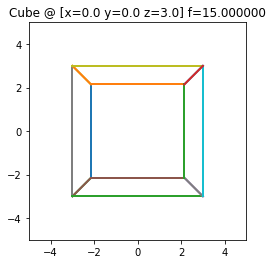

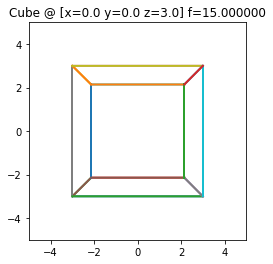

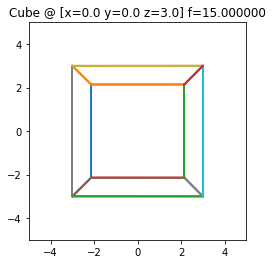

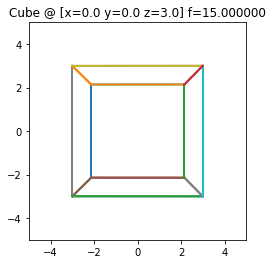

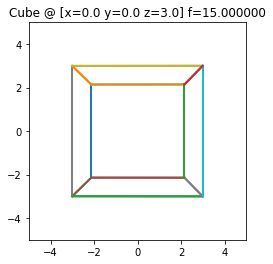

...

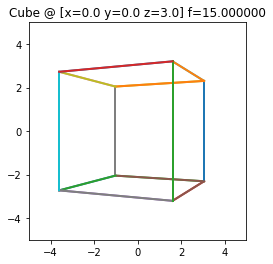

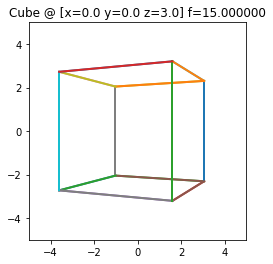

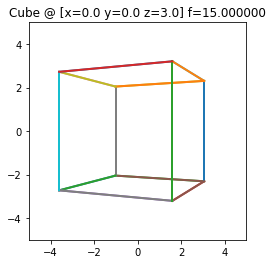

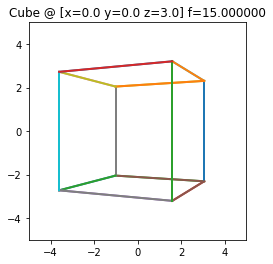

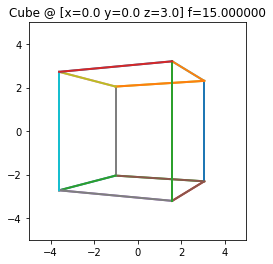

In [31]:
R = [rotY(theta) for theta in np.arange(0, np.pi, 0.001)]
generate_gif(R, file_name='cube.gif')

In [13]:
def rotX(theta):
    out = np.array([[1,0,0],[0,np.cos(theta),-1*np.sin(theta)],[0,np.sin(theta),np.cos(theta)]])
    return(out)

In [32]:
theta = np.pi/4
renderCube(R = rotY(theta).dot(rotX(theta)))


p: -3.1464466094067265    pp: -3.853553390593274
p: -3.1464466094067265    pp: -2.646446609406726
p: -3.1464466094067265    pp: -2.646446609406726
p: -2.646446609406726    pp: -3.353553390593274
p: -2.646446609406726    pp: -2.146446609406726
p: -2.646446609406726    pp: -3.1464466094067265
p: -2.646446609406726    pp: -3.353553390593274
p: -2.646446609406726    pp: -3.1464466094067265
p: -2.646446609406726    pp: -2.146446609406726
p: -2.146446609406726    pp: -2.8535533905932735
p: -2.146446609406726    pp: -2.646446609406726
p: -2.146446609406726    pp: -2.646446609406726
p: -3.853553390593274    pp: -3.1464466094067265
p: -3.853553390593274    pp: -3.353553390593274
p: -3.853553390593274    pp: -3.353553390593274
p: -3.353553390593274    pp: -2.646446609406726
p: -3.353553390593274    pp: -2.8535533905932735
p: -3.353553390593274    pp: -3.853553390593274
p: -3.353553390593274    pp: -2.646446609406726
p: -3.353553390593274    pp: -3.853553390593274
p: -3.353553390593274    pp: -2.

In [33]:
renderCube(R = rotX(theta).dot(rotY(theta)))

p: -3.353553390593274    pp: -3.853553390593274
p: -3.353553390593274    pp: -2.646446609406726
p: -3.353553390593274    pp: -2.8535533905932735
p: -2.8535533905932735    pp: -3.353553390593274
p: -2.8535533905932735    pp: -2.146446609406726
p: -2.8535533905932735    pp: -3.353553390593274
p: -2.646446609406726    pp: -3.1464466094067265
p: -2.646446609406726    pp: -3.353553390593274
p: -2.646446609406726    pp: -2.146446609406726
p: -2.146446609406726    pp: -2.646446609406726
p: -2.146446609406726    pp: -2.8535533905932735
p: -2.146446609406726    pp: -2.646446609406726
p: -3.853553390593274    pp: -3.353553390593274
p: -3.853553390593274    pp: -3.1464466094067265
p: -3.853553390593274    pp: -3.353553390593274
p: -3.353553390593274    pp: -2.8535533905932735
p: -3.353553390593274    pp: -2.646446609406726
p: -3.353553390593274    pp: -3.853553390593274
p: -3.1464466094067265    pp: -2.646446609406726
p: -3.1464466094067265    pp: -3.853553390593274
p: -3.1464466094067265    pp: 

In [51]:
theta=np.pi/2
renderCube(f = np.inf , R = rotX(theta).dot(rotY(theta)))

p: -3.5    pp: -3.5
p: -3.5    pp: -2.5
p: -3.5    pp: -3.5
p: -3.5    pp: -3.5
p: -3.5    pp: -2.5
p: -3.5    pp: -3.5
p: -2.5    pp: -2.5
p: -2.5    pp: -3.5
p: -2.5    pp: -2.5
p: -2.5    pp: -2.5
p: -2.5    pp: -3.5
p: -2.5    pp: -2.5
p: -3.5    pp: -3.5
p: -3.5    pp: -2.5
p: -3.5    pp: -3.5
p: -3.5    pp: -3.5
p: -3.5    pp: -2.5
p: -3.5    pp: -3.5
p: -2.5    pp: -2.5
p: -2.5    pp: -3.5
p: -2.5    pp: -2.5
p: -2.5    pp: -2.5
p: -2.5    pp: -3.5
p: -2.5    pp: -2.5


## Prokudin-Gorskii: Color from gray scale photographs

### Combine

In [53]:
import zipfile
with zipfile.ZipFile('hw1.zip', 'r') as zip_ref:
    zip_ref.extractall()

In [2]:
im = imageio.imread('hw1/prokudin-gorskii/00125v.jpg')

Define transform function taking the long image and transforming it into a color image.

In [3]:
def transform2color(im):
    im1=np.empty([3, im.shape[0]//3, im.shape[1]])
    for x in range(im.shape[0]):
            for y in range(im.shape[1]):
                if x//(im.shape[0]//3) <= 2:
                    im1[x//(im.shape[0]//3), x%(im.shape[0]//3), y] = im[x,y]
    r = im1[2]
    g = im1[1]
    b = im1[0]
    im2 = np.stack((r,g,b))
    im2 = im2.astype(int).transpose(1,2,0)
    return(im2)


Use the function and save the image as 'original.jpg'

In [4]:
orig = transform2color(im)
plt.imshow(orig)
plt.savefig('00125v-original.jpg')
plt.show()

### Alignment

In [5]:
r=orig[:,:,0]
g=orig[:,:,1]
b=orig[:,:,2]

In [6]:
plt.imshow(g)
plt.show()

In [11]:
def offset(color1, color2, off):
    if type(off) is not int:
        raise TypeError('off should be an integer. Please check your input!')
    color1=color1.astype('float')
    color2=color2.astype('float')
    similarity = np.sum(color1*color2)
#     similarity=np.dot(np.array([np.linalg.norm(color1[i]) for i in range(color1.shape[0])]),
#                       np.array([np.linalg.norm(color2[i]) for i in range(color2.shape[0])]))
    x_new=0
    y_new=0
    for i in range(-off,off+1): # x
        for j in range(-off,off+1): # y
#             roll > 0 --> roll towards right
#             roll < 0 --> roll towards left
            color2_new = np.roll(color2,(i, j), axis=(1,0))
#             similarity_new = np.dot(np.array([np.linalg.norm(color1[i]) for i in range(color1.shape[0])]),
#                                     np.array([np.linalg.norm(color2_new[i]) for i in range(color2_new.shape[0])]))
            similarity_new = np.sum(color1*color2_new)
            if similarity_new > similarity:
                similarity = similarity_new
                x_new=i
                y_new=j
    final = np.roll(color2,(x_new, y_new), axis=(1,0)).astype('int')

    return(final,x_new,y_new)

In [12]:
first_layer,x1,y1 = offset(r,g, 15)
second_layer,x2,y2 = offset(r,b, 15)
roll = np.stack((r, first_layer, second_layer)).transpose(1,2,0)


In [13]:
plt.imshow(roll)
plt.savefig('00125v-alignment.jpg')
plt.show()

In [14]:
im = imageio.imread('hw1/tableau/efros_tableau.jpg')

In [15]:
orig = transform2color(im)
plt.imshow(orig)
plt.savefig('efros_tableau-original.jpg')
plt.show()

In [16]:
r=orig[:,:,0]
g=orig[:,:,1]
b=orig[:,:,2]

In [17]:
first_layer,x1,y1 = offset(r,g,15)
second_layer,x2,y2 = offset(r,b,15)
roll = np.stack((r, first_layer, second_layer)).transpose(1,2,0)

In [18]:
plt.imshow(roll)
plt.savefig('efros_tableau-alignment.jpg')
plt.show()

### Pyramid

The previous method is useful for small size images, but when it come to larger images, it always become time consuming. That is the reason we use the pyramid.

Pyramid is useful because we resize the orignal image and compute over a smaller image at first. This allow us to shrink the rolling range and save computational expense.

The function `pyramid` contains the basic algorithm and I tested the function over image `seoul_tableau.jpg` under the `tableau` forder.

In [55]:
from skimage.transform import resize
def pyramid(img):
    print('Transforming to color image..')
    orig = transform2color(img)
    r=orig[:,:,0]
    g=orig[:,:,1]
    b=orig[:,:,2]
    # resize the image by 1/4
    print('Resizing the image...')
    r_lower = resize(r, (r.shape[0] // 4, r.shape[1] // 4), anti_aliasing=True) # by 1/4
    g_lower = resize(g, (g.shape[0] // 4, g.shape[1] // 4), anti_aliasing=True) # by 1/4
    b_lower = resize(b, (b.shape[0] // 4, b.shape[1] // 4), anti_aliasing=True) # by 1/4
    # resize the image by 1/4
    r_lower_2 = resize(r_lower, (r_lower.shape[0] // 4, r_lower.shape[1] // 4), anti_aliasing=True) # by 1/4
    g_lower_2 = resize(g_lower, (g_lower.shape[0] // 4, g_lower.shape[1] // 4), anti_aliasing=True) # by 1/4
    b_lower_2 = resize(b_lower, (b_lower.shape[0] // 4, b_lower.shape[1] // 4), anti_aliasing=True) # by 1/4
    
    # compute over the smallest image
    print('Computing the offset...')
    first_layer_2,x1,y1 = offset(r_lower_2,g_lower_2,10)
    second_layer_2,x2,y2 = offset(r_lower_2,b_lower_2,10)
    
    # compute over the middle size image
    first_layer_1,x_1,y_1 = offset(r_lower,g_lower,10)
    second_layer_1,x_2,y_2 = offset(r_lower,b_lower,10)
    x1 = x_1*4 + x1*(4**2)
    y1 = y_1*4 + y1*(4**2)
    x2 = x_2*4 + x2*(4**2)
    y2 = y_2*4 + y2*(4**2)

    # compute over the orignal image
    first_layer,x_1,y_1 = offset(r,g,10)
    second_layer,x_2,y_2 = offset(r,b,10)
    x1 += x_1
    y1 += y_1
    x2 += x_2
    y2 += y_2
    
    print('Finish computation!')
    roll = np.stack((r, first_layer, second_layer)).transpose(1,2,0).astype('int')
    return(roll, x1, y1, x2, y2)

In [39]:
im = imageio.imread('hw1/tableau/seoul_tableau.jpg')

In [56]:
img, x1, y1, x2, y2 = pyramid(im)

Resizing the image...
Compute the offset...
Finish computation!


In [42]:
plt.imshow(img)
plt.savefig('seoul_tableau-pyramid.jpg')
plt.show()

In [59]:
import cProfile
import re
cProfile.run("pyramid(im)")

Resizing the image...
Compute the offset...
Finish computation!
         45027 function calls in 26.475 seconds

   Ordered by: standard name

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        6    0.000    0.000    0.000    0.000 <frozen importlib._bootstrap>:1009(_handle_fromlist)
        6    6.978    1.163   17.263    2.877 <ipython-input-11-43bf94878161>:1(offset)
        1    8.853    8.853    8.878    8.878 <ipython-input-3-c8df9567223b>:1(transform2color)
        1    0.023    0.023   26.465   26.465 <ipython-input-55-f99cacf98c07>:2(pyramid)
        1    0.010    0.010   26.475   26.475 <string>:1(<module>)
        6    0.000    0.000    0.000    0.000 _dtype.py:319(_name_get)
       12    0.001    0.000    0.002    0.000 _geometric.py:17(_center_and_normalize_points)
        6    0.001    0.000    0.003    0.001 _geometric.py:590(estimate)
        6    0.000    0.000    0.000    0.000 _geometric.py:754(__init__)
       30    0.000    0.000    0.0

TypeError: 'NoneType' object is not subscriptable

Using the previous method, we found the best offset for this image is:

In [57]:
print(x1,y1,x2,y2)

14 0 1 -6


Because the offset value is obtained after the computation, it is reasonable if we use the offset range as 15 and compute it using the offset function as above. And here is the time consumption we got.

In [58]:
import time
t = time.time()
orig = transform2color(im) 
r=orig[:,:,0] 
g=orig[:,:,1] 
b=orig[:,:,2]
first_layer,x1,y1 = offset(r,g,15) 
second_layer,x2,y2 = offset(r,b,15) 
roll = np.stack((r, first_layer, second_layer)).transpose(1,2,0)
time.time()-t

45.52747178077698

**Time difference**:
    - Pyramid function: 26.580 seconds
    - Offset function: 45.527 seconds

##  Color Spaces and illuminance

In [82]:
import imageio
im_in = imageio.imread('hw1/rubik/indoor.png')
im_out = imageio.imread('hw1/rubik/outdoor.png')

### Images overview (gray scale vs LAB scale):

In [76]:
fig, axs = plt.subplots(1, 3)
fig.suptitle('Three Grayscale Color Channels for Image "indoor.png"')
axs[0].imshow(im_in[:,:,0], cmap=plt.get_cmap("gray"))
axs[0].set_title('Red Channel')
axs[1].imshow(im_in[:,:,1], cmap=plt.get_cmap("gray"))
axs[1].set_title('Green Channel')
axs[2].imshow(im_in[:,:,2], cmap=plt.get_cmap("gray"))
axs[2].set_title('Blue Channel')
for ax in axs.flat:
    ax.label_outer()
    
plt.show()

In [87]:
fig, axs = plt.subplots(1, 3)
fig.suptitle('Three Grayscale Color Channels for Image "indoor.png"')
axs[0].imshow(im_out[:,:,0], cmap=plt.get_cmap("gray"))
axs[0].set_title('Red Channel')
axs[1].imshow(im_out[:,:,1], cmap=plt.get_cmap("gray"))
axs[1].set_title('Green Channel')
axs[2].imshow(im_out[:,:,2], cmap=plt.get_cmap("gray"))
axs[2].set_title('Blue Channel')
for ax in axs.flat:
    ax.label_outer()
    
plt.show()

In [100]:
im_in = im_in[:,:,:3]
im_out = im_out[:,:,:3]

In [103]:
from skimage.color import rgb2lab
lab_in = rgb2lab(im_in).astype('int')
lab_out = rgb2lab(im_out).astype('int')

In [99]:
fig, axs = plt.subplots(1, 3)
fig.suptitle('Three LAB Color Channels for Image "indoor.png"')
axs[0].imshow(lab_in[:,:,0], cmap=plt.get_cmap("gray"))
axs[0].set_title('Red Channel')
axs[1].imshow(lab_in[:,:,1], cmap=plt.get_cmap("gray"))
axs[1].set_title('Green Channel')
axs[2].imshow(lab_in[:,:,2], cmap=plt.get_cmap("gray"))
axs[2].set_title('Blue Channel')
for ax in axs.flat:
    ax.label_outer()
    
plt.show()

In [104]:
fig, axs = plt.subplots(1, 3)
fig.suptitle('Three LAB Color Channels for Image "outdoor.png"')
axs[0].imshow(lab_out[:,:,0], cmap=plt.get_cmap("gray"))
axs[0].set_title('Red Channel')
axs[1].imshow(lab_out[:,:,1], cmap=plt.get_cmap("gray"))
axs[1].set_title('Green Channel')
axs[2].imshow(lab_out[:,:,2], cmap=plt.get_cmap("gray"))
axs[2].set_title('Blue Channel')
for ax in axs.flat:
    ax.label_outer()
    
plt.show()

From the LAB color scale, the illumination mainly caused by the red channel, leaving the other channels basically unchanged. While the three channels under the grayscale cannot seperate the light change as clear as the LAB does.